In [1]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters, measure, morphology, feature, exposure
from skimage.morphology import convex_hull_image, binary_dilation
from skimage import morphology
from skimage.segmentation import flood_fill, flood
from skimage.draw import disk
import math
from tqdm.notebook import tqdm
import tifffile
import glob
from scipy import stats
import os 
from pyefd import elliptic_fourier_descriptors, plot_efd,reconstruct_contour, calculate_dc_coefficients
import matplotlib.colors as mcolors
import random
import matplotlib
import matplotlib.gridspec as gridspec


In [2]:
def tuple_mean(t1, t2, w=(0.5, 0.5)):
    t_a = w[0] * t1[0] + w[1] * t2[0]
    t_b = w[0] * t1[1] + w[1] * t2[1]
    return (t_a, t_b)

def efd_mean(efd_coeffs, efd_locs, w=(0.5, 0.5)):
    efd_coeffs_mean = w[0] * efd_coeffs[0] + w[1] * efd_coeffs[1]
    efd_locs_mean = tuple_mean(efd_locs[0], efd_locs[1], w=w)
    return efd_coeffs_mean, efd_locs_mean

def apply_efd_transform(in_img, num_contours=100, num_points=100):
    img = in_img[0]
    thresh = filters.threshold_otsu(img)
    img_thresh = img > thresh
    chull = convex_hull_image(img_thresh)
    contours = measure.find_contours(chull, 0.8)
    centroid = (np.median(np.where(in_img[1] == np.max(in_img[1]))[1]), np.median(np.where(in_img[1] == np.max(in_img[1]))[0]))

    efd_coeffs = elliptic_fourier_descriptors(np.squeeze(contours), order=10)
    efd_locus = calculate_dc_coefficients(np.squeeze(contours))
    
    rr, cc = disk(centroid, 5)
    circ_img = np.zeros(img.shape)
    circ_img[cc, rr] = 1
    centroid_contours = measure.find_contours(circ_img, 0.8)

    efd_coeffs_cen = elliptic_fourier_descriptors(np.squeeze(centroid_contours), order=10)
    efd_locus_cen = calculate_dc_coefficients(np.squeeze(centroid_contours))
    
    efd_recons = []
    for w in [k/num_contours for k in range(0,num_contours)]:
        efd_coeffs_temp, efd_loc_temp = efd_mean((efd_coeffs, efd_coeffs_cen), (efd_locus, efd_locus_cen), w=(1 - w, w))
        efd_recon = reconstruct_contour(efd_coeffs_temp, locus=efd_loc_temp, num_points=num_points)
        efd_recons.append(efd_recon)

    trans_img = np.zeros((num_points, num_contours))

    for angle_coord in range(num_points):
        for r_coord, efd_recon in enumerate(reversed(efd_recons)):
            trans_img[angle_coord, r_coord] = img[int(efd_recon[angle_coord,1]), int(efd_recon[angle_coord,0])]
            
    return trans_img

def get_efd(img, chull, centroid, num_contours=100, num_points=100):
    
    contours = measure.find_contours(chull, 0.8)
#     centroid = (ndimage.center_of_mass(chull)[1], ndimage.center_of_mass(chull)[0])

#     centroid = (np.median(np.where(in_img[1] == np.max(in_img[1]))[1]), np.median(np.where(in_img[1] == np.max(in_img[1]))[0]))

    
    efd_coeffs = elliptic_fourier_descriptors(np.squeeze(contours), order=10)
    efd_locus = calculate_dc_coefficients(np.squeeze(contours))
    
    rr, cc = disk(centroid, 1)
    circ_img = np.zeros(img.shape)
    circ_img[cc, rr] = 1
    centroid_contours = measure.find_contours(circ_img, 0.8)

    efd_coeffs_cen = elliptic_fourier_descriptors(np.squeeze(centroid_contours), order=10)
    efd_locus_cen = calculate_dc_coefficients(np.squeeze(centroid_contours))
    efd_recon_cen = reconstruct_contour(efd_coeffs_cen, locus=efd_locus_cen, num_points=num_points)
    
    efd_recons = []
    for w in [k/num_contours for k in range(0,num_contours)]:
        efd_coeffs_temp, efd_loc_temp = efd_mean((efd_coeffs, efd_coeffs_cen), (efd_locus, efd_locus_cen), w=(1 - w, w))
        efd_recon = reconstruct_contour(efd_coeffs_temp, locus=efd_loc_temp, num_points=num_points)
        efd_recons.append(efd_recon)
    efd_recons.append(efd_recon_cen)
    return efd_recons

def get_area_mask(img_shape, efd_recon_outer, efd_recon_inner, centroid):
    outer_ring = np.zeros(img_shape)
    outer_ring[efd_recon_outer[:,0].astype(int), efd_recon_outer[:,1].astype(int)] = 1
    outer_mask = flood_fill(outer_ring, (int(centroid[1]), int(centroid[0])), new_value=1, connectivity=0)

    inner_ring = np.zeros(img_shape)
    inner_ring[efd_recon_inner[:,0].astype(int), efd_recon_inner[:,1].astype(int)] = 1
    inner_mask = flood_fill(inner_ring, (int(centroid[1]), int(centroid[0])), new_value=1, connectivity=0)
    
    return outer_mask - inner_mask

def vector_lengths(u,v):   
    return np.array([[np.sqrt(u_ij**2 + v_ij**2) for u_ij, v_ij in zip(u_i,v_i)] for u_i, v_i in zip(u,v)])

def make_radial_vectors(centroid, chull, x_range, y_range):
    xmesh, ymesh = np.meshgrid(np.arange(x_range[0], x_range[1]), 
                               np.arange(y_range[0], y_range[1]), 
                               indexing = 'ij')

    u = xmesh - centroid[1] 
    v = ymesh - centroid[0]
    
    l = vector_lengths(u,v)

    vx, vy = u / l, v / l
    
    chull = chull[x_range[0]:x_range[1], y_range[0]:y_range[1]]
    vx[~chull] = np.nan
    vy[~chull] = np.nan
    
    return vx, vy

def make_horizontal_vectors(centroid, chull, x_range, y_range):
    xmesh, ymesh = np.meshgrid(np.arange(x_range[0], x_range[1]), 
                               np.arange(y_range[0], y_range[1]), 
                               indexing = 'ij')

    u = xmesh * 0
    v = ymesh / ymesh
    
    l = vector_lengths(u,v)

    vx, vy = u / l, v / l
    
    chull = chull[x_range[0]:x_range[1], y_range[0]:y_range[1]]
    vx[~chull] = np.nan
    vy[~chull] = np.nan
    
    return vx, vy

def make_vertical_vectors(centroid, chull, x_range, y_range):
    xmesh, ymesh = np.meshgrid(np.arange(x_range[0], x_range[1]), 
                               np.arange(y_range[0], y_range[1]), 
                               indexing = 'ij')

    u = xmesh / xmesh
    v = ymesh * 0
    
    l = vector_lengths(u,v)

    vx, vy = u / l, v / l
    
    chull = chull[x_range[0]:x_range[1], y_range[0]:y_range[1]]
    vx[~chull] = np.nan
    vy[~chull] = np.nan
    
    return vx, vy

def make_random_vectors(centroid, chull, x_range, y_range):
    xmesh, ymesh = np.meshgrid(np.arange(x_range[0], x_range[1]), 
                               np.arange(y_range[0], y_range[1]), 
                               indexing = 'ij')

    u = random.uniform(-1,1) * xmesh / xmesh
    v = random.uniform(-1,1) * ymesh / ymesh
    
    l = vector_lengths(u,v)

    vx, vy = u / l, v / l
    
    chull = chull[x_range[0]:x_range[1], y_range[0]:y_range[1]]
    vx[~chull] = np.nan
    vy[~chull] = np.nan
    
    return vx, vy

def make_tangential_vectors(centroid, chull, x_range, y_range):
    xmesh, ymesh = np.meshgrid(np.arange(x_range[0], x_range[1]), 
                               np.arange(y_range[0], y_range[1]), 
                               indexing = 'ij')

    
    u = ymesh - centroid[0] 
    v = -xmesh + centroid[1]
    
    l = vector_lengths(u,v)

    vx, vy = u / l, v / l
    
    chull = chull[x_range[0]:x_range[1], y_range[0]:y_range[1]]
    vx[~chull] = np.nan
    vy[~chull] = np.nan
    
    return vx, vy

def get_vector_field(img, chull, x_range, y_range):
    img = img[x_range[0]:x_range[1], y_range[0]:y_range[1]]
    
    image_filter_sigma = 0.1
    local_sigma = 1

    threshold_value = max(int(0.5 * np.median(img)), 2)

    filtered_image = filters.gaussian(img, sigma = image_filter_sigma, mode = 'nearest', preserve_range = True)

    image_gradient_x, image_gradient_y = make_image_gradients(filtered_image)

    Structure_Tensor, EigenValues, EigenVectors, Jxx, Jxy, Jyy = make_structure_tensor_2d(image_gradient_x, 
                                                                                          image_gradient_y, 
                                                                                          local_sigma)

    vx, vy = make_vx_vy(filtered_image, EigenVectors, threshold_value)
    
    chull = chull[x_range[0]:x_range[1], y_range[0]:y_range[1]]
    vx[~chull] = np.nan
    vy[~chull] = np.nan
    
    return vx, vy

def plot_vecs(im, vecs_1, vecs_2, vecs_3, x_range, y_range):
    
    print(x_range, y_range)
    
    fig, ax = plt.subplots(1, 4, figsize = (60, 15), sharex = True, sharey = True)
    spacing = 15 # Spacing between plotting the orientation vectors
    scale = 60     
    
    xmesh, ymesh = np.meshgrid(np.arange(x_range[0], x_range[1]), 
                                         np.arange(y_range[0], y_range[1]), 
                                        indexing = 'ij')

    
    vx, vy = vecs_1

    ax[0].quiver(ymesh[spacing//2::spacing, spacing//2::spacing], 
                 xmesh[spacing//2::spacing, spacing//2::spacing],
                 vy[spacing//2::spacing, spacing//2::spacing], 
                 vx[spacing//2::spacing, spacing//2::spacing],
                 scale = scale, headlength = 0, headaxislength = 0, 
                 pivot = 'middle', color = 'k', angles = 'xy')

    ax[0].set_title('Image', pad = 20, fontsize = 40)
    ax[0].set_xticks([])
    ax[0].set_yticks([]) 

    vx, vy = vecs_2
    
    ax[1].quiver(ymesh[spacing//2::spacing, spacing//2::spacing], 
                 xmesh[spacing//2::spacing, spacing//2::spacing],
                 vy[spacing//2::spacing, spacing//2::spacing], 
                 vx[spacing//2::spacing, spacing//2::spacing],
                 scale = scale, headlength = 0, headaxislength = 0, 
                 pivot = 'middle', color = 'k', angles = 'xy')

    ax[1].set_title('Radial', pad = 20, fontsize = 40)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    
    vx, vy = vecs_3
    
    ax[2].quiver(ymesh[spacing//2::spacing, spacing//2::spacing], 
                 xmesh[spacing//2::spacing, spacing//2::spacing],
                 vy[spacing//2::spacing, spacing//2::spacing], 
                 vx[spacing//2::spacing, spacing//2::spacing],
                 scale = scale, headlength = 0, headaxislength = 0, 
                 pivot = 'middle', color = 'k', angles = 'xy')

    ax[2].set_title('Tangential', pad = 20, fontsize = 40)
    ax[2].set_xticks([])
    ax[2].set_yticks([])

    im1 = ax[3].imshow(im, vmin = 0, vmax = 1, cmap = 'RdYlBu_r')

    ax[3].set_title('Dot product', pad = 20, fontsize = 40)
    ax[3].set_xticks([])
    ax[3].set_yticks([])

    
    plt.show()
    

def get_mean_abs_dot_product(x, y, img, vecs, chull, x_range, y_range):    
    vx_i, vy_i = vecs
    
#     vx_i, vy_i = vx_i * (img / 255), vy_i * (img / 255)
    
    vx_r, vy_r = make_radial_vectors((x, y), chull, x_range, y_range)
    vx_t, vy_t = make_tangential_vectors((x, y), chull, x_range, y_range)    

    dp_map_r = np.abs(np.multiply(vx_i, vx_r) + np.multiply(vy_i, vy_r))
    dp_map_t = np.abs(np.multiply(vx_i, vx_t) + np.multiply(vy_i, vy_t))

    dp_map = (dp_map_r[~np.isnan(dp_map_r)].sum() / dp_map_t[~np.isnan(dp_map_t)].sum())
    
    return dp_map 

def is_touching_img_border(mask):
    chull = morphology.convex_hull_image(mask)
    return np.any(chull[:,-1]) or np.any(chull[:,0]) or np.any(chull[0]) or np.any(chull[-1])

def segment_and_separate_cells(img):
    # Otsu threshold and are threshold
    thresh = filters.threshold_otsu(img)
    img_thresh = img > thresh
    
    min_cell_size = (img.shape[0] / 10) ** 2
    
    img_thresh = morphology.area_opening(img_thresh, area_threshold=min_cell_size)
    
    # Identify individual cells with connected components
    img_labels = morphology.label(img_thresh)
    
    valid_cell_crops = []
    for l in range(1, img_labels.max() + 1):
        # Discard cells that are touching image borders
        if not is_touching_img_border(img_labels == l):
            chull = morphology.convex_hull_image(img_labels == l)
            valid_cell_crops.append(chull * img)
            
    if len(valid_cell_crops) == 0:
        plt.imshow(img)
        plt.show()
        plt.imshow(img_thresh)
        plt.show()
    # Return images with individual cells: Threshold and mask with chull
    return valid_cell_crops

def segment_and_separate_cells_from_dir(im_dir):
    cell_crops = []
    for im_path in tqdm(glob.glob(im_dir)):
        img = cv.imread(im_path, cv.IMREAD_GRAYSCALE)
        valid_cell_crops = segment_and_separate_cells(img)
        cell_crops = cell_crops + valid_cell_crops
        
    return cell_crops

def find_radiality_centre(im_dir):
    dor_list = []
    img_crops = segment_and_separate_cells_from_dir(im_dir)
    
    for img in tqdm(img_crops): 
        thresh = filters.threshold_otsu(img)
        img_thresh = img > thresh
        img_thresh = morphology.area_opening(img_thresh, area_threshold=150)
        chull = convex_hull_image(img_thresh)
        contours = measure.find_contours(chull, 0.8)[0]
        contours[:,0].max()
        x_min = math.floor(contours[:,0].min())
        x_max = math.ceil(contours[:,0].max())
        y_min = math.floor(contours[:,1].min())
        y_max = math.ceil(contours[:,1].max())
        
        centre_of_mass = ndimage.center_of_mass(chull)
        centre_of_mass = (centre_of_mass[1], centre_of_mass[0])
        
        efd_recons = get_efd(img, chull, centre_of_mass, num_contours=5, num_points=1000)
        efd_recons.reverse()
        vecs = get_vector_field(img, chull, (x_min, x_max), (y_min, y_max))

        stripwise_dor = []
        img_strip_sum = np.zeros_like(img)
                
        for i in range(1,len(efd_recons)):
            efd_recon_inner = efd_recons[i-1]
            efd_recon_outer = efd_recons[i]
            img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)
            
            img_strip = img * img_mask
            img_strip_sum += img_strip
                        
            Z = get_mean_abs_dot_product(centre_of_mass[0], centre_of_mass[1], img, vecs=vecs, chull=img_mask, x_range=(x_min, x_max), y_range=(y_min, y_max))
            
            stripwise_dor.append(Z)
            
            plt.title('DoR at CoM: ' + str(Z))
            plt.imshow(img_strip, alpha=1, cmap='gray')
            plt.scatter(centre_of_mass[0],centre_of_mass[1])
            plt.plot(contours[:, 1], contours[:, 0], linewidth=2)
            plt.axis('off')
            plt.show()
                

        mse = np.mean(img_strip_sum - img * chull) ** 2

        if (mse < 5) and not (True in [np.isnan(i) for i in stripwise_dor]):
            dor_list.append(stripwise_dor)
        else:
            print('NA')
    return np.stack(dor_list)

  0%|          | 0/146 [00:00<?, ?it/s]

  0%|          | 0/162 [00:00<?, ?it/s]

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


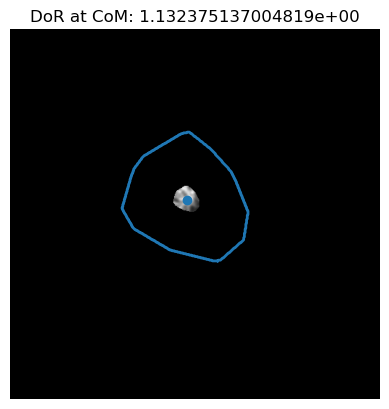

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


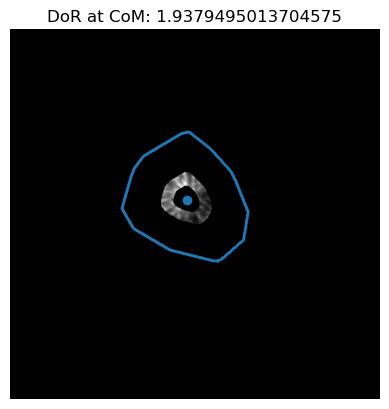

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


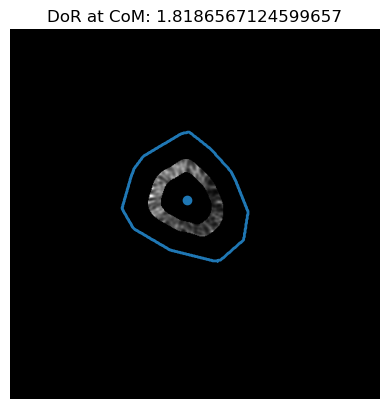

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


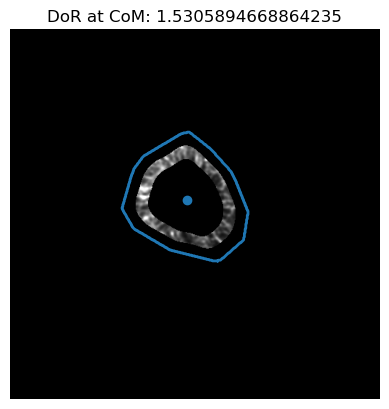

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


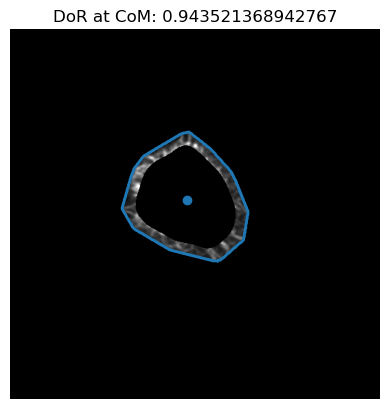

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


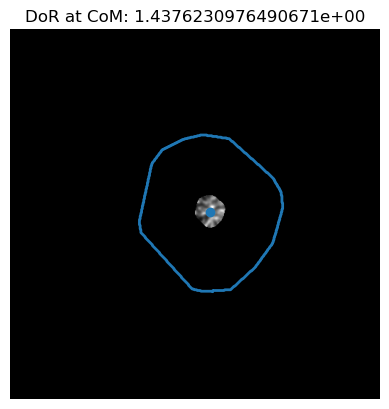

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


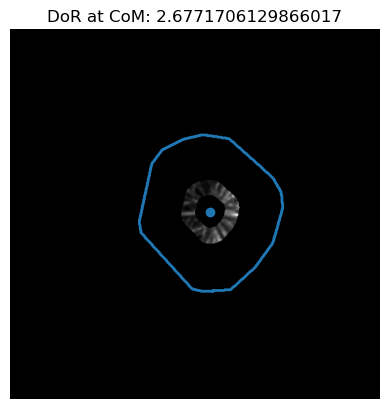

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


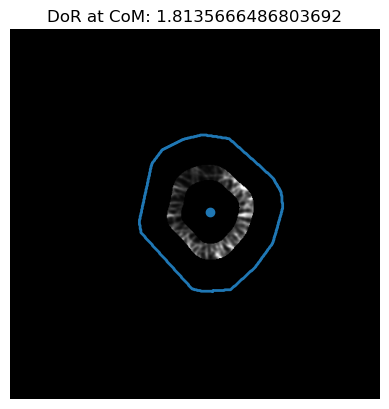

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


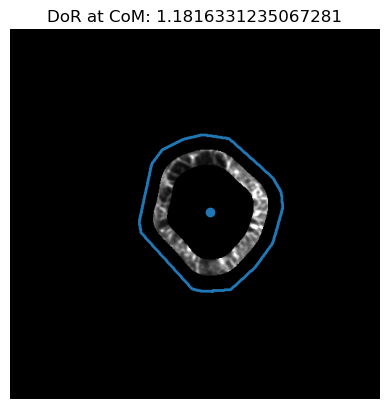

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


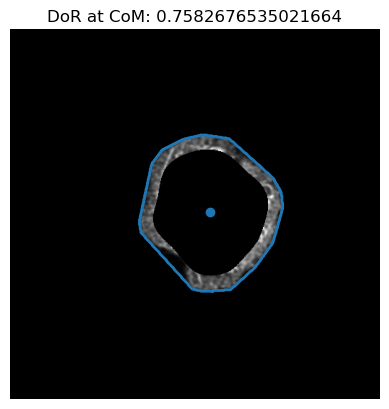

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


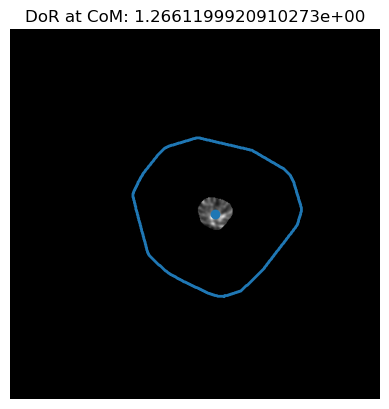

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


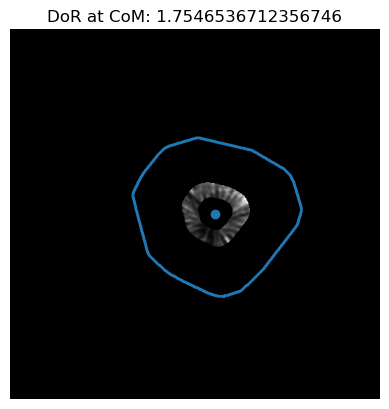

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


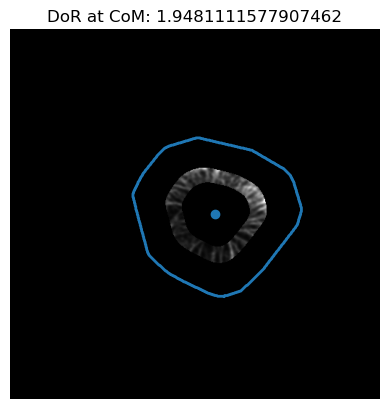

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


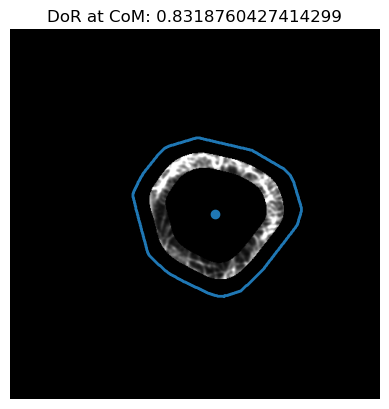

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


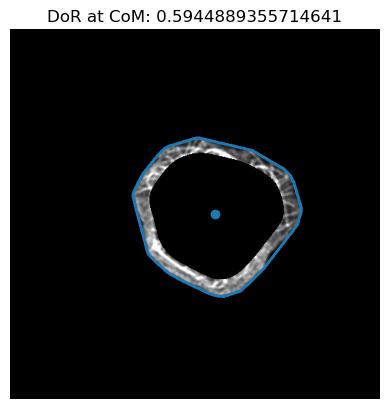

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


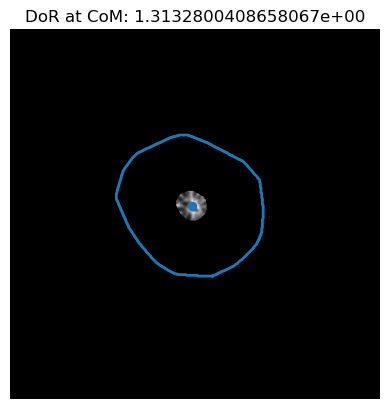

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


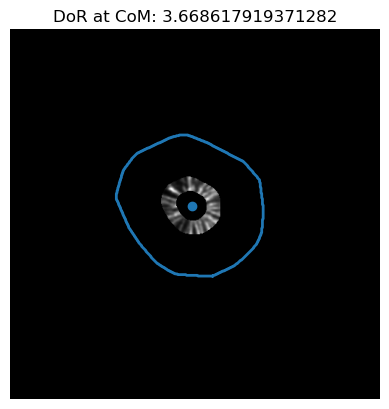

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


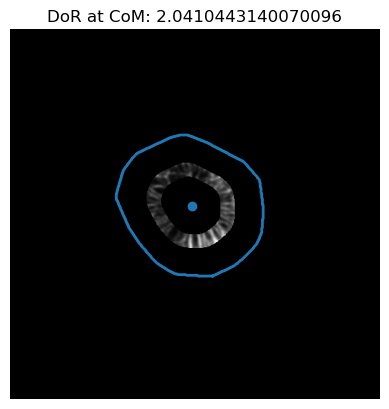

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


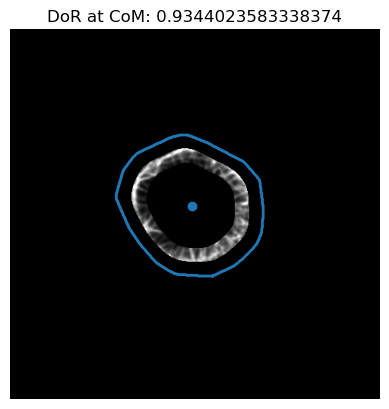

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


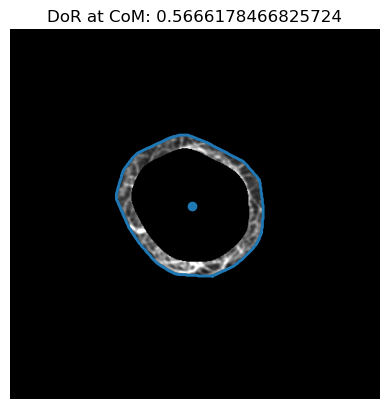

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


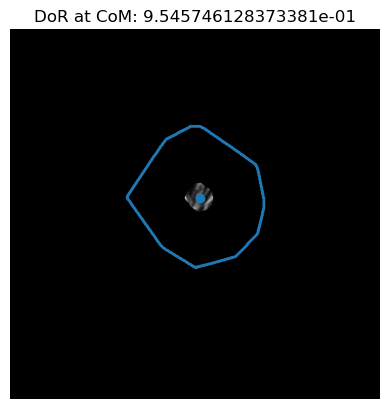

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


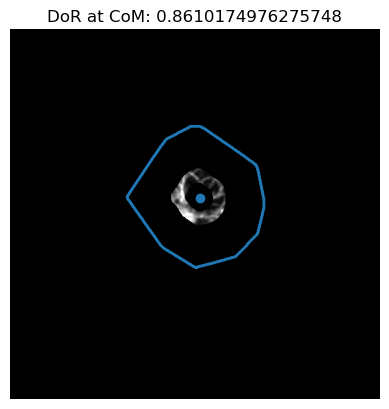

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


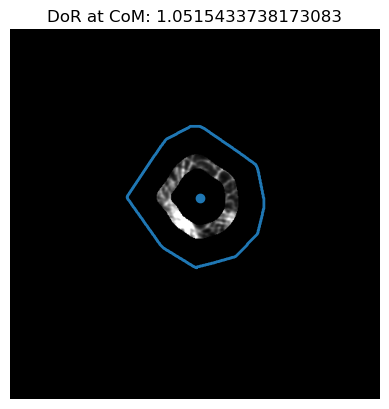

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


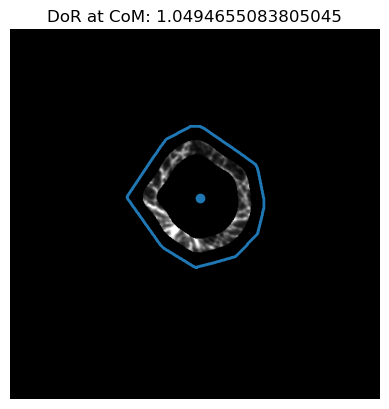

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


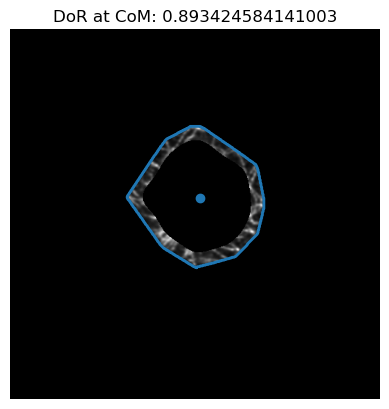

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


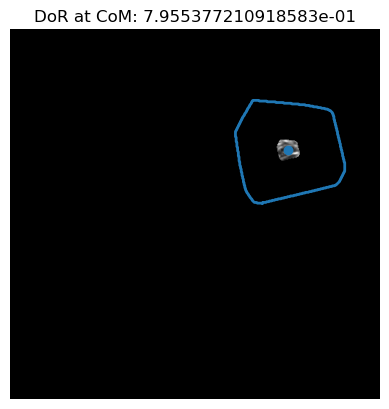

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


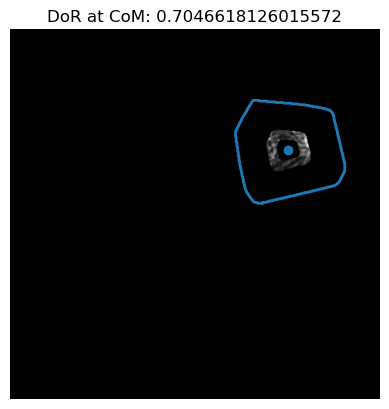

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


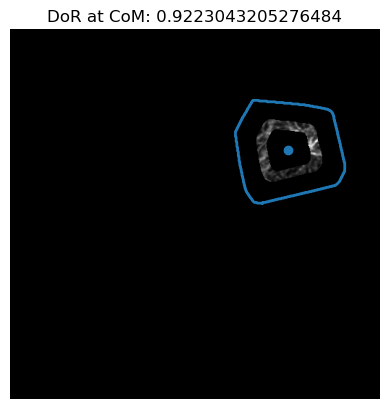

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


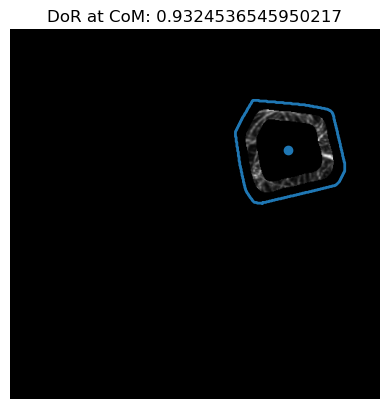

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


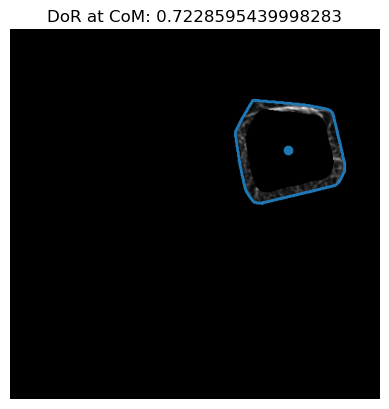

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


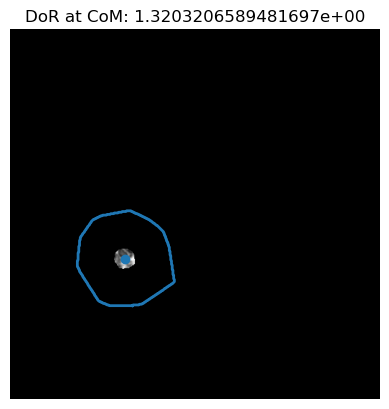

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


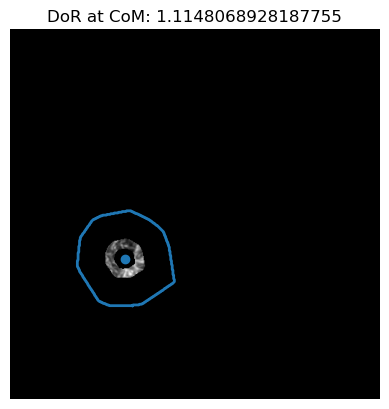

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


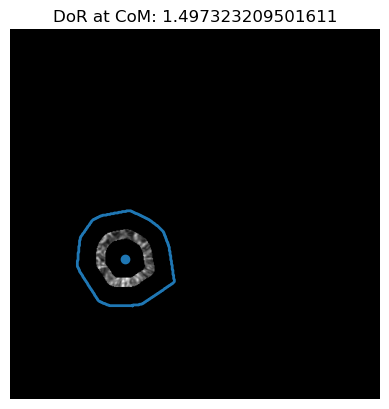

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


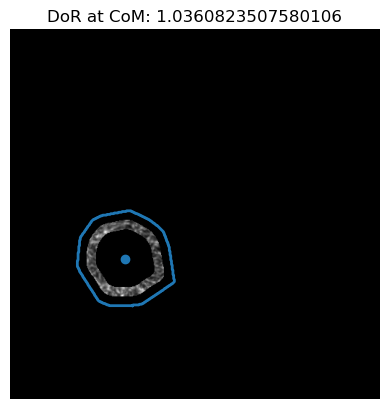

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


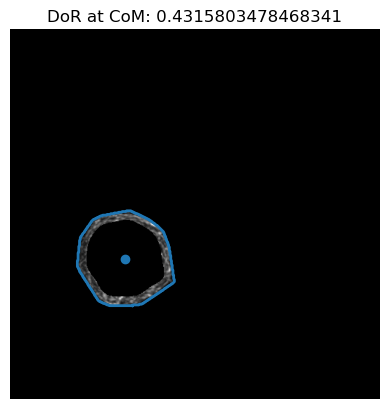

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


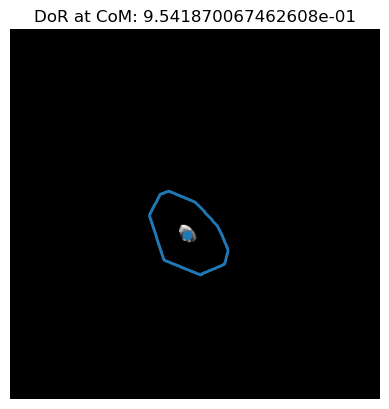

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


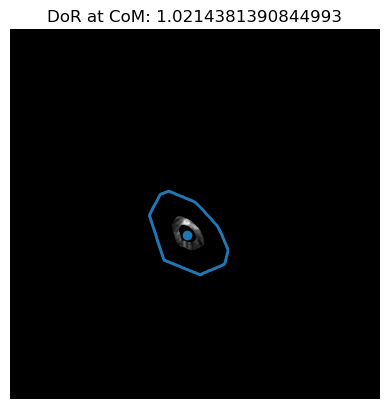

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


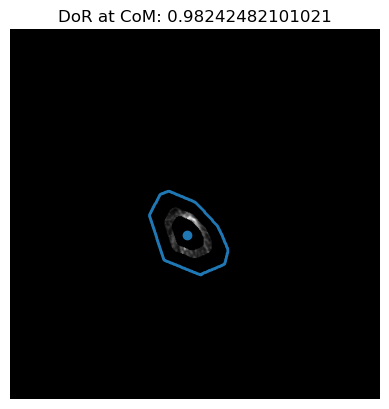

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


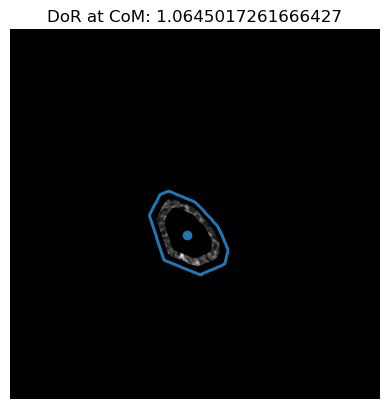

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


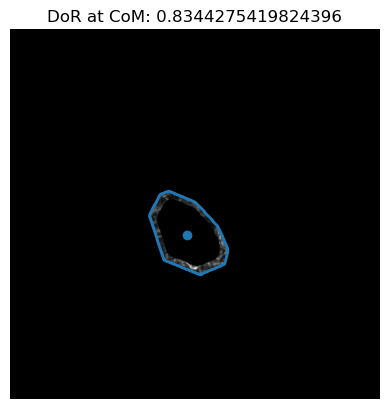

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


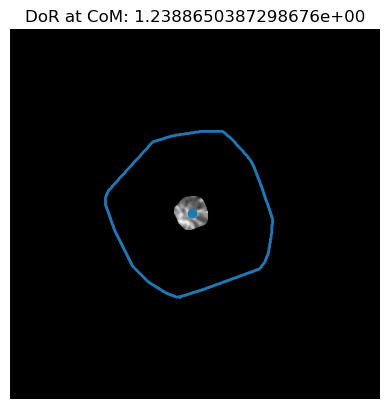

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


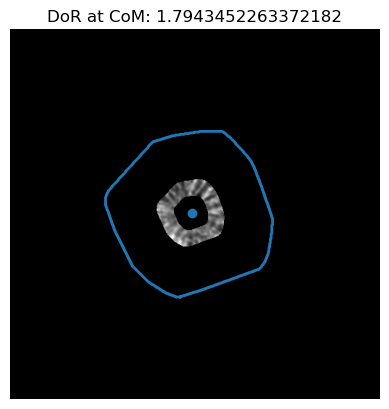

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


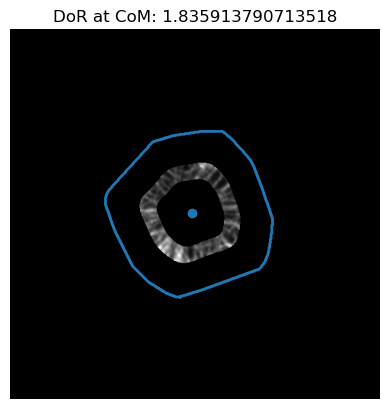

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


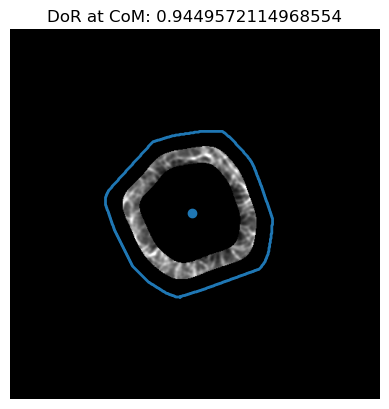

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


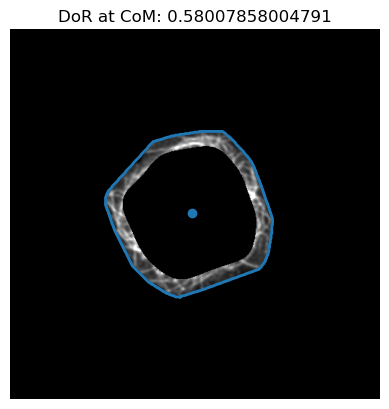

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


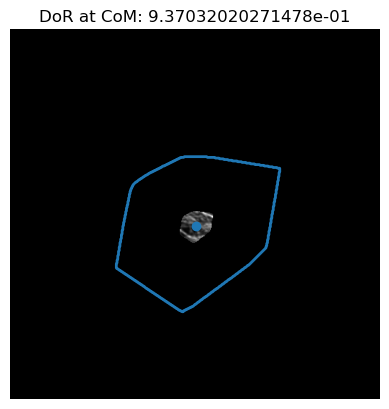

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


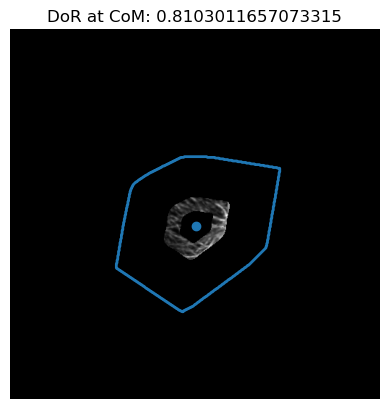

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


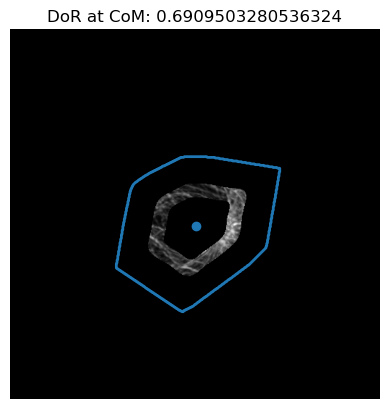

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


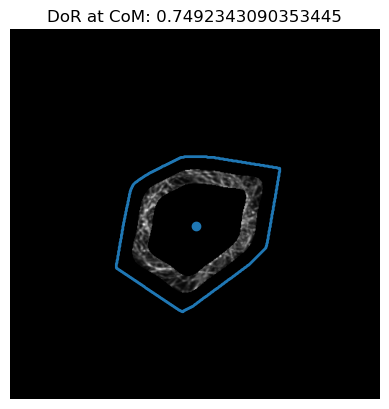

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


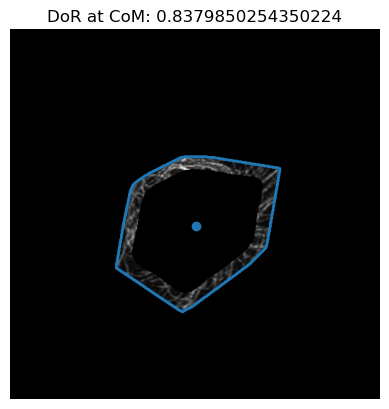

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


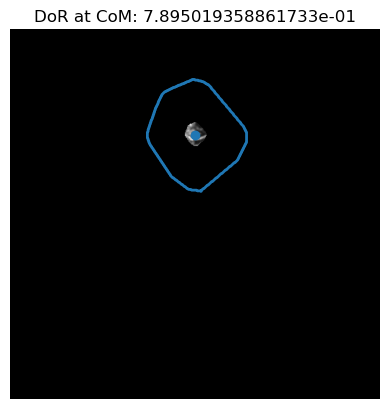

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


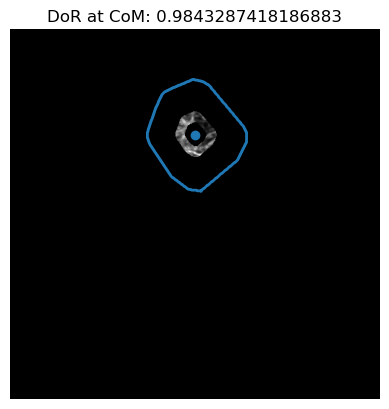

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


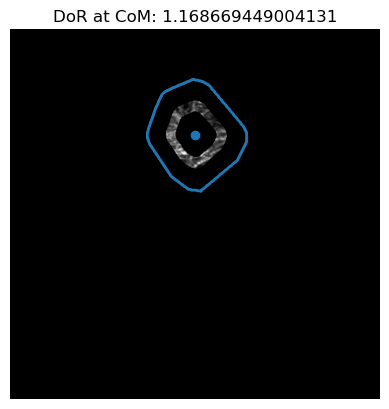

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


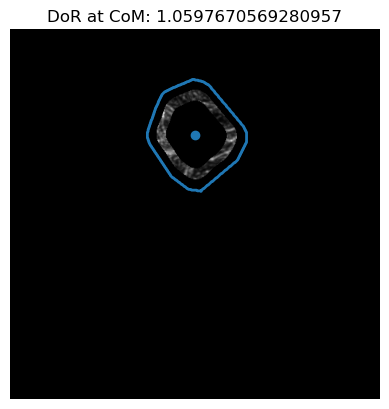

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


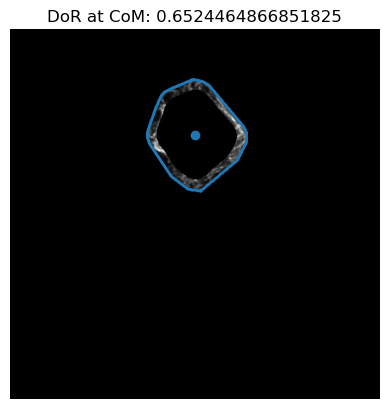

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


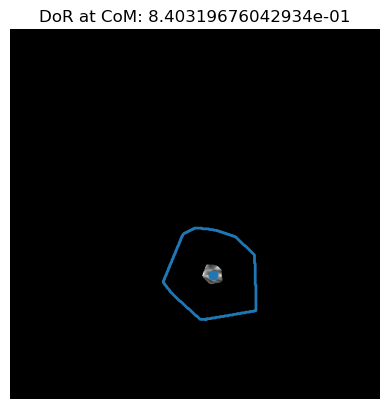

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


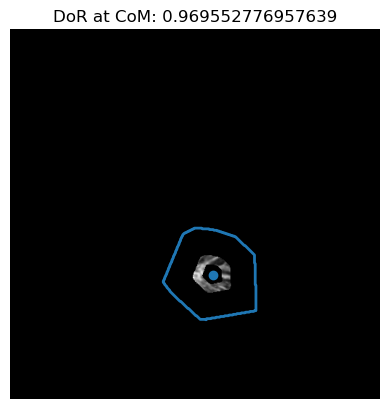

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


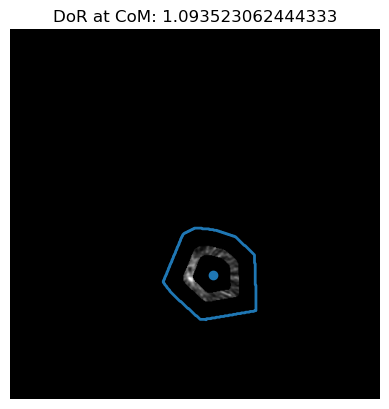

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


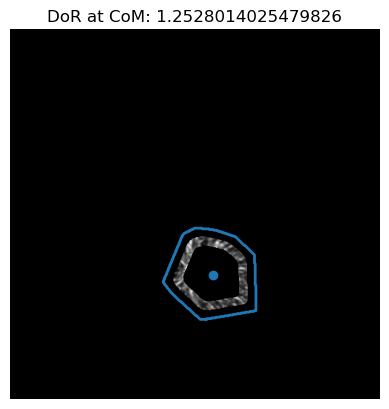

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


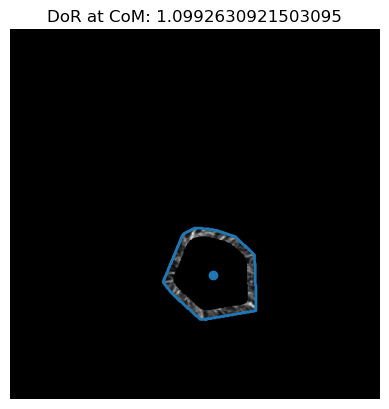

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


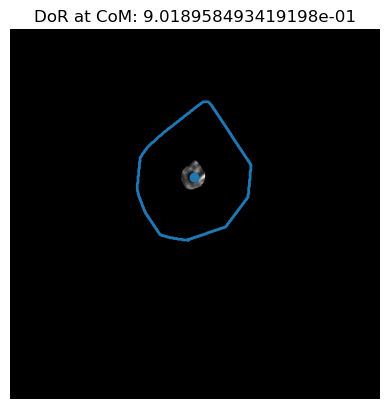

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


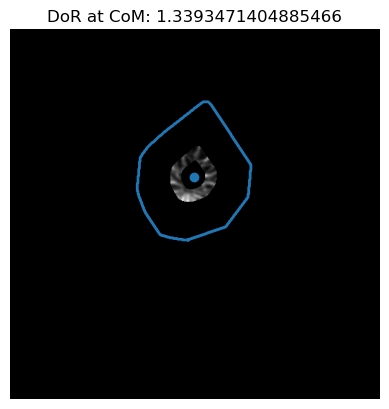

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


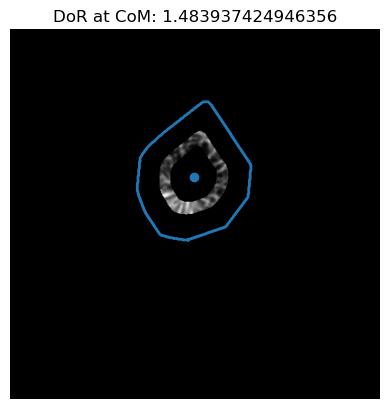

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


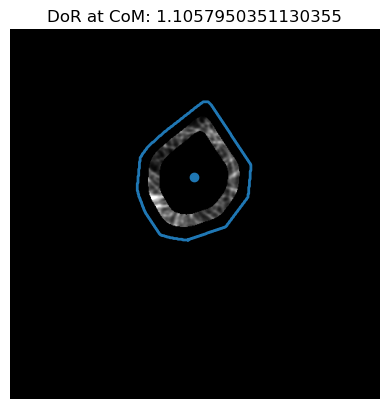

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


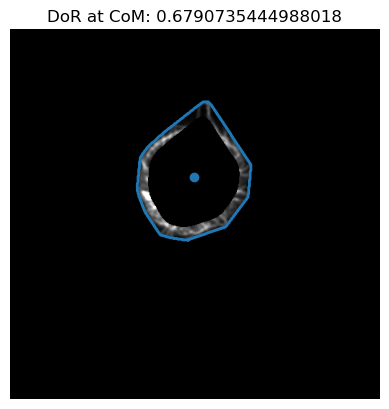

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


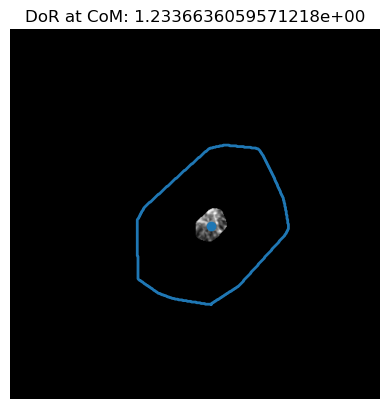

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


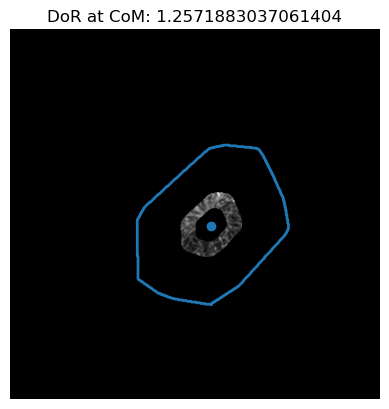

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


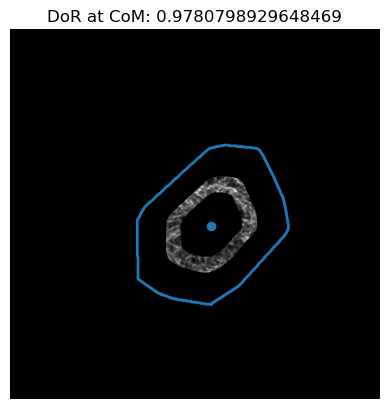

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


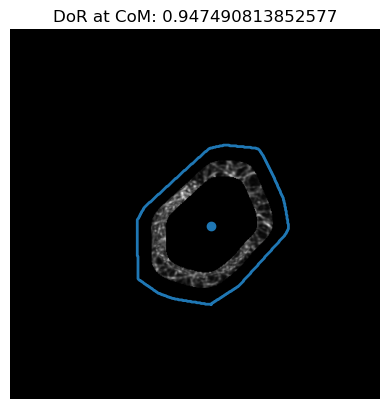

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


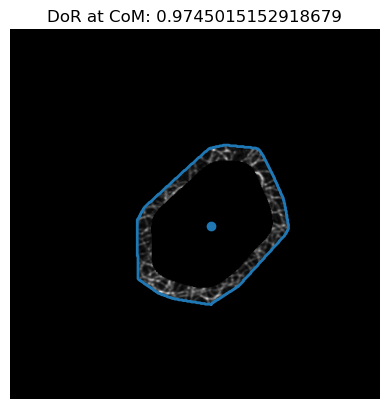

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


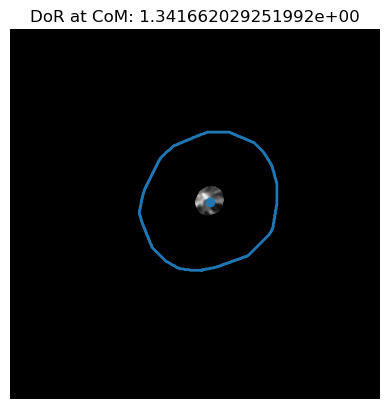

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


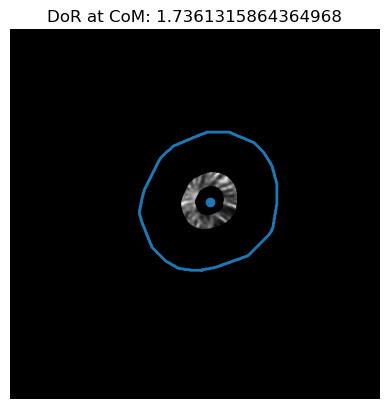

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


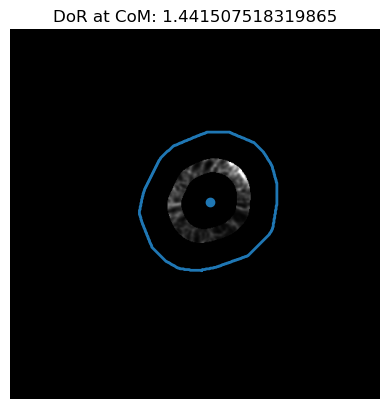

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


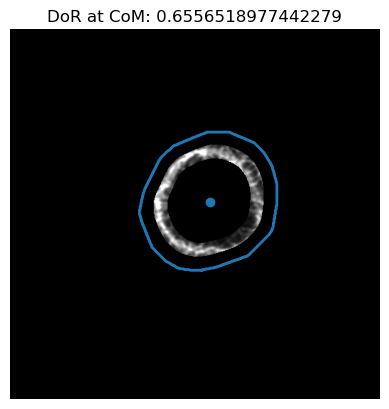

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


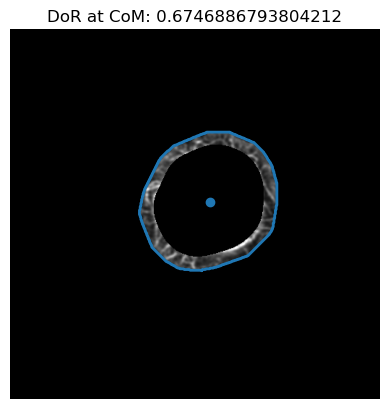

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


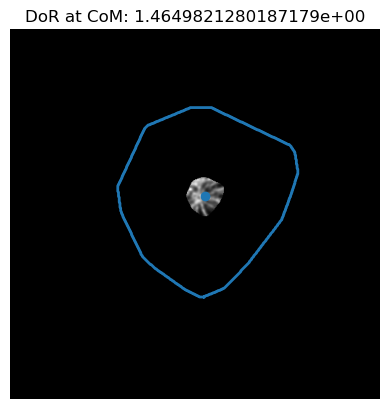

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


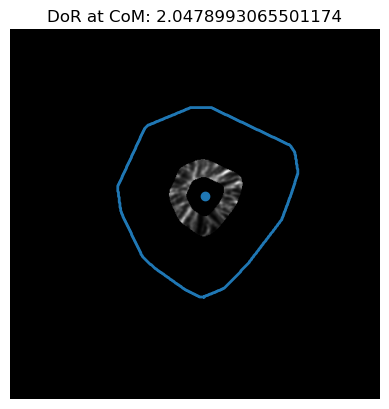

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


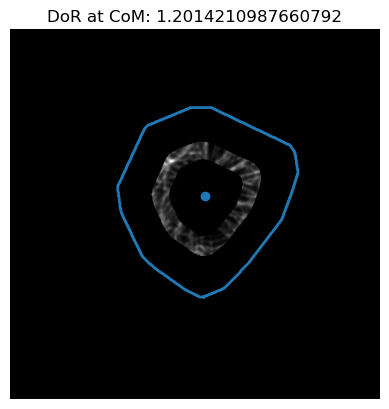

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


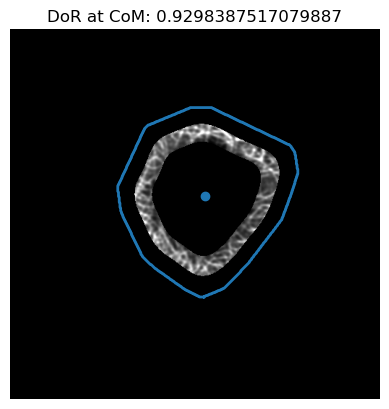

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


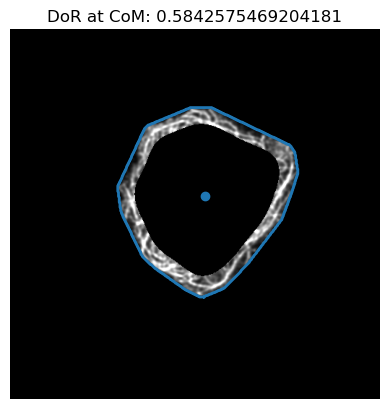

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


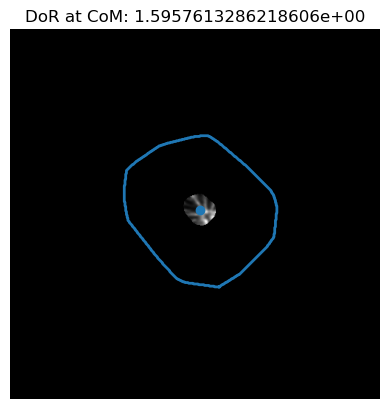

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


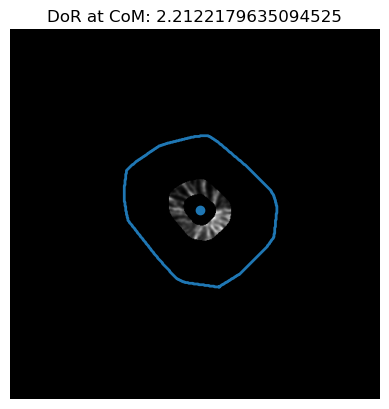

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


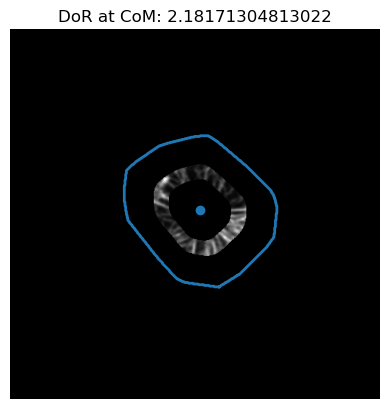

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


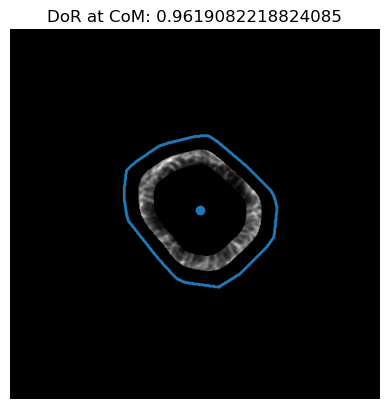

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


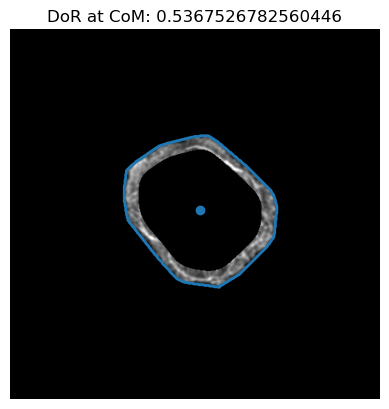

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


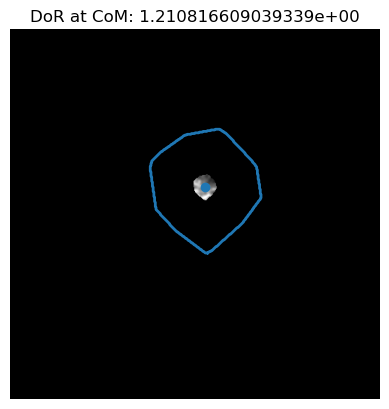

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


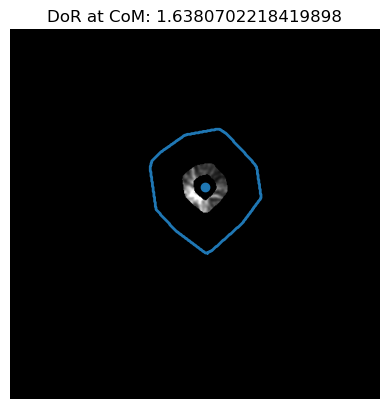

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


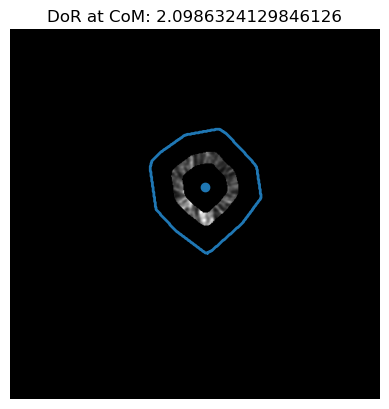

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


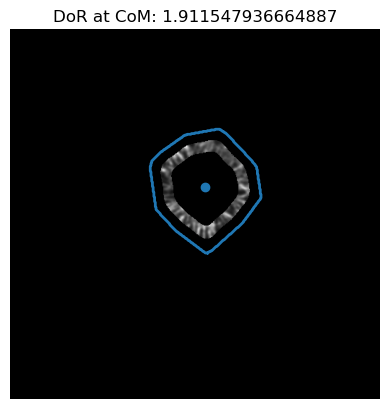

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


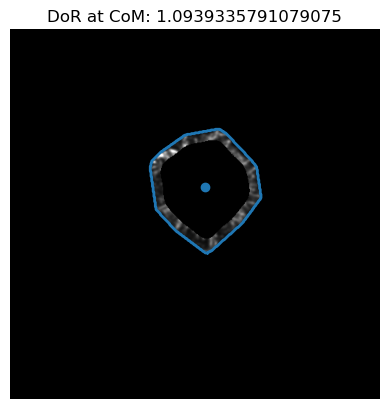

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


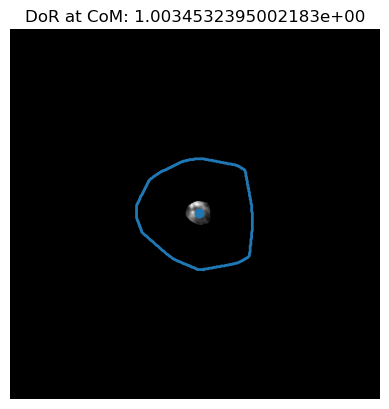

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


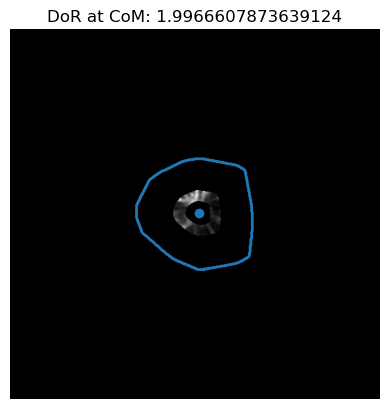

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


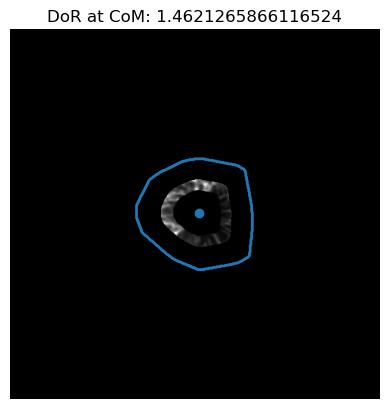

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


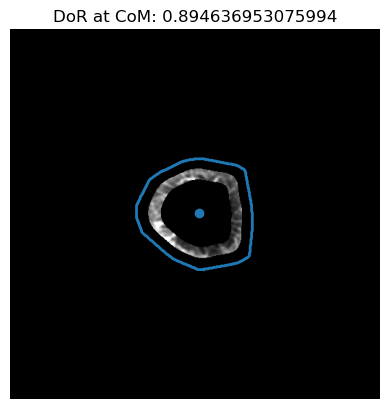

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


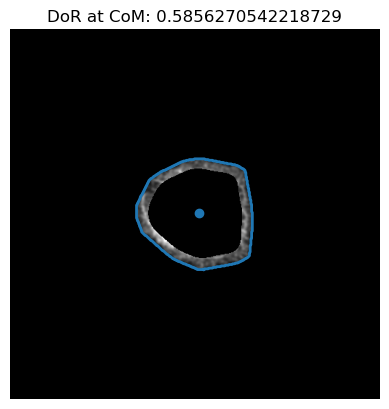

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


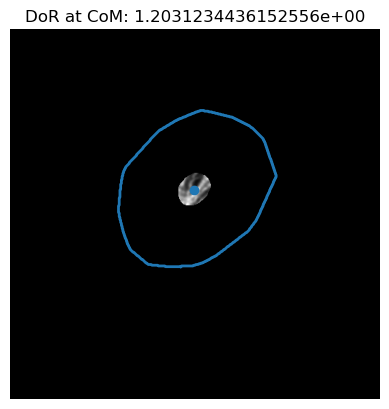

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


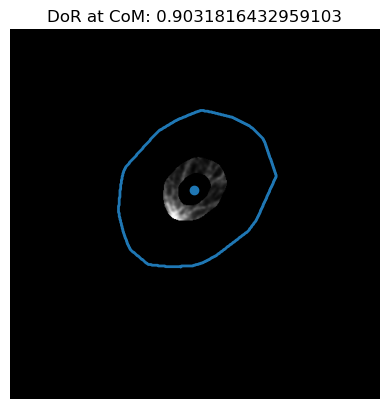

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


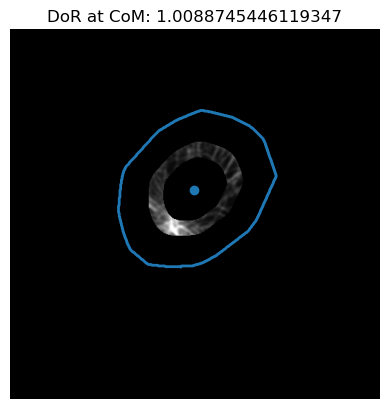

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


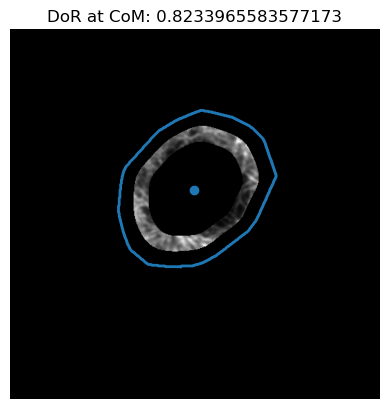

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


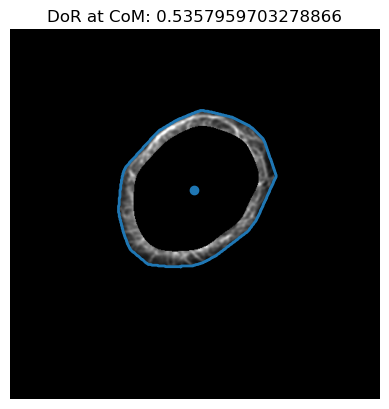

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


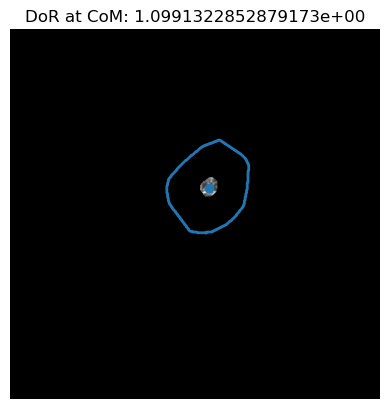

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


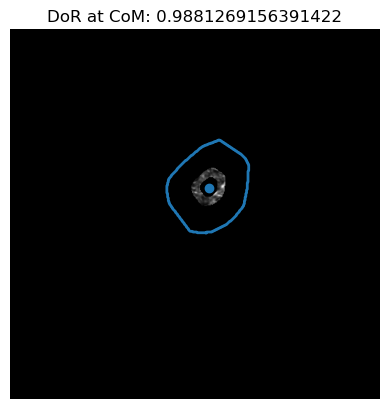

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


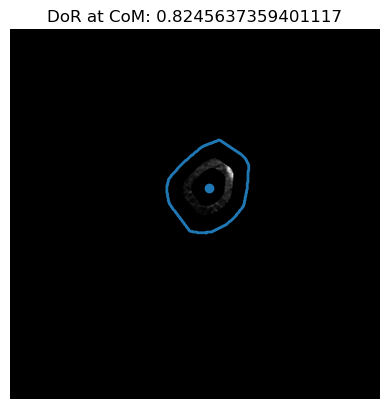

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


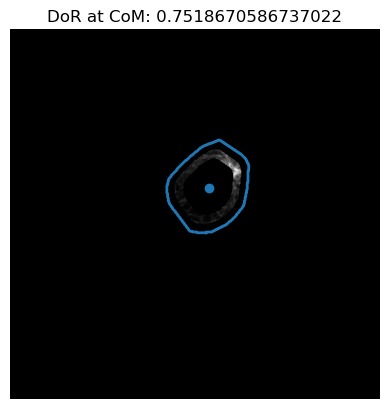

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


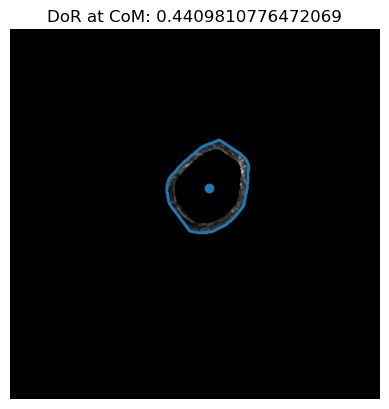

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


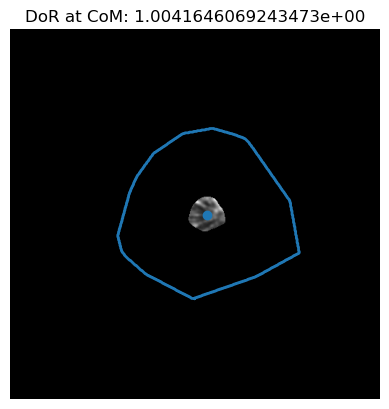

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


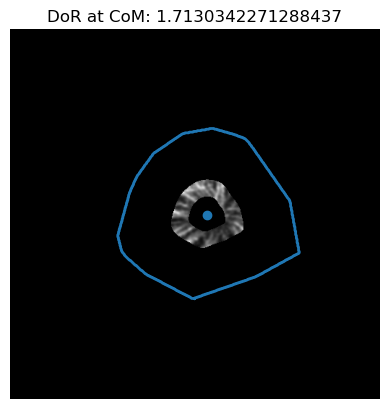

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


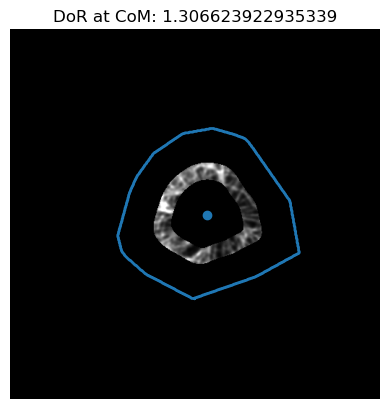

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


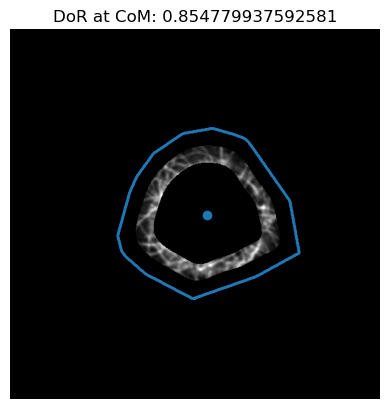

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


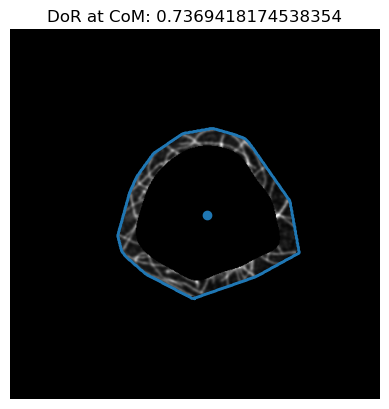

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


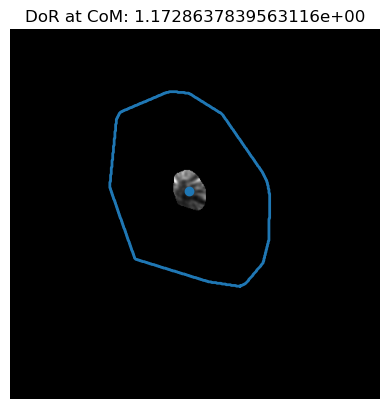

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


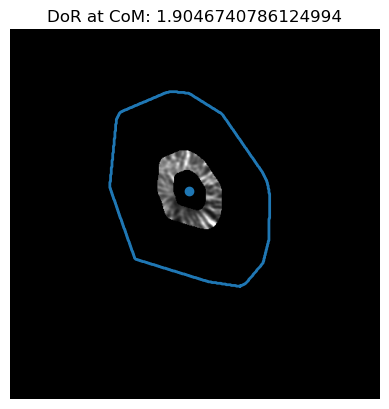

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


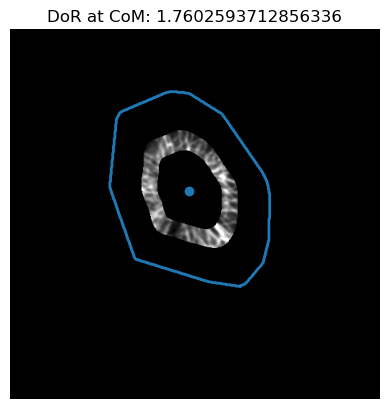

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


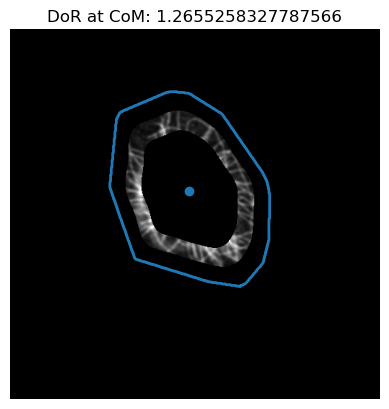

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


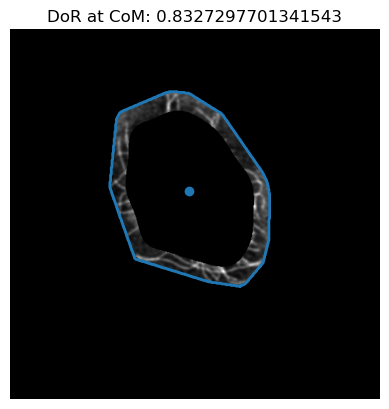

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


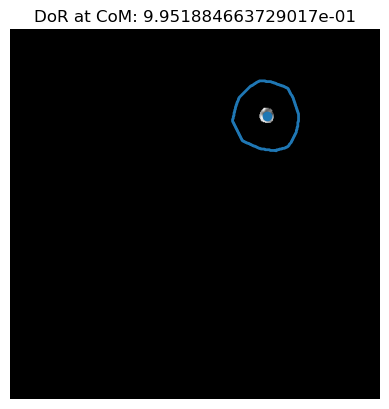

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


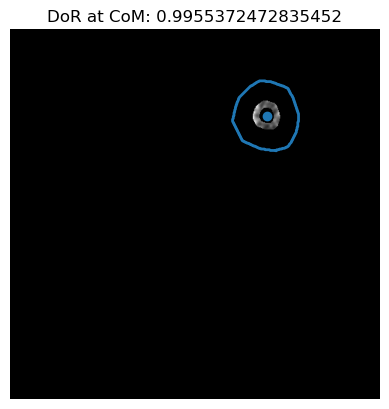

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


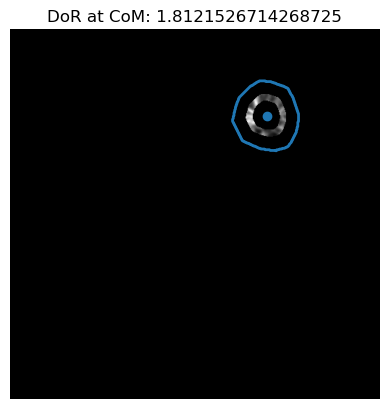

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


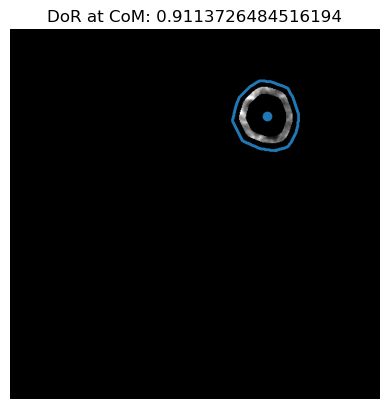

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


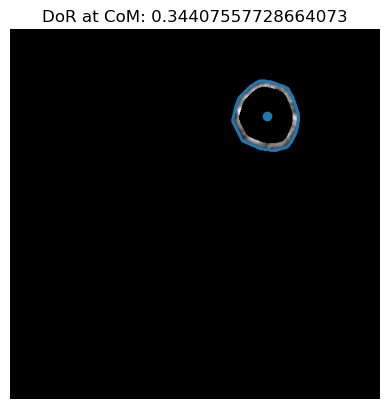

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


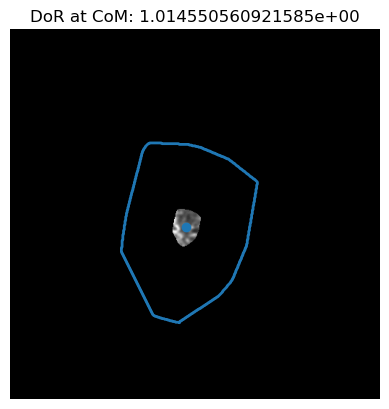

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


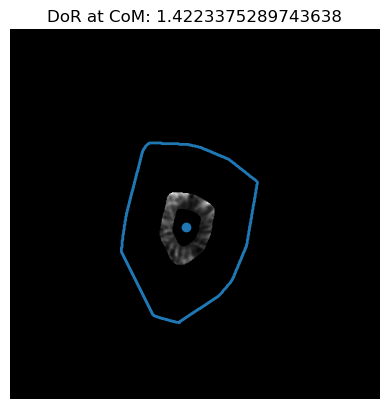

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


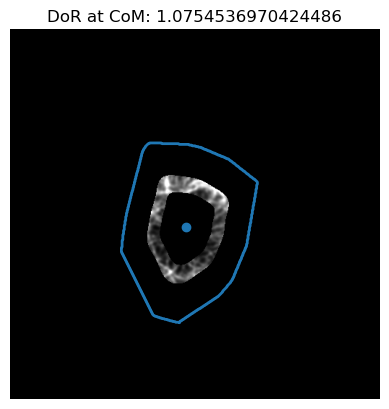

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


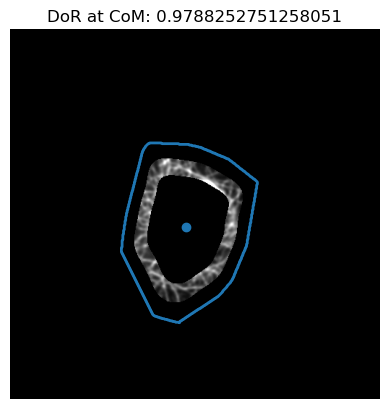

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


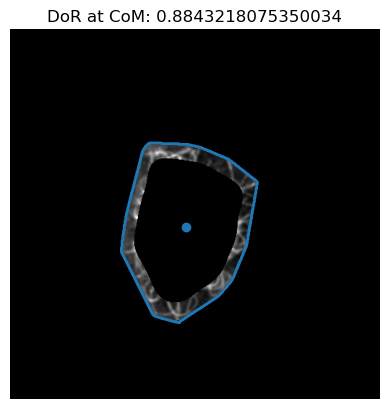

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


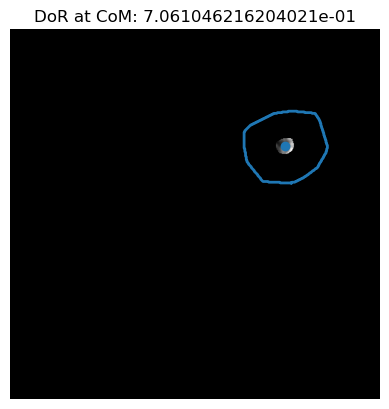

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


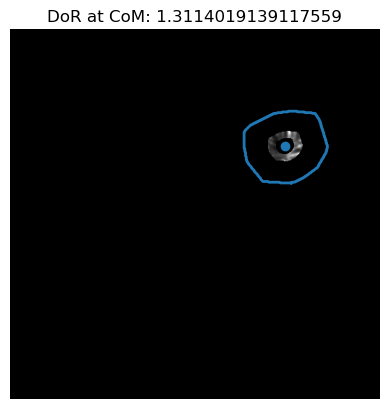

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


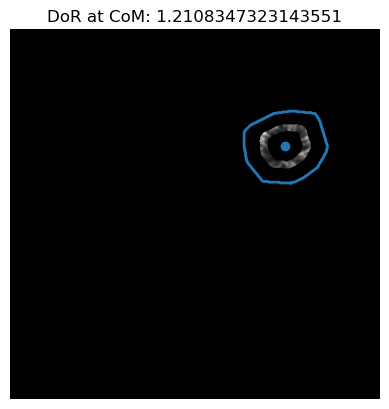

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


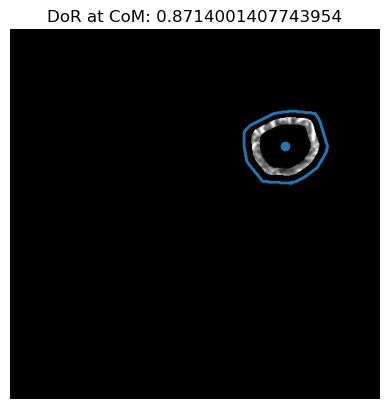

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


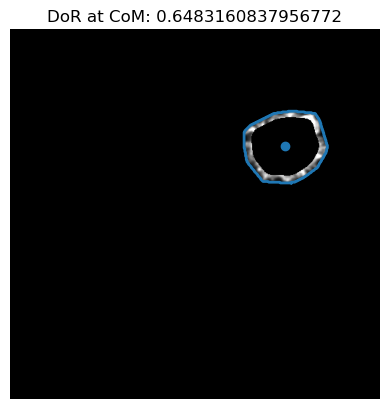

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


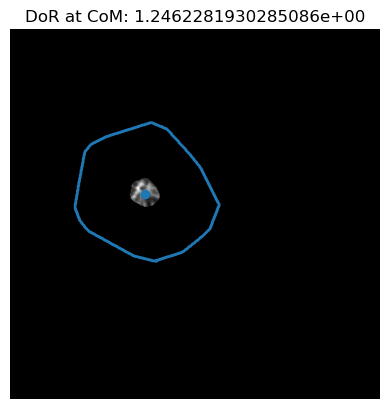

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


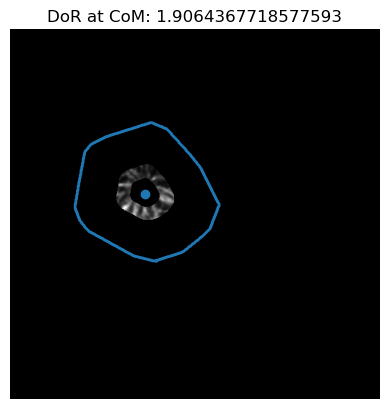

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


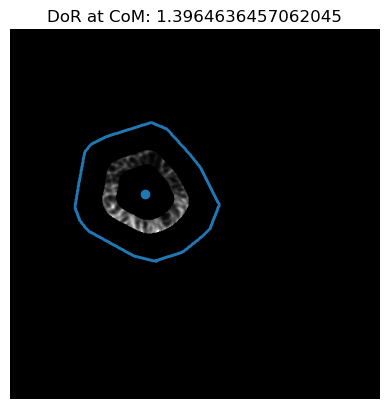

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


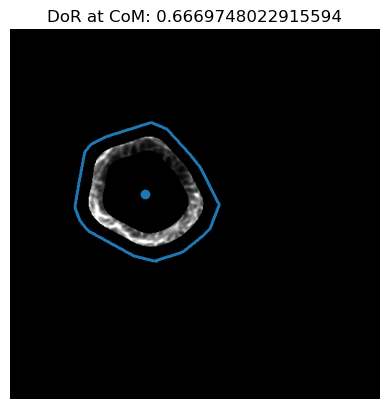

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


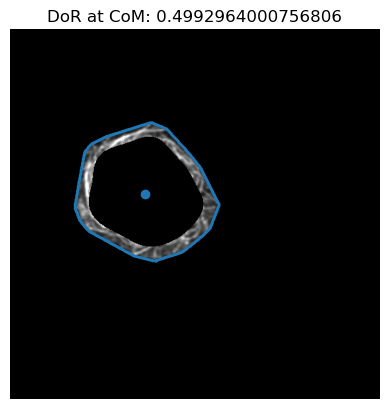

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


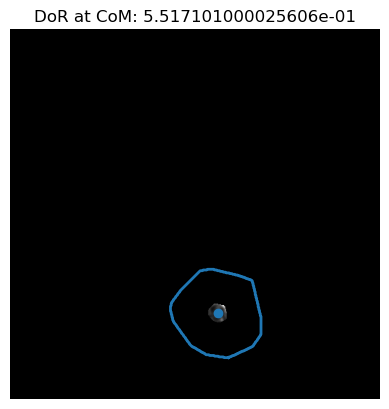

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


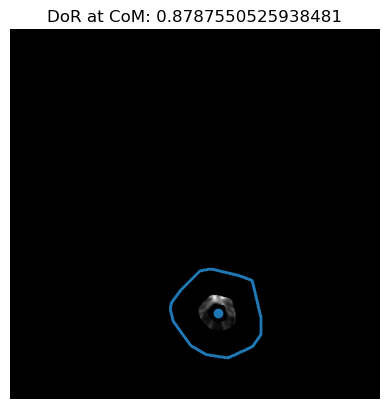

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


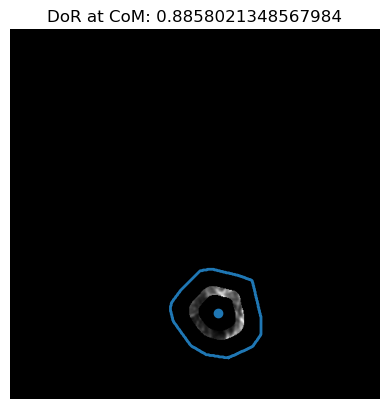

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


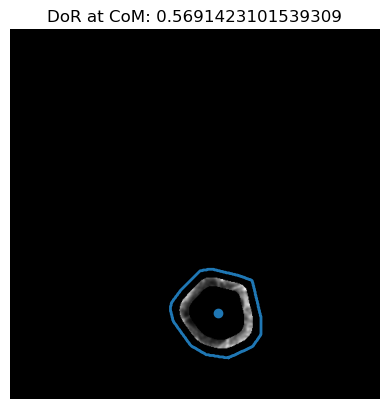

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


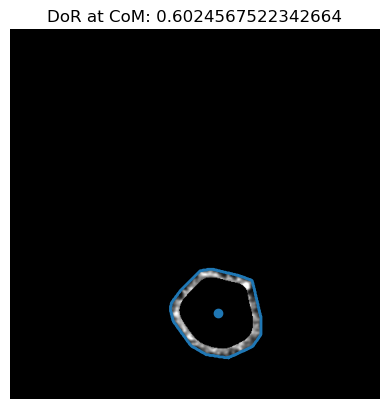

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


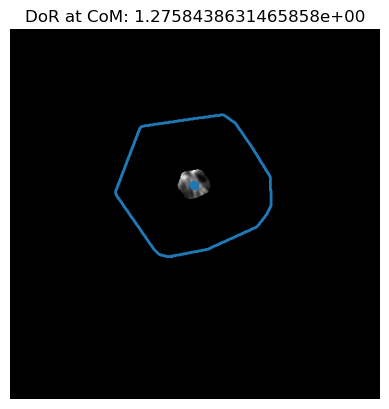

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


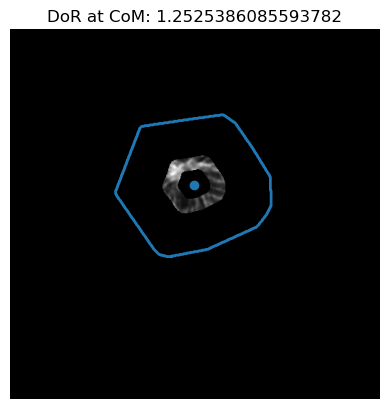

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


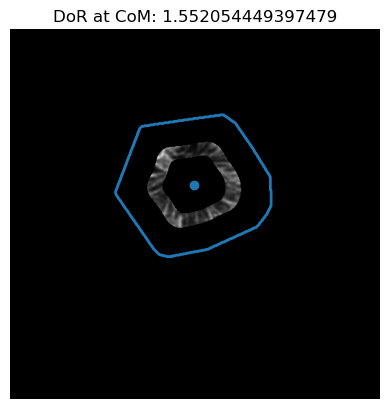

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


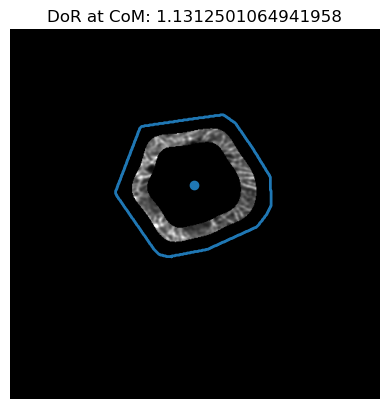

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


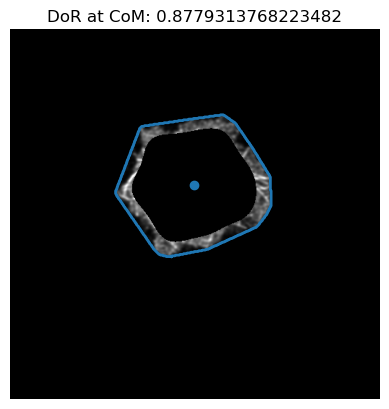

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


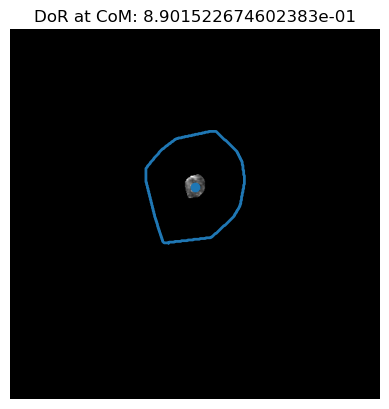

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


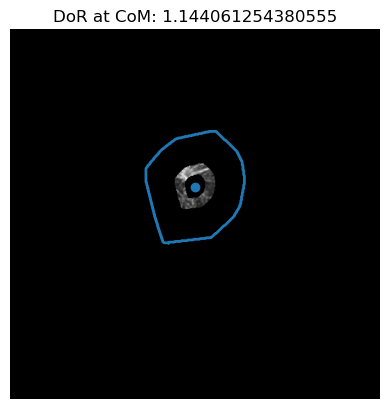

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


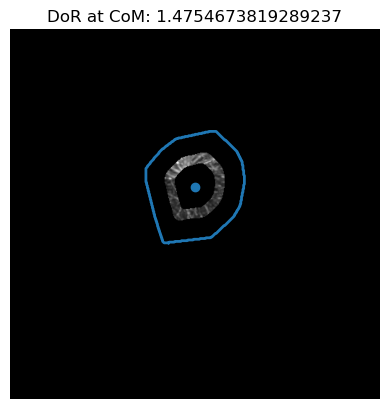

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


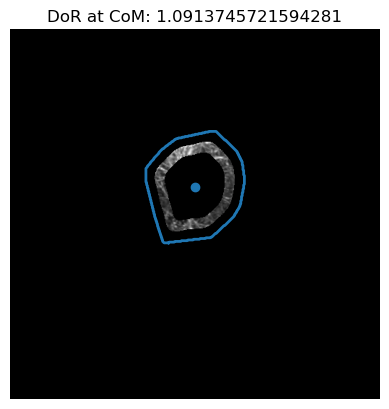

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


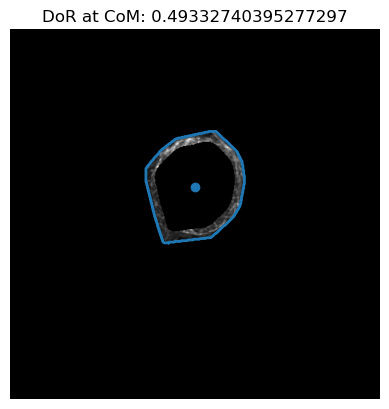

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


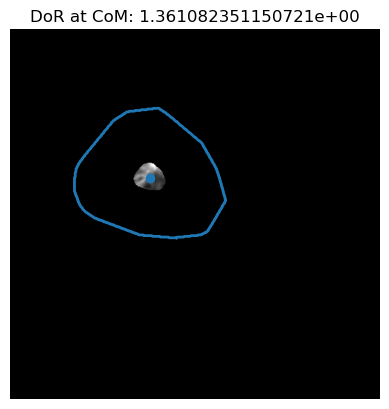

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


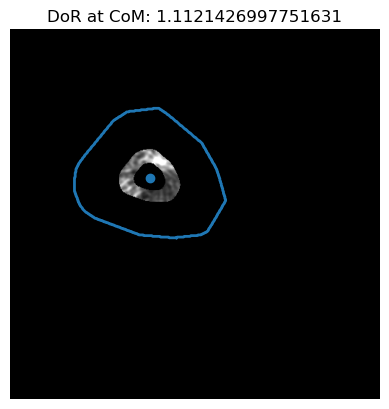

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


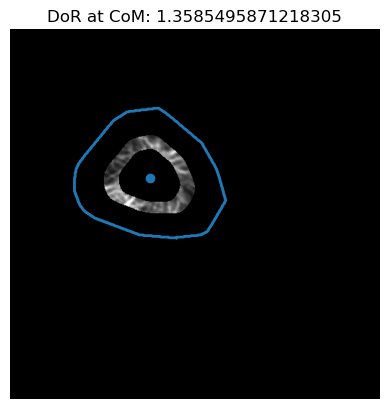

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


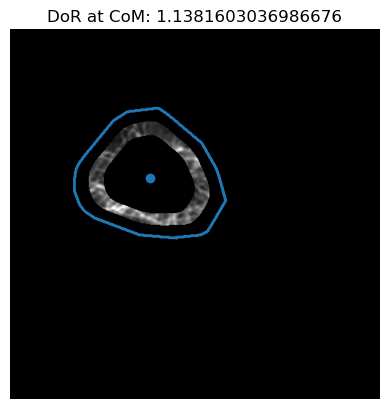

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


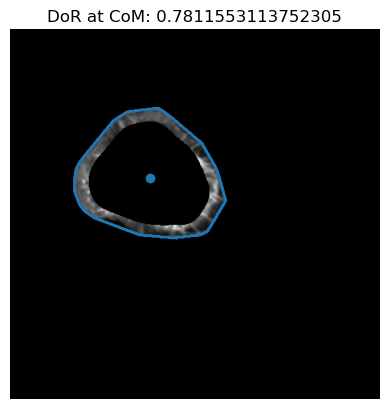

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


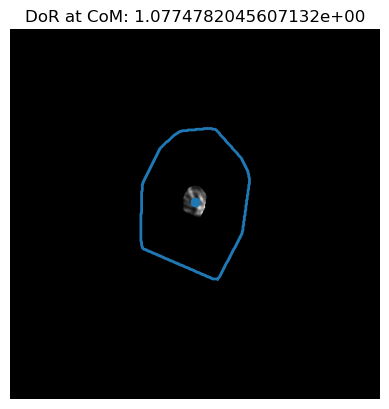

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


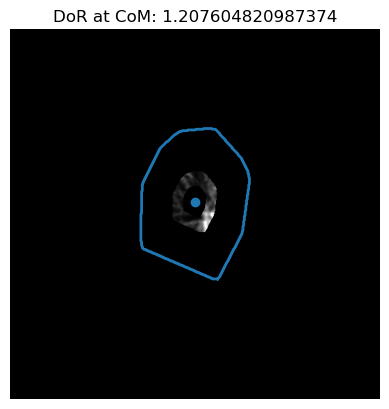

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


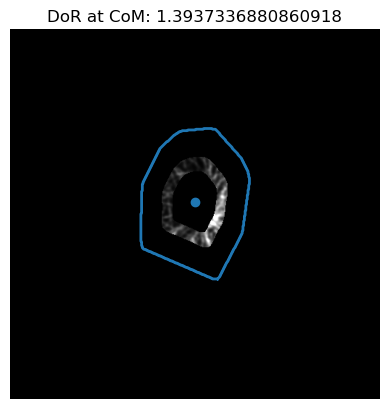

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


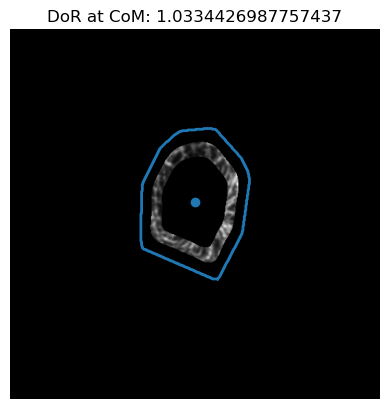

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


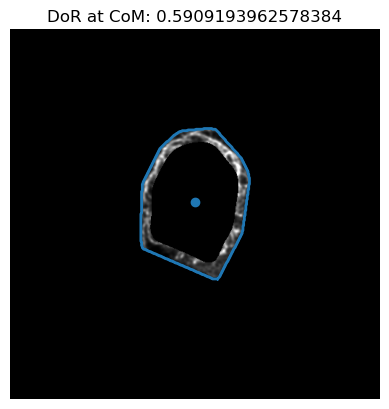

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


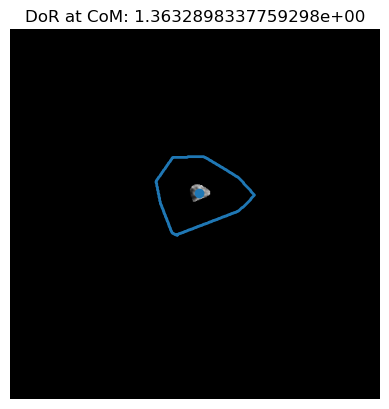

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


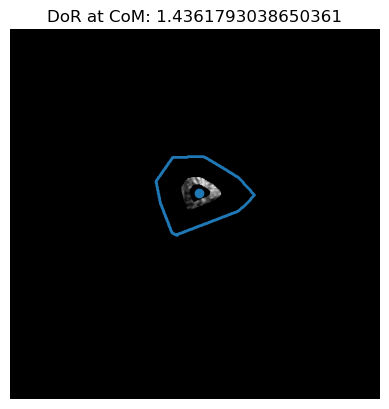

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


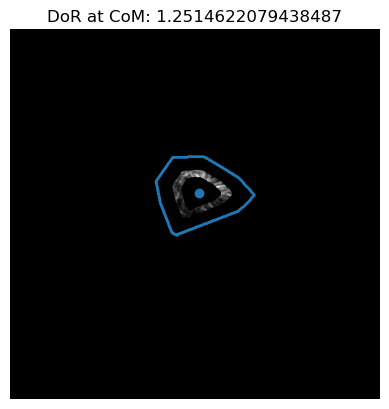

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


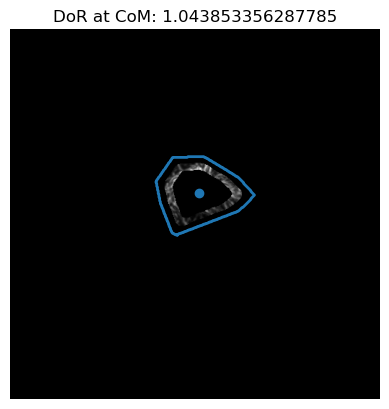

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


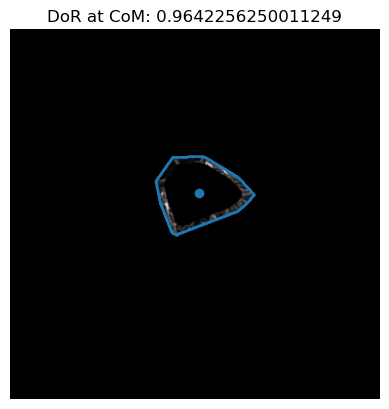

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


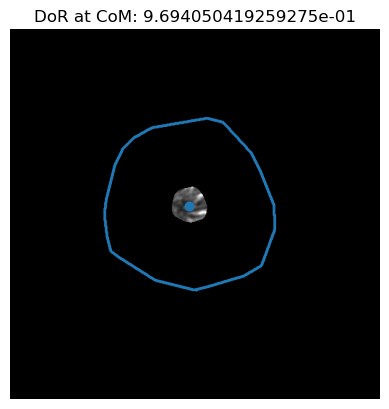

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


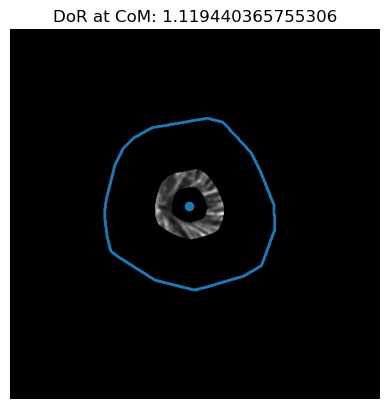

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


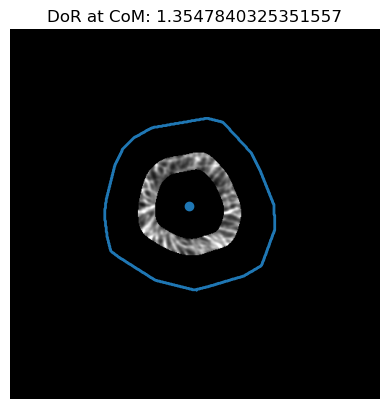

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


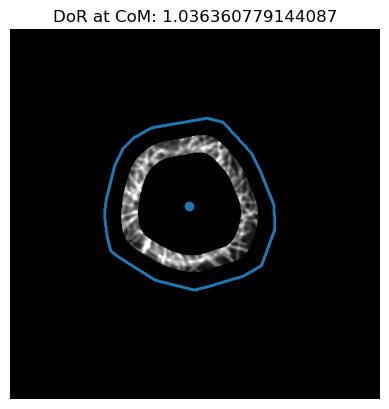

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


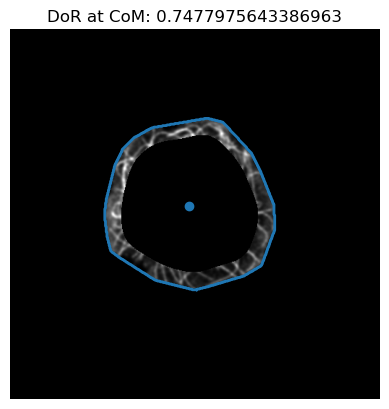

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


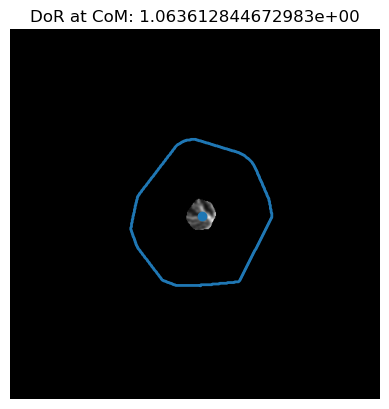

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


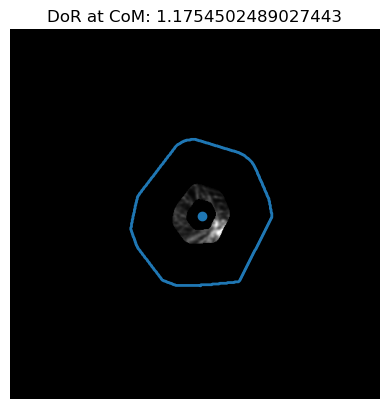

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


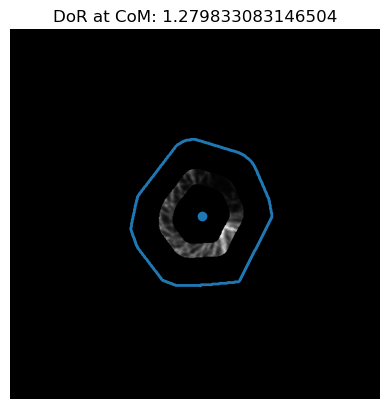

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


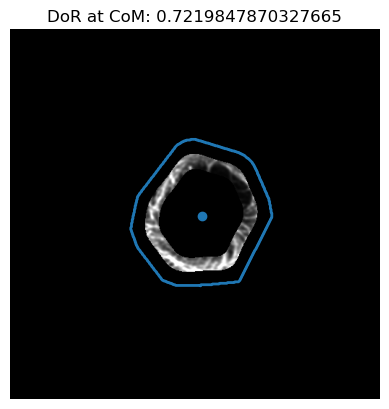

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


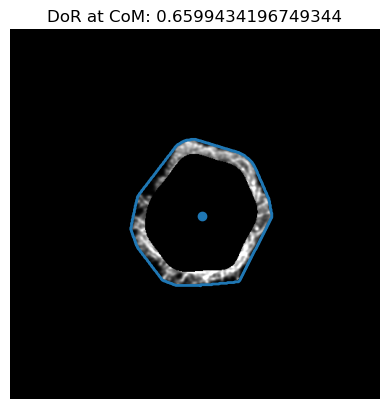

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


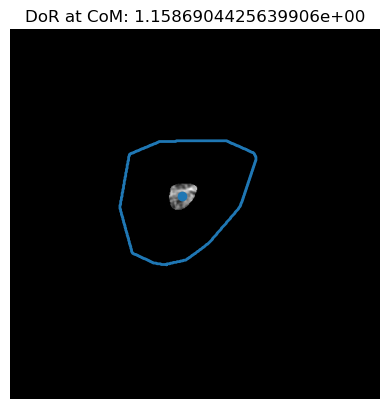

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


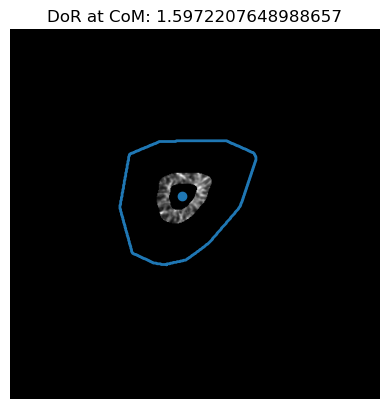

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


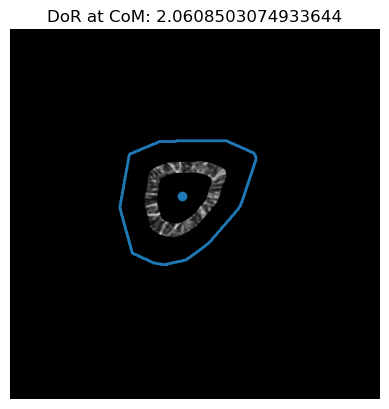

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


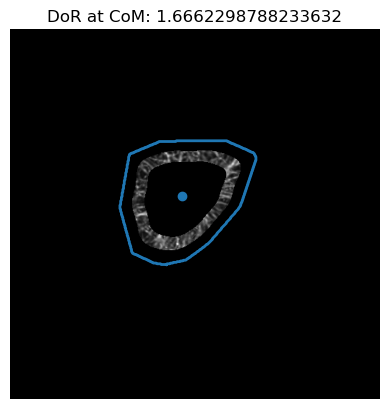

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


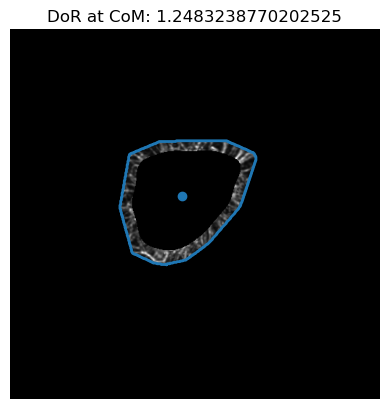

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


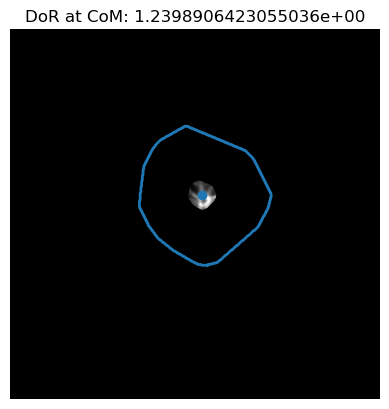

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


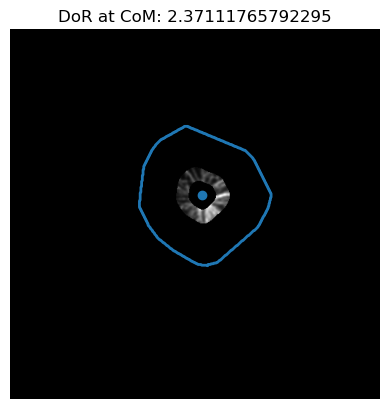

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


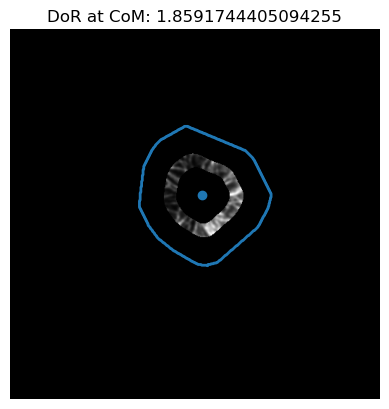

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


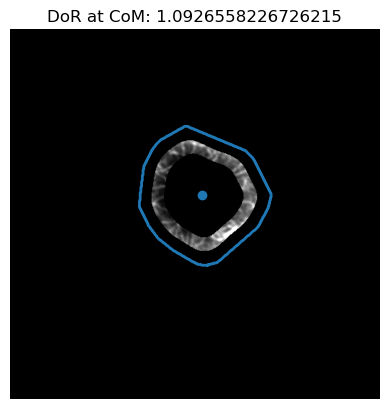

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


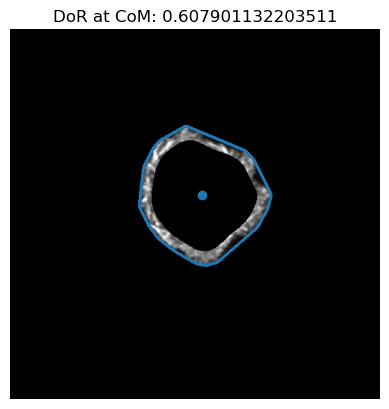

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


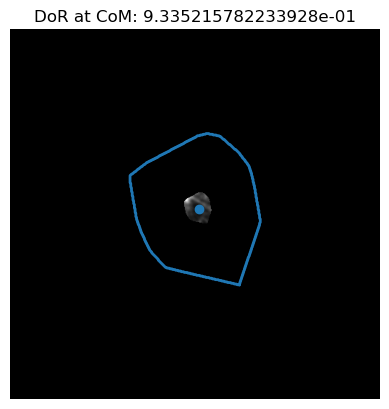

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


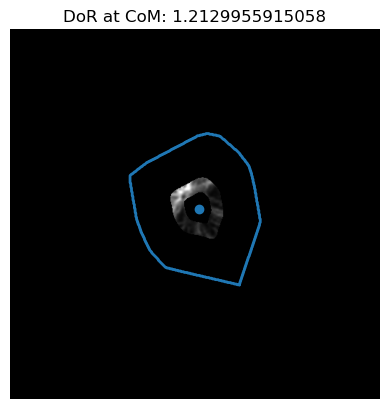

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


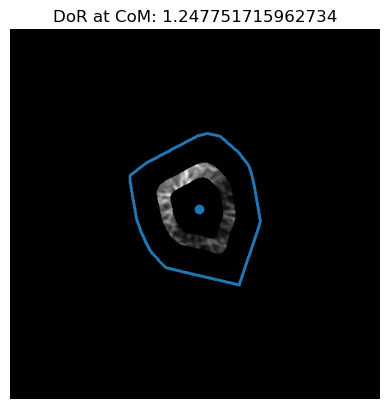

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


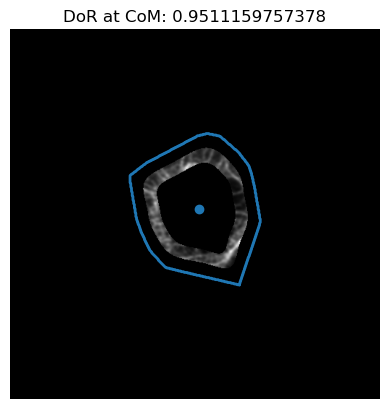

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


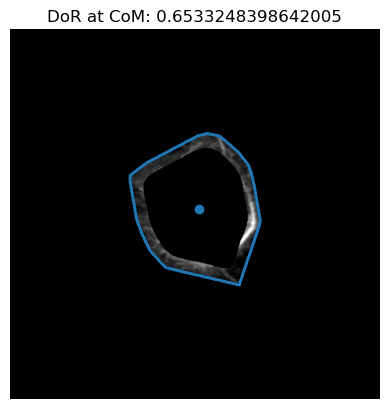

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


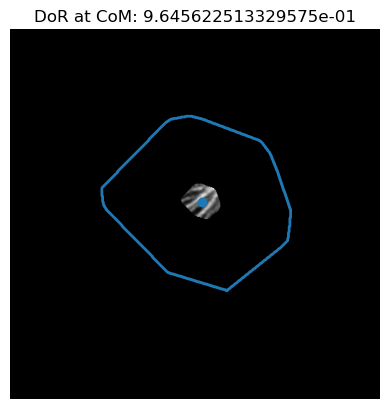

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


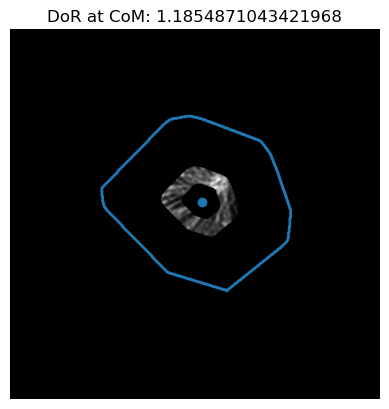

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


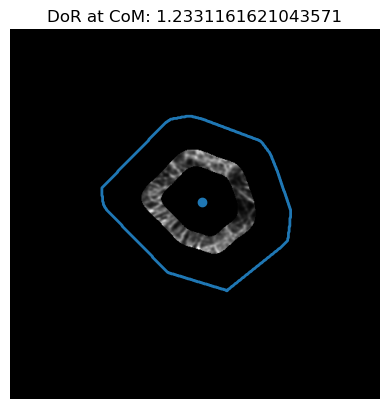

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


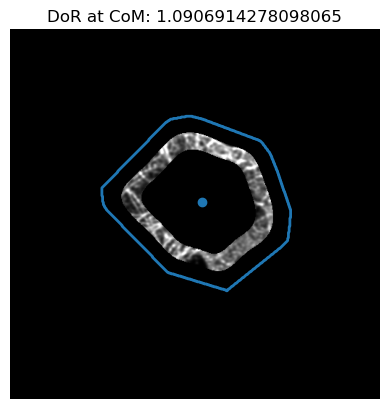

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


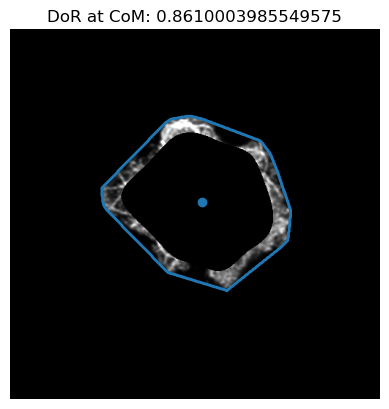

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


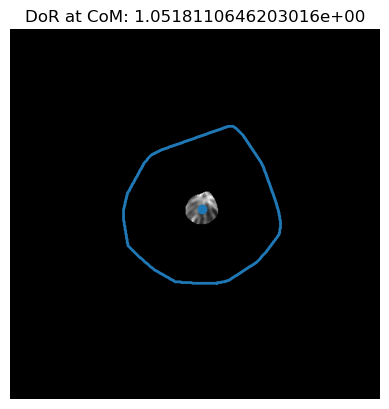

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


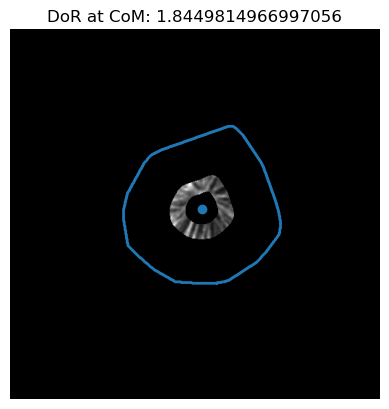

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


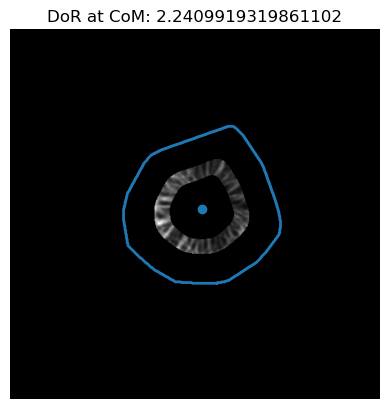

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


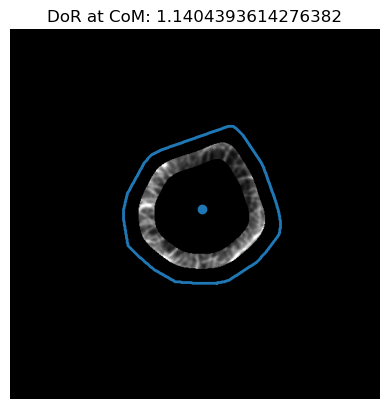

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


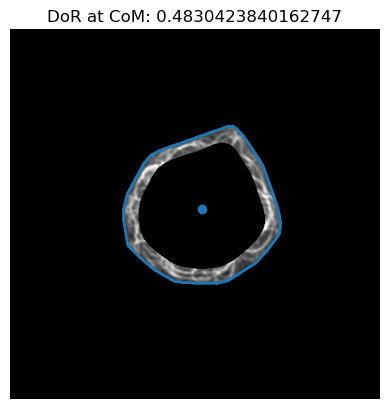

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


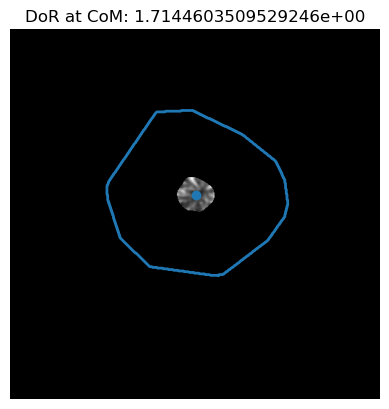

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


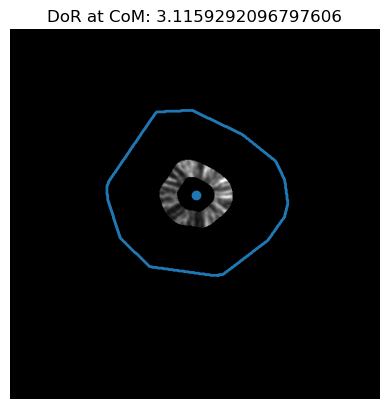

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


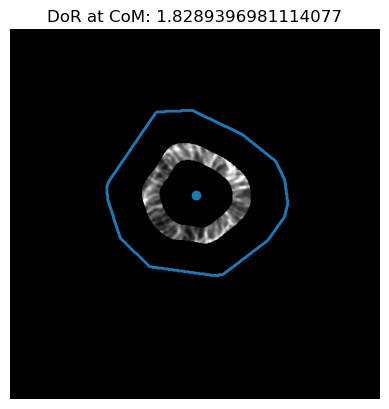

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


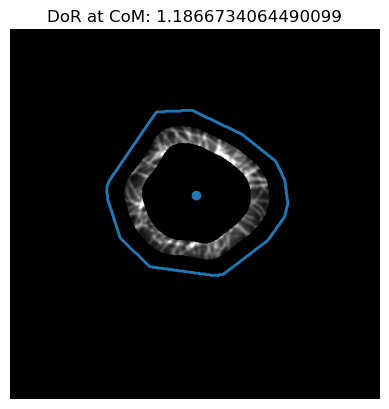

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


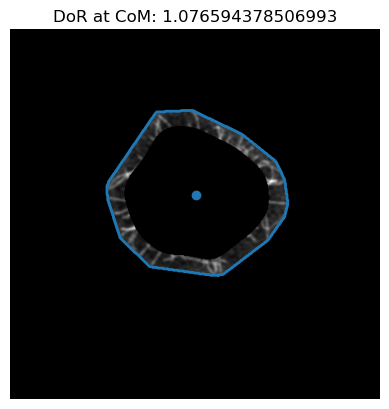

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


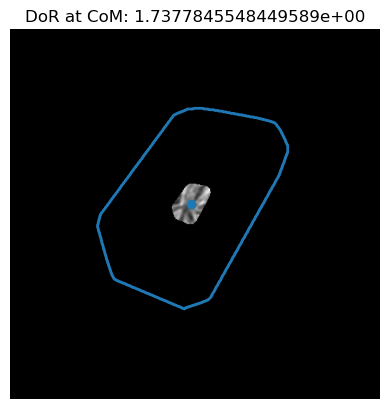

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


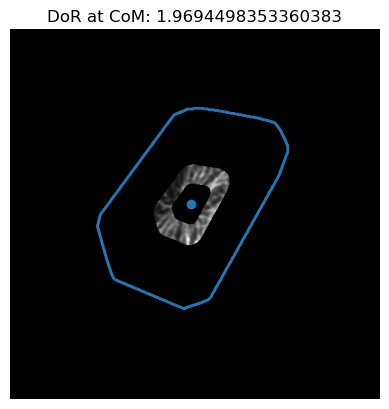

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


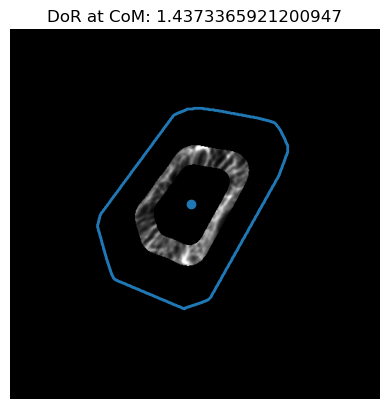

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


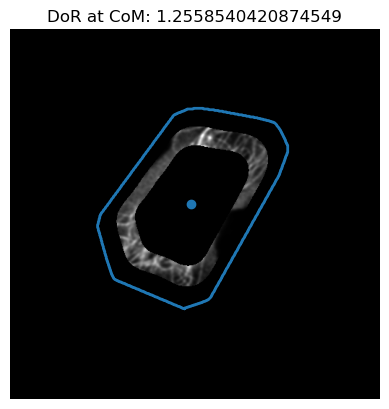

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


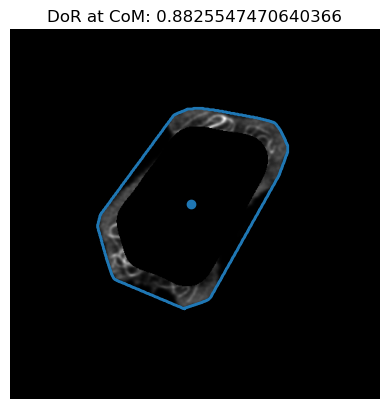

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


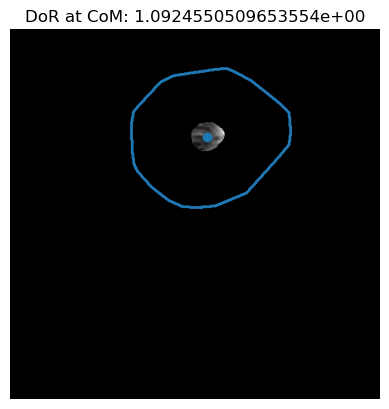

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


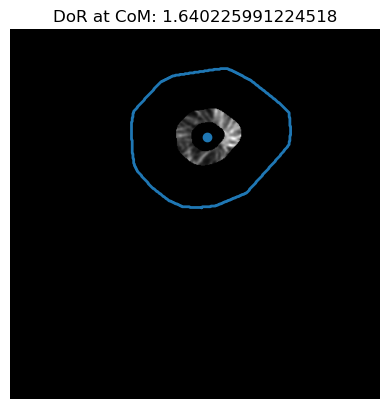

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


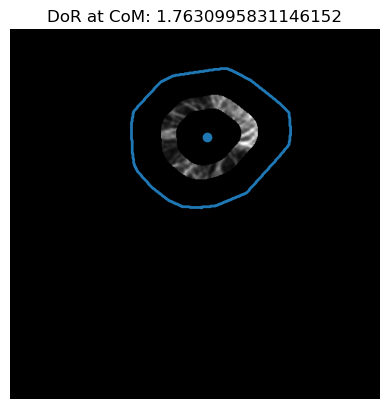

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


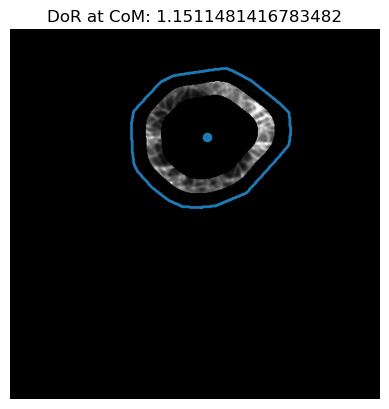

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


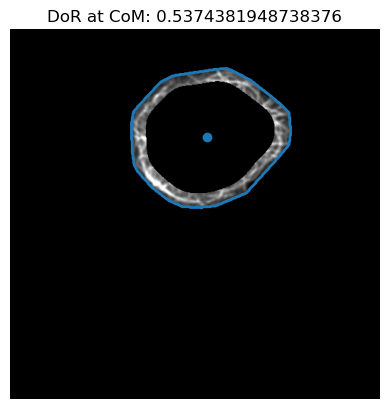

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


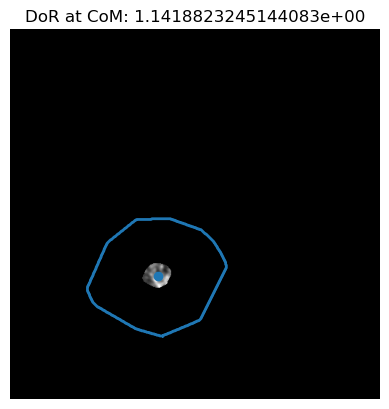

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


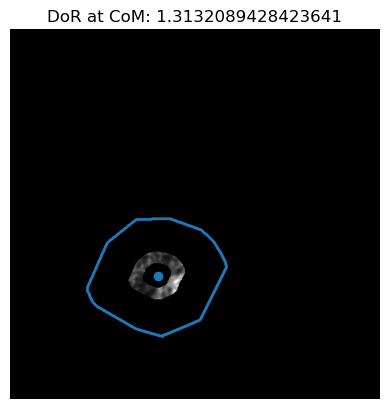

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


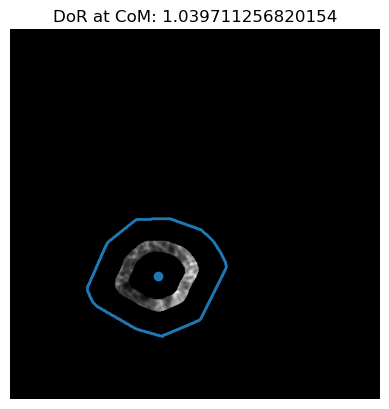

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


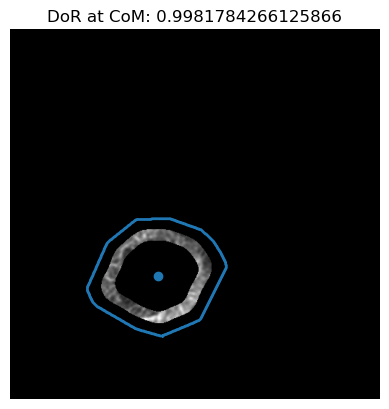

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


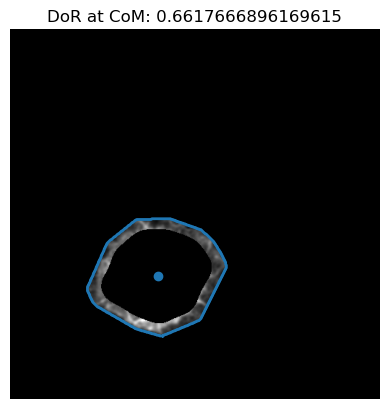

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


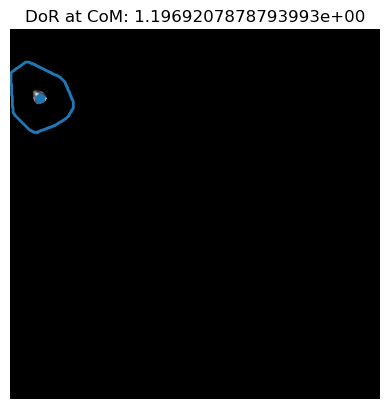

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


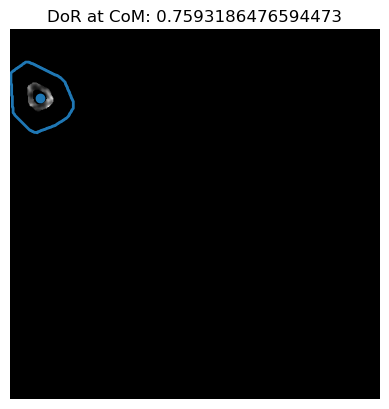

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


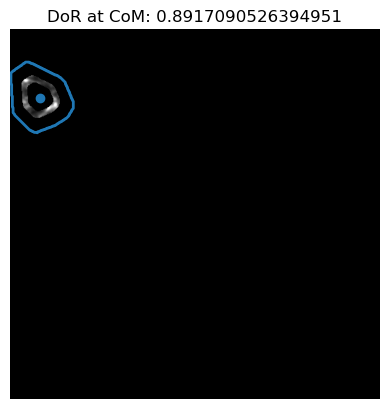

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


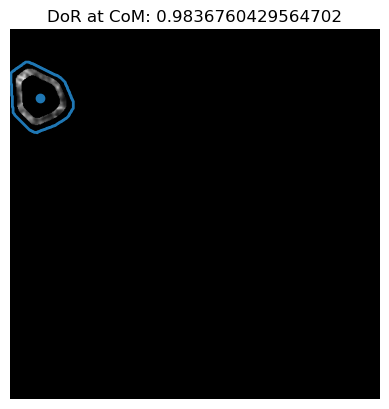

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


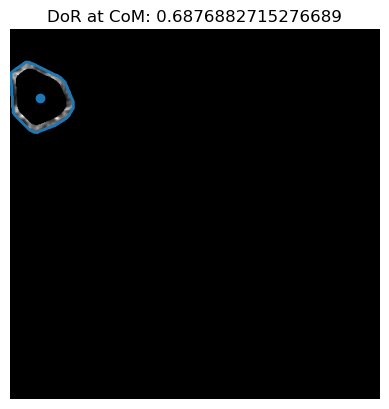

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


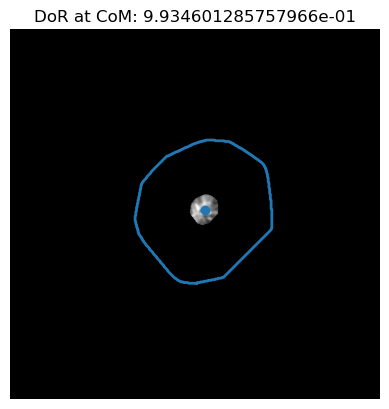

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


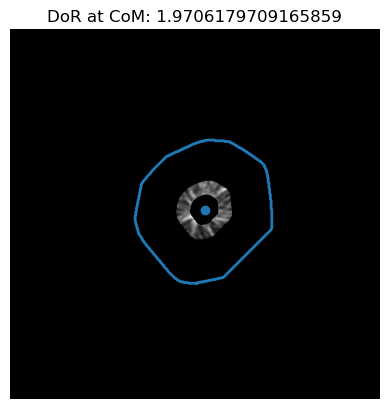

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


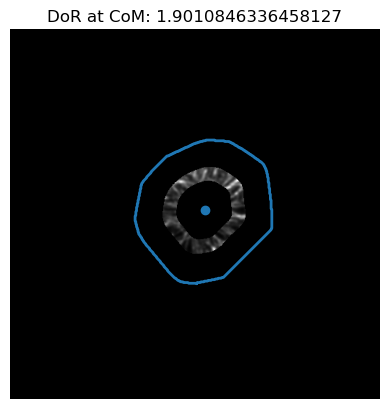

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


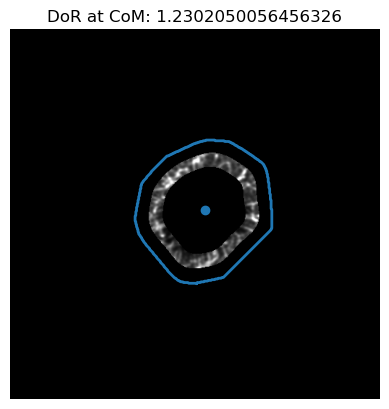

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


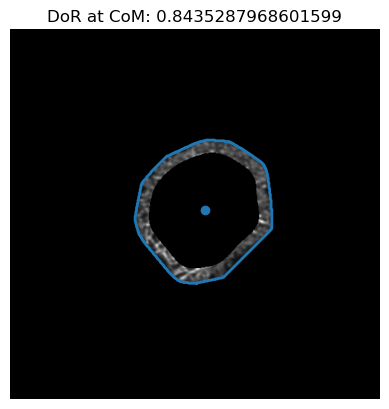

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


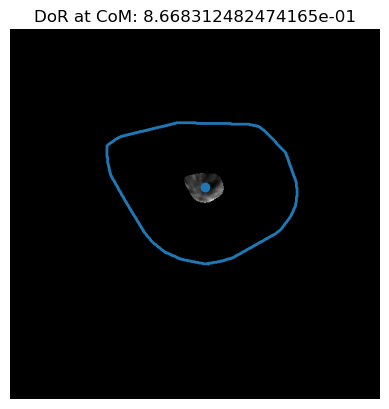

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


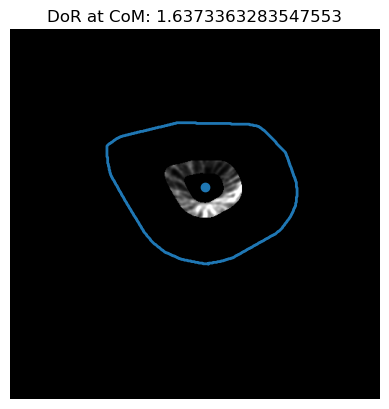

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


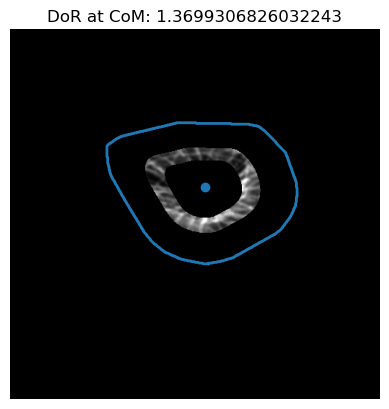

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


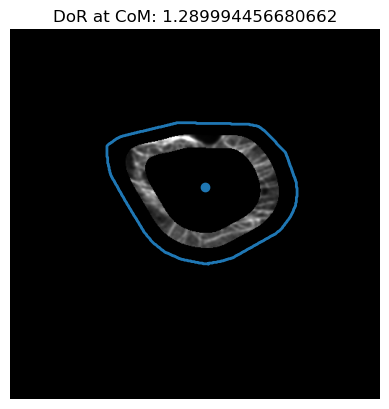

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


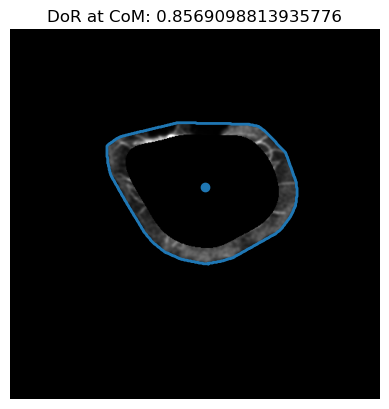

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


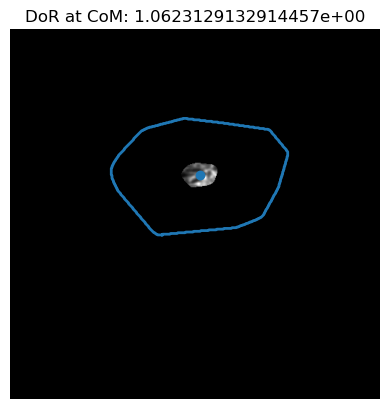

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


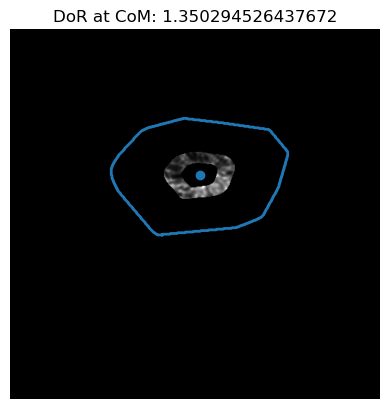

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


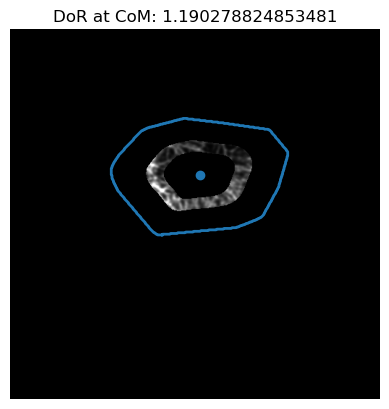

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


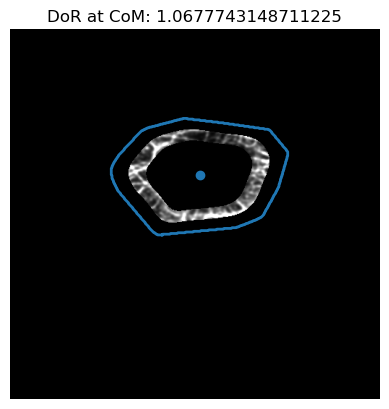

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


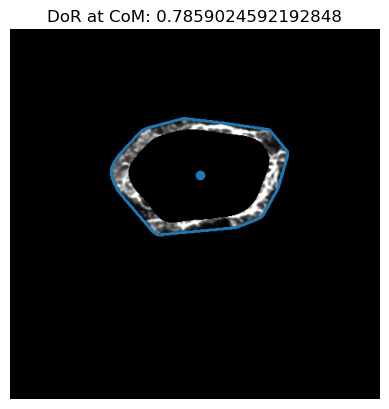

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


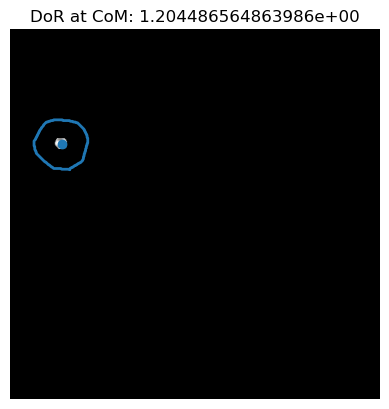

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


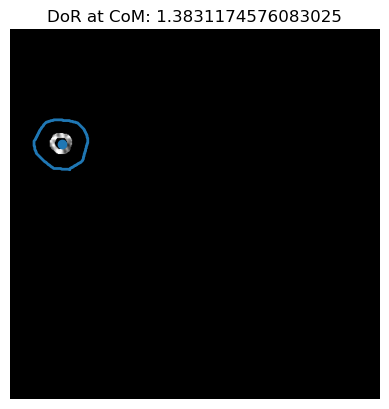

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


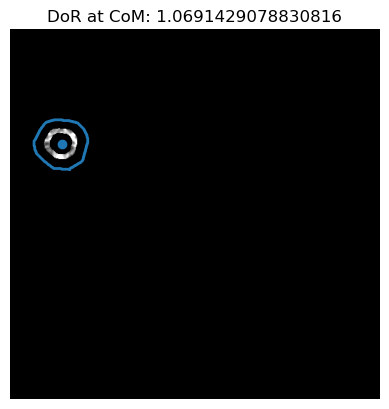

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


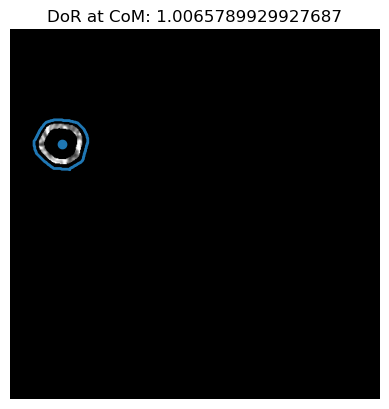

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


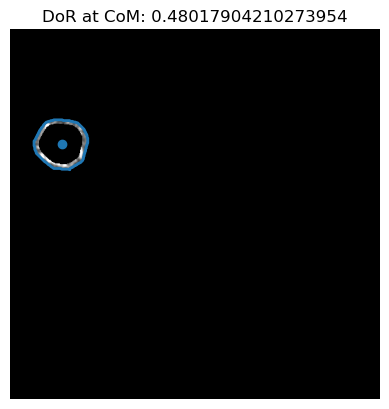

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


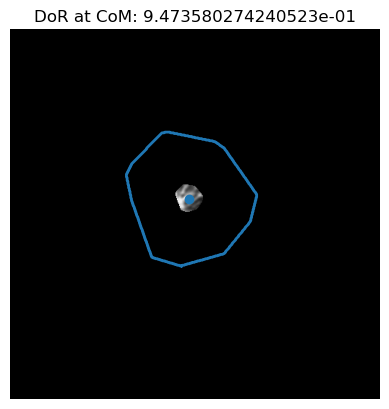

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


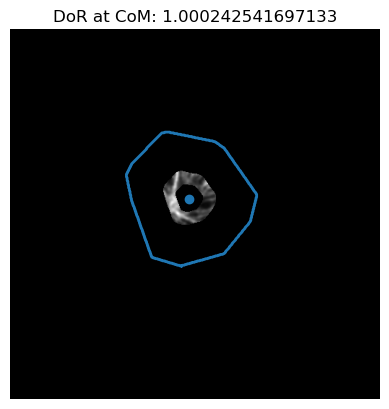

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


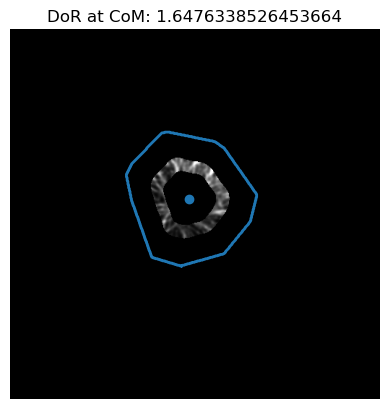

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


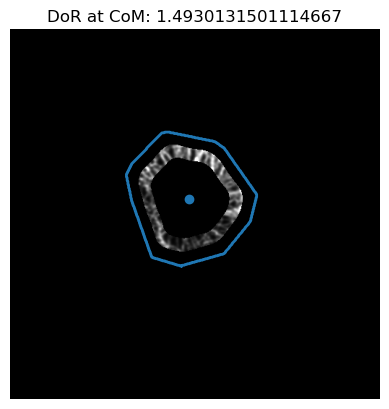

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


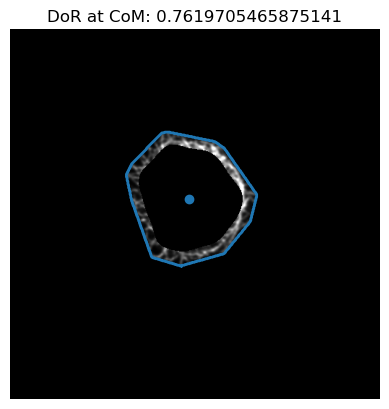

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


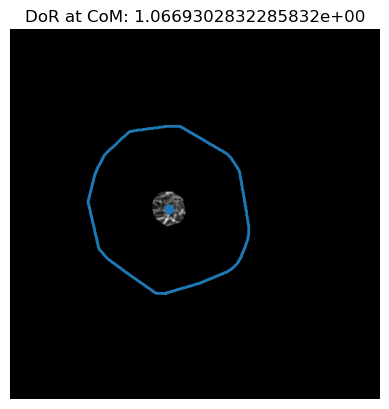

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


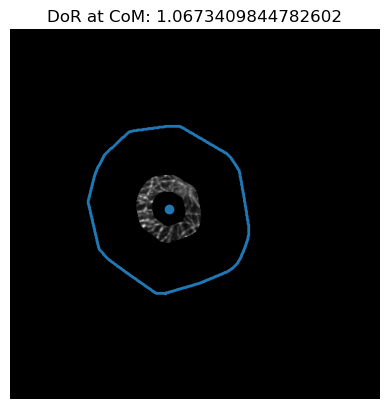

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


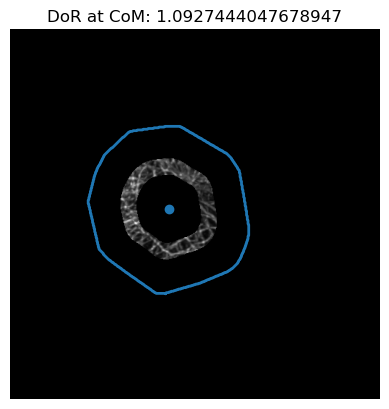

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


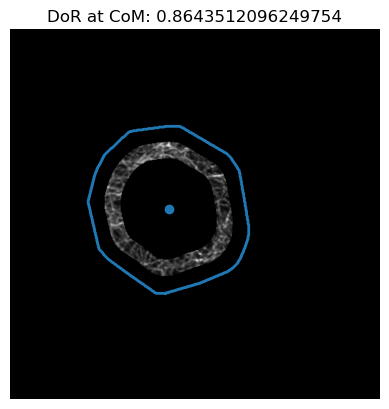

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


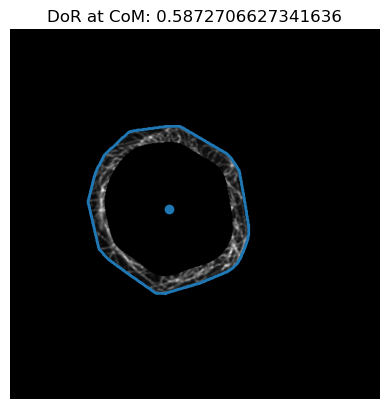

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


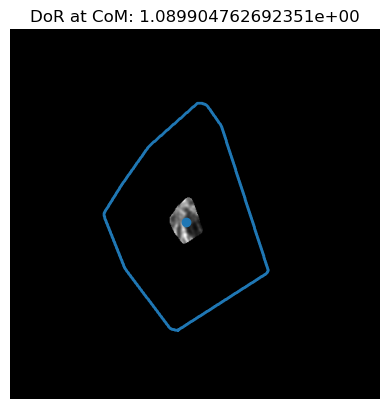

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


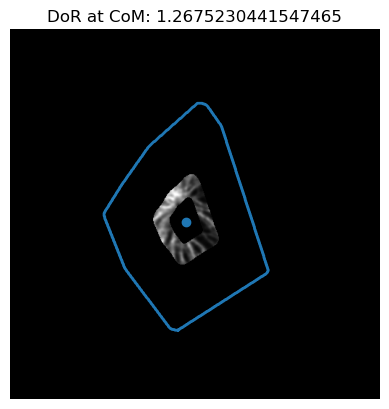

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


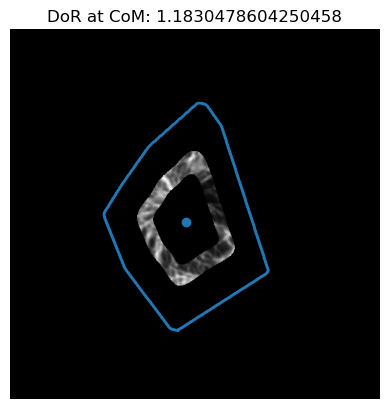

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


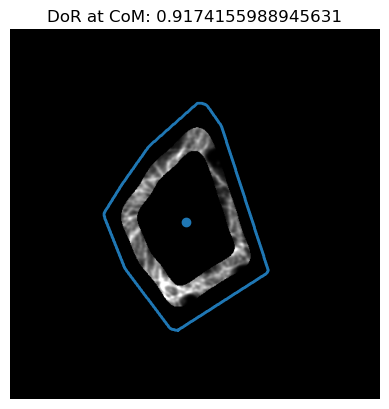

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


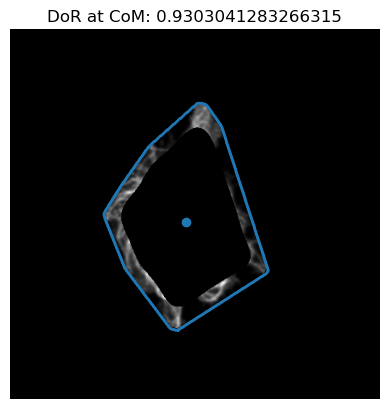

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


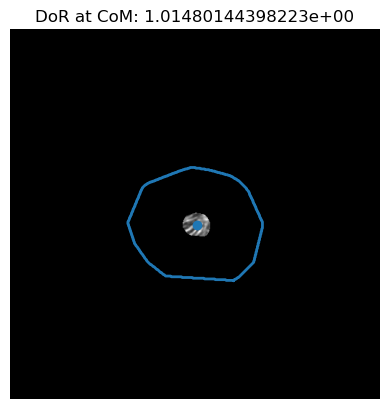

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


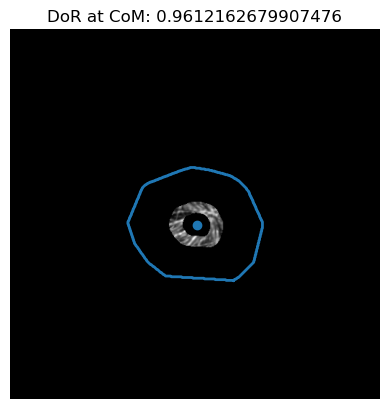

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


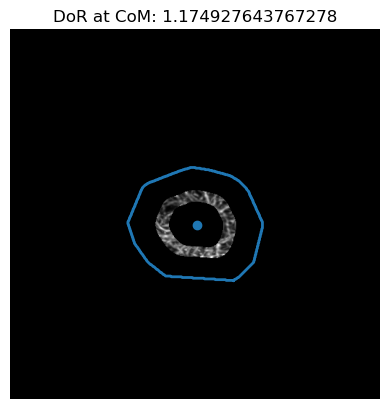

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


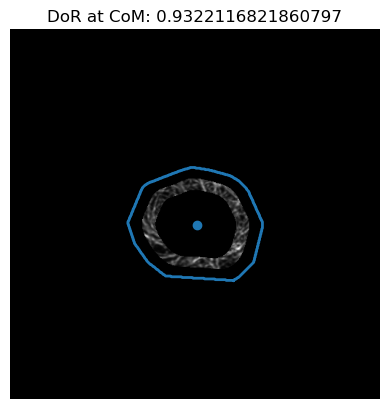

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


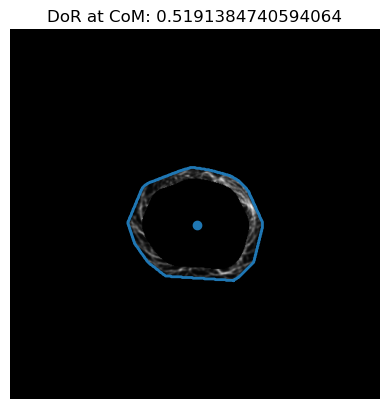

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


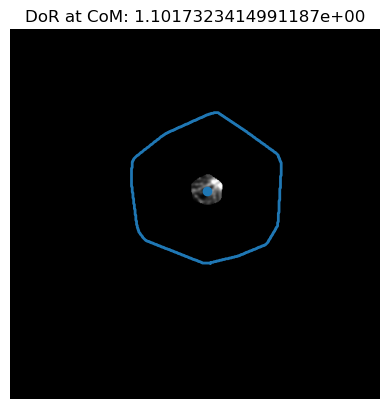

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


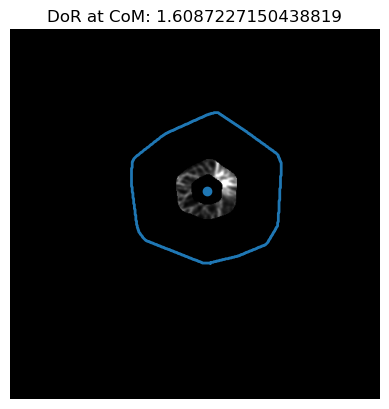

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


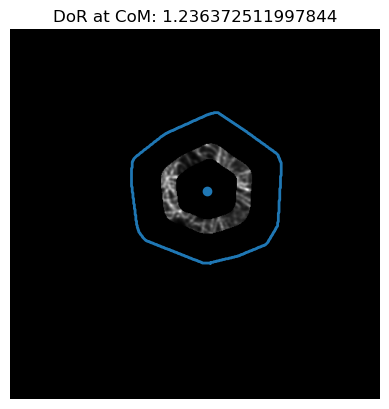

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


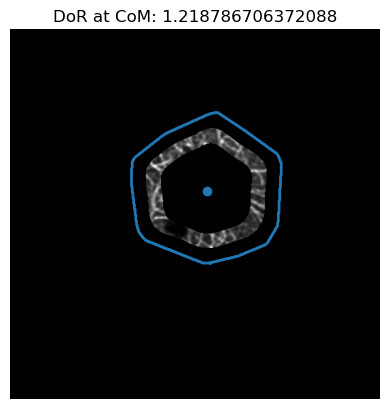

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


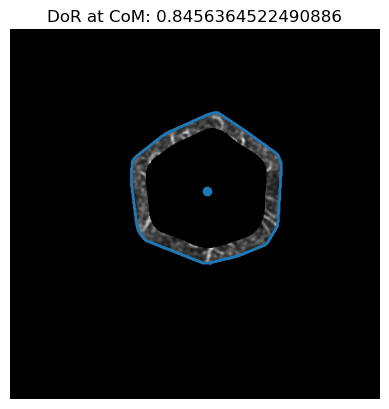

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


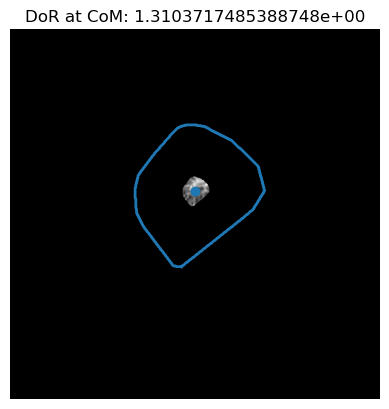

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


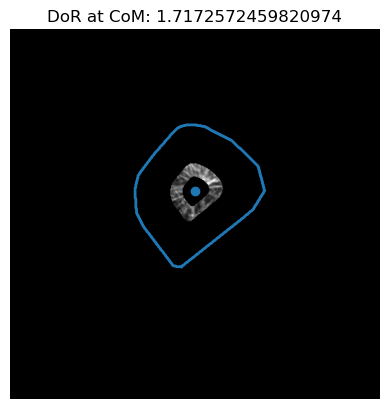

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


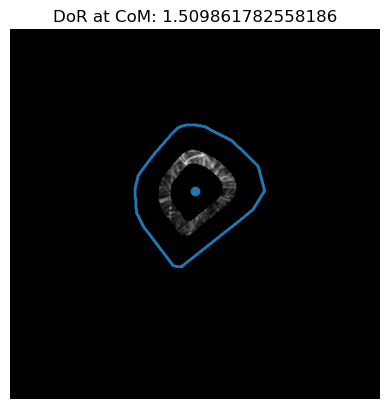

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


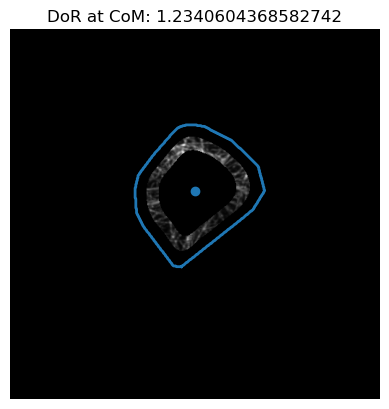

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


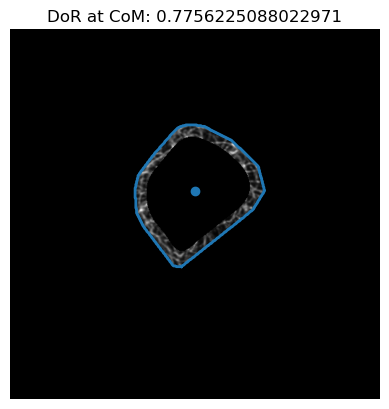

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


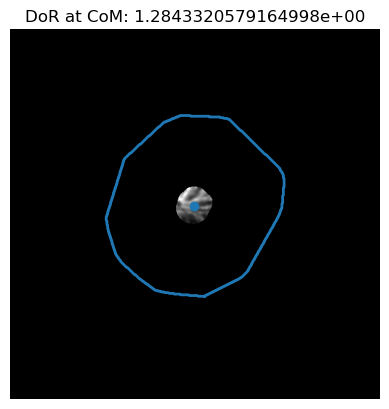

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


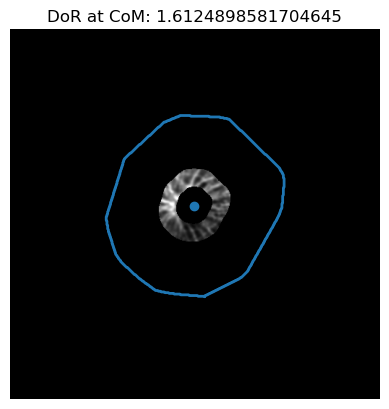

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


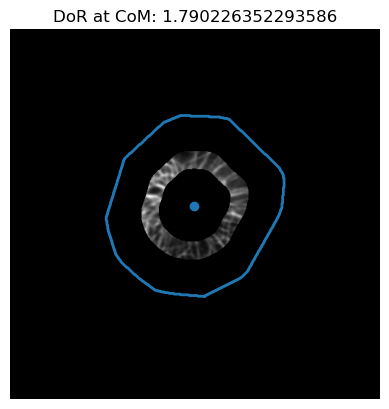

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


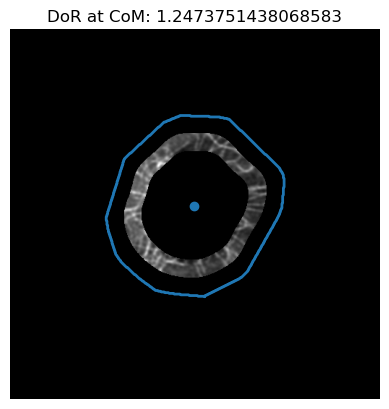

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


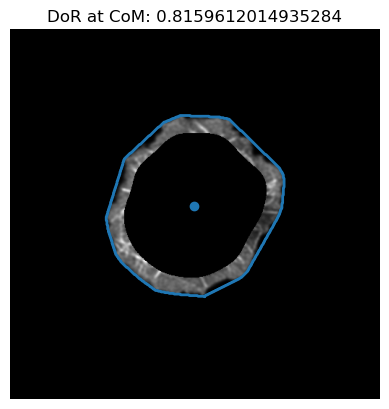

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


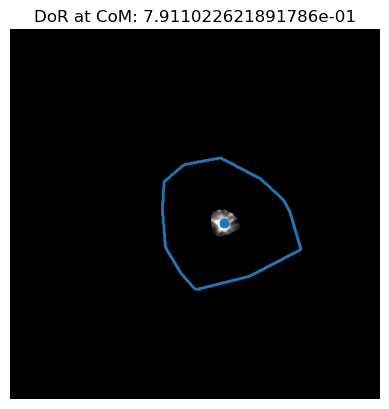

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


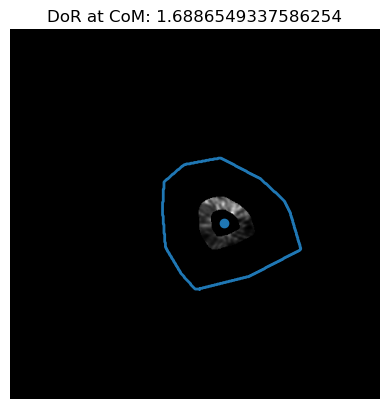

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


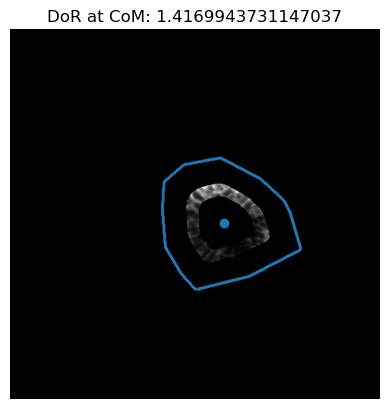

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


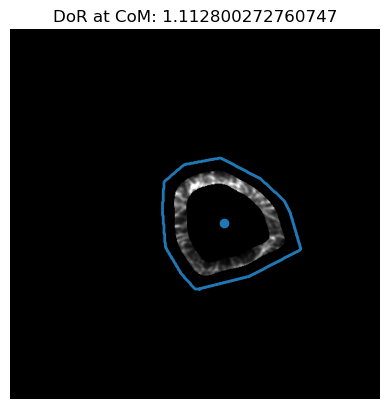

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


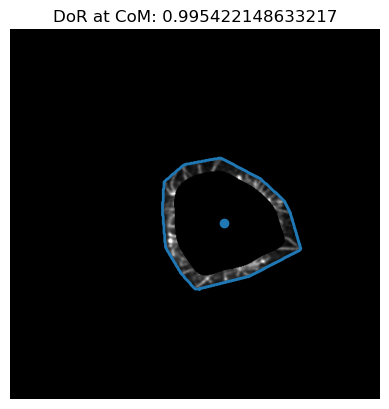

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


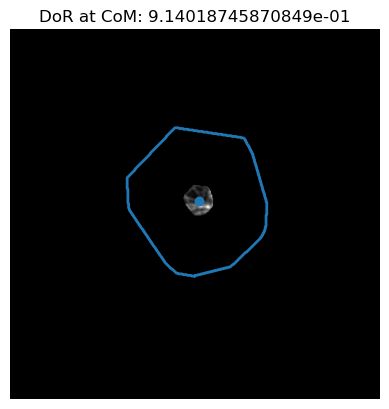

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


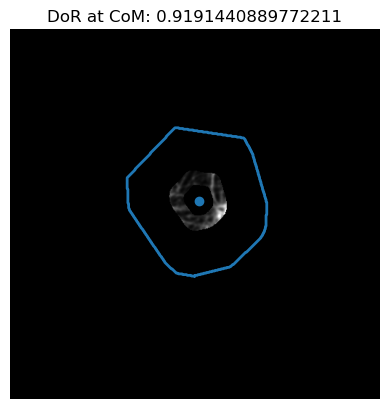

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


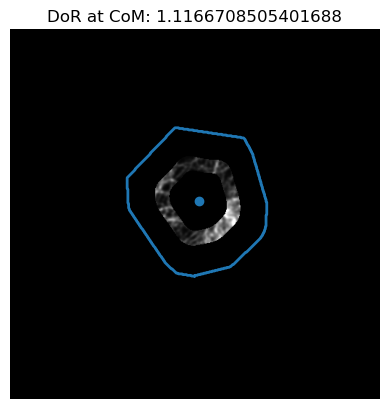

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


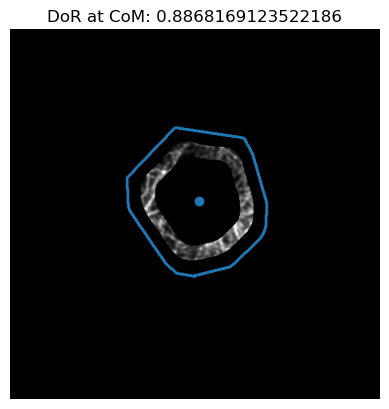

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


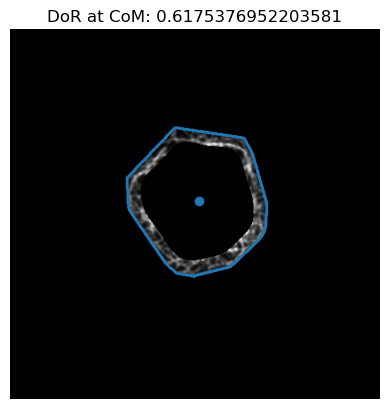

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


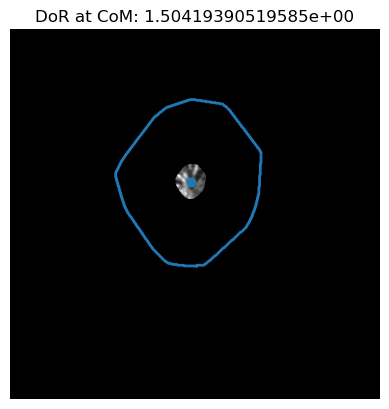

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


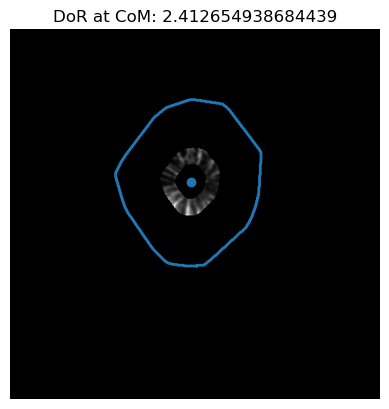

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


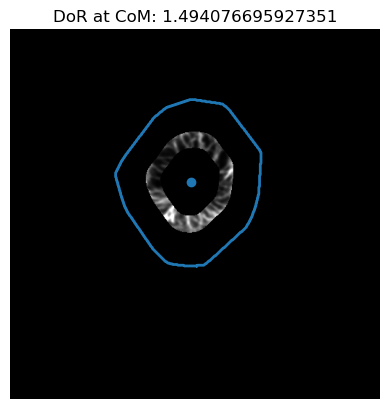

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


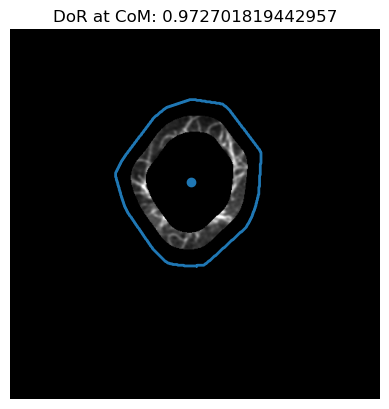

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


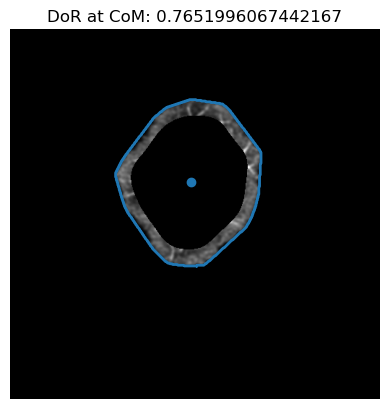

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


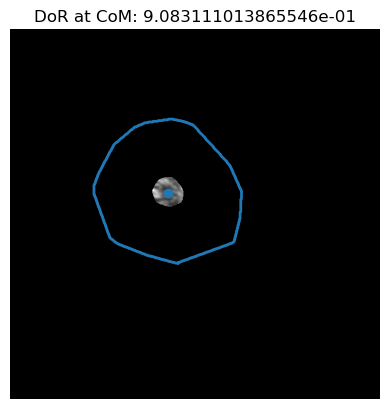

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


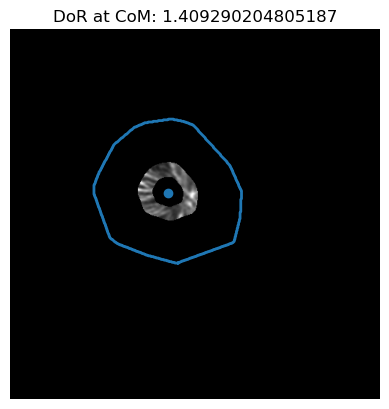

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


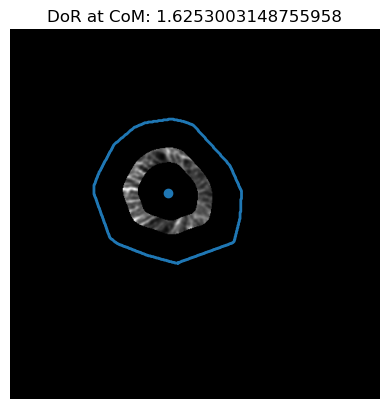

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


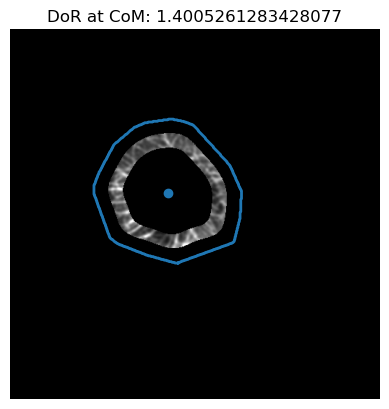

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


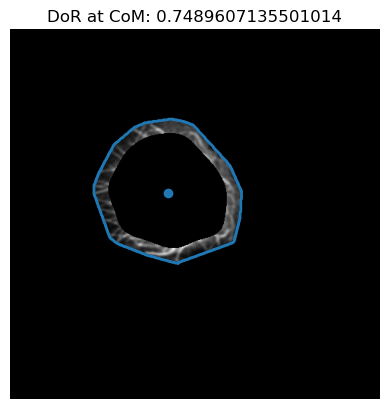

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


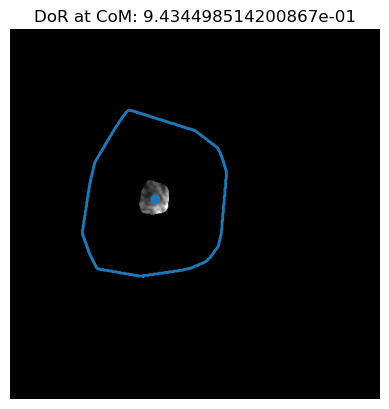

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


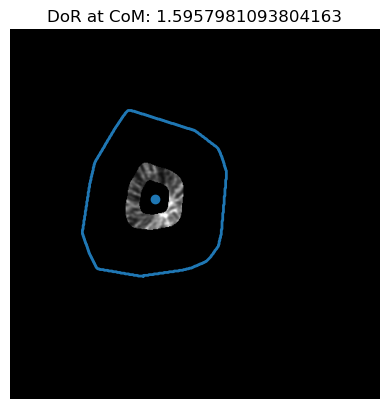

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


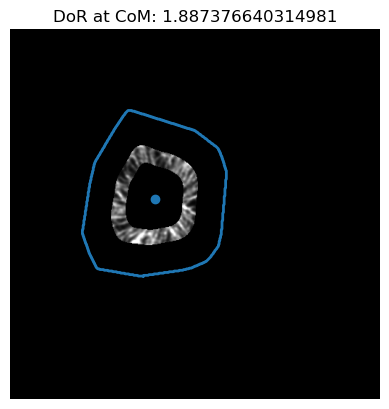

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


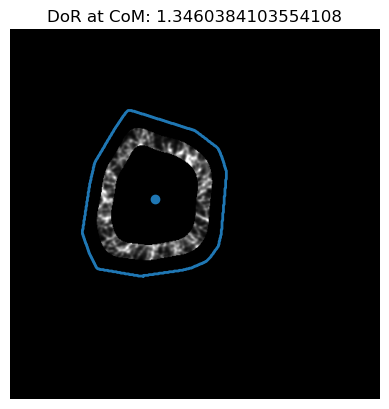

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


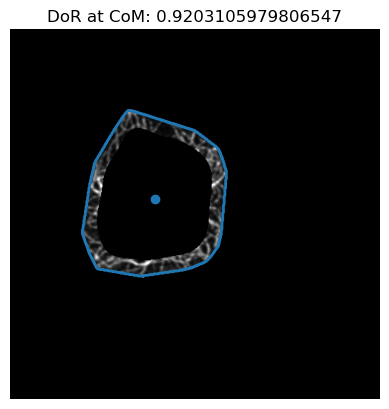

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


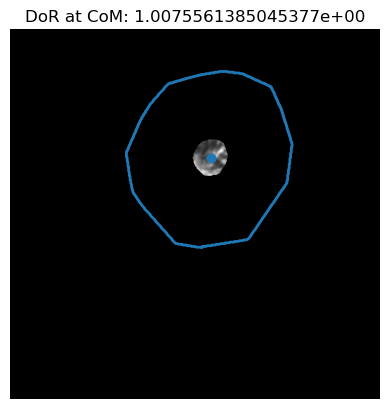

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


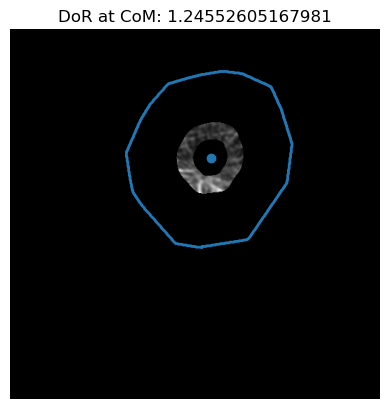

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


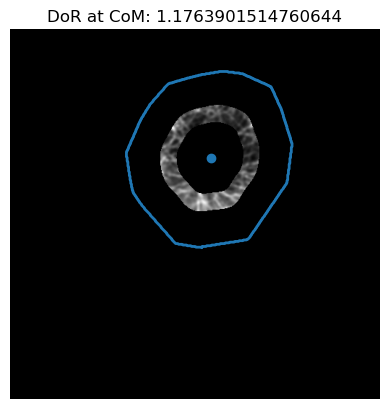

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


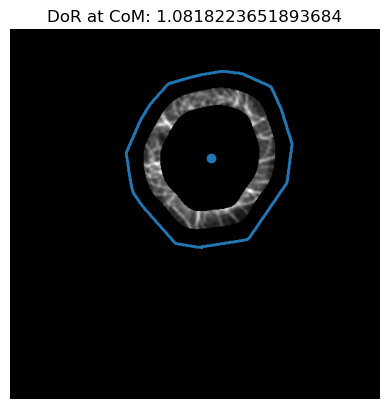

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


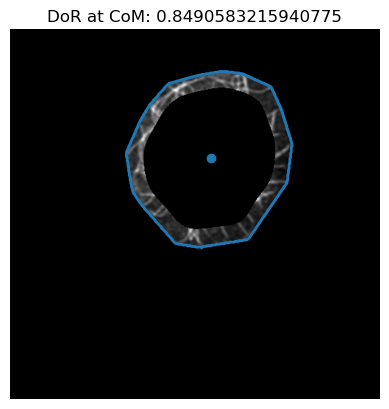

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


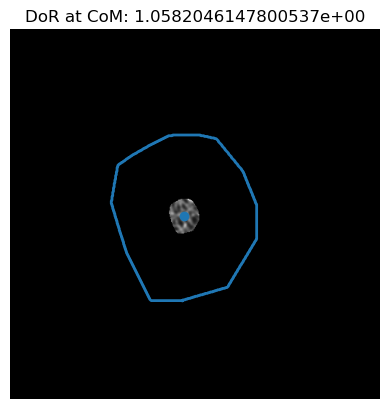

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


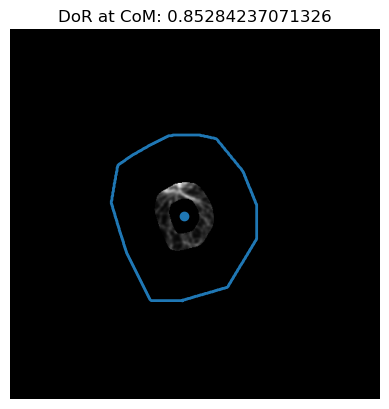

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


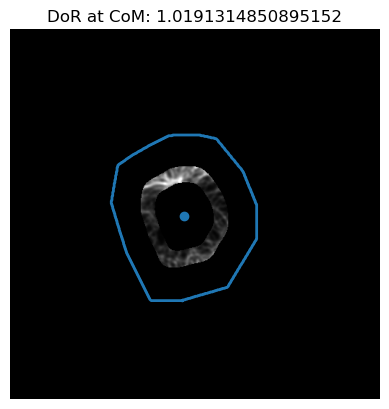

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


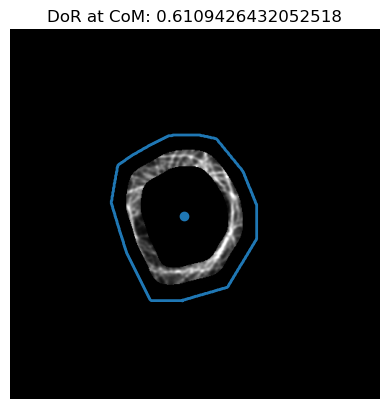

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


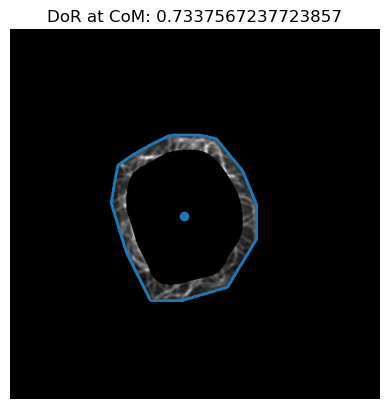

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


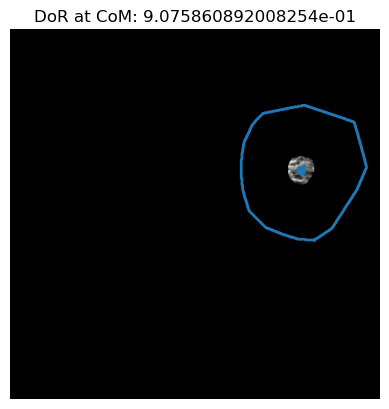

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


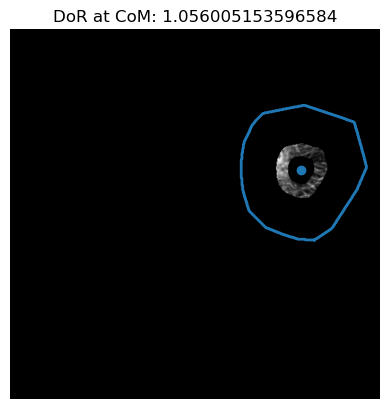

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


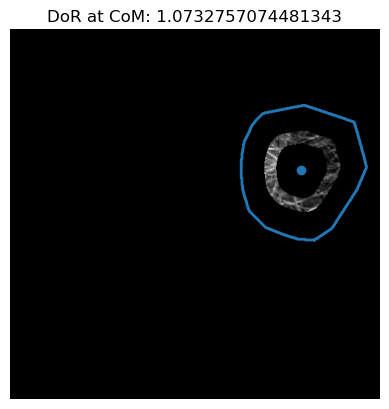

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


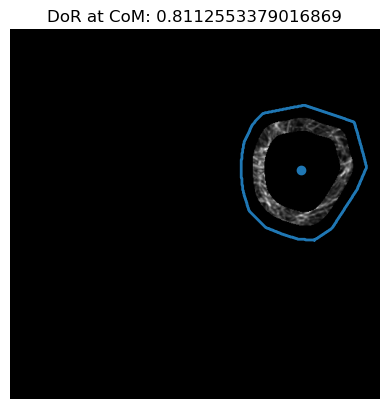

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


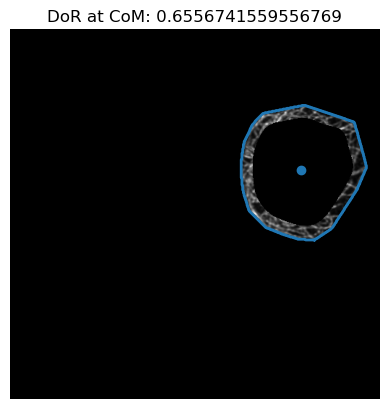

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


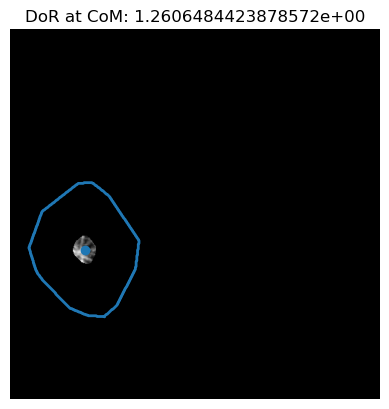

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


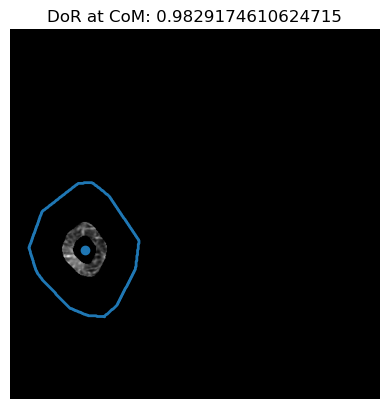

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


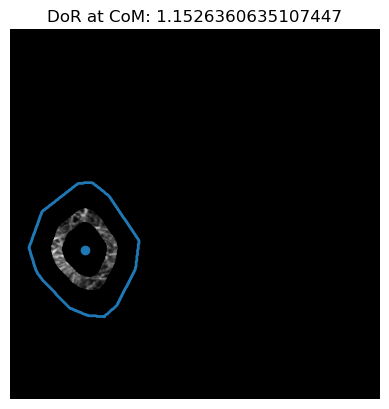

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


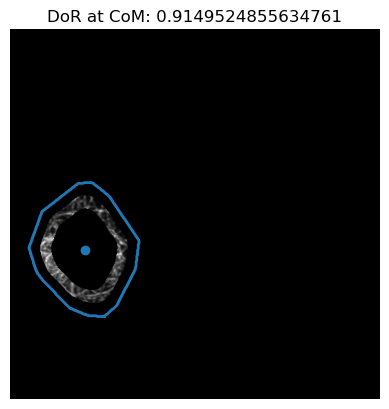

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


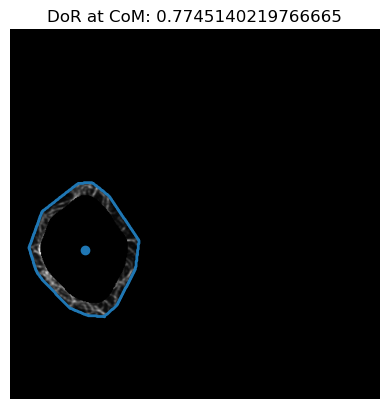

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


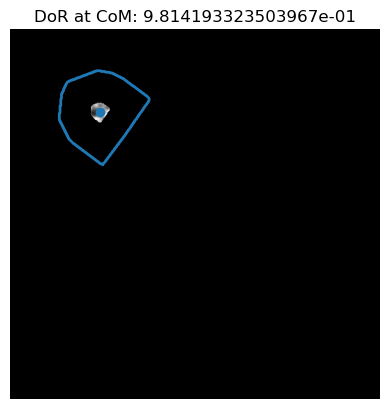

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


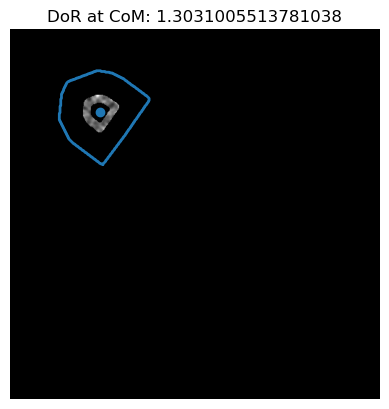

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


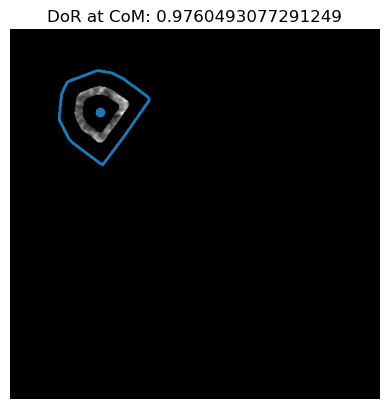

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


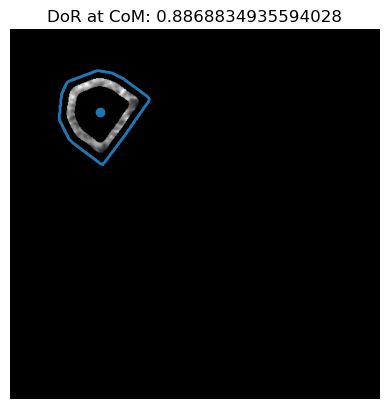

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


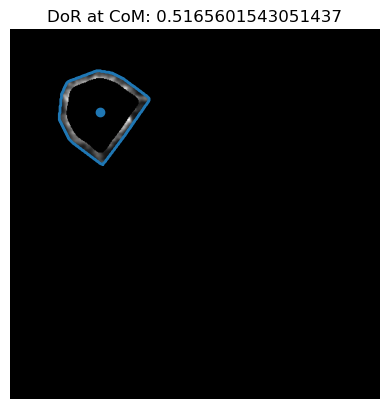

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


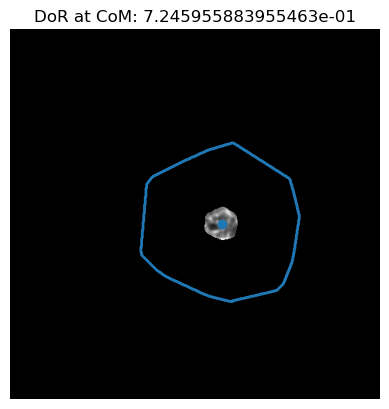

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


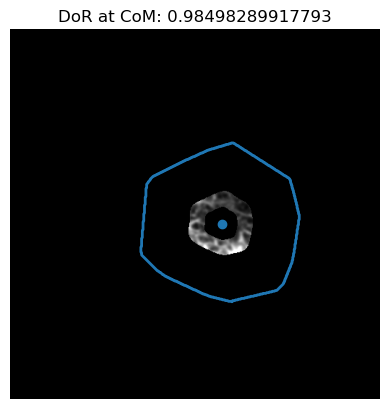

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


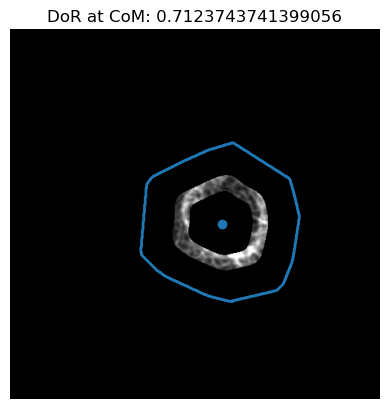

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


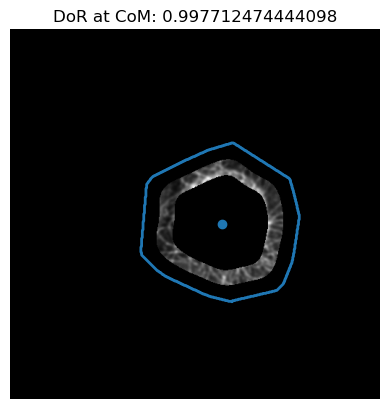

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


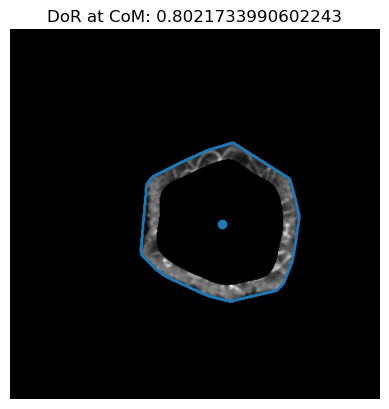

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


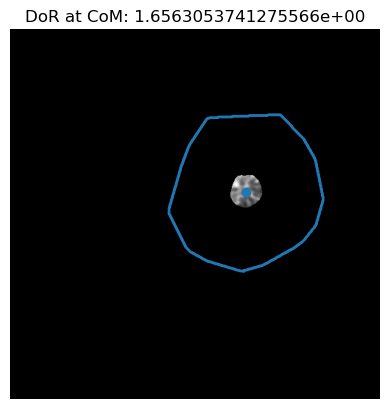

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


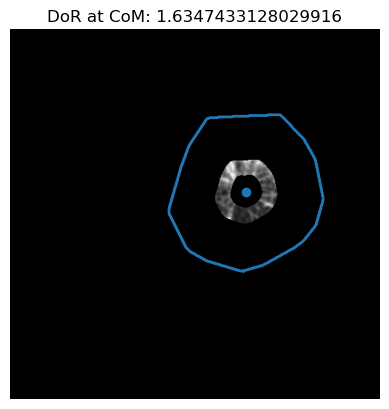

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


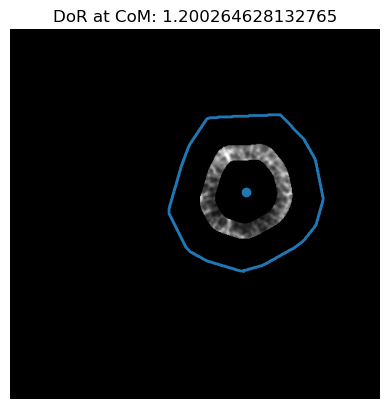

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


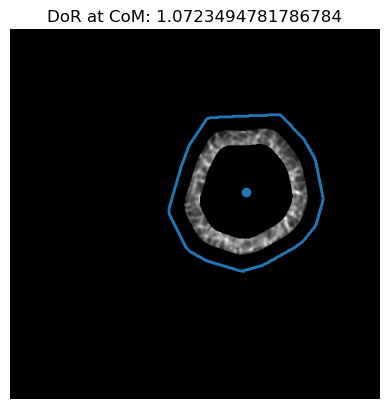

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


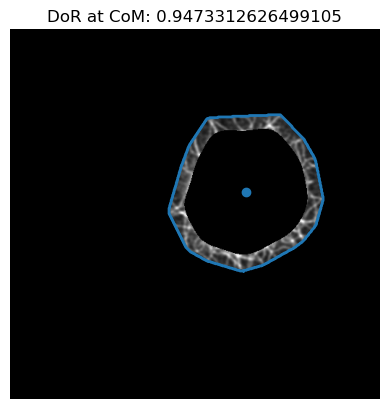

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


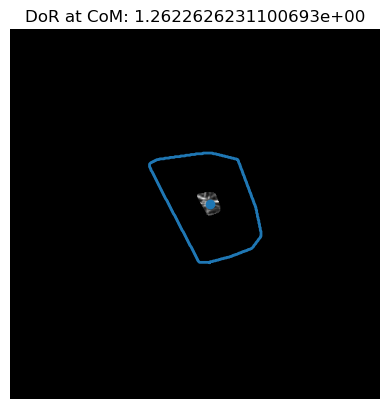

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


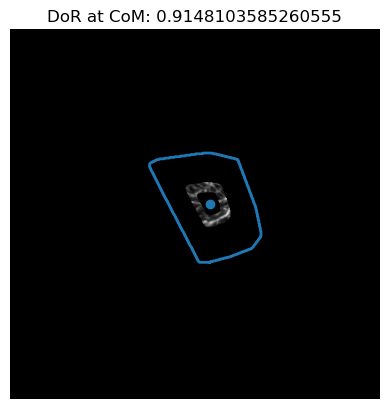

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


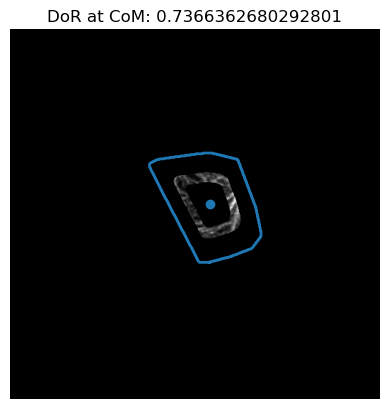

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


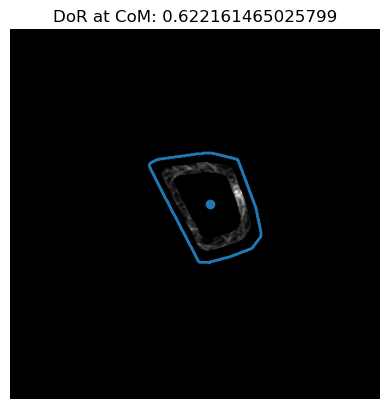

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


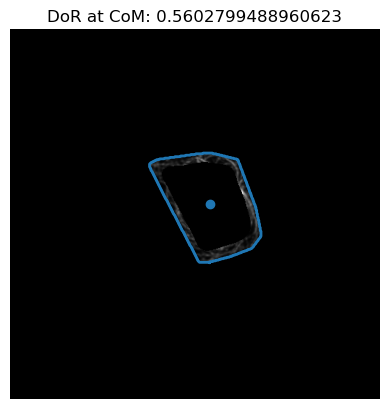

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


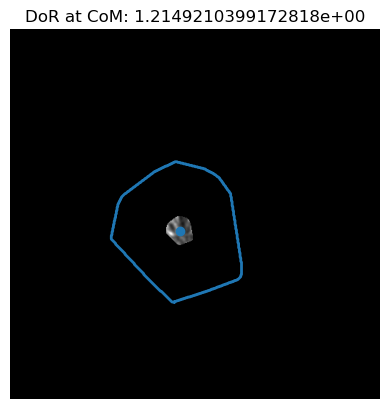

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


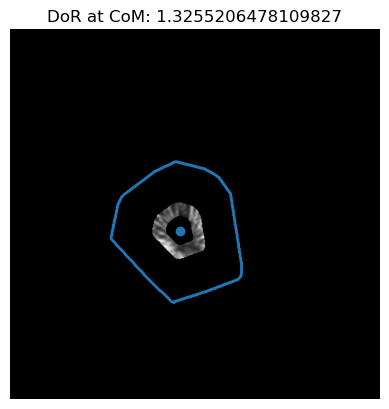

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


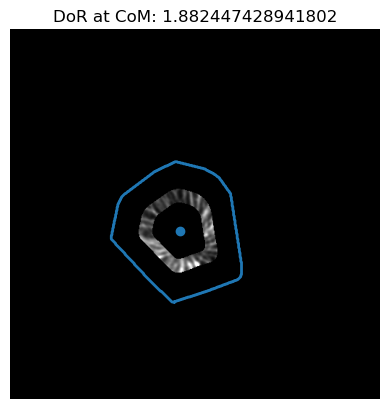

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


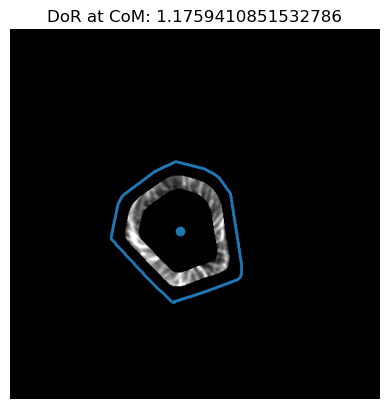

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


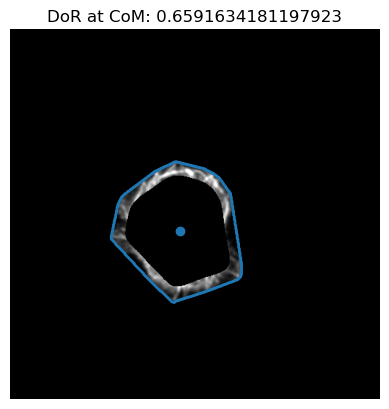

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


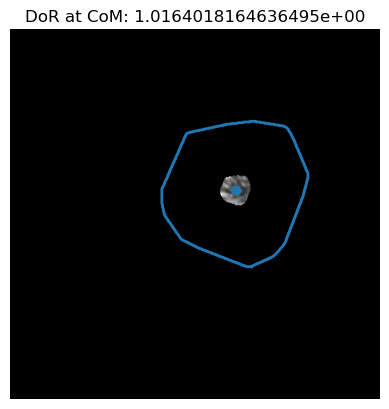

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


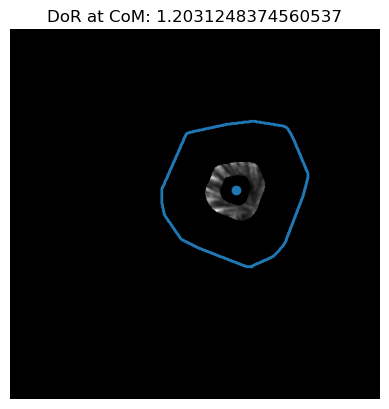

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


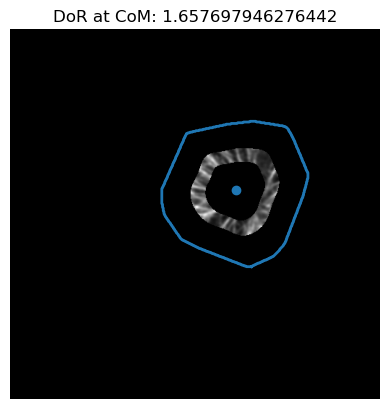

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


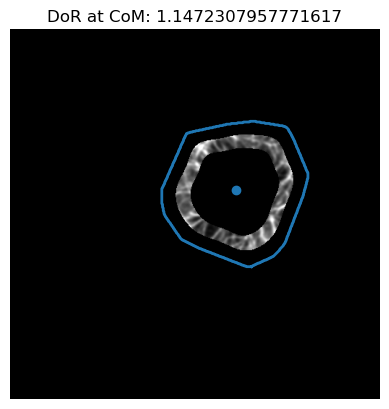

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


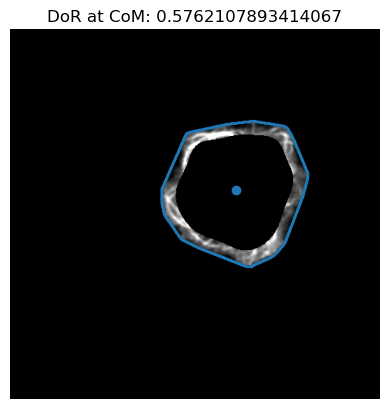

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


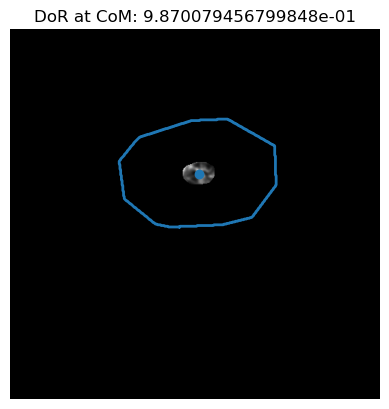

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


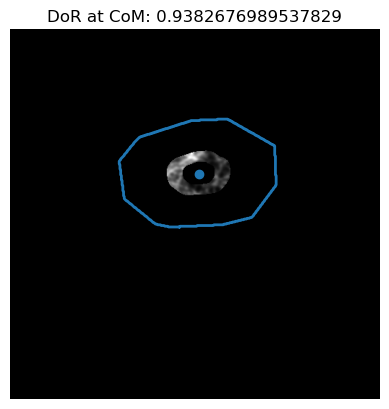

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


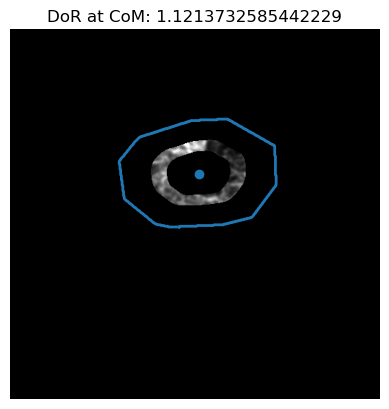

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


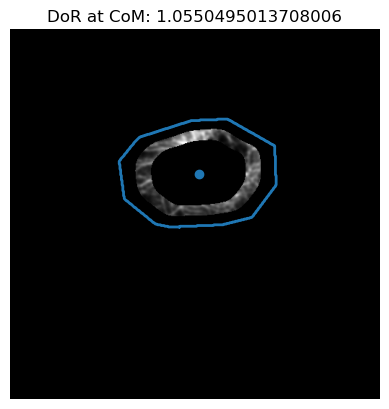

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


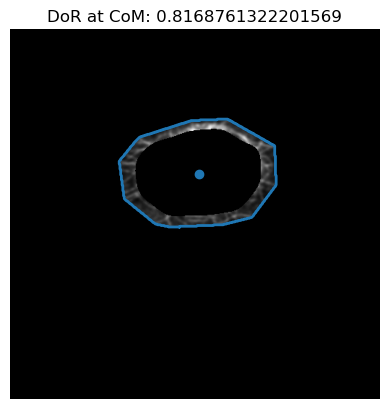

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


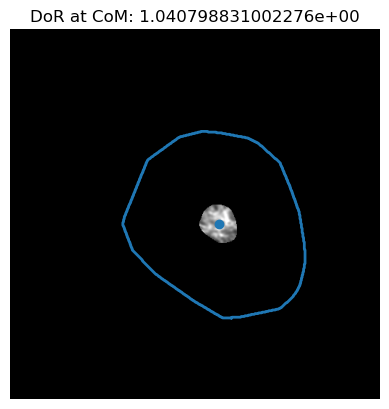

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


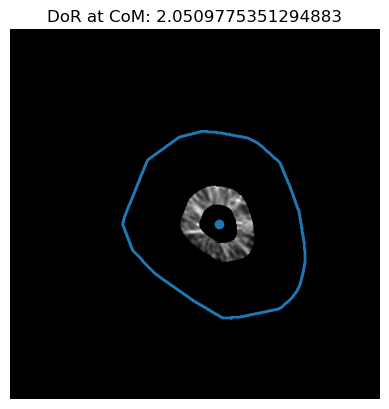

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


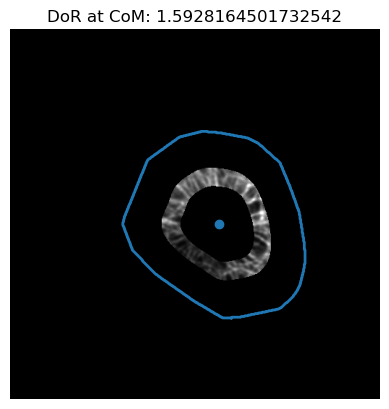

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


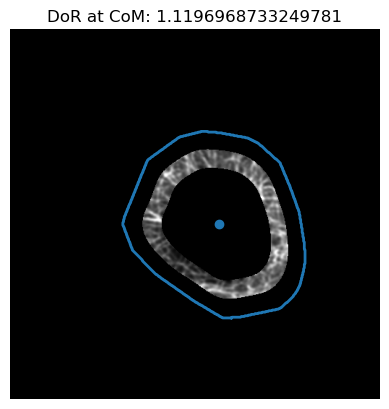

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


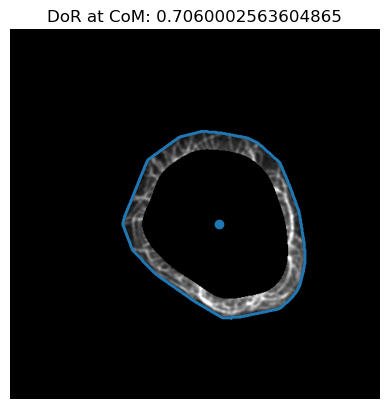

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


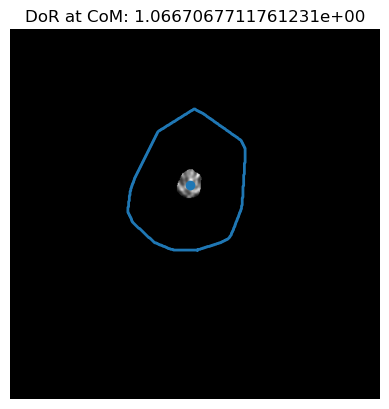

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


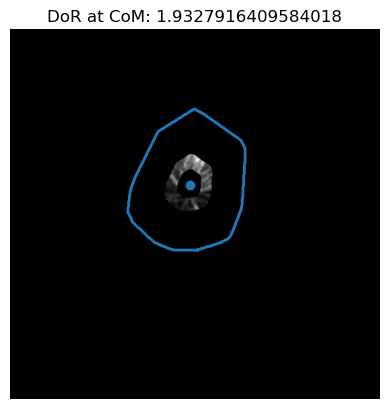

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


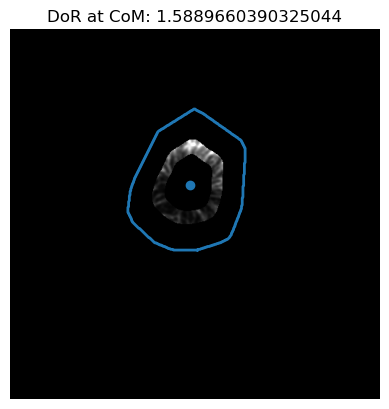

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


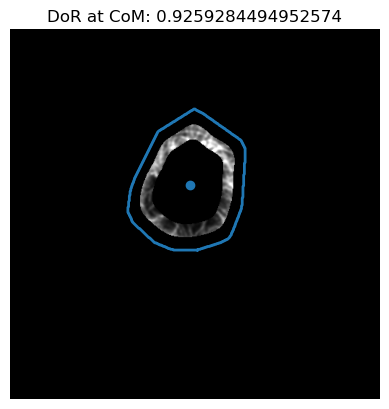

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


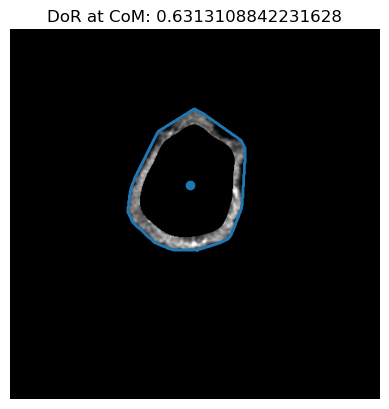

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


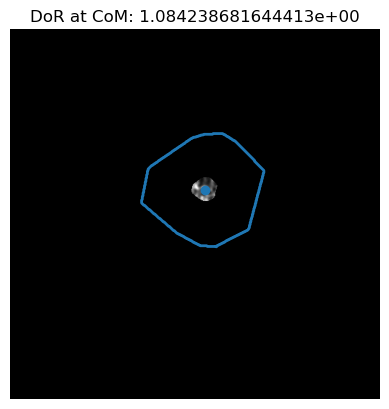

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


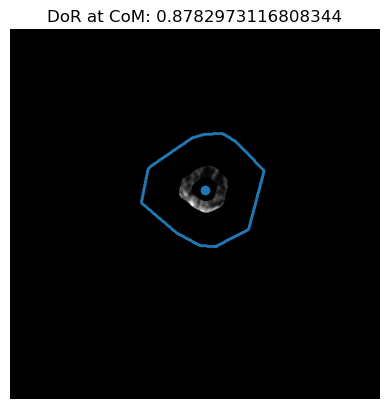

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


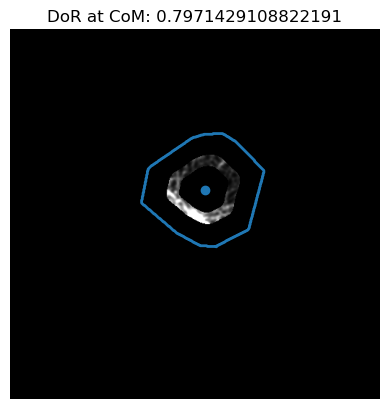

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


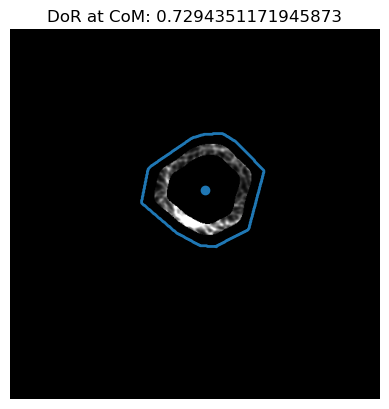

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


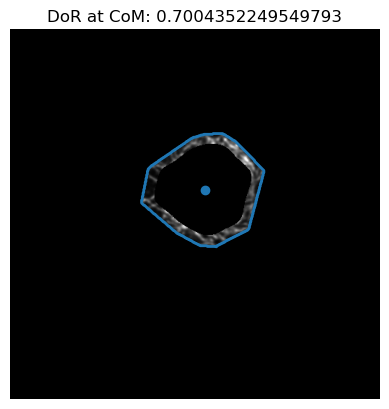

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


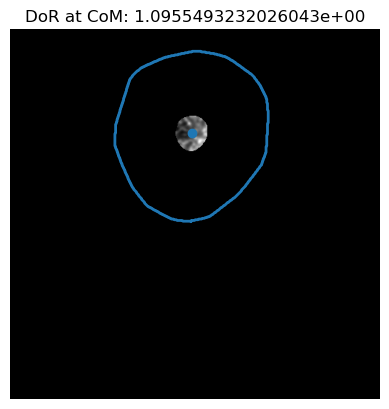

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


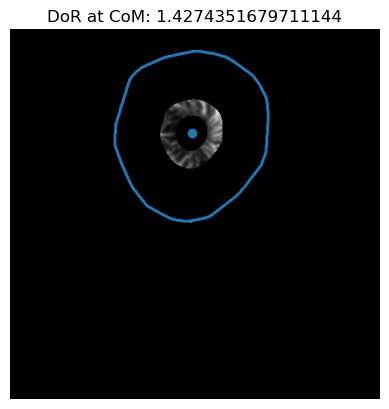

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


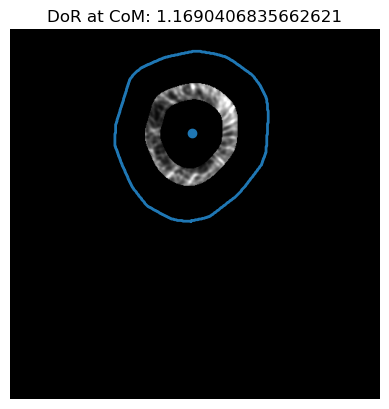

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


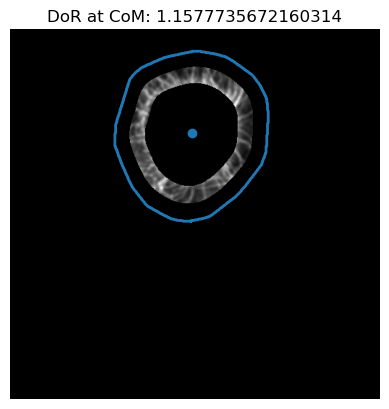

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


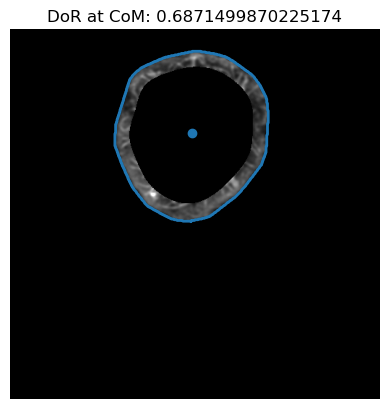

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


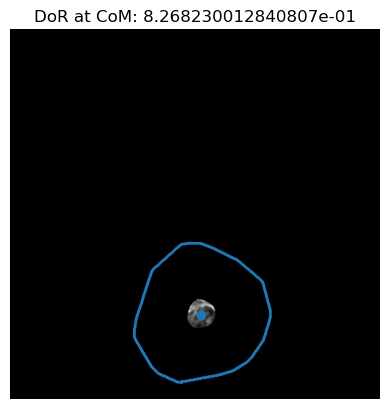

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


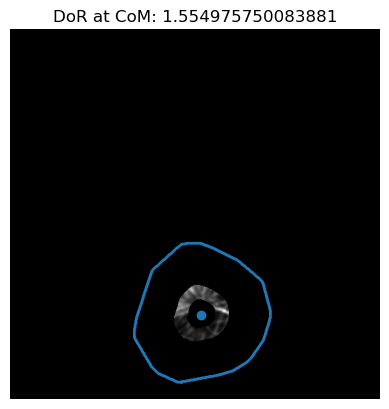

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


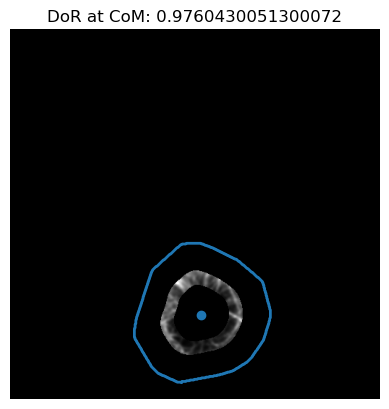

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


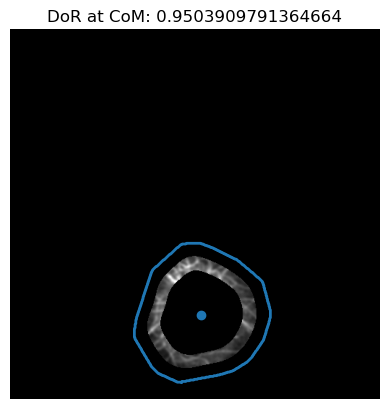

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


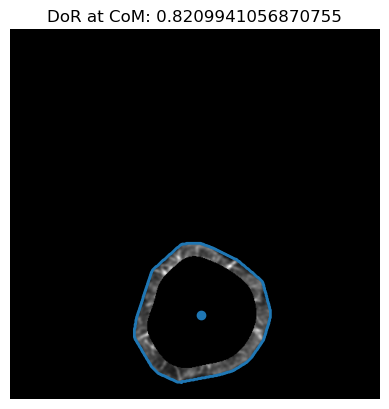

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


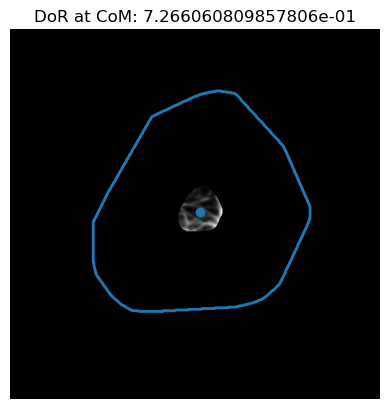

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


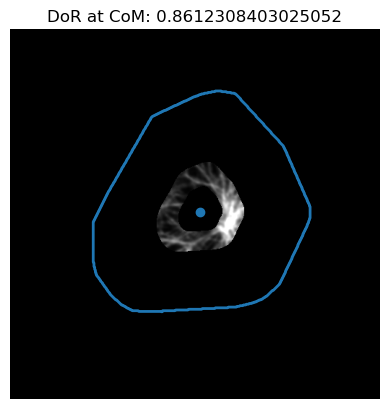

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


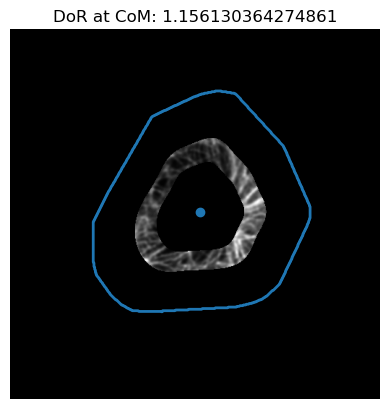

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


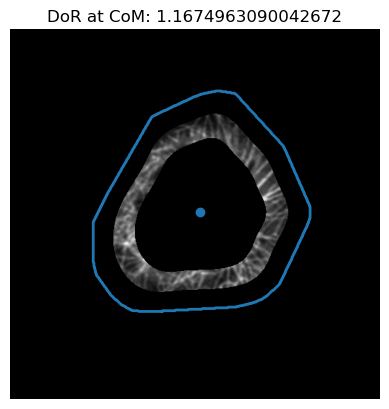

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


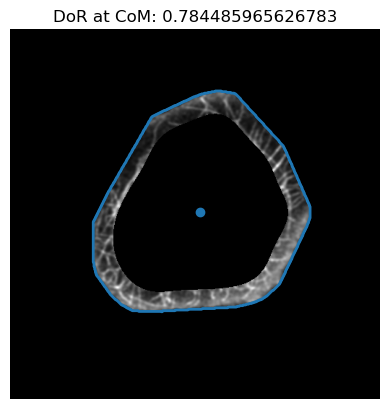

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


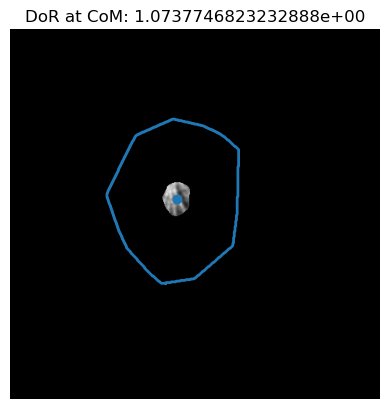

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


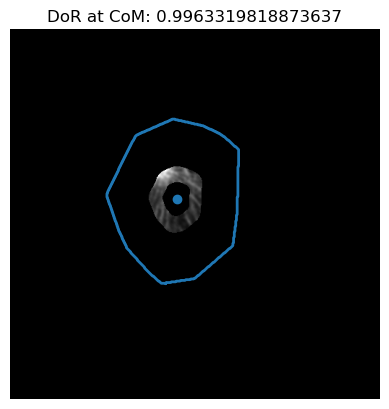

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


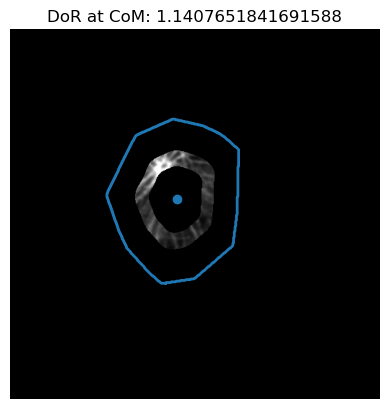

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


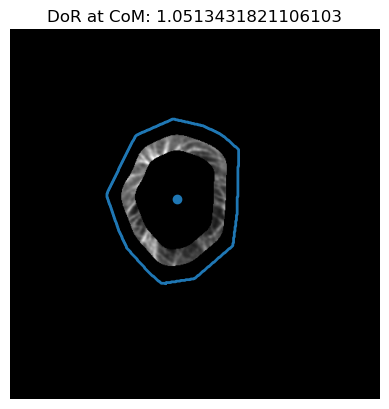

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


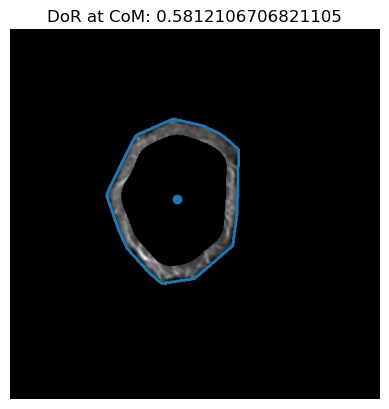

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


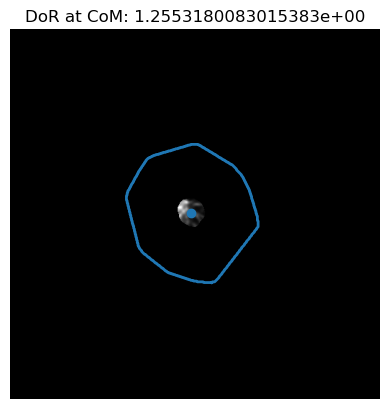

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


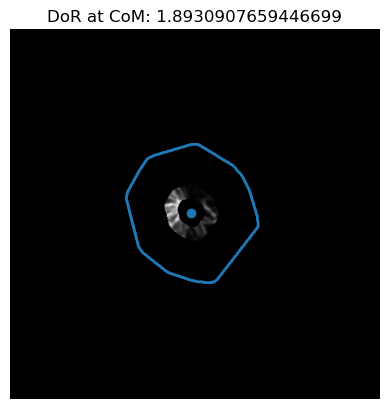

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


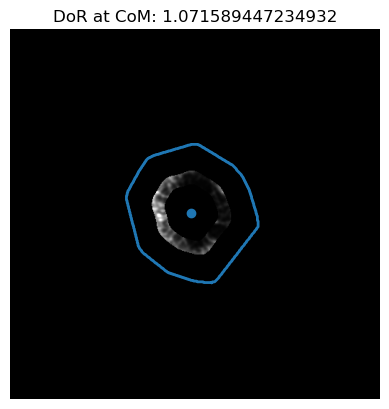

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


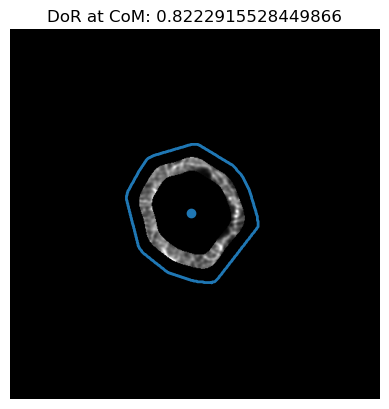

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


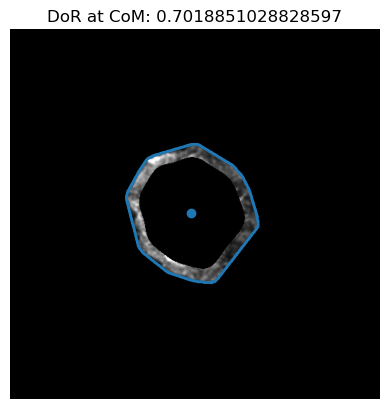

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


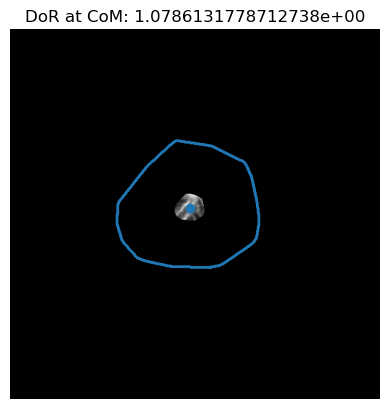

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


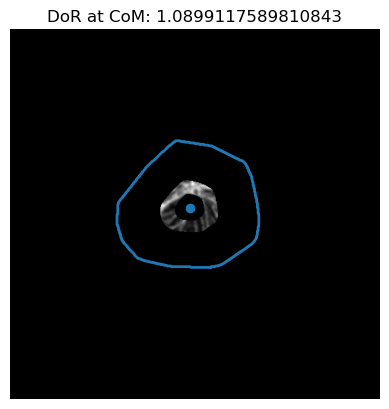

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


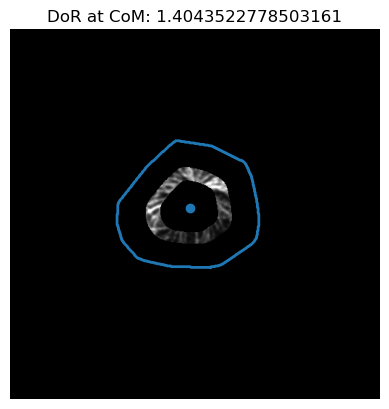

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


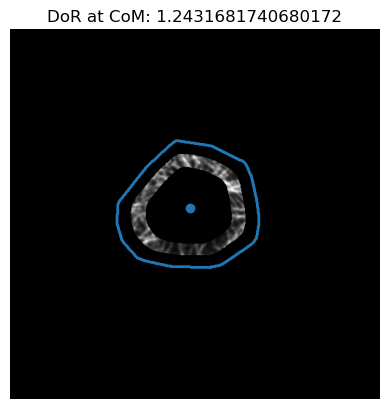

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


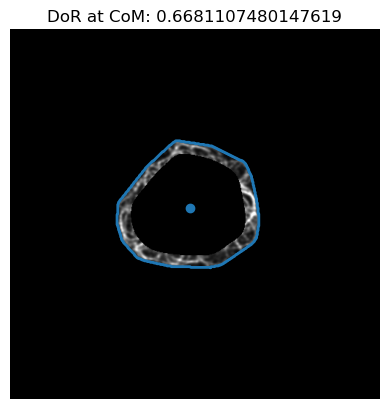

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


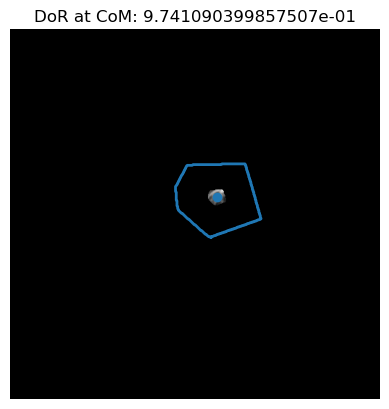

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


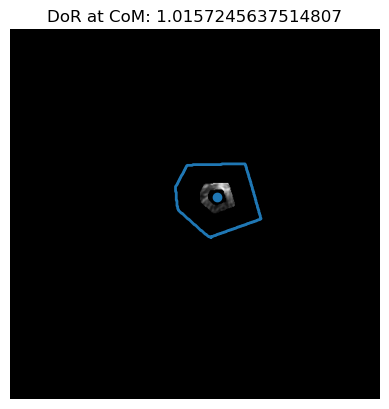

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


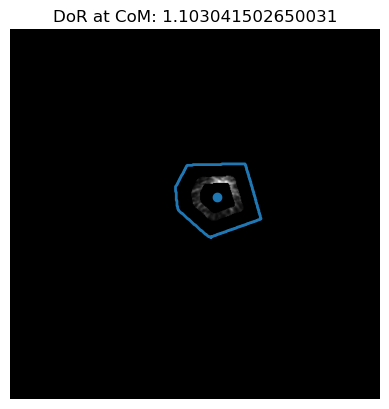

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


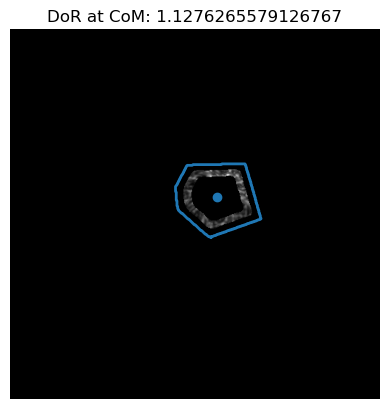

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


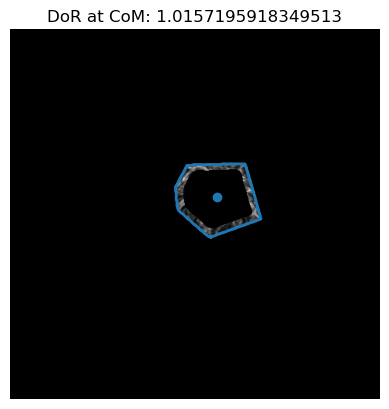

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


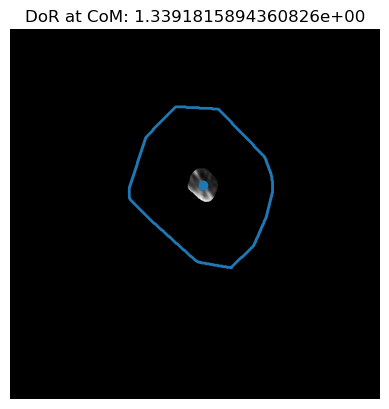

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


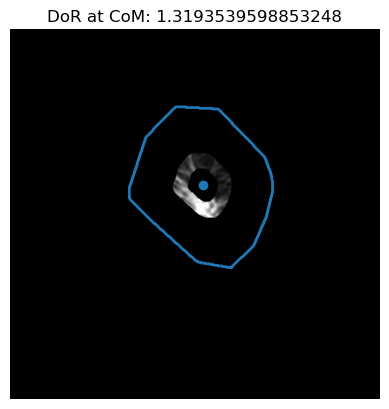

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


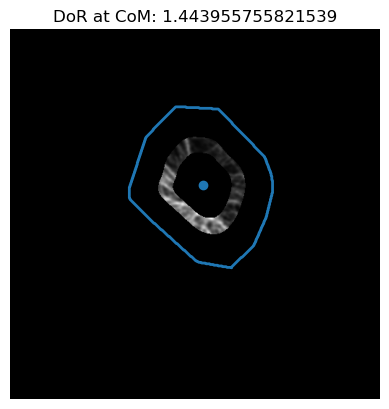

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


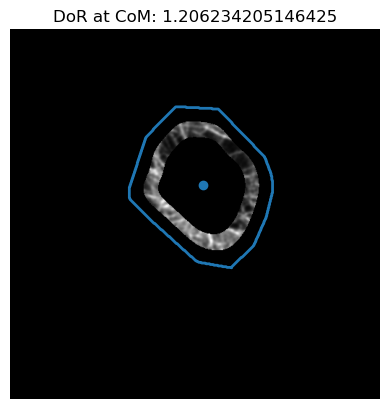

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


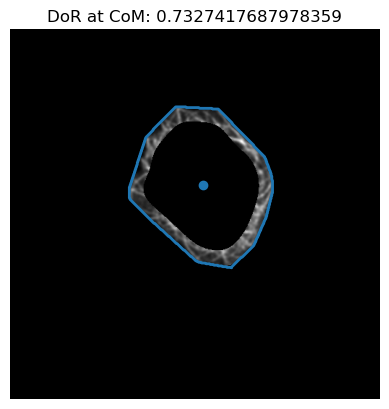

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


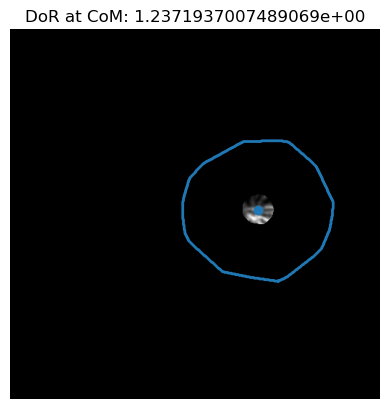

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


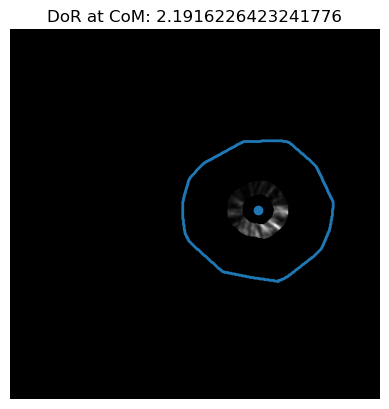

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


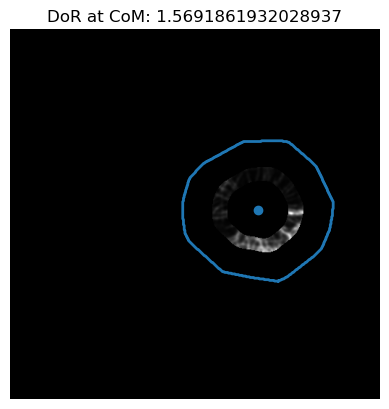

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


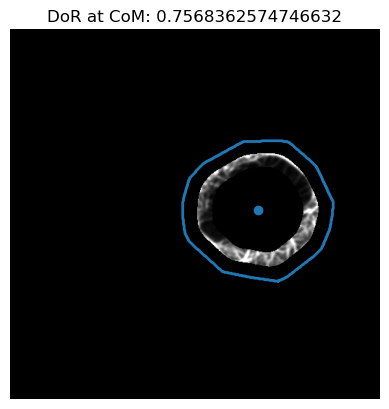

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


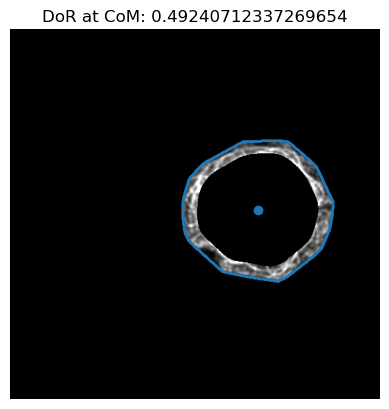

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


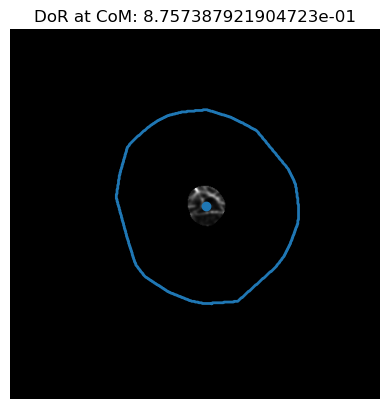

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


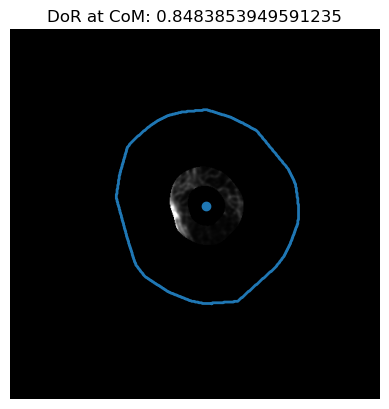

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


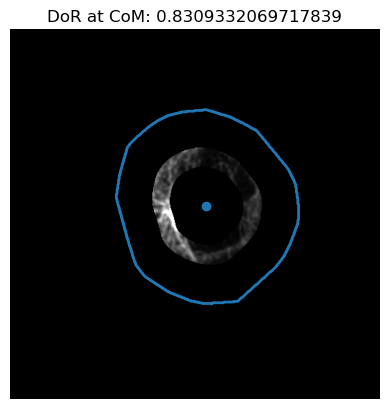

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


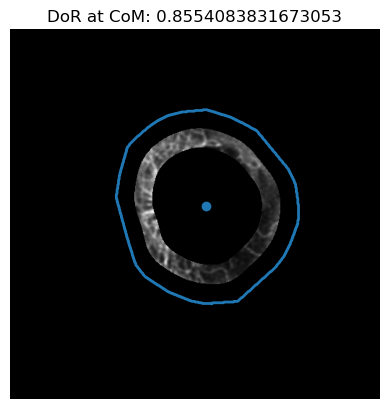

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


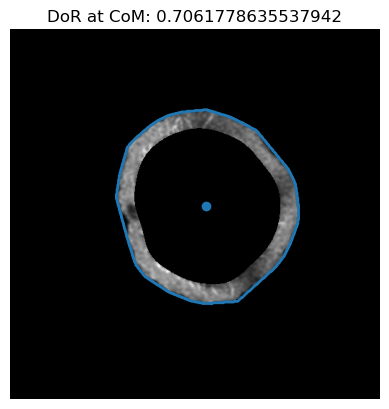

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


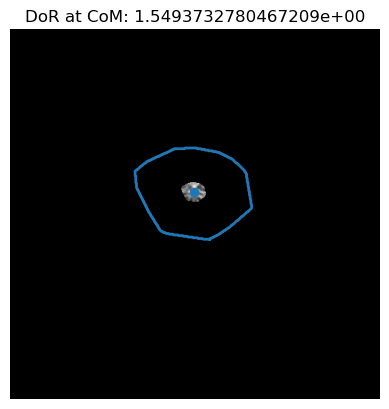

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


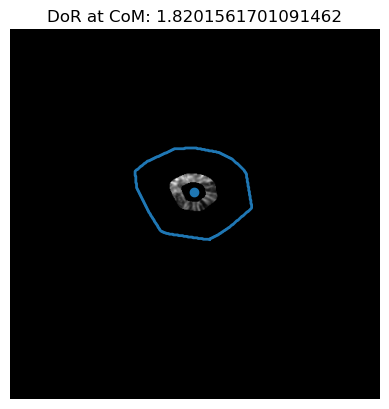

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


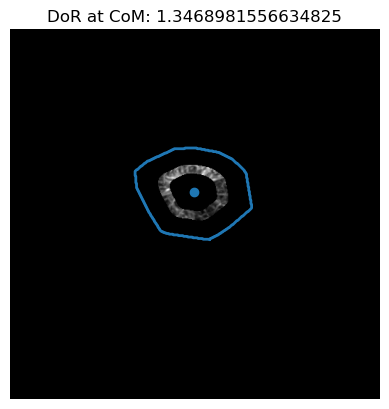

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


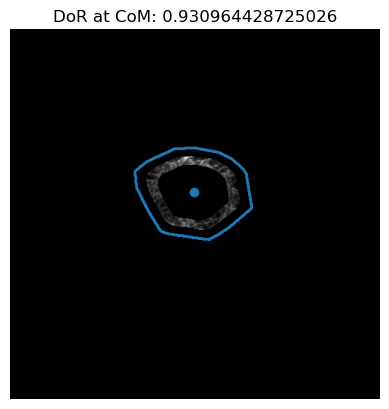

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


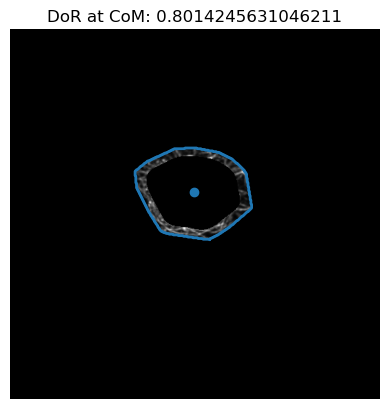

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


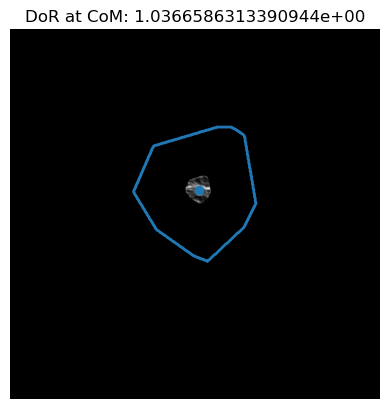

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


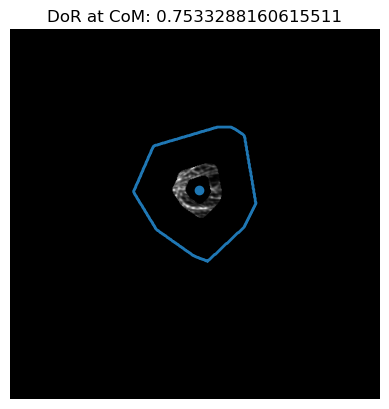

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


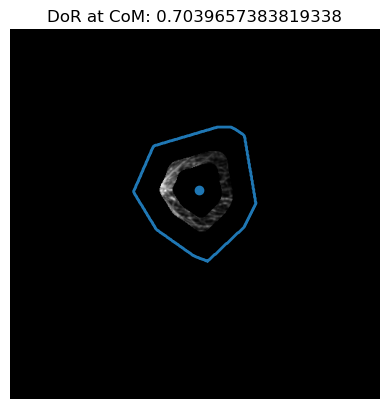

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


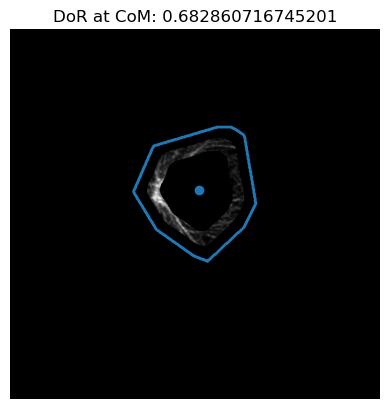

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


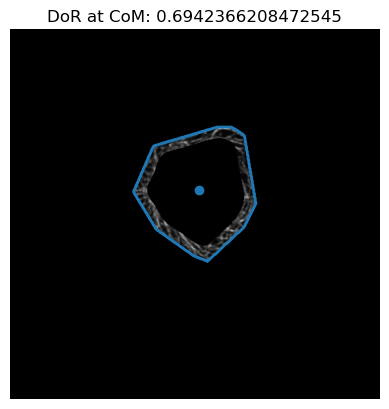

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


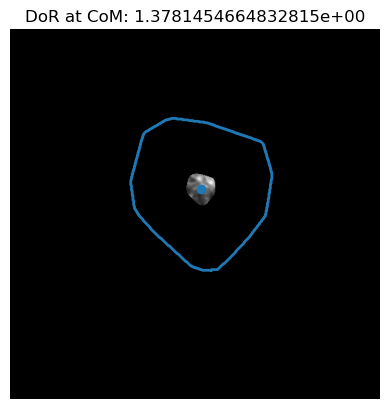

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


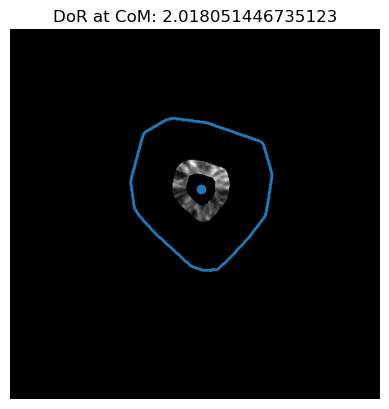

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


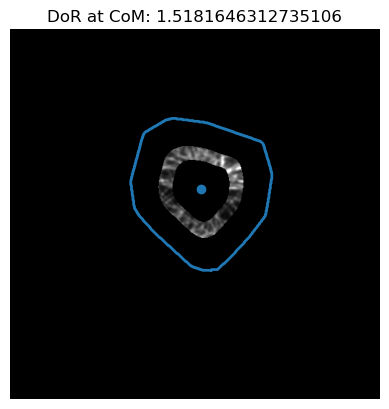

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


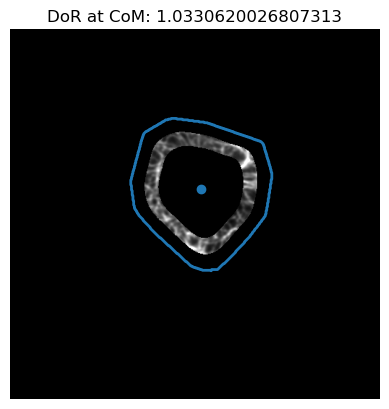

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


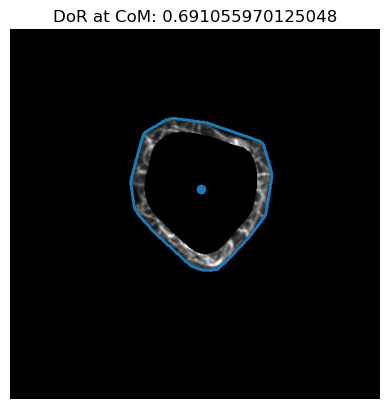

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


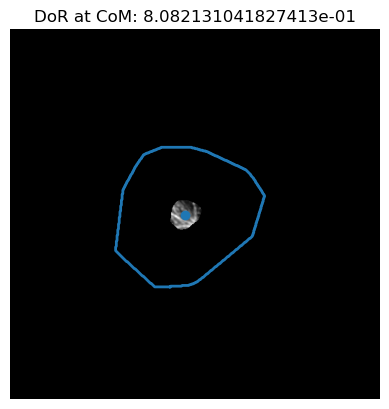

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


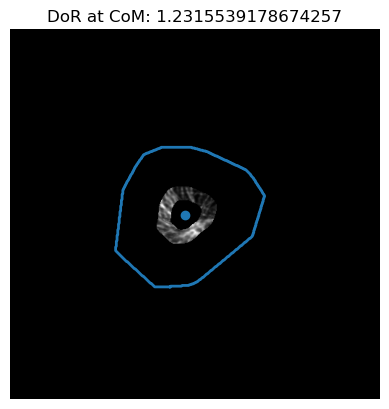

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


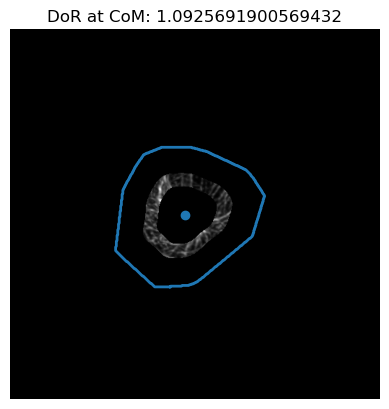

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


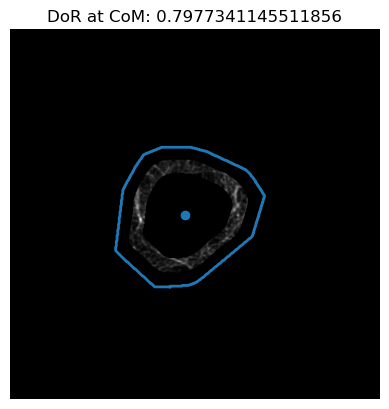

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


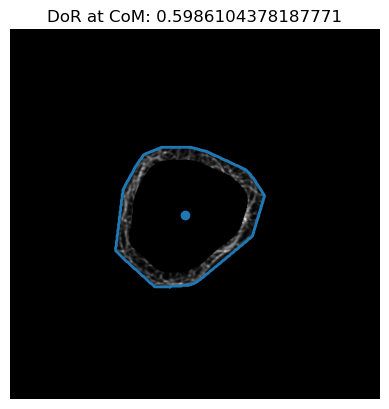

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


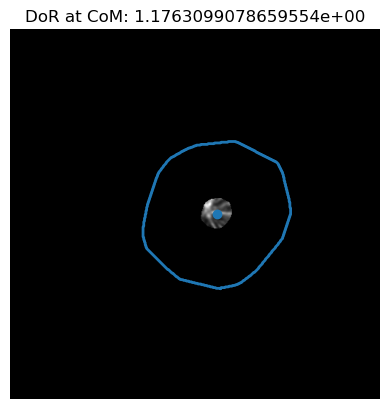

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


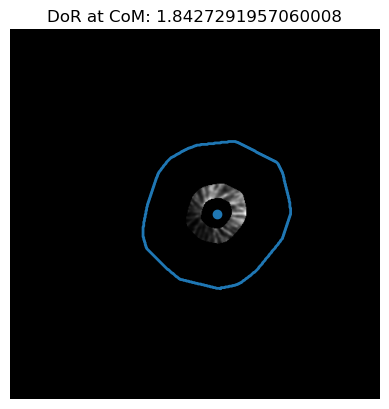

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


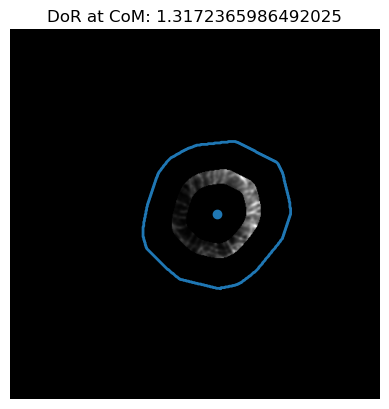

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


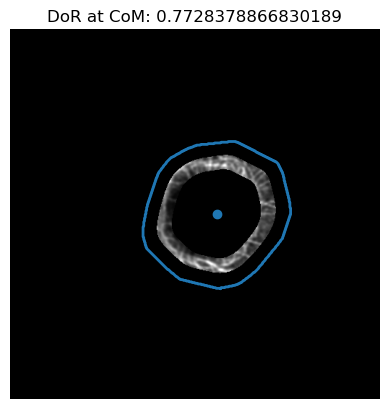

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


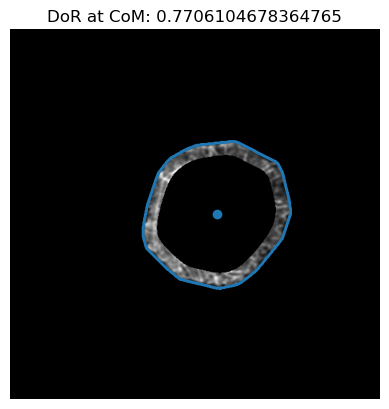

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


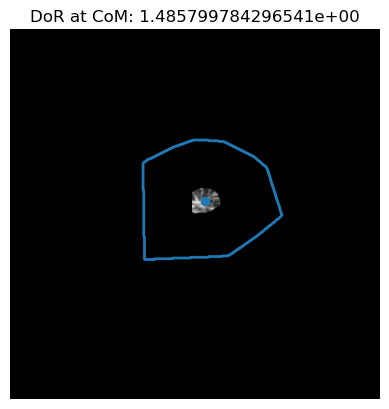

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


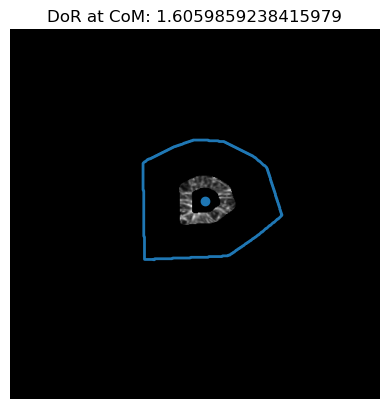

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


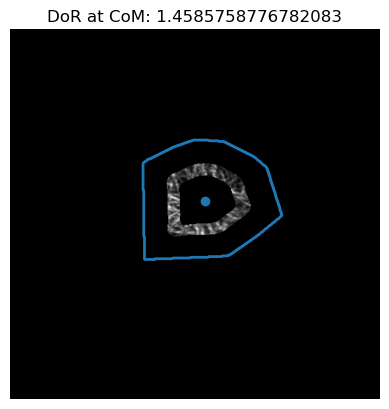

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


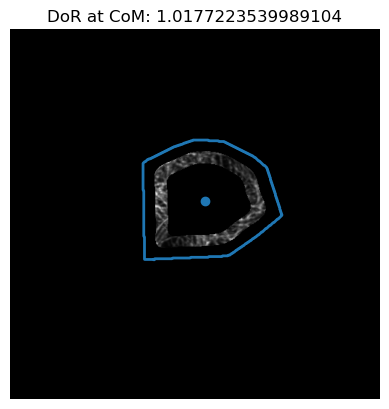

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


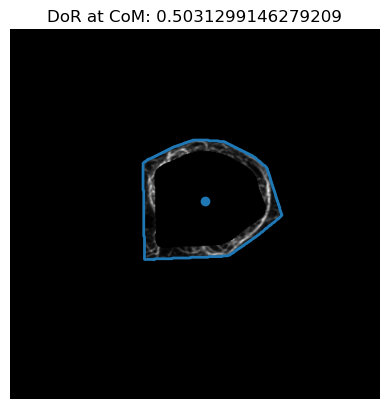

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


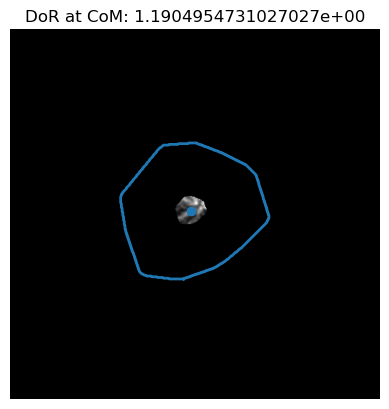

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


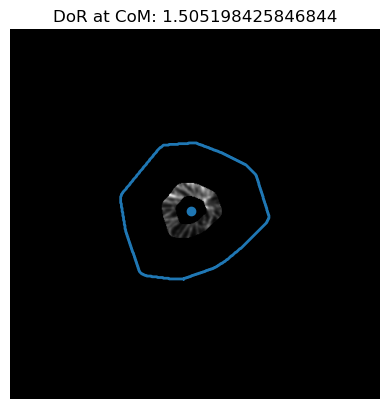

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


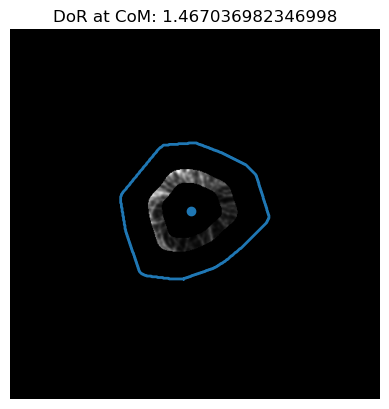

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


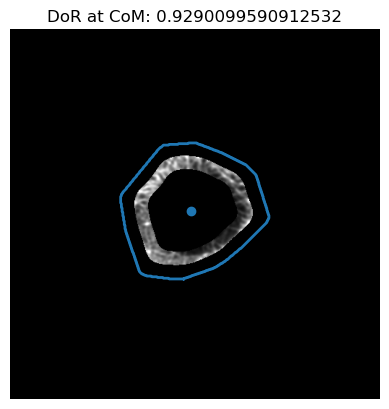

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


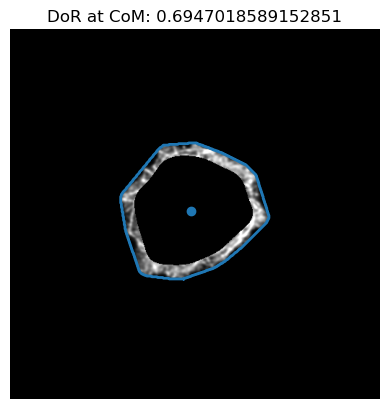

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


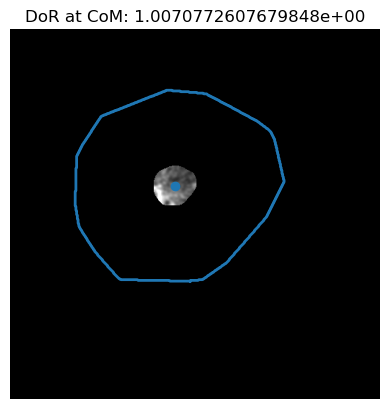

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


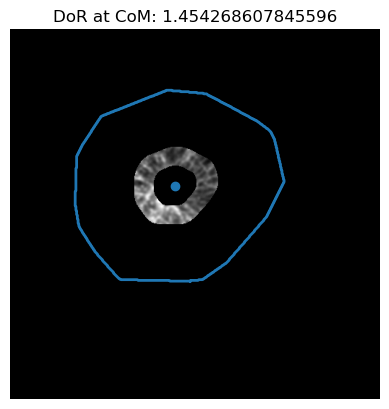

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


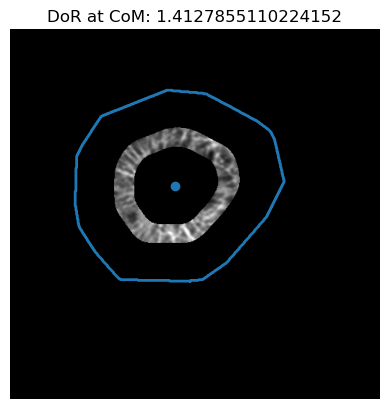

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


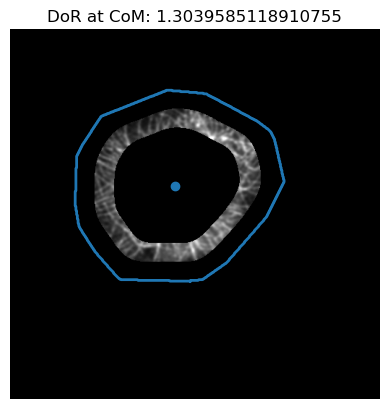

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


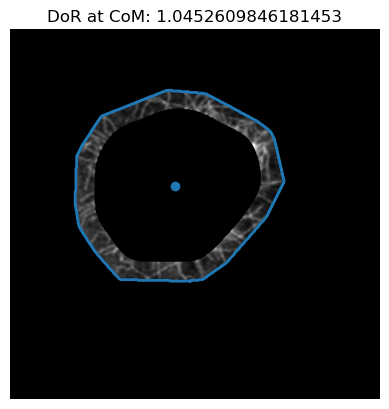

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


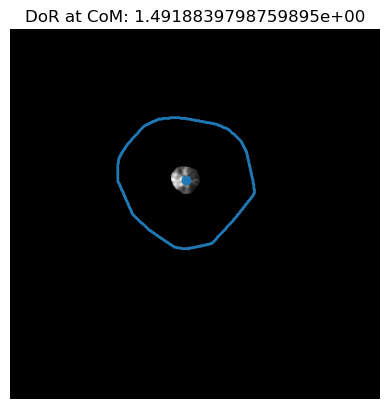

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


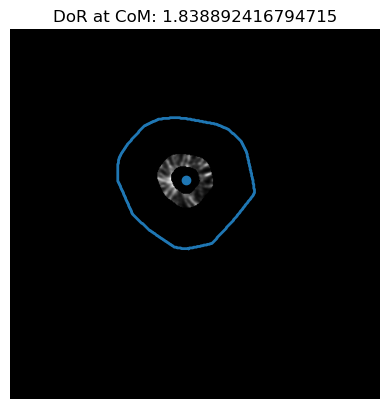

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


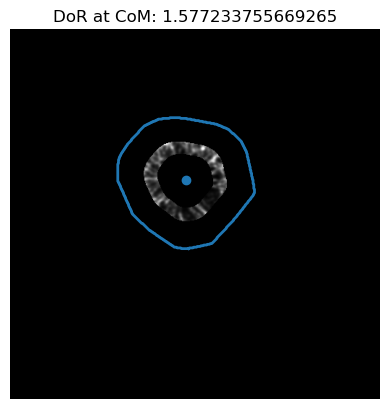

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


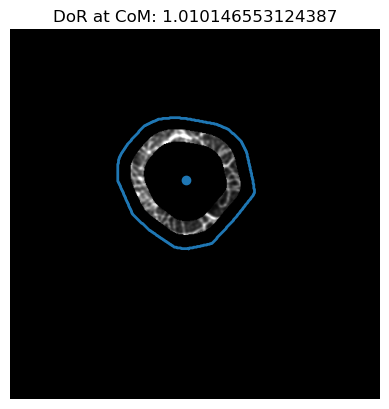

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


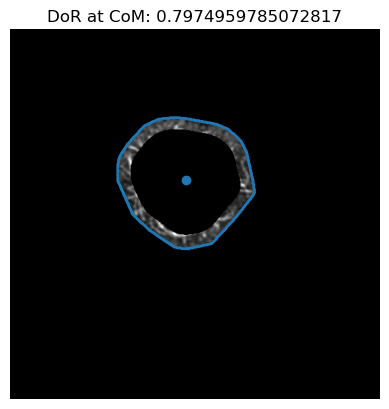

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


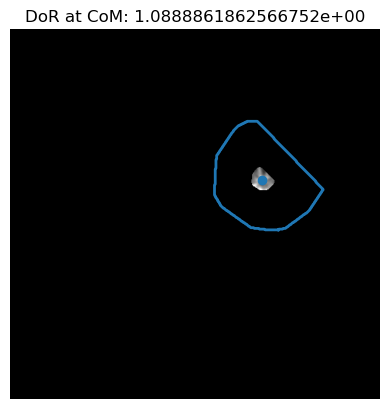

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


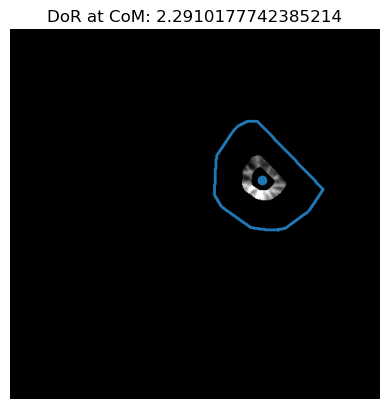

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


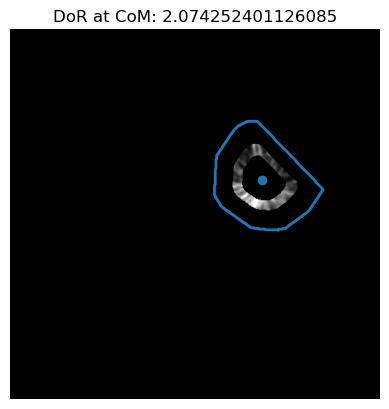

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


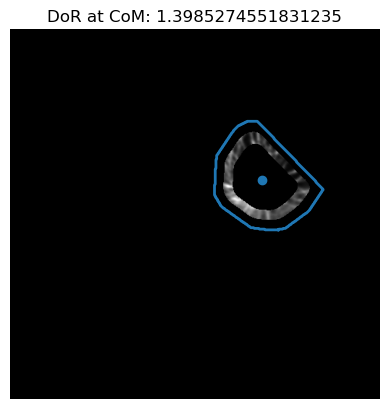

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


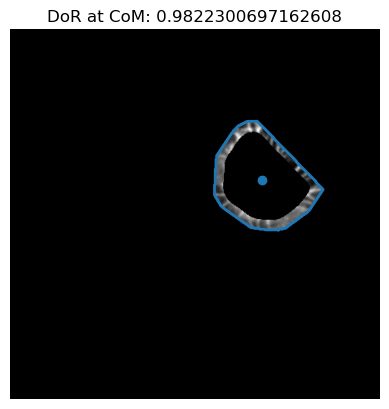

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


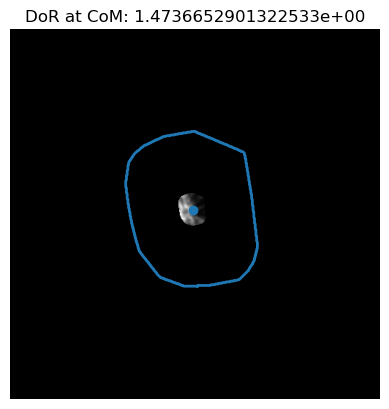

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


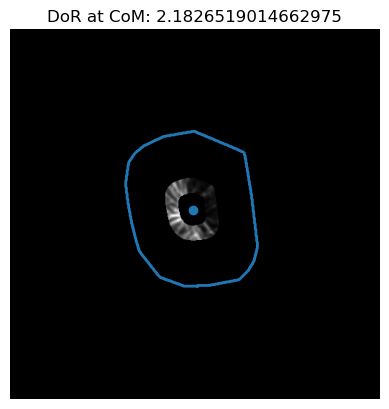

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


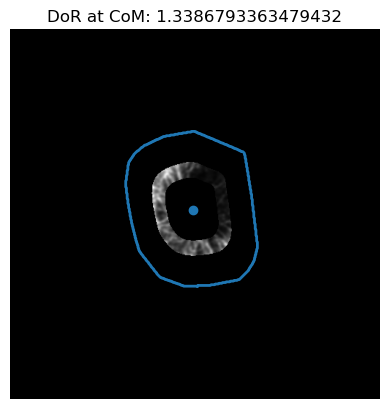

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


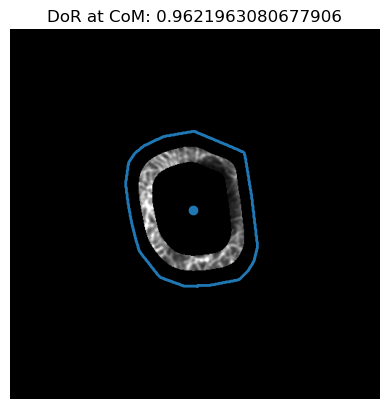

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


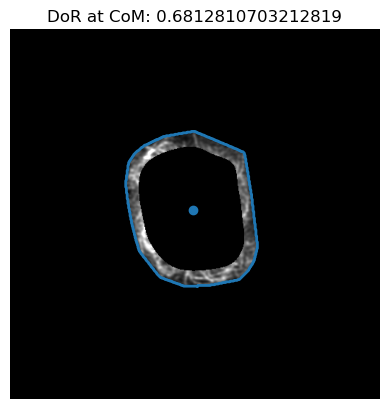

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


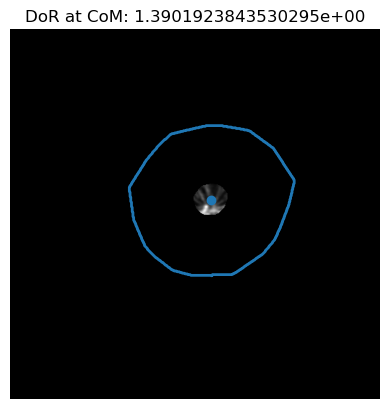

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


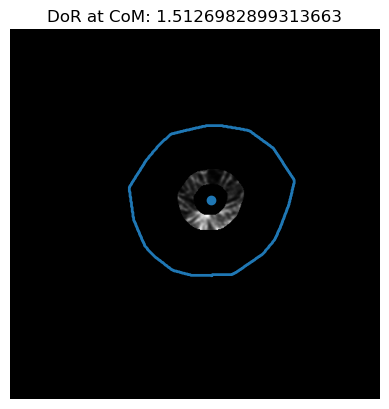

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


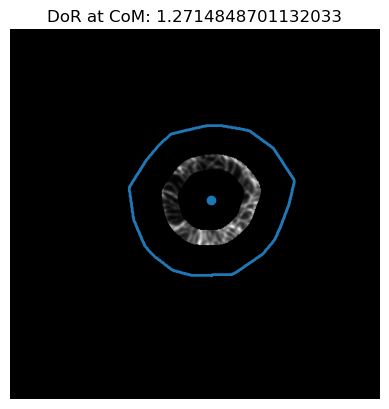

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


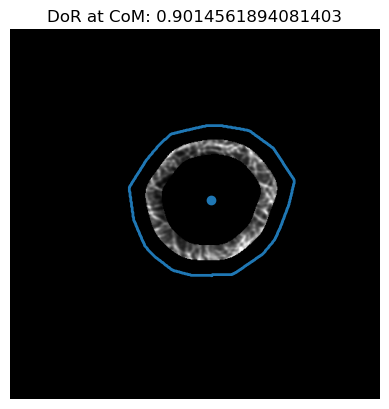

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


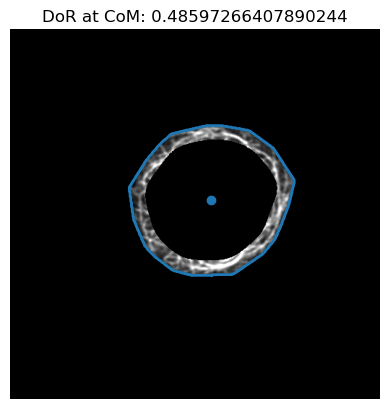

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


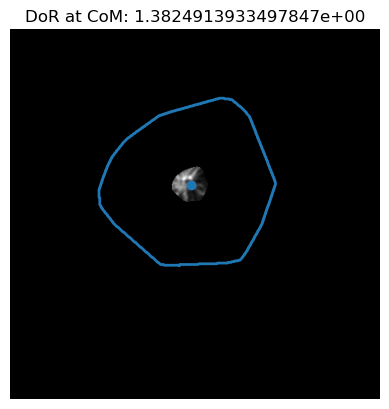

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


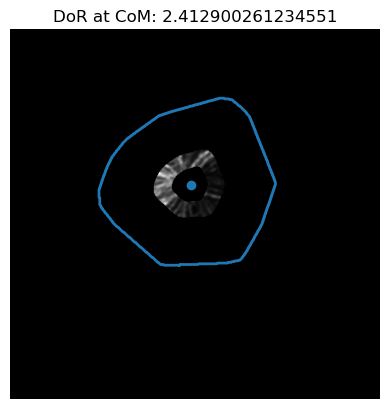

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


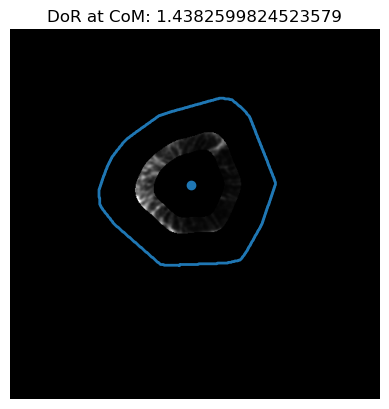

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


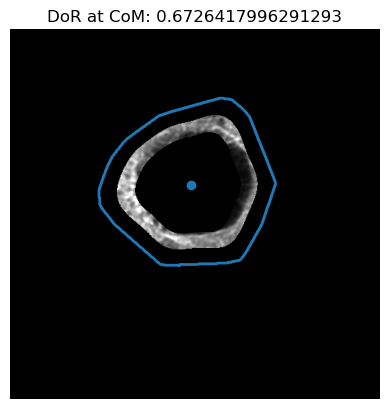

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


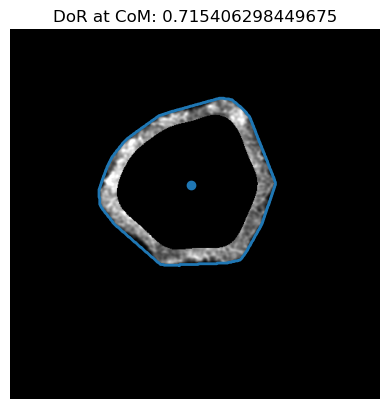

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


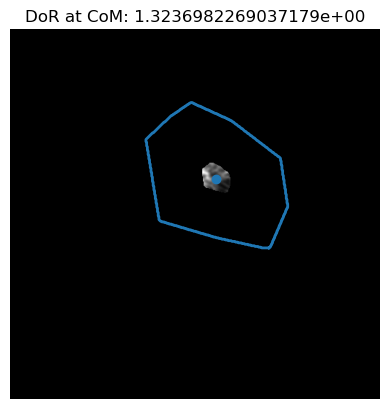

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


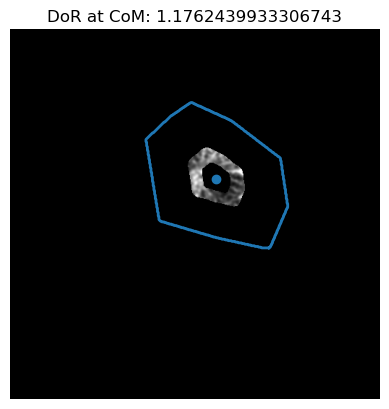

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


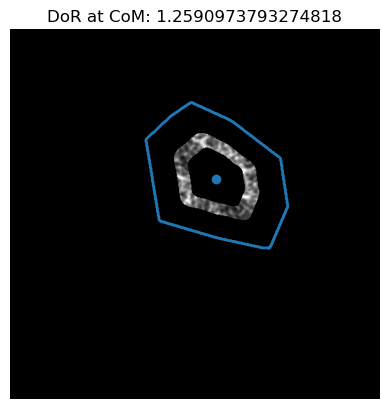

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


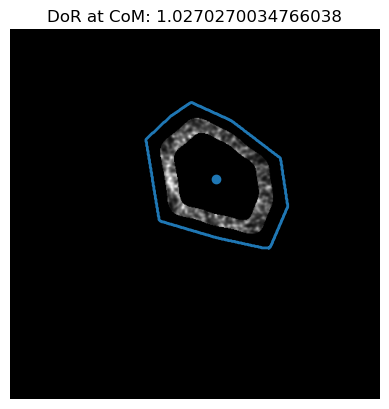

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


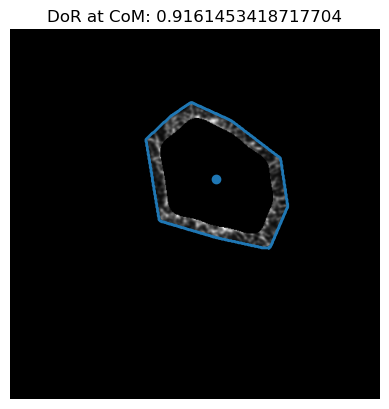

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


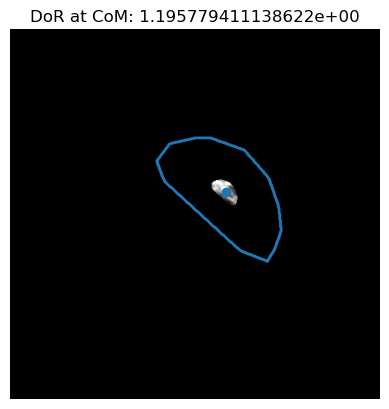

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


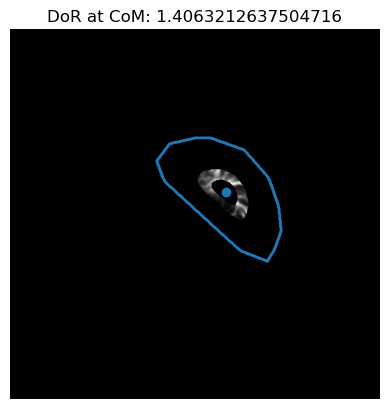

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


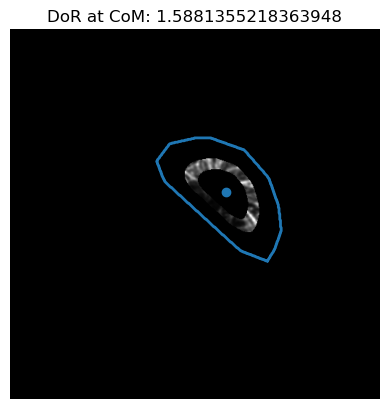

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


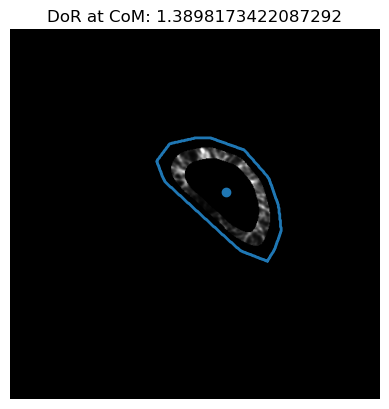

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


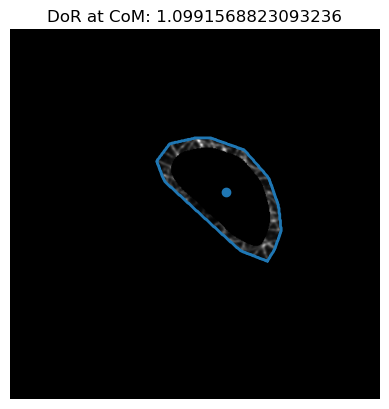

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


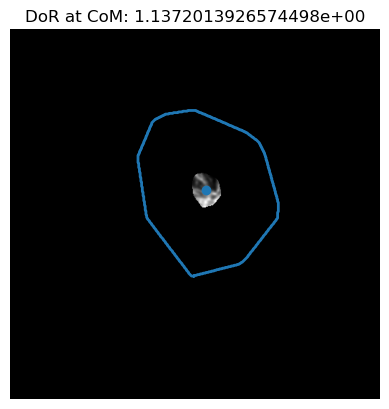

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


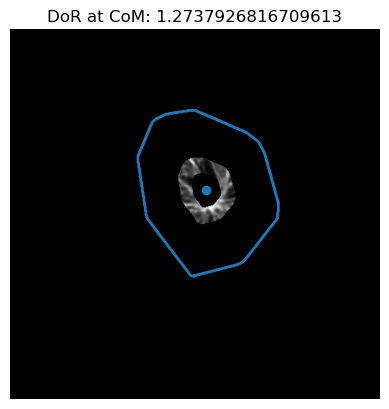

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


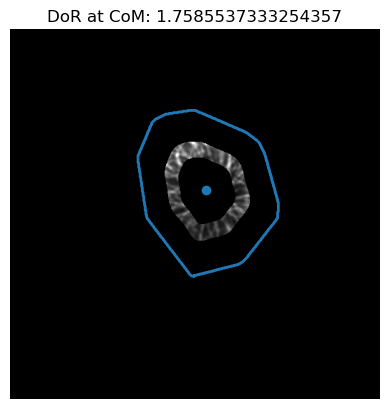

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


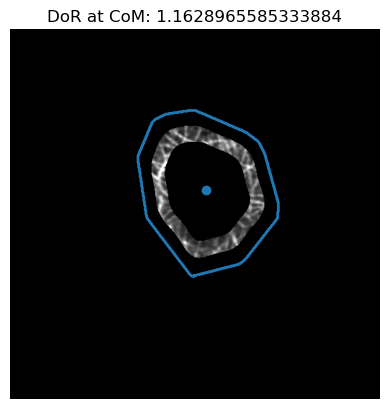

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


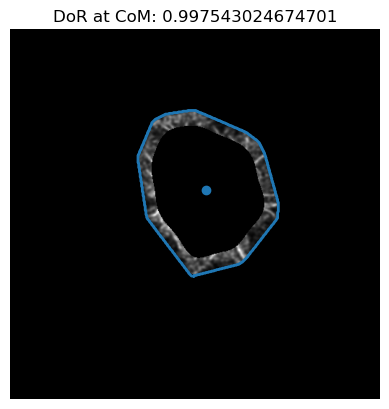

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


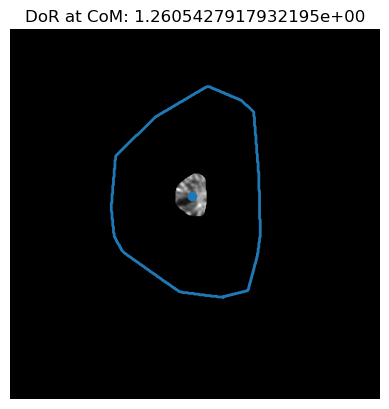

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


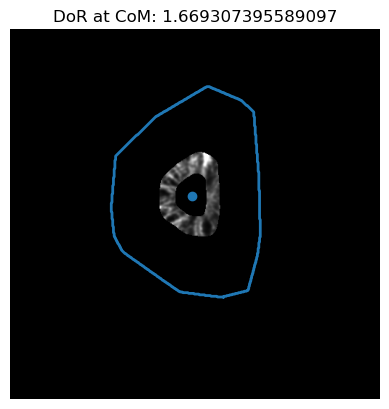

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


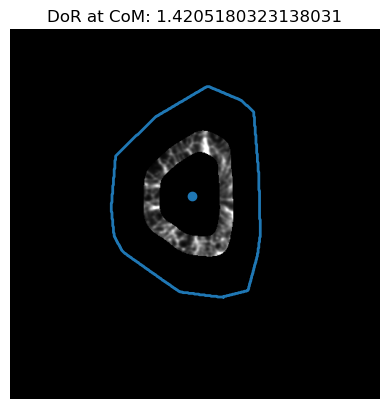

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


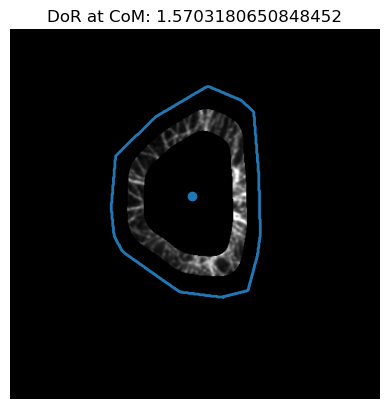

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


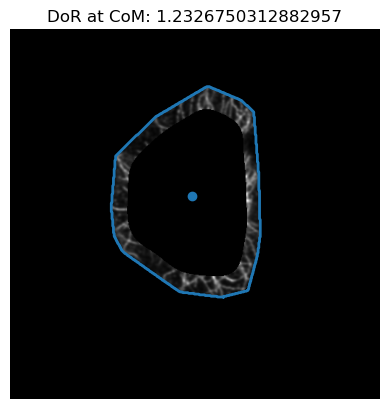

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


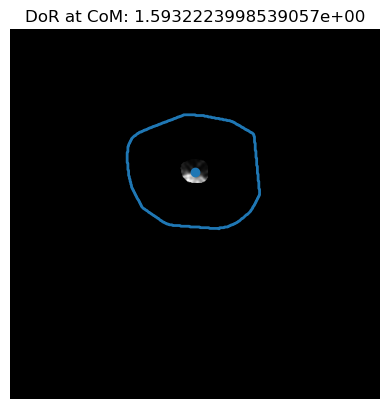

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


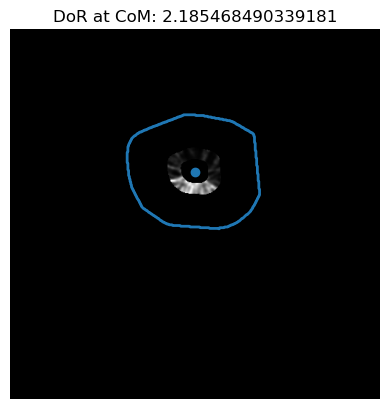

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


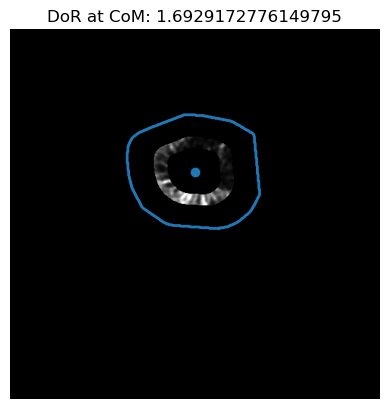

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


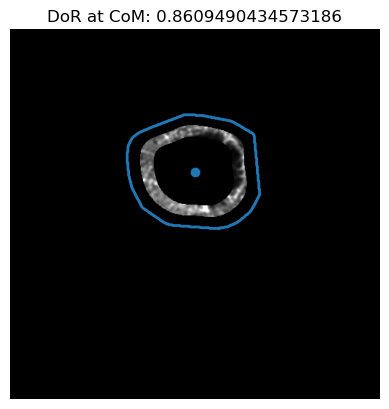

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


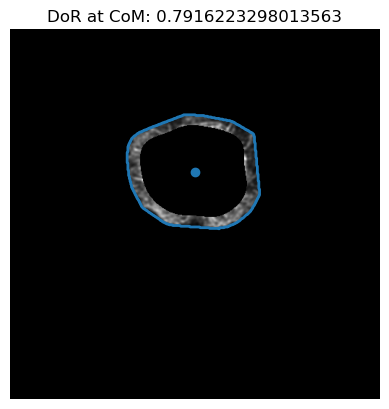

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


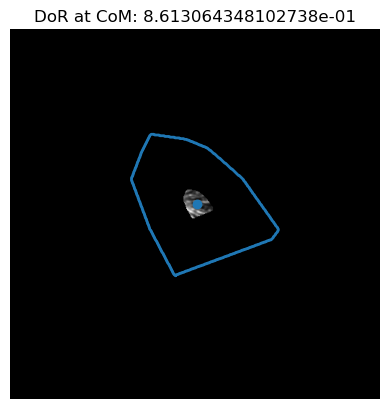

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


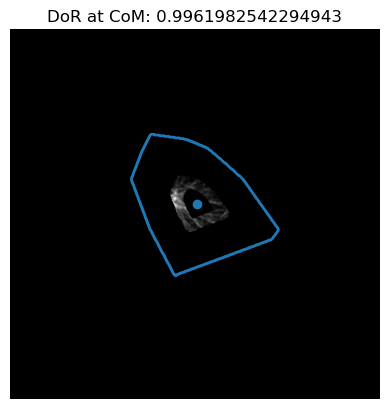

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


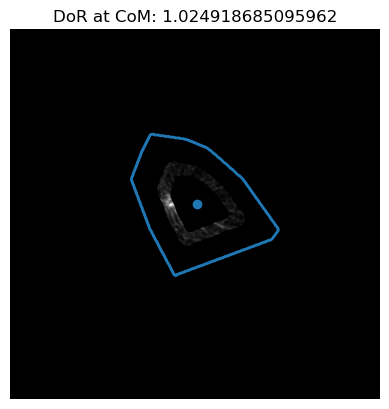

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


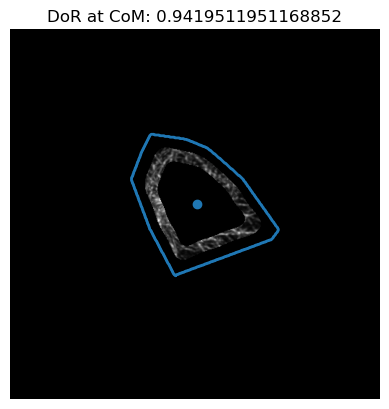

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


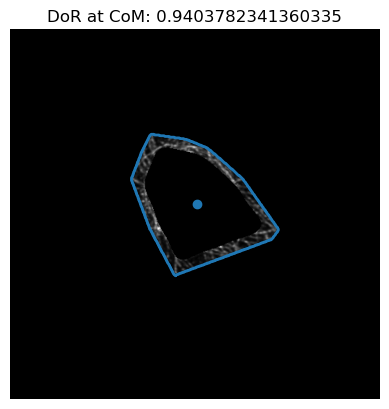

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


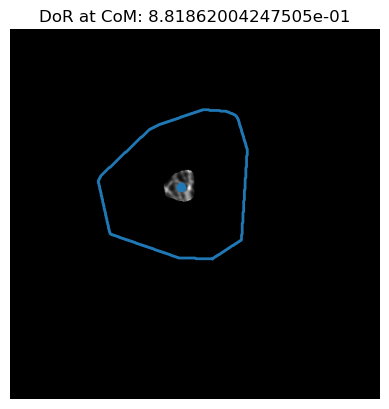

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


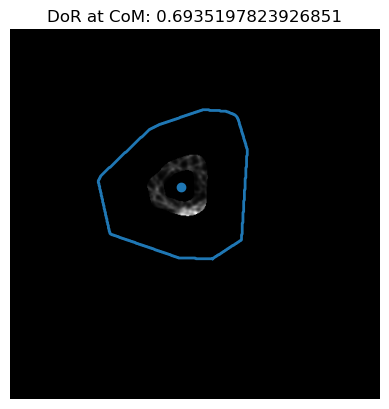

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


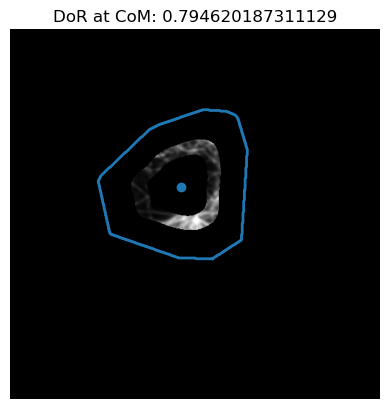

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


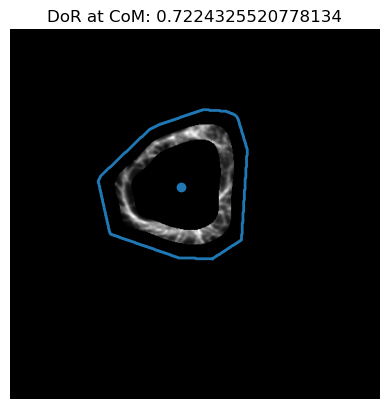

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


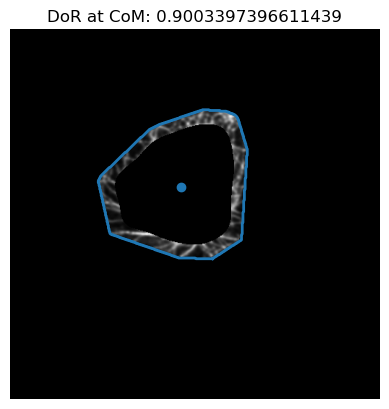

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


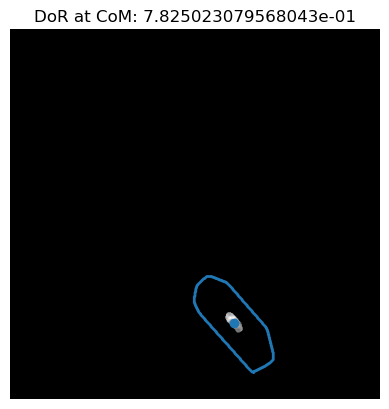

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


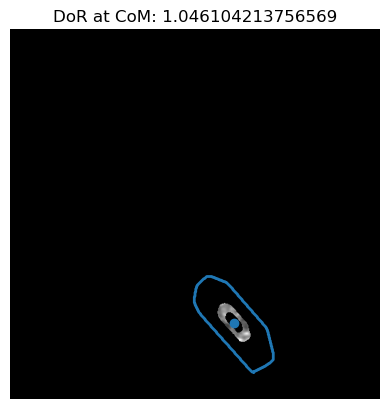

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


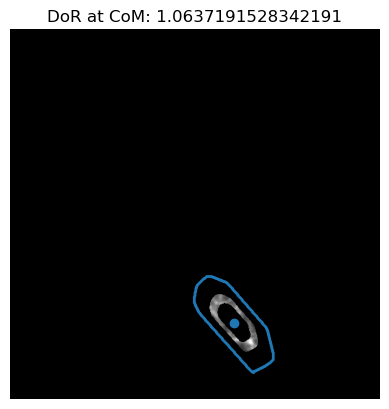

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


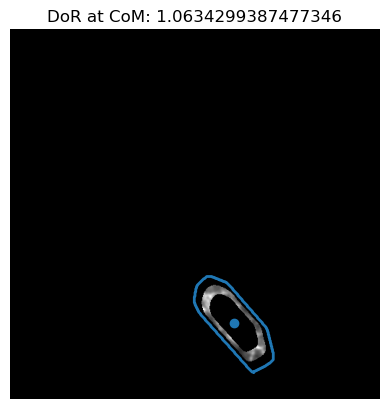

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


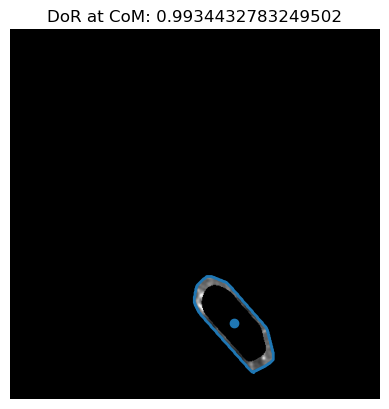

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


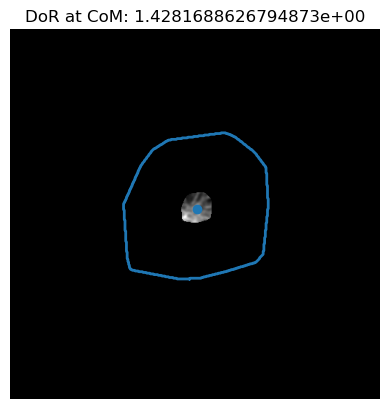

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


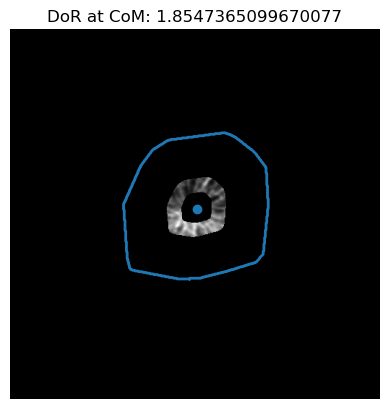

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


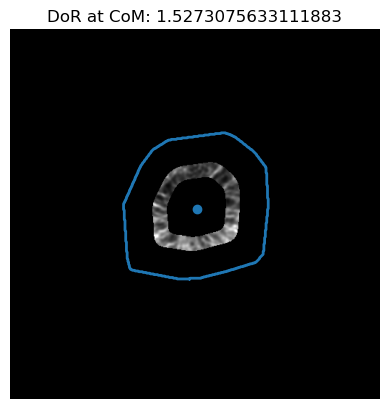

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


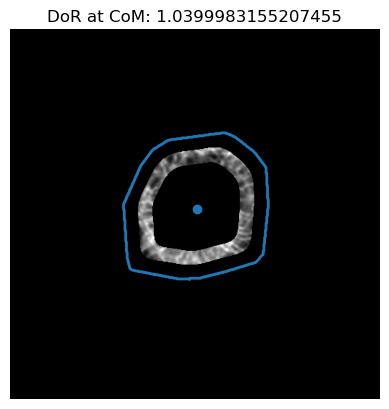

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


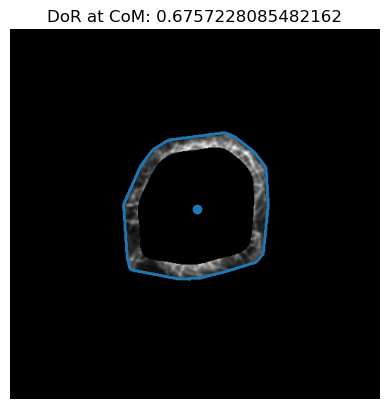

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


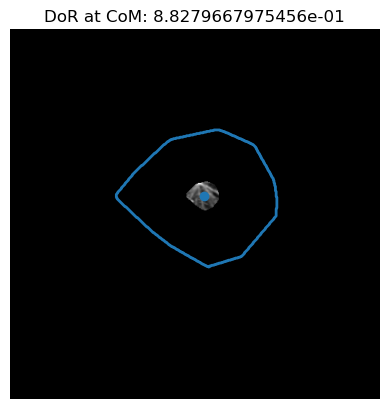

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


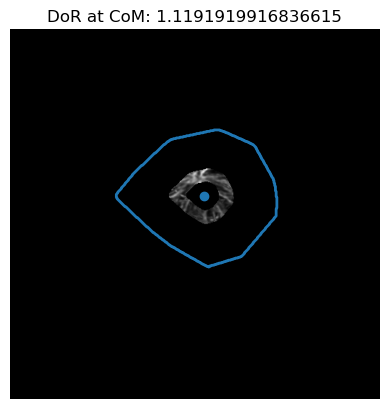

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


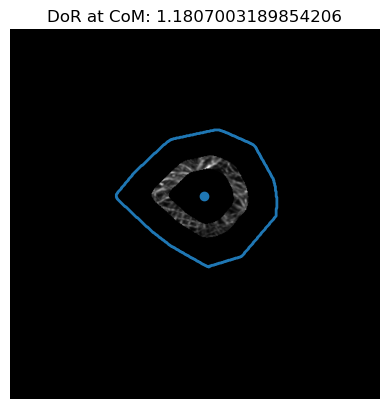

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


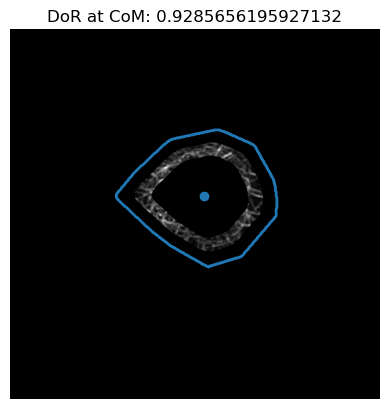

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


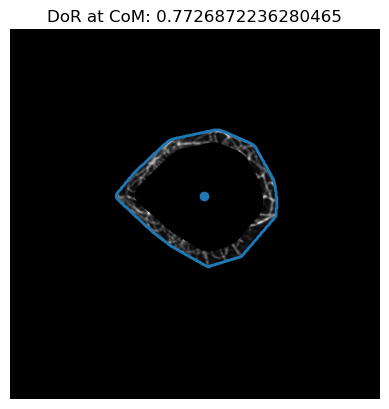

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


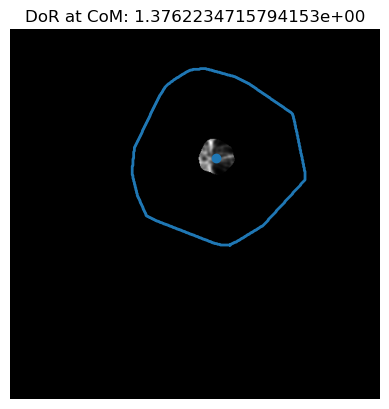

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


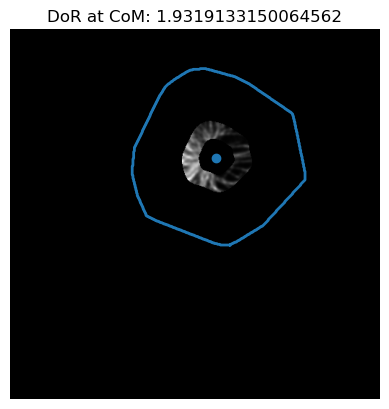

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


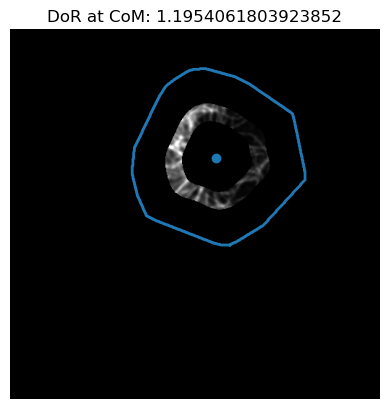

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


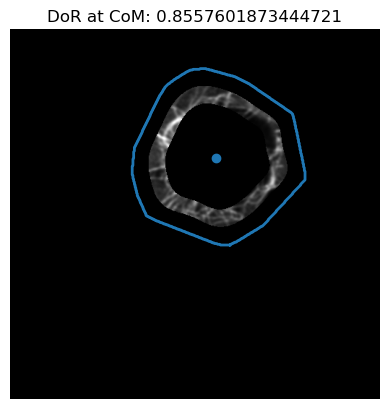

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


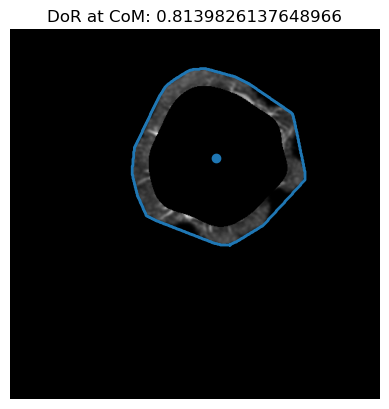

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


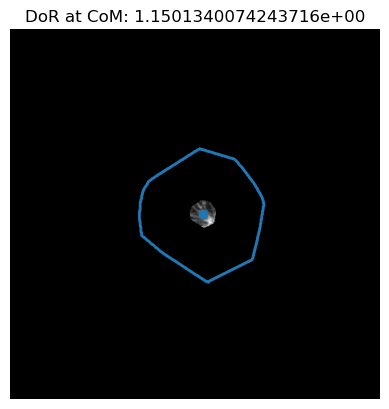

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


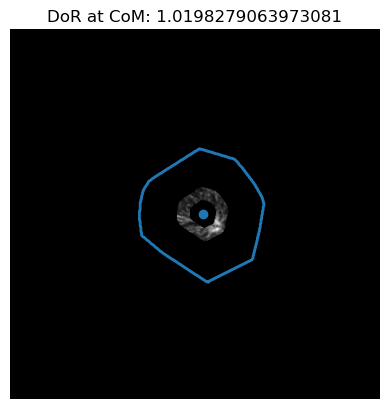

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


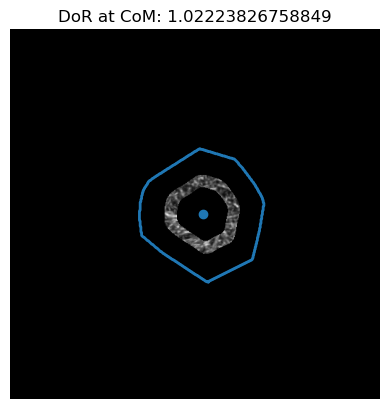

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


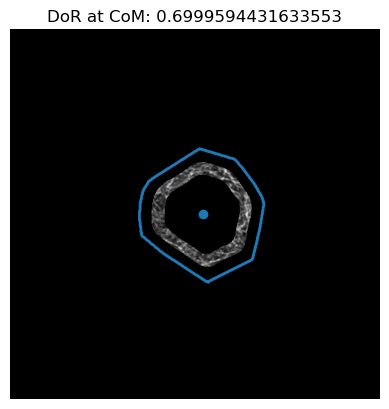

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


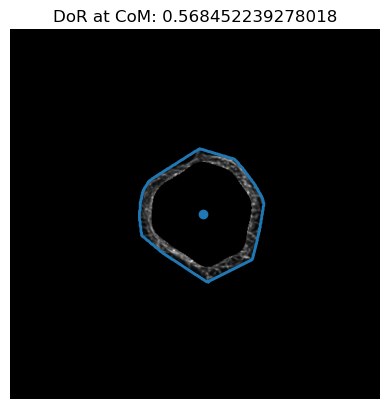

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


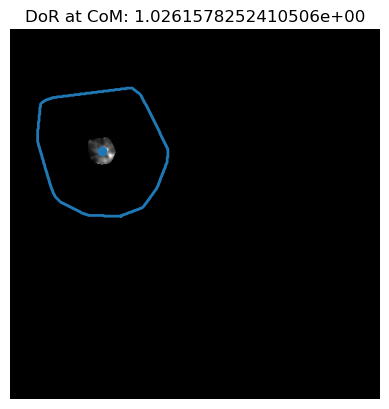

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


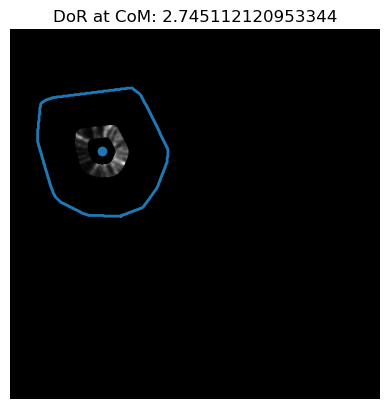

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


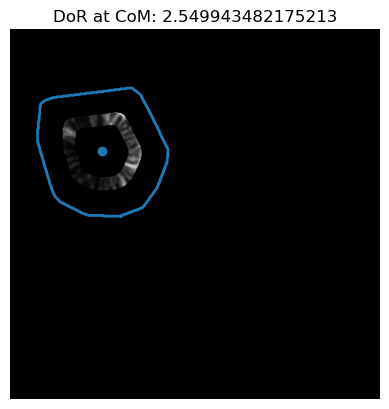

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


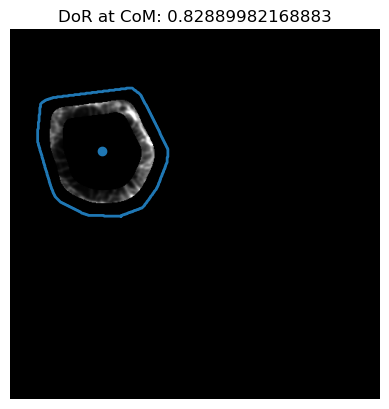

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


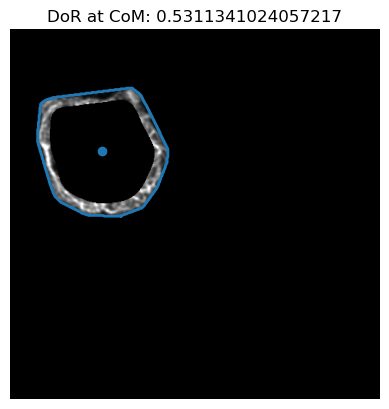

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


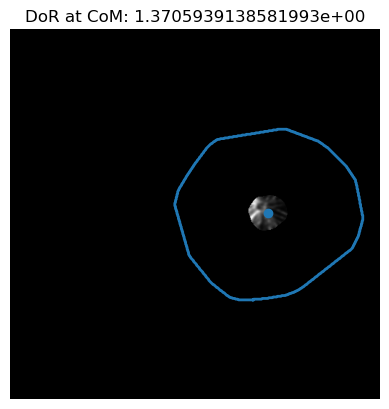

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


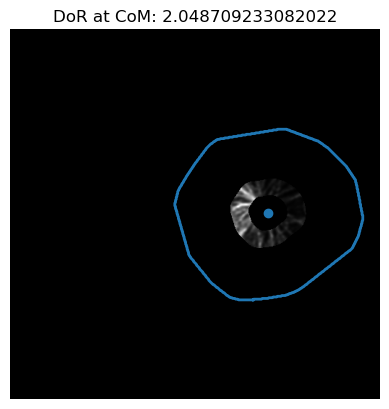

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


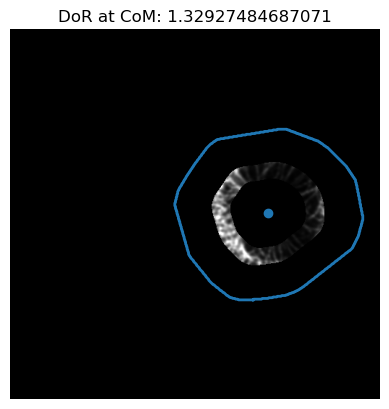

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


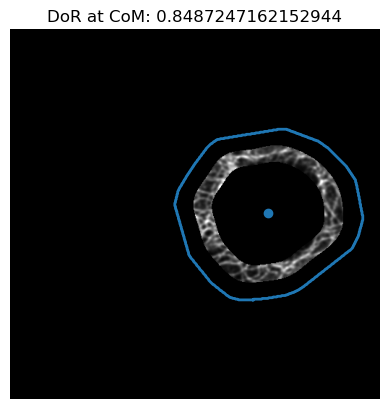

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


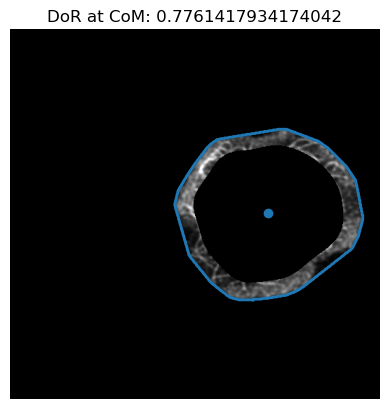

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


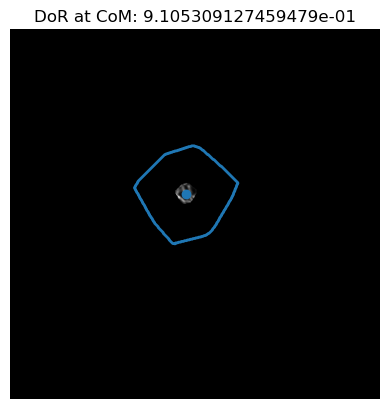

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


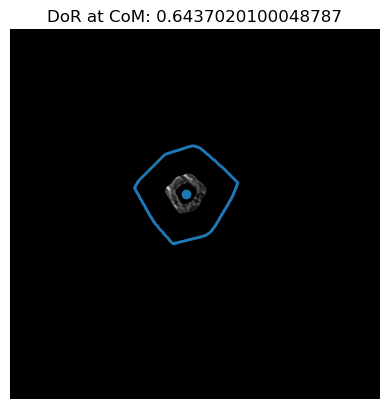

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


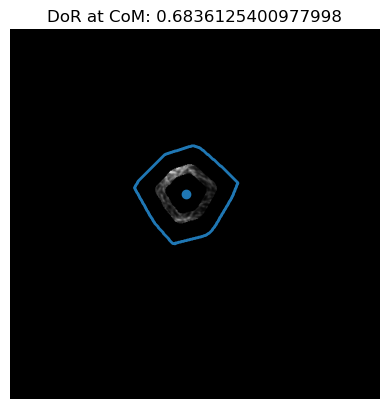

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


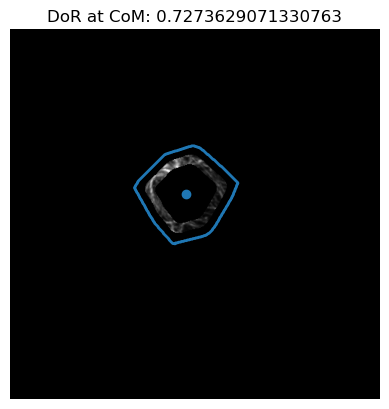

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


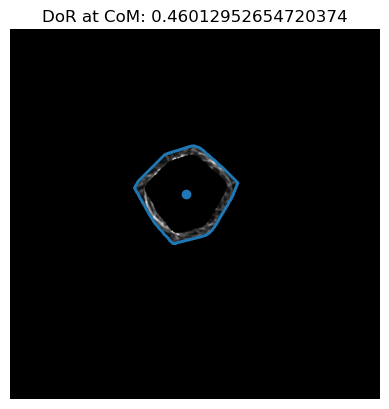

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


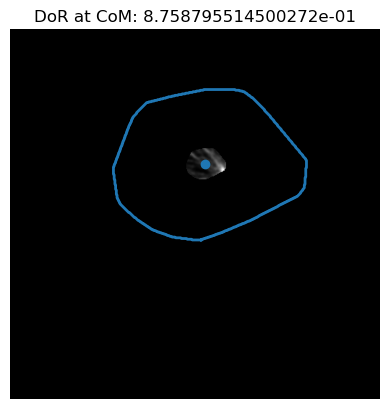

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


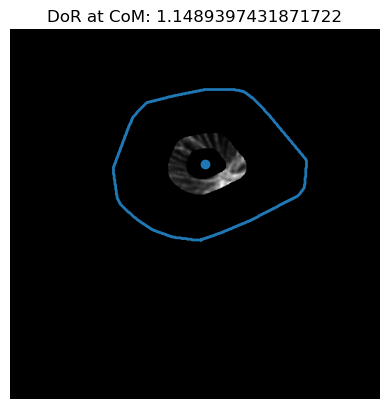

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


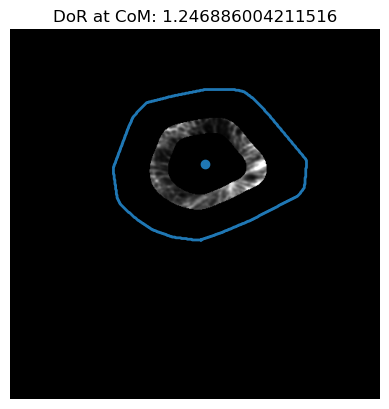

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


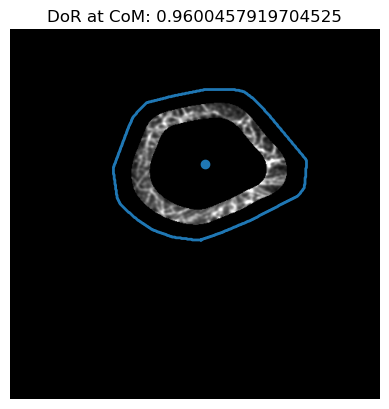

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


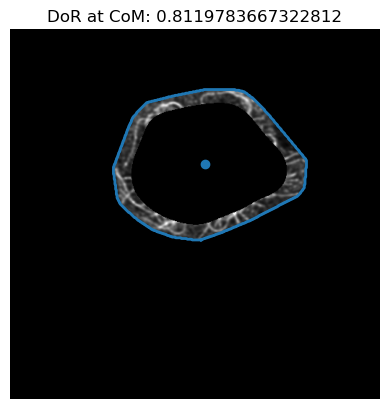

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


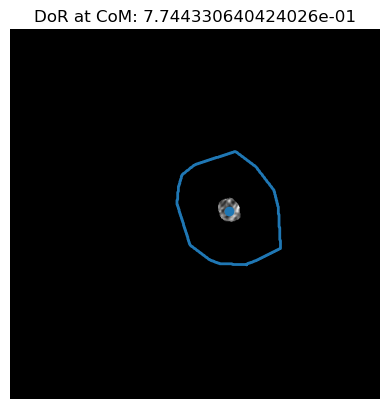

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


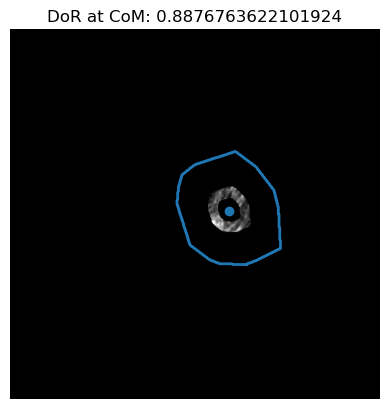

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


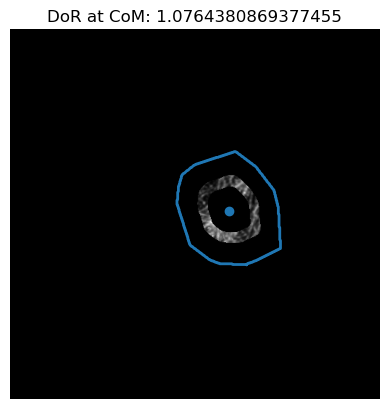

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


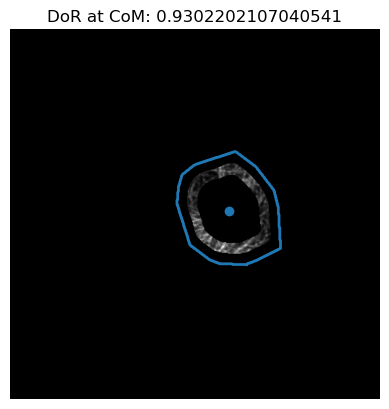

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


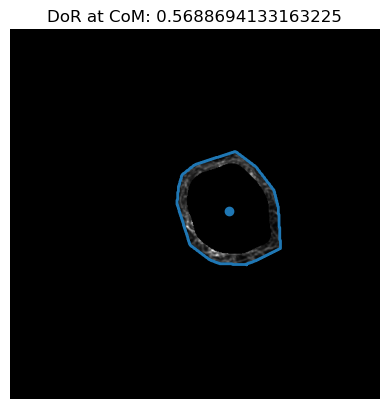

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


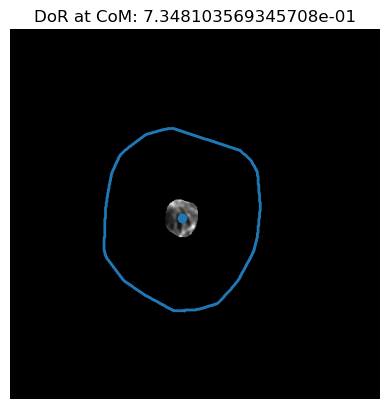

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


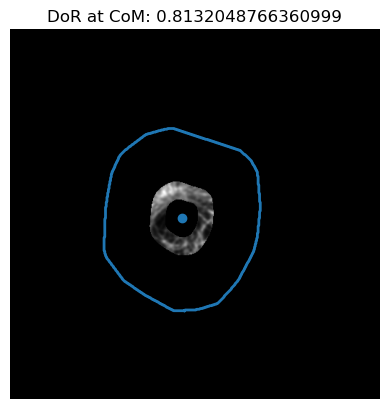

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


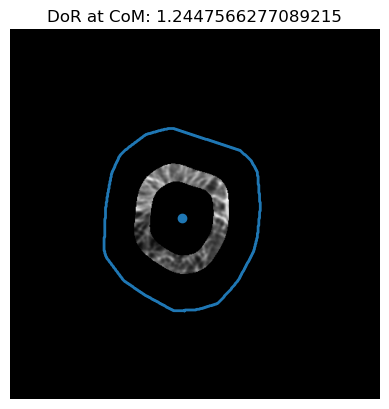

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


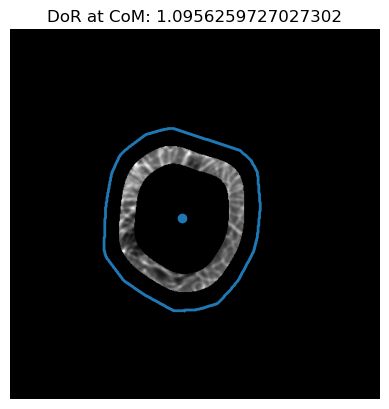

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


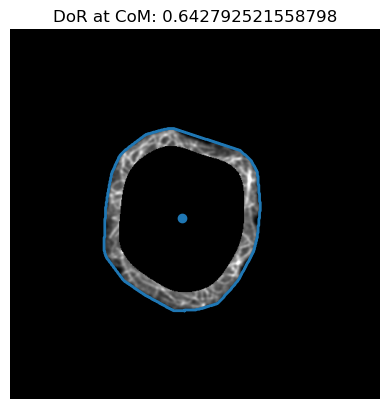

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


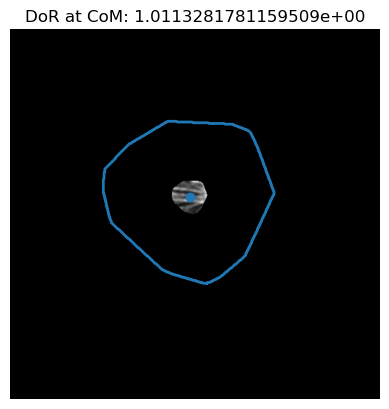

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


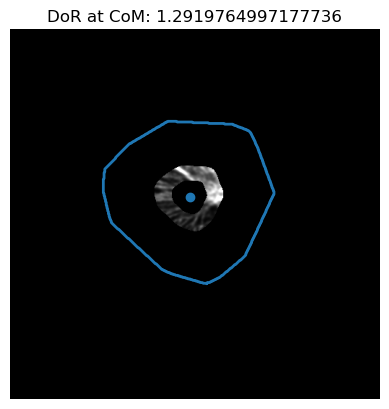

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


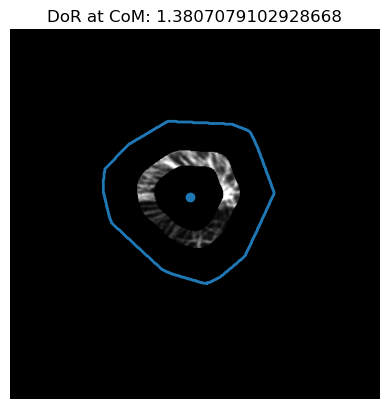

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


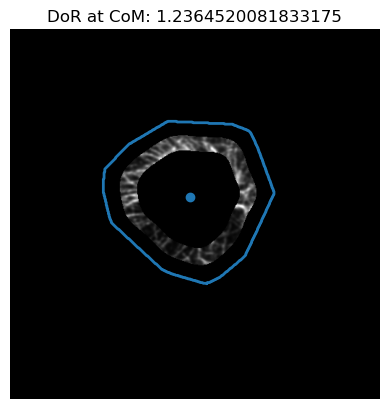

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


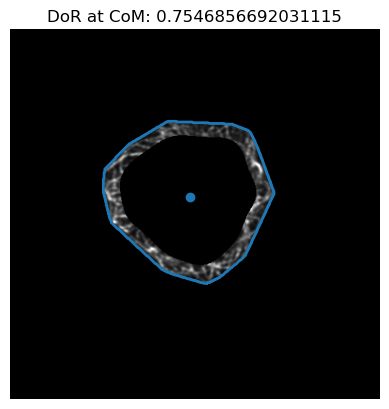

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


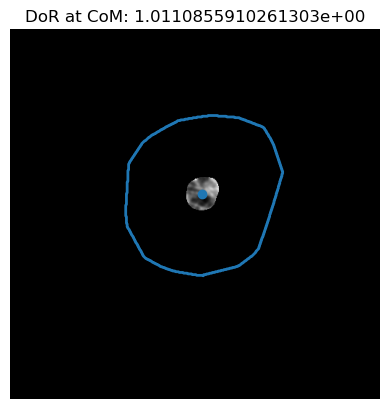

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


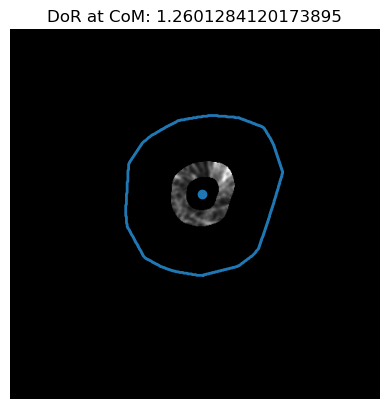

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


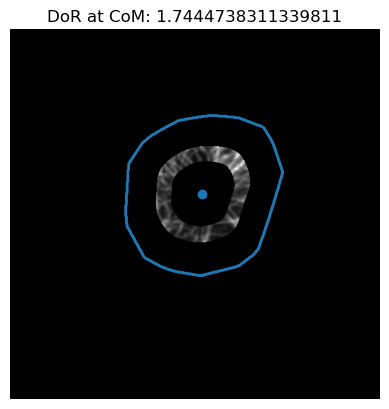

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


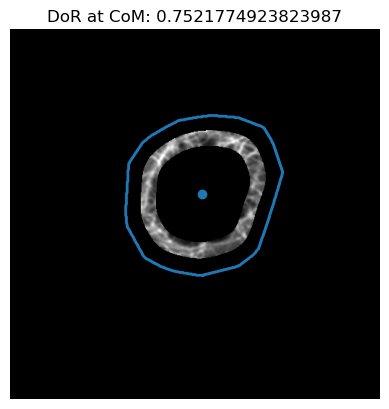

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


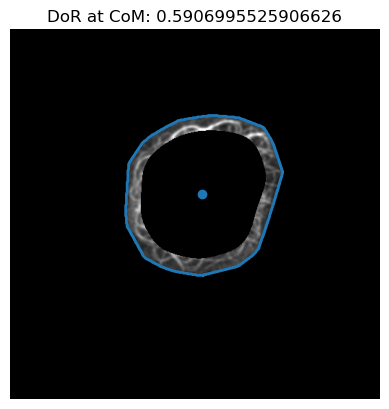

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


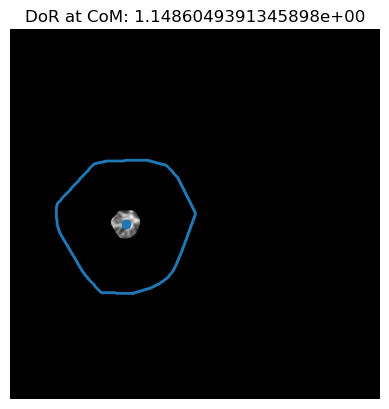

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


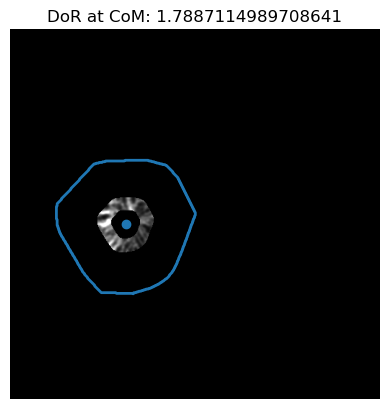

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


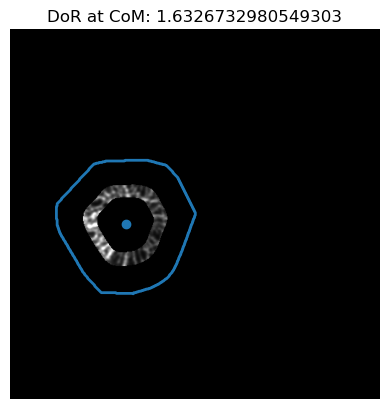

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


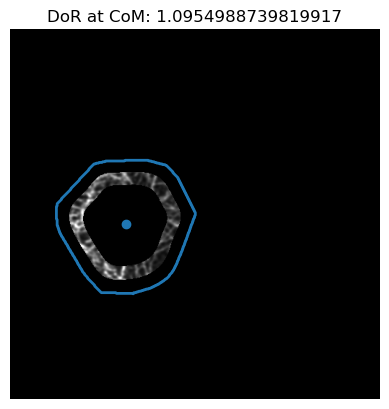

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


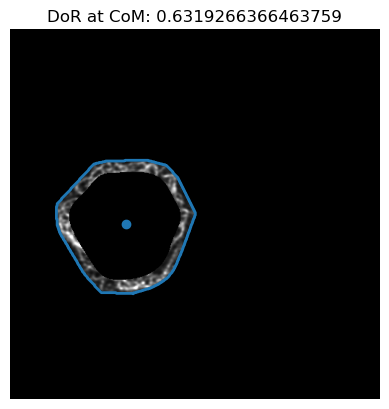

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


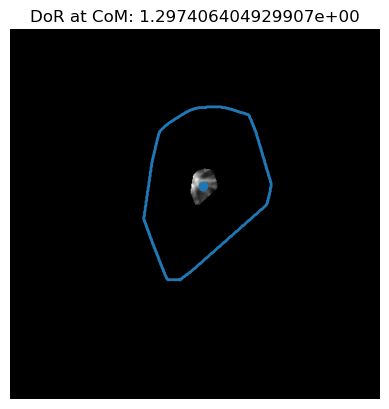

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


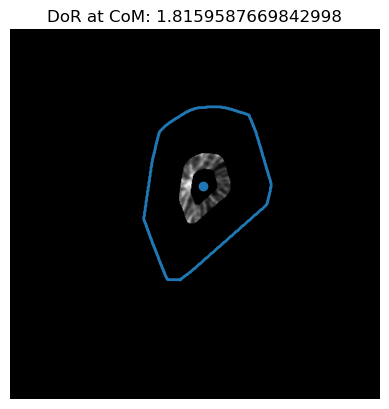

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


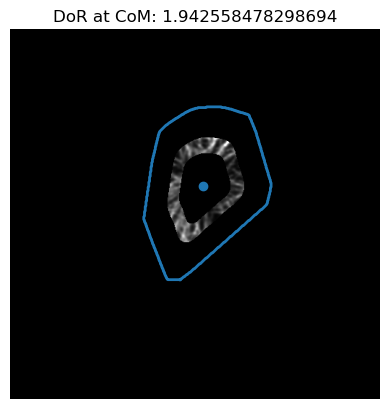

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


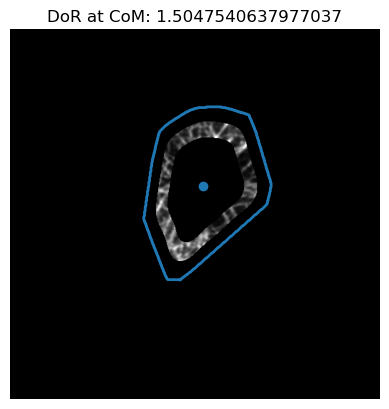

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


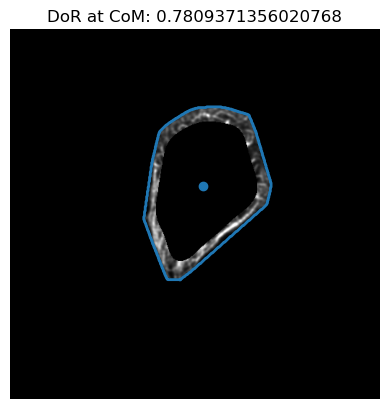

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


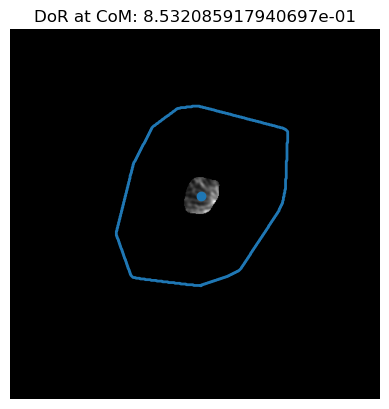

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


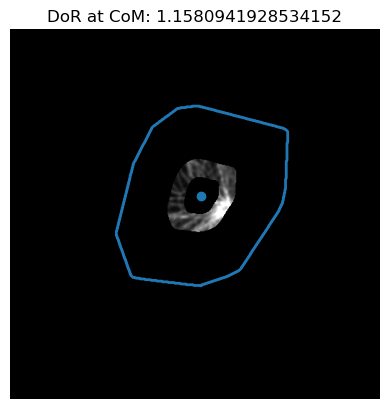

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


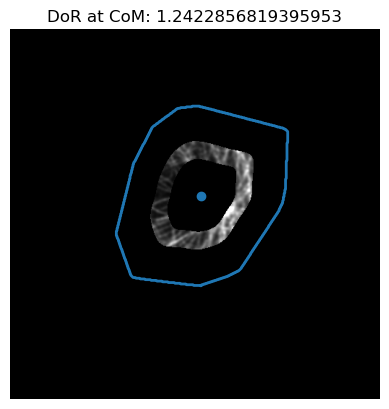

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


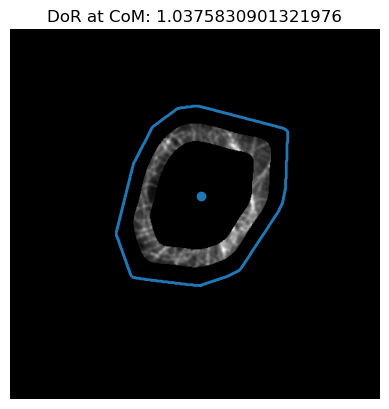

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


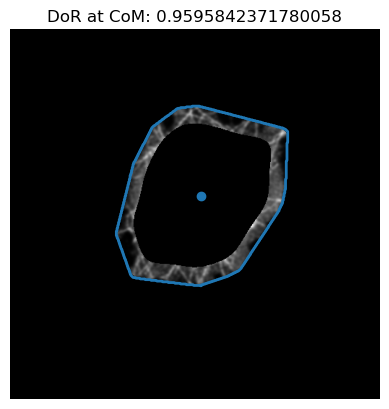

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


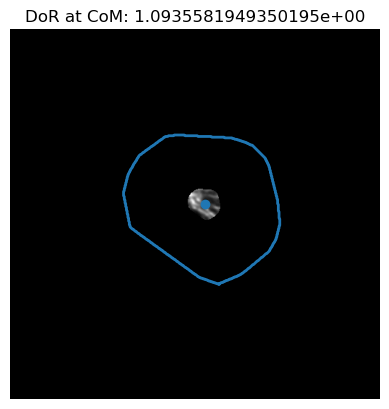

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


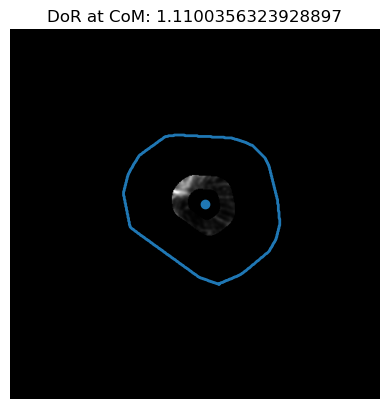

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


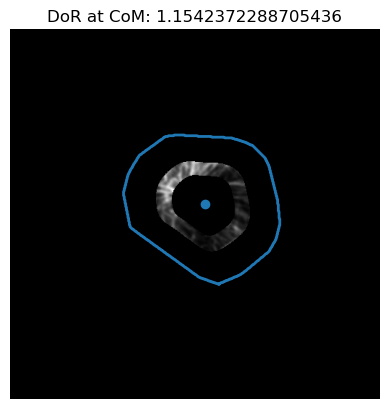

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


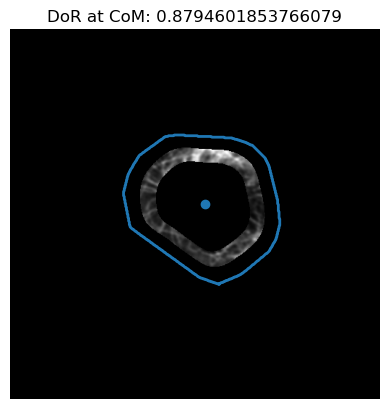

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


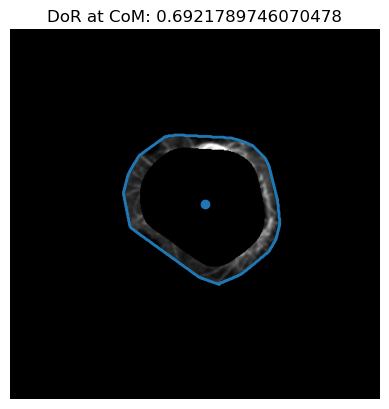

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


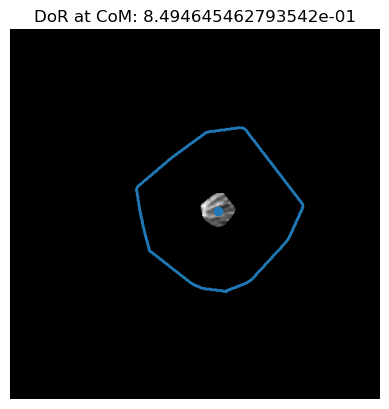

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


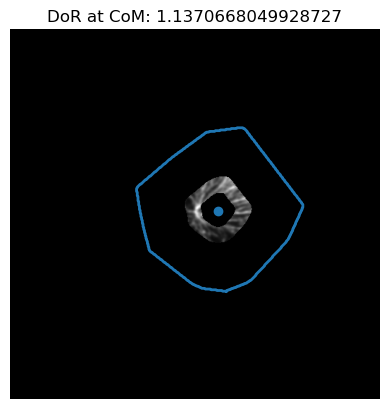

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


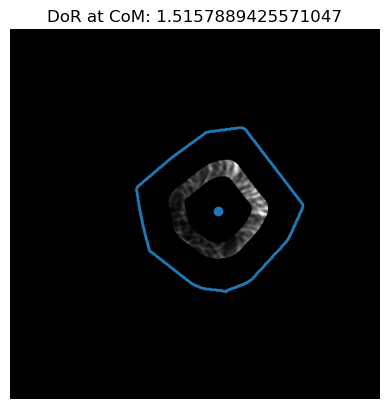

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


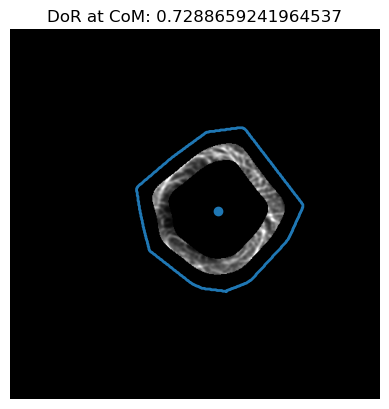

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


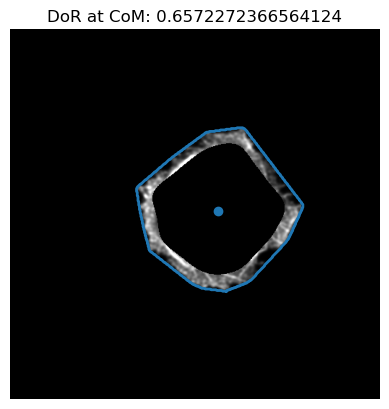

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


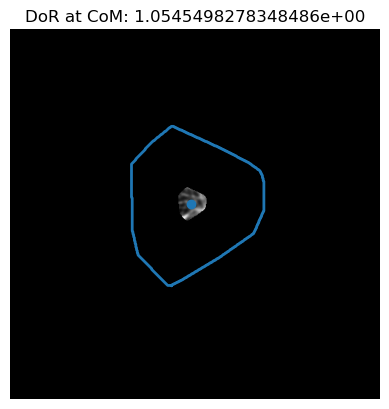

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


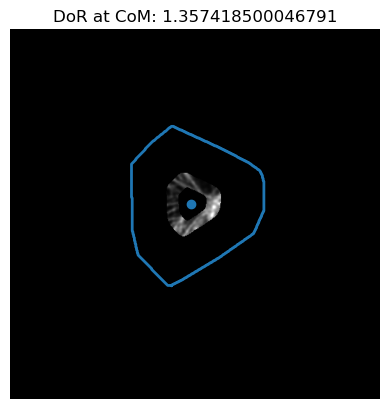

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


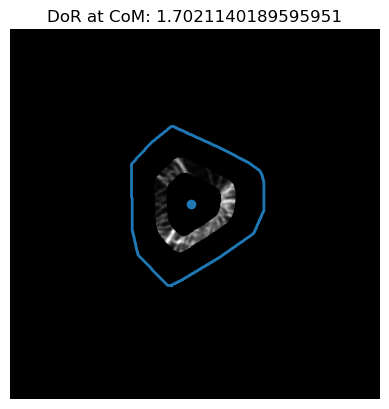

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


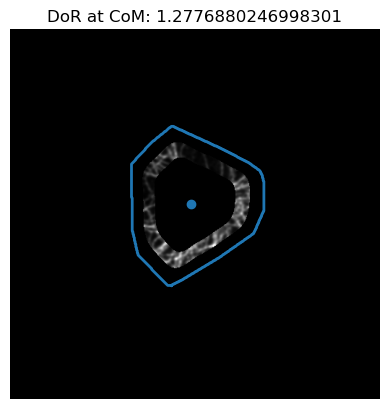

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


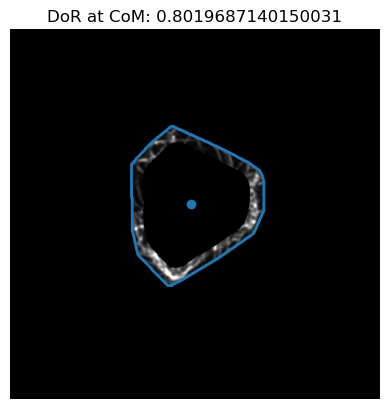

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


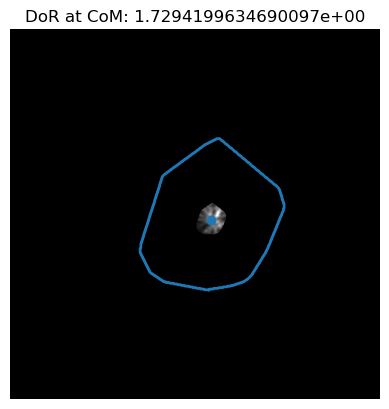

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


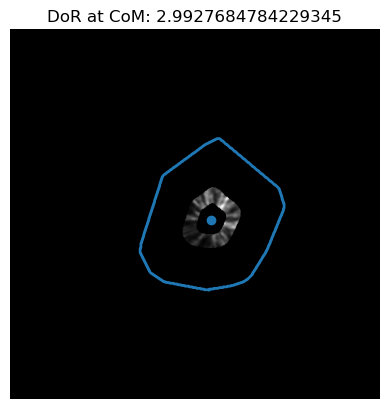

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


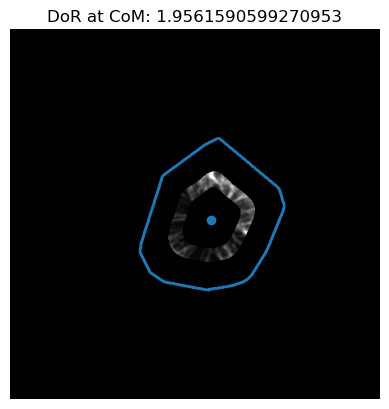

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


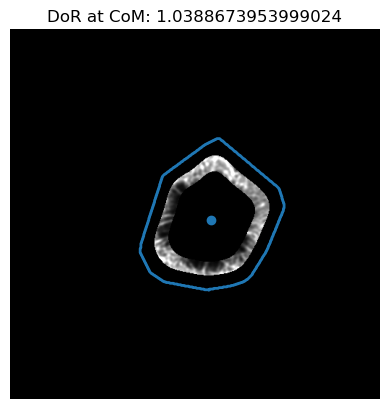

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


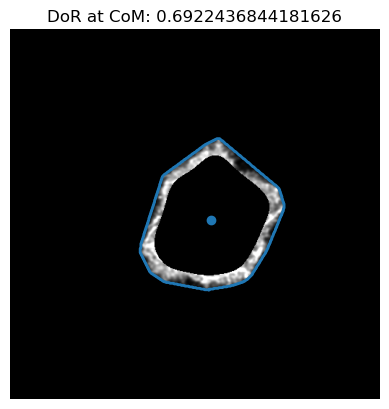

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


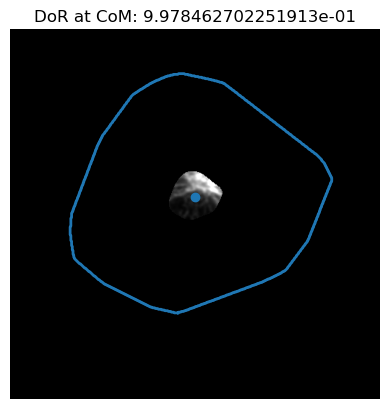

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


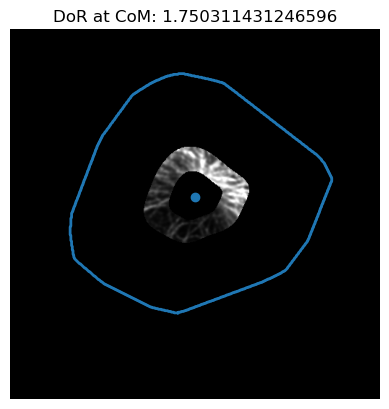

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


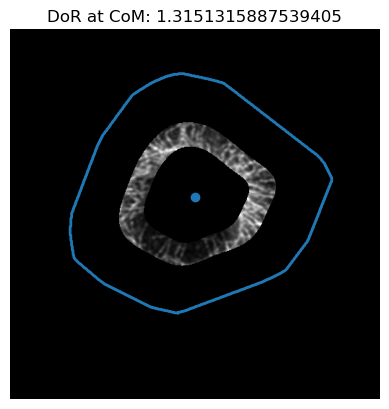

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


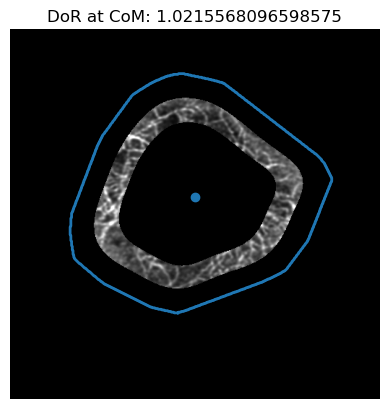

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


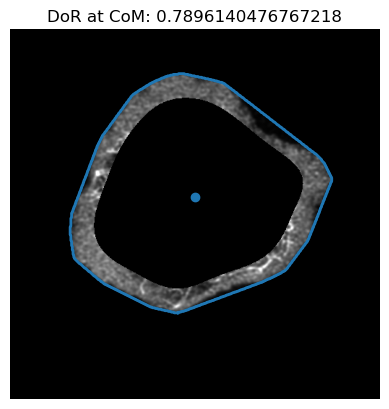

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


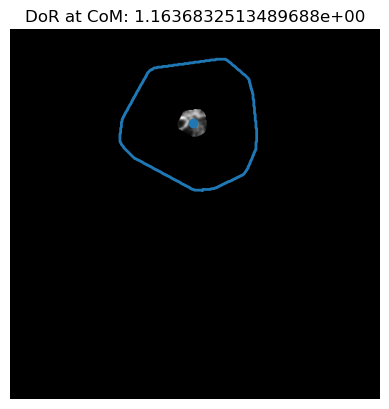

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


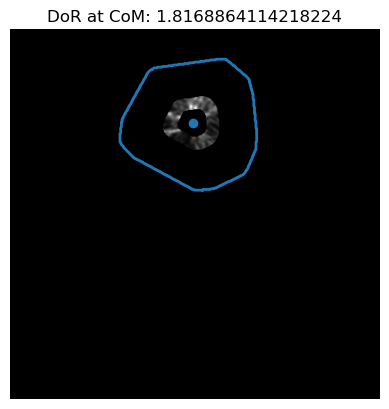

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


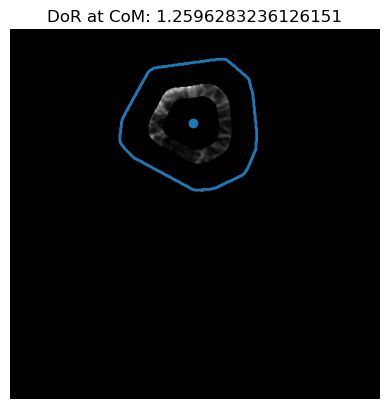

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


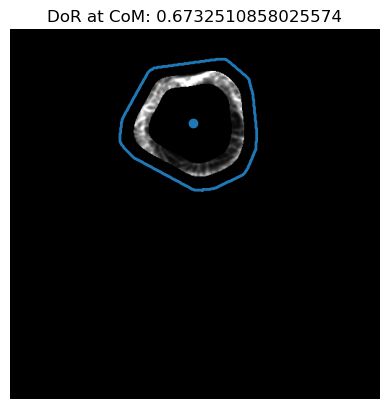

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


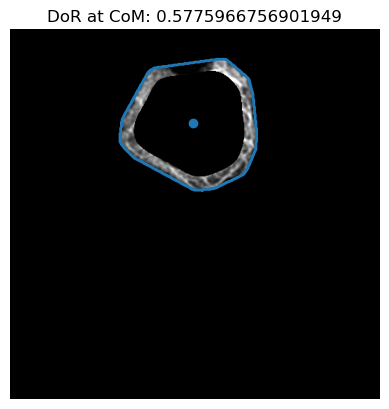

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


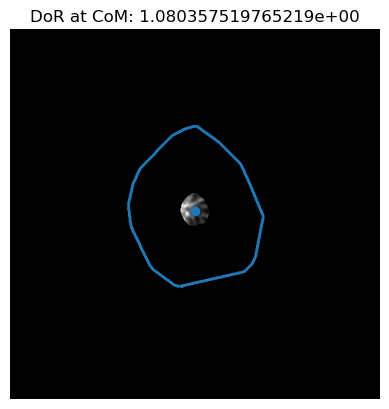

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


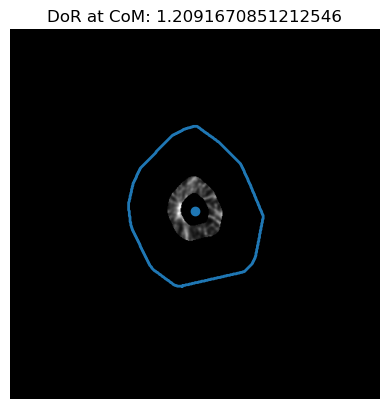

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


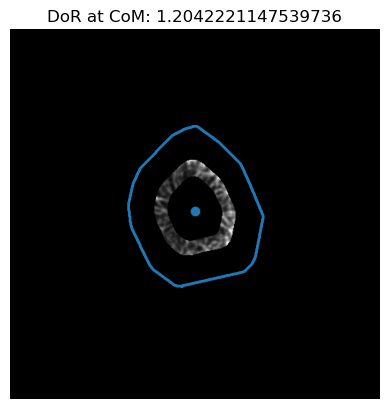

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


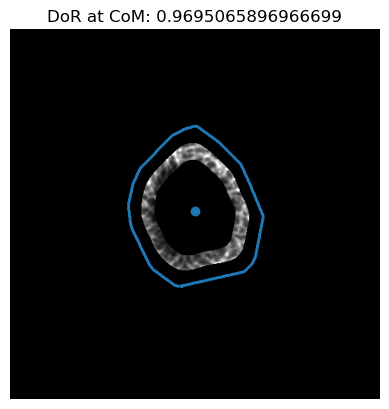

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


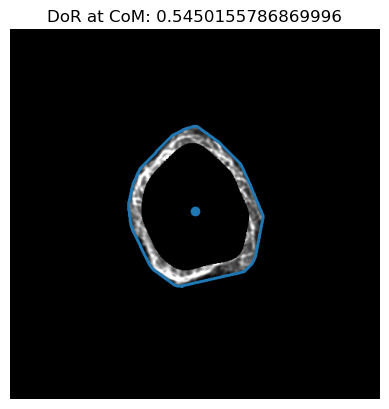

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


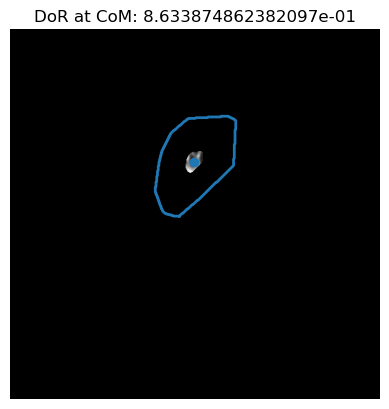

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


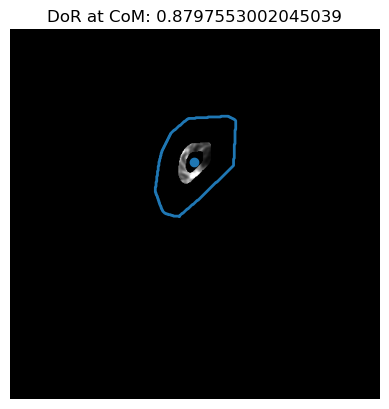

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


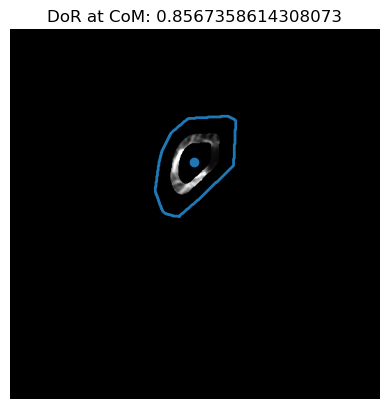

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


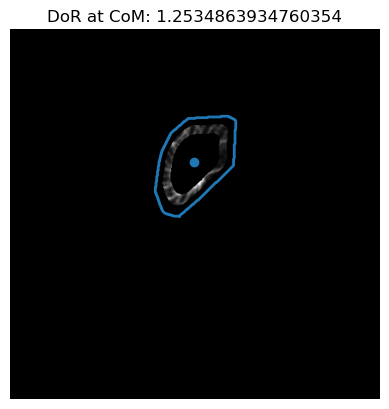

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


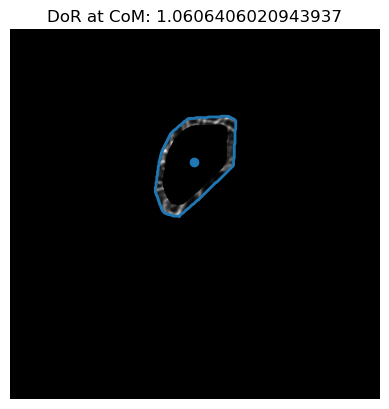

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


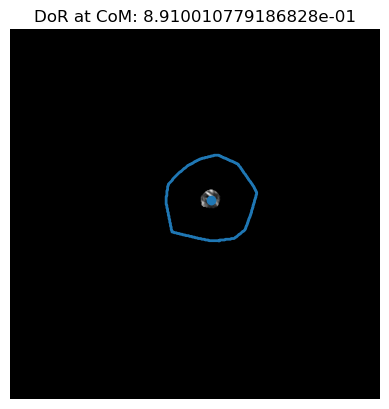

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


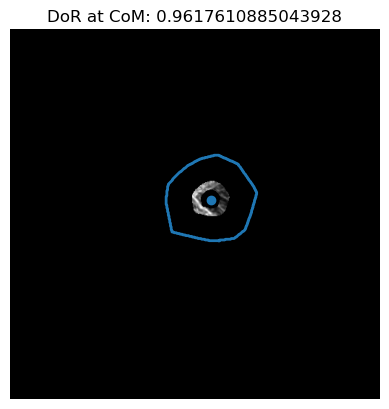

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


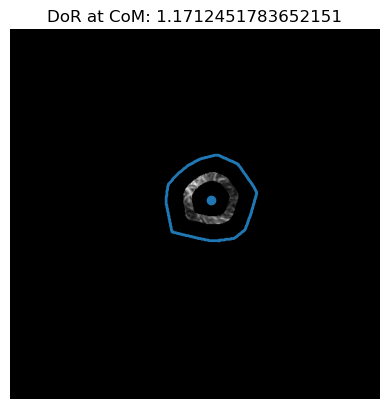

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


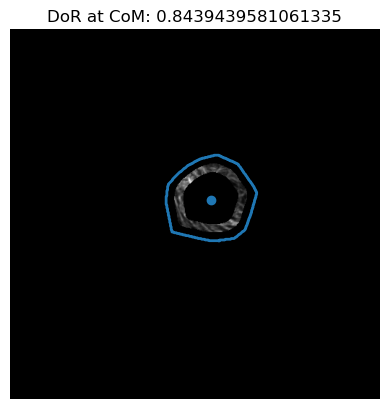

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


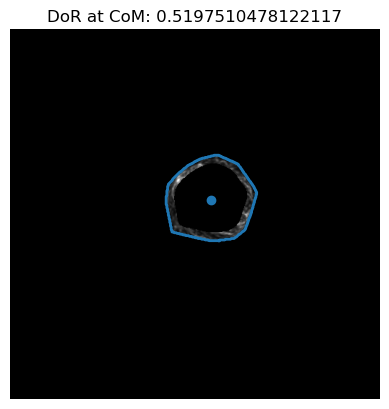

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


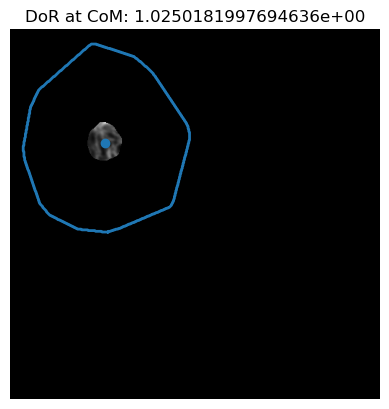

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


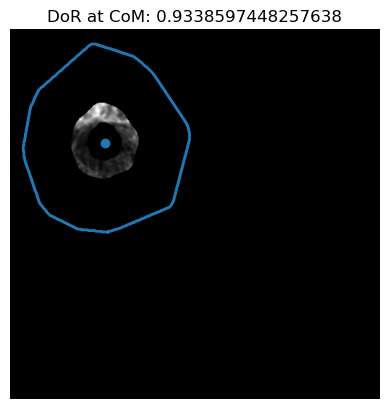

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


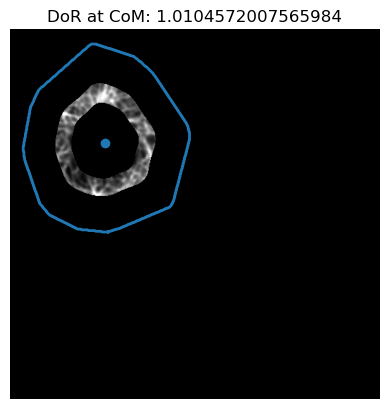

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


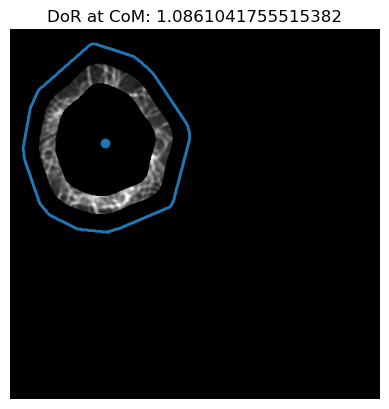

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


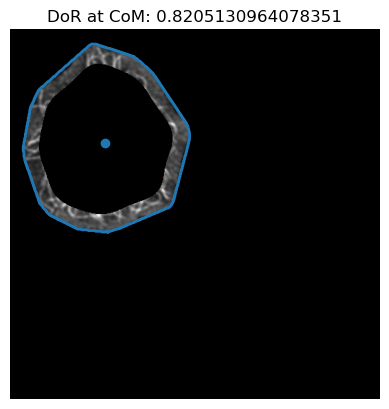

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


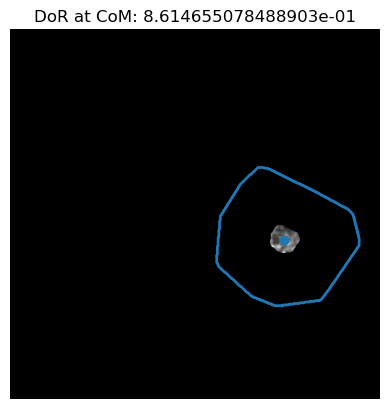

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


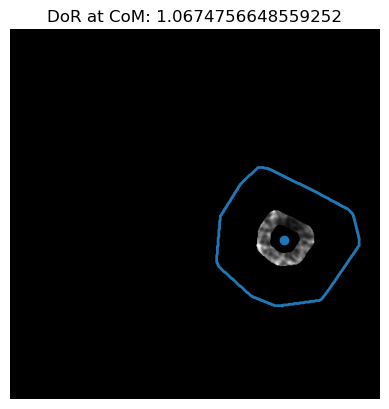

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


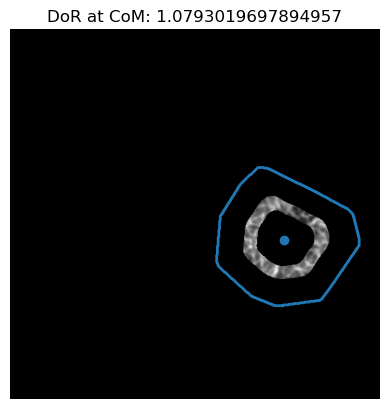

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


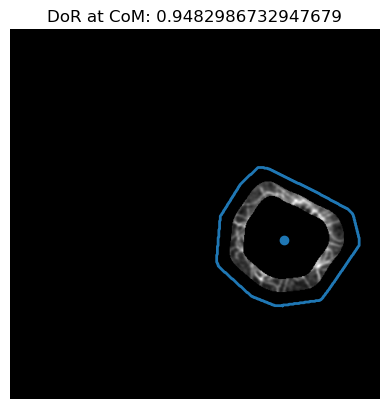

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


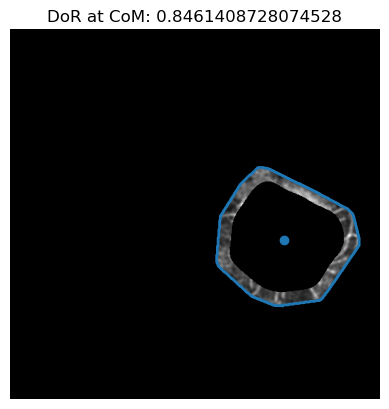

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


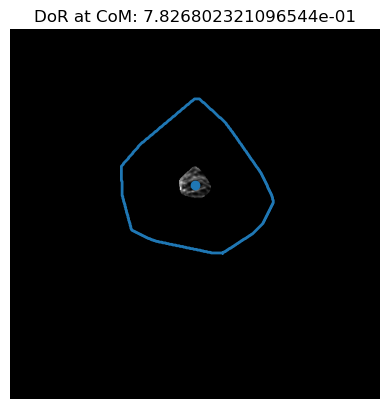

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


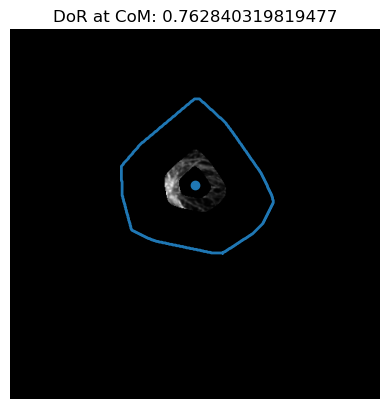

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


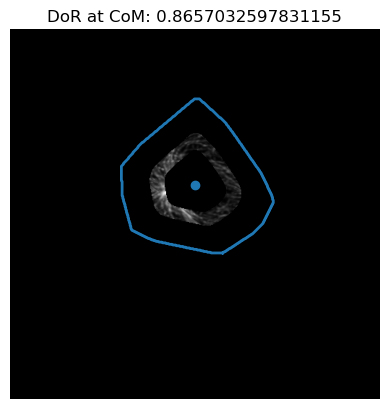

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


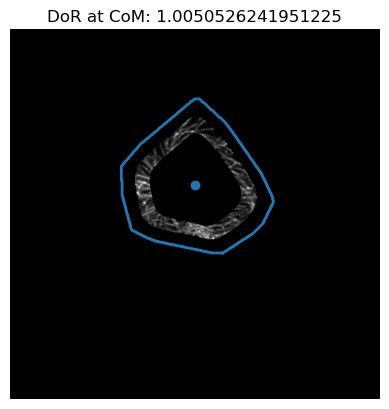

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


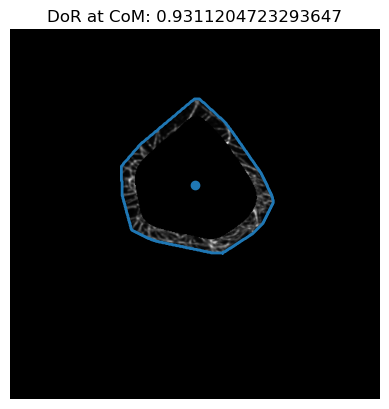

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


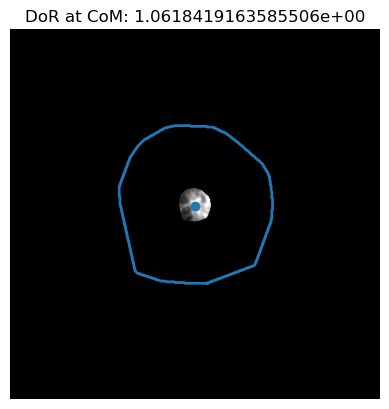

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


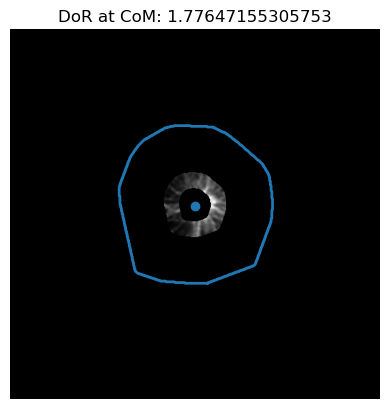

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


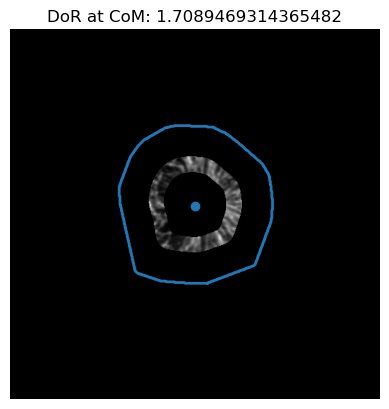

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


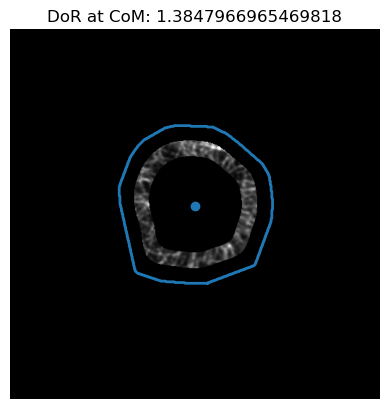

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


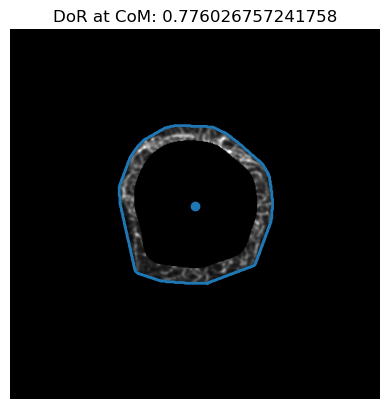

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


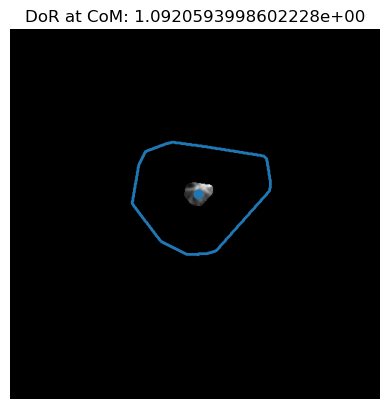

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


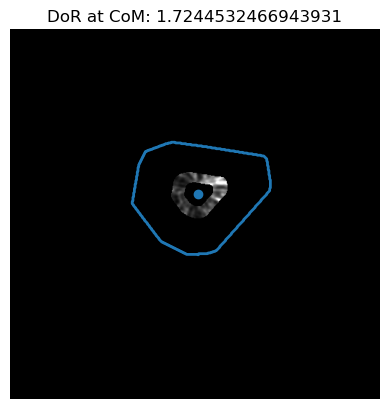

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


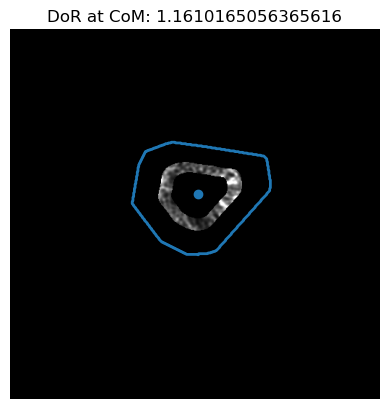

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


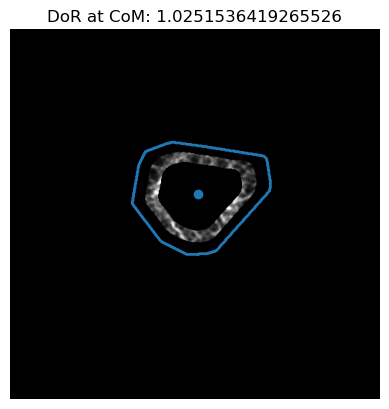

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


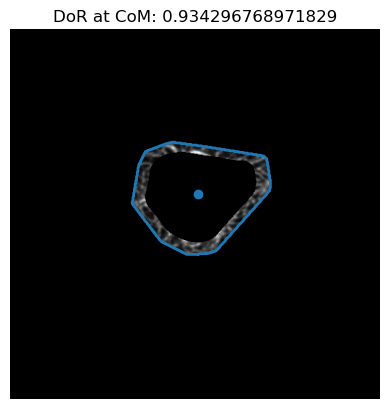

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


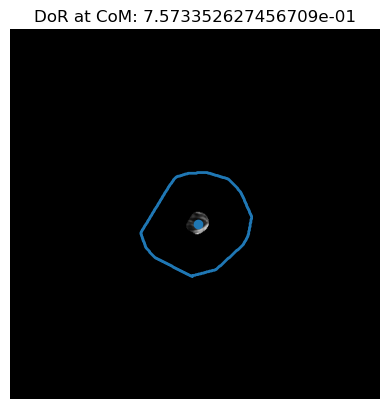

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


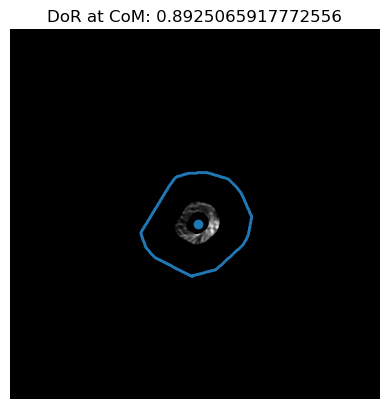

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


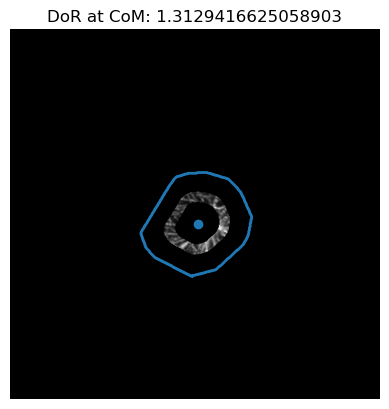

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


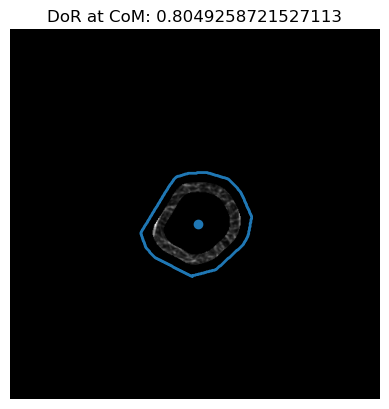

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


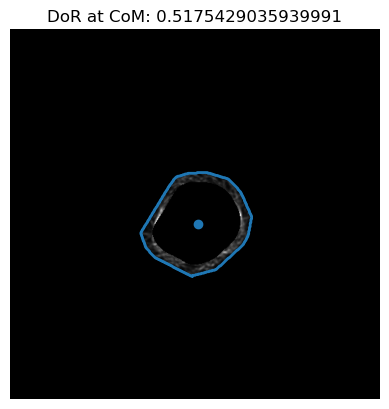

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


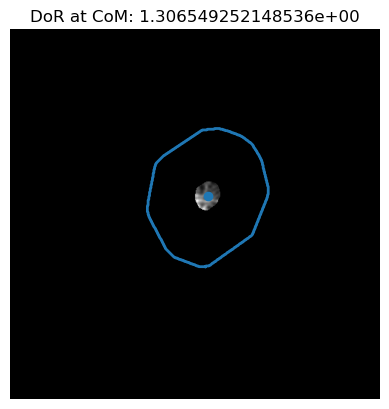

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


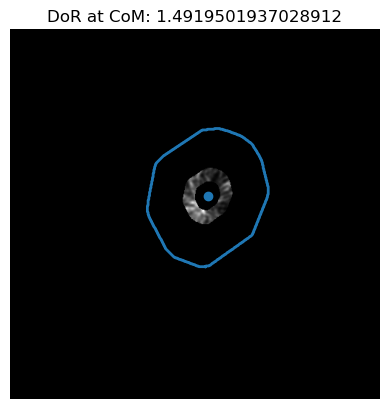

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


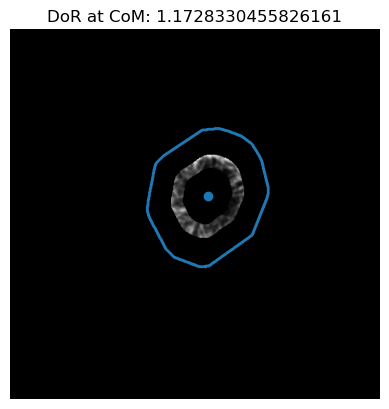

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


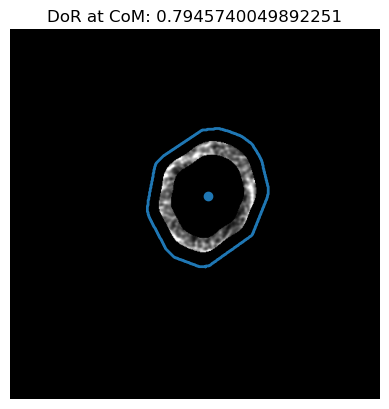

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


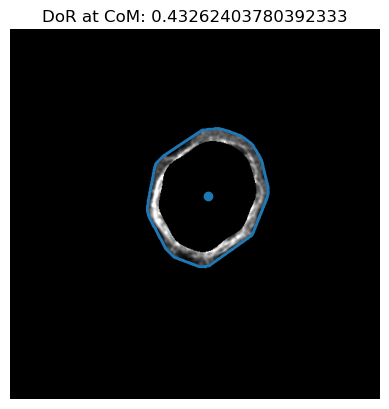

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


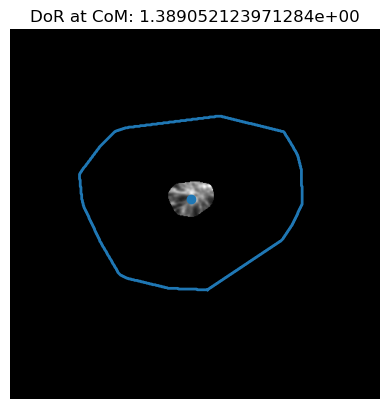

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


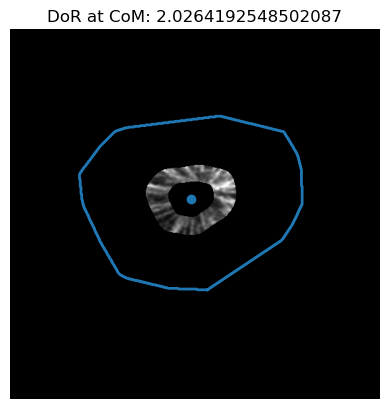

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


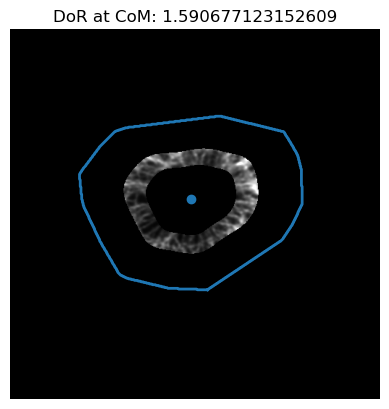

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


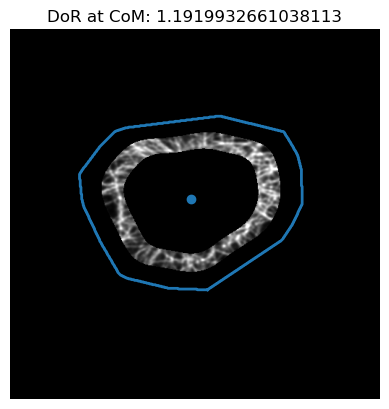

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


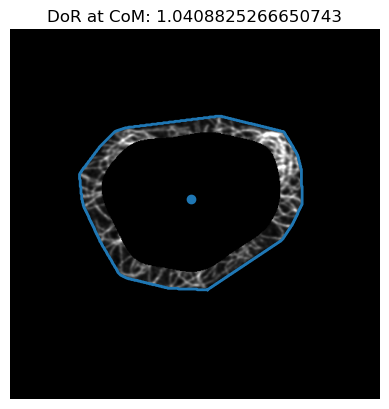

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


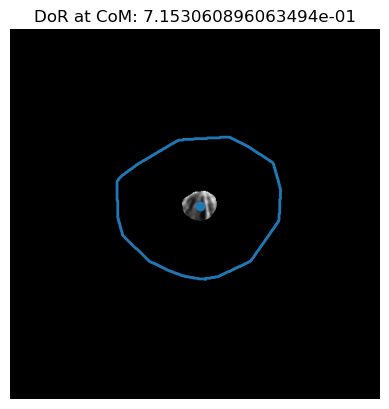

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


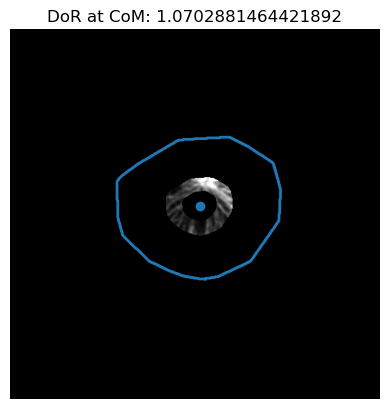

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


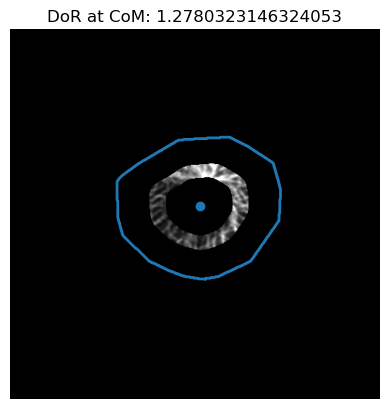

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


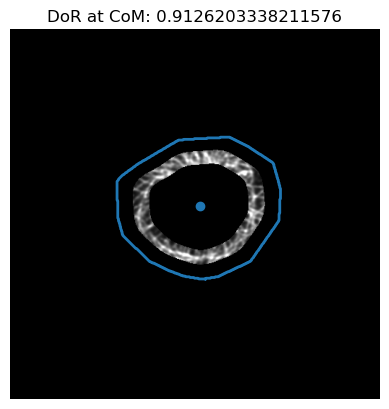

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


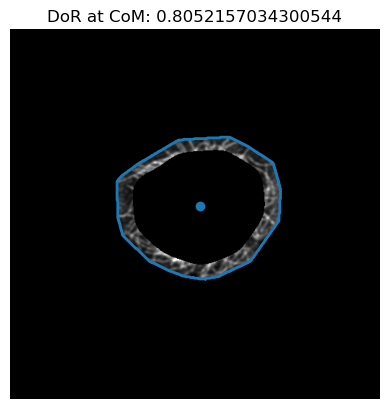

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


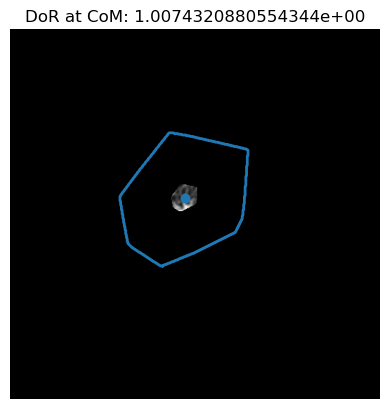

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


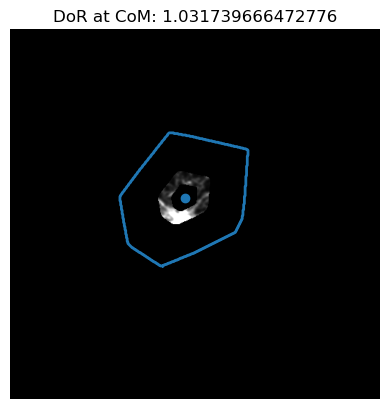

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


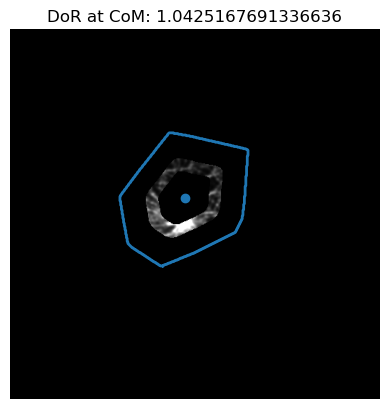

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


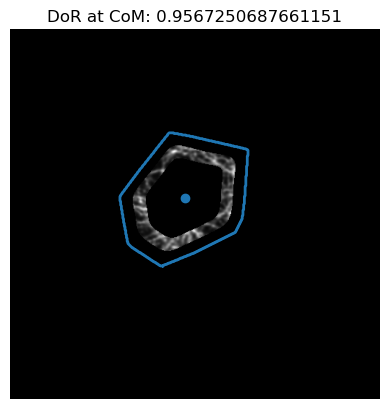

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


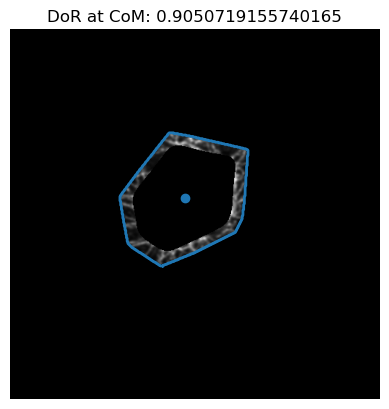

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


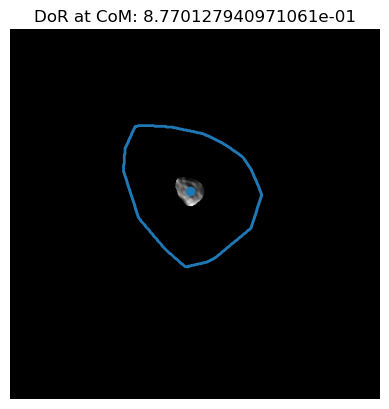

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


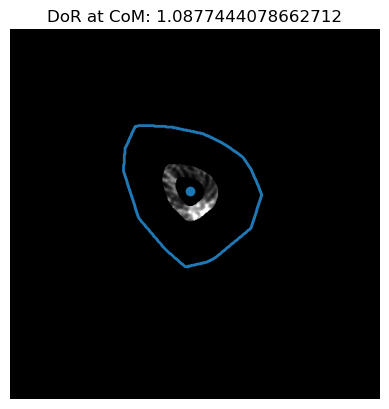

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


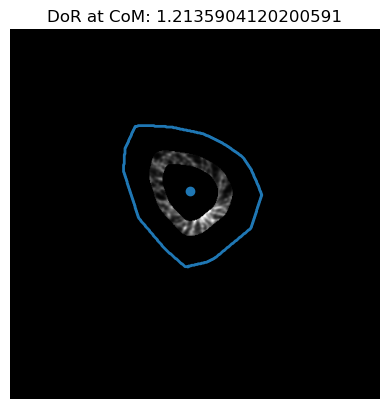

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


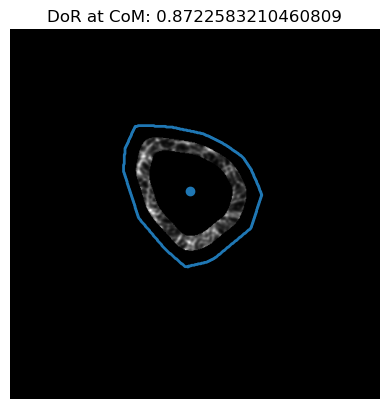

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


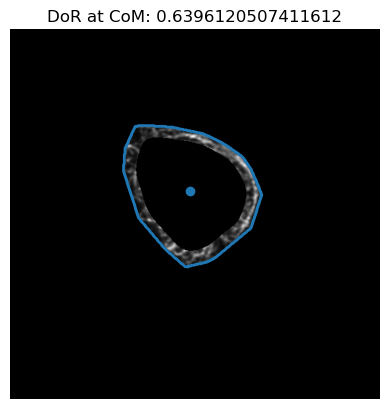

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


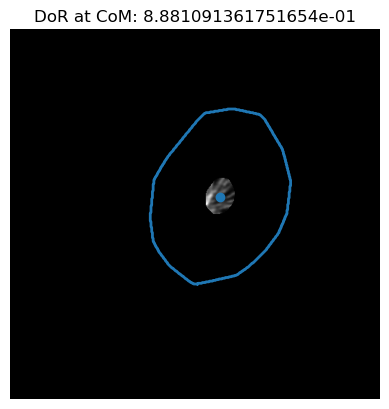

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


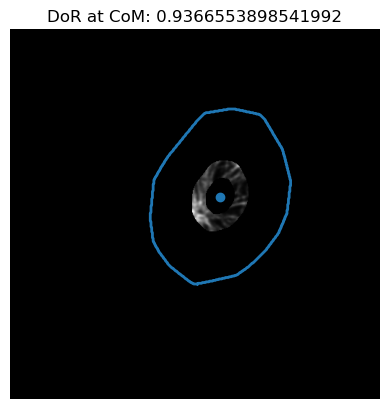

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


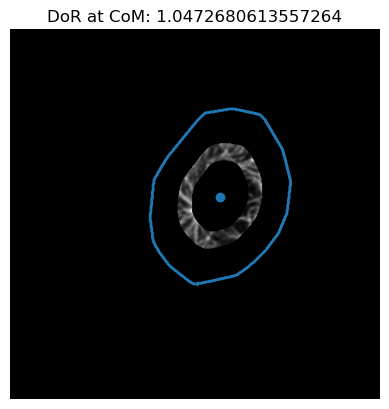

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


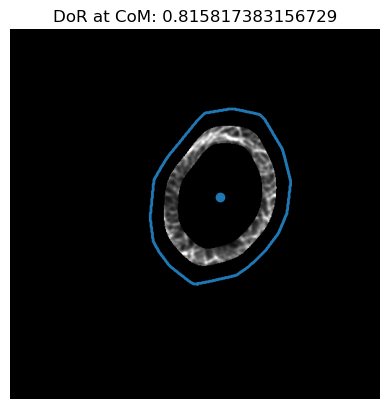

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


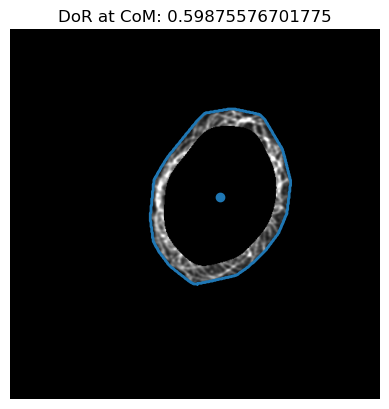

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


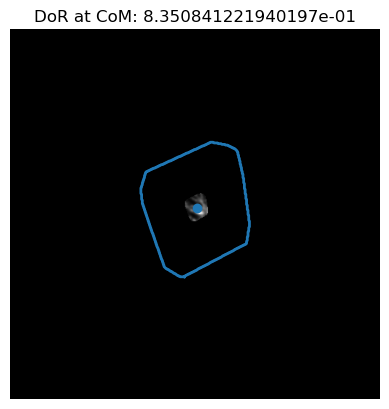

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


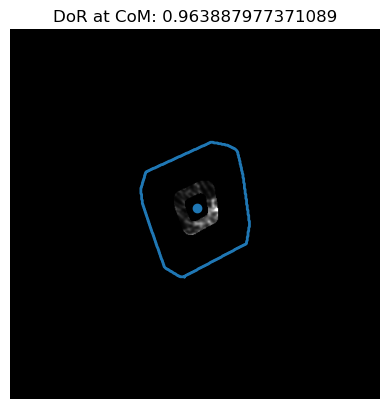

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


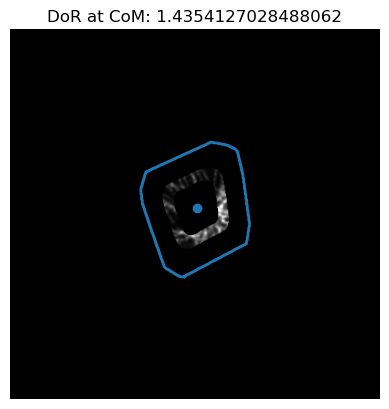

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


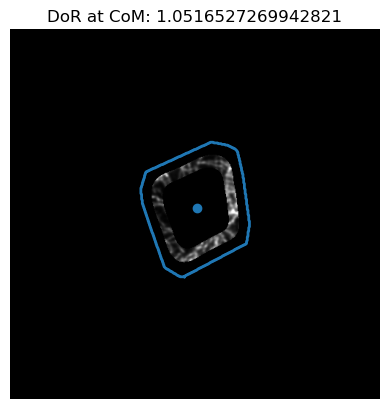

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


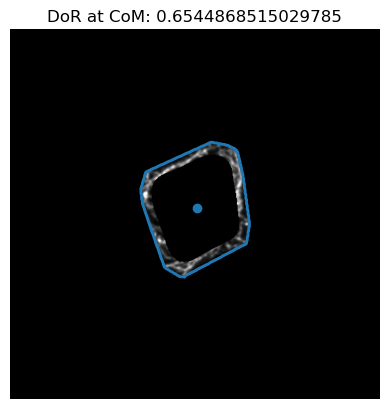

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


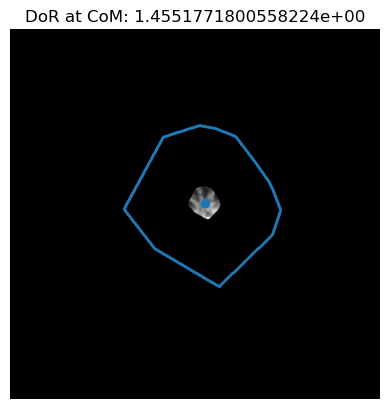

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


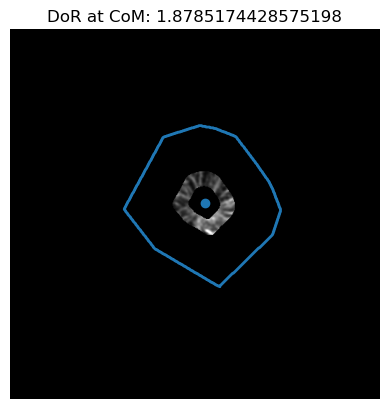

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


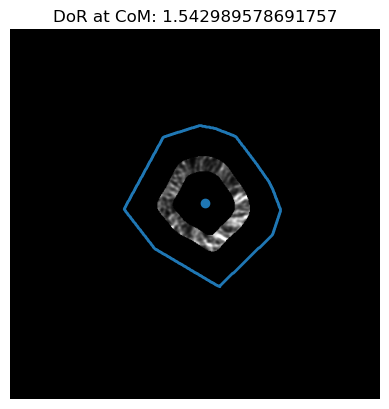

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


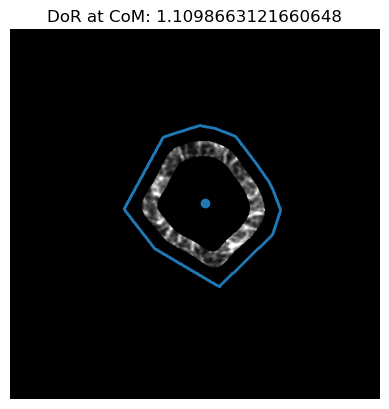

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


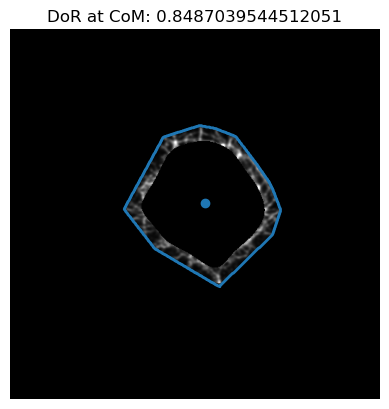

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


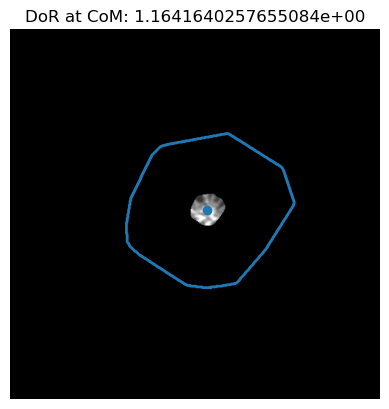

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


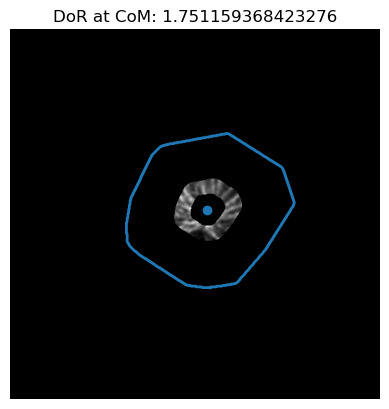

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


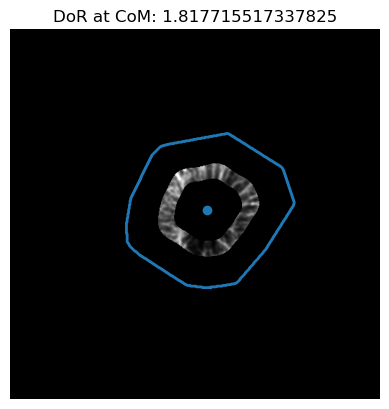

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


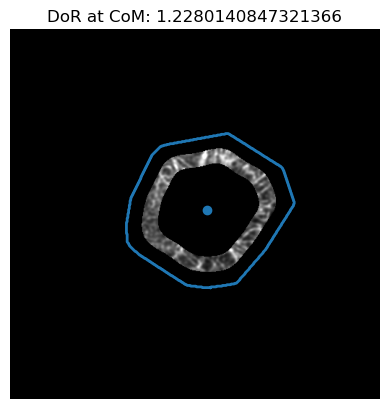

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


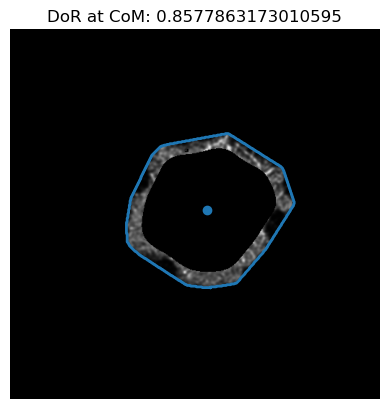

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


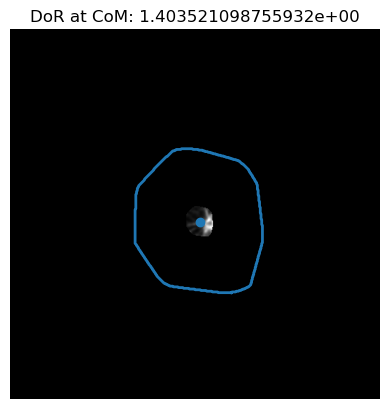

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


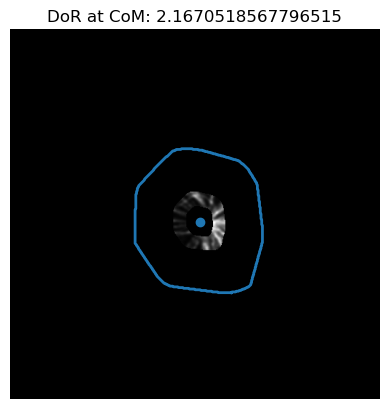

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


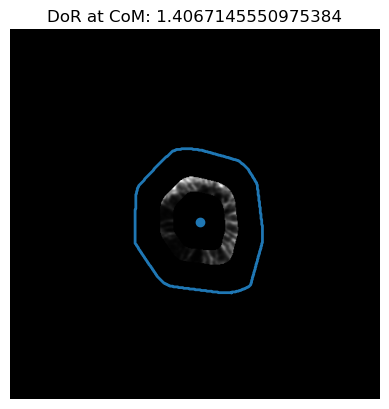

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


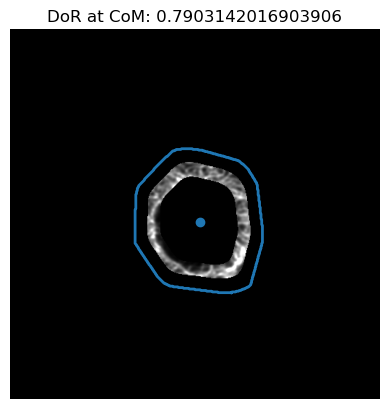

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


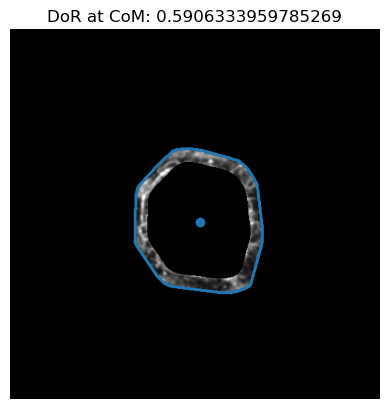

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


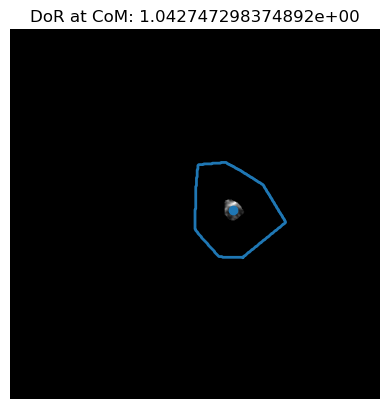

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


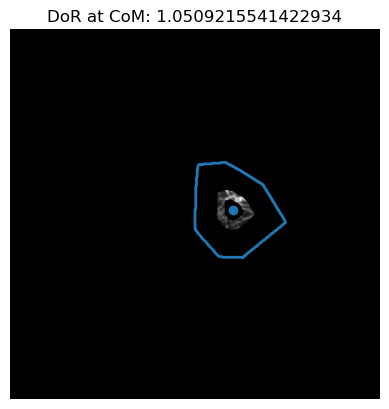

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


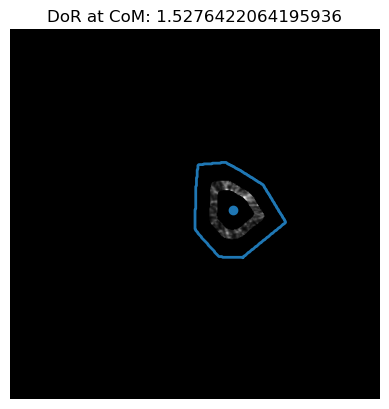

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


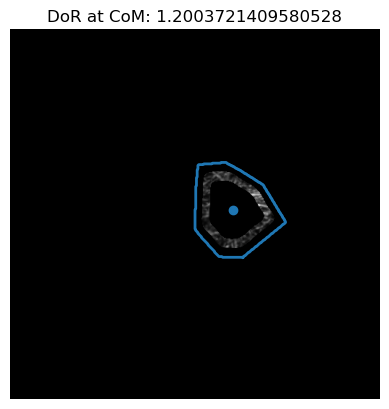

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


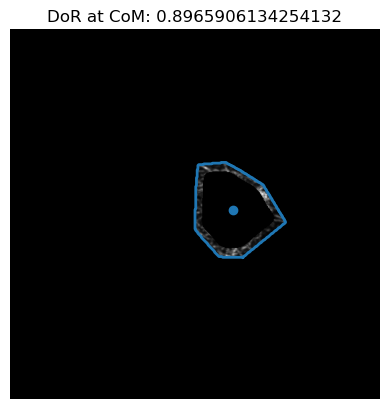

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


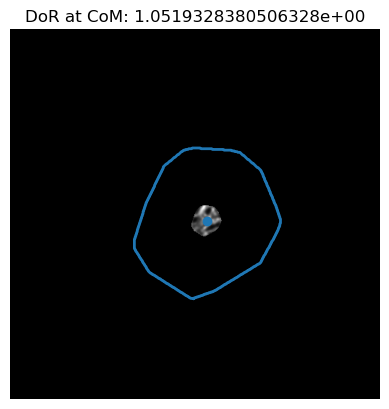

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


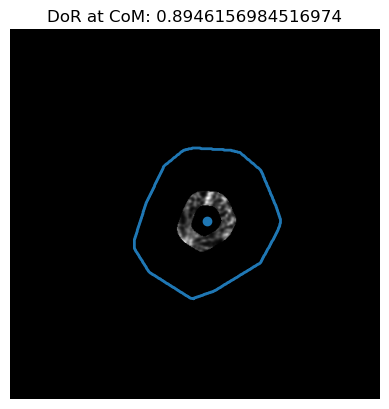

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


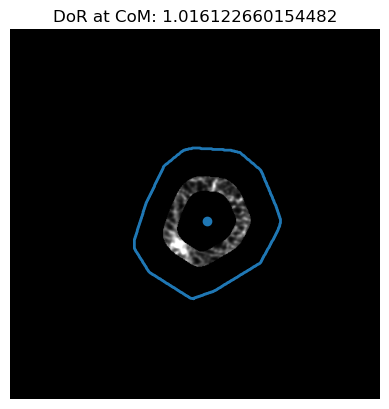

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


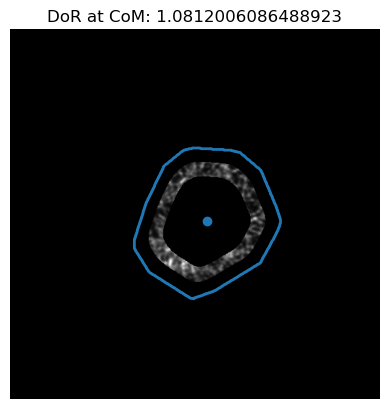

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


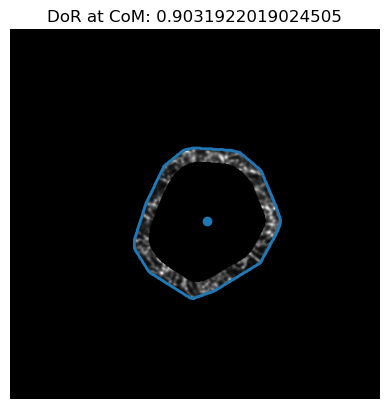

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


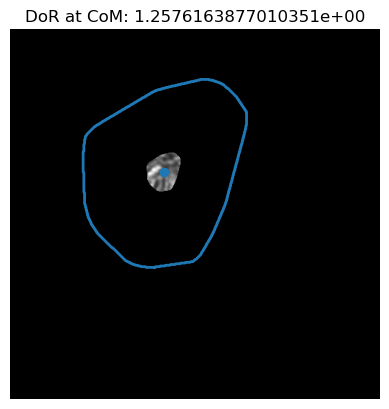

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


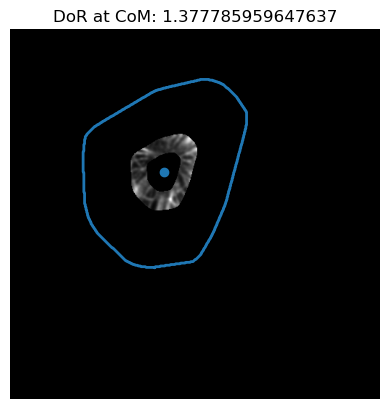

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


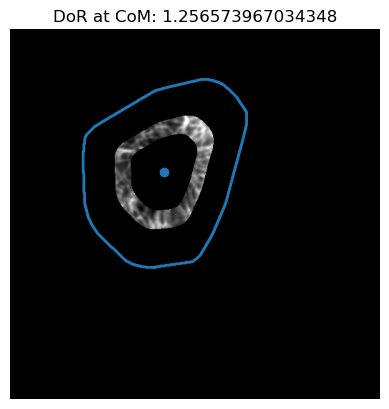

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


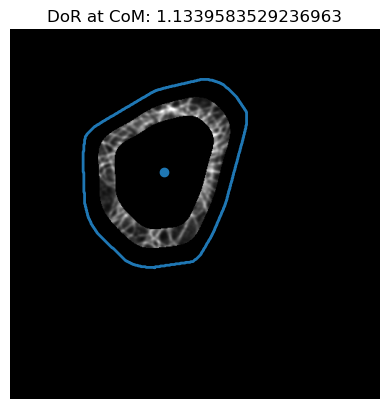

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


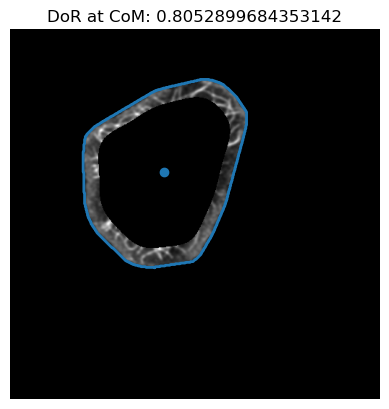

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


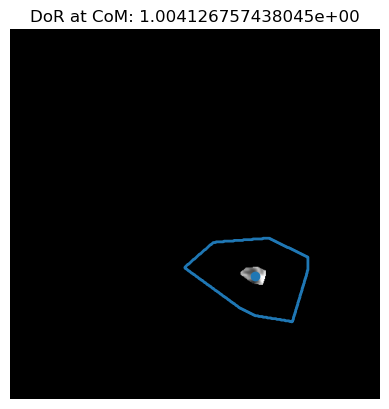

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


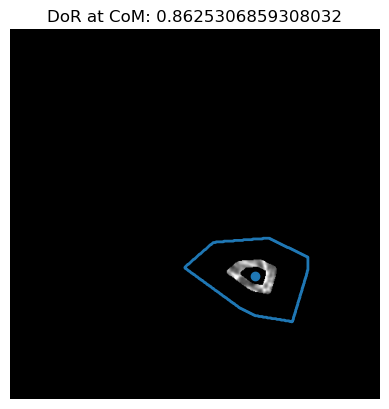

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


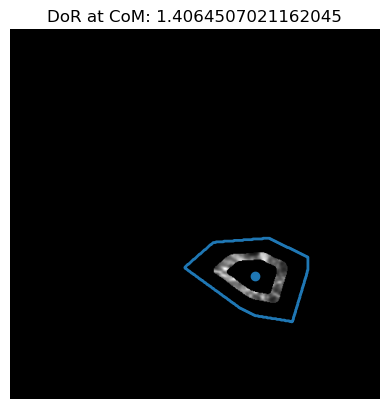

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


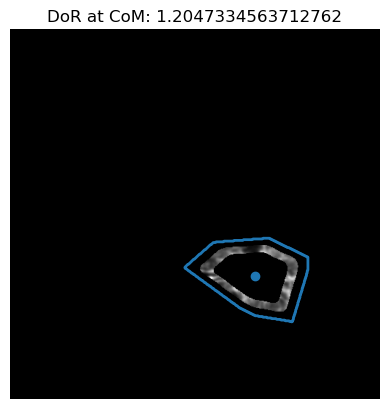

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


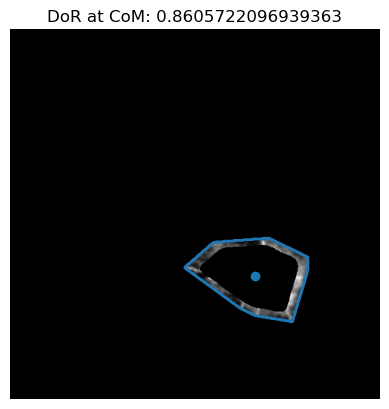

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


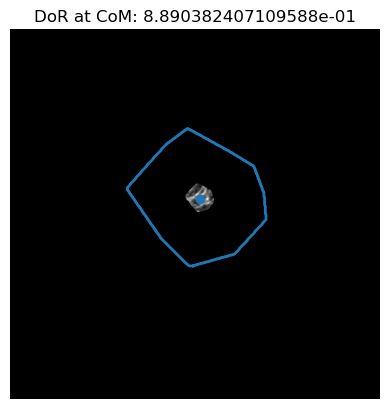

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


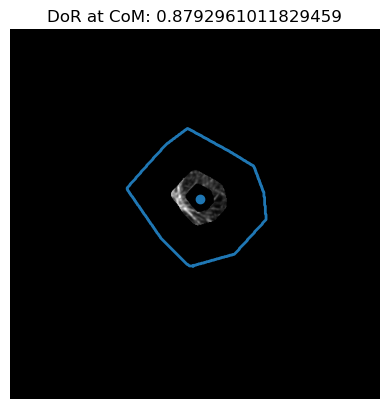

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


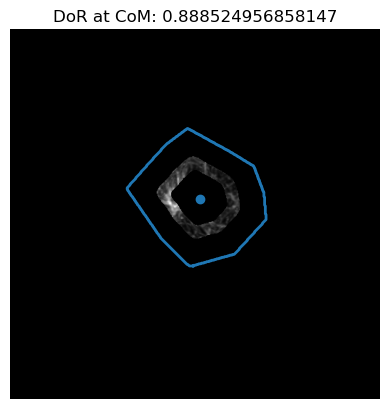

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


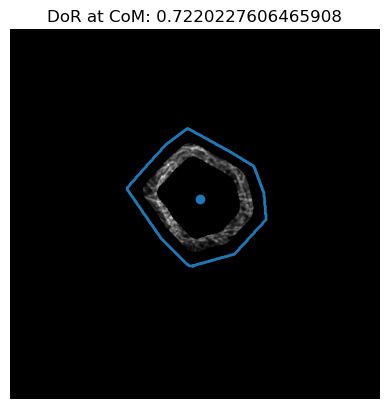

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


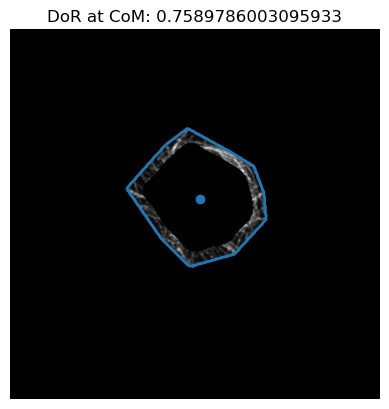

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


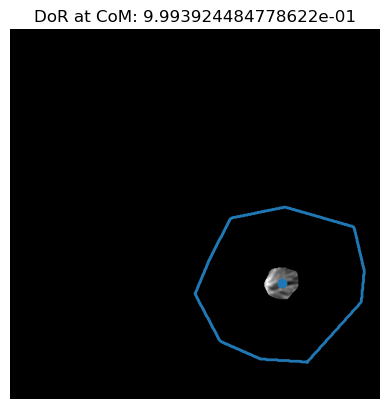

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


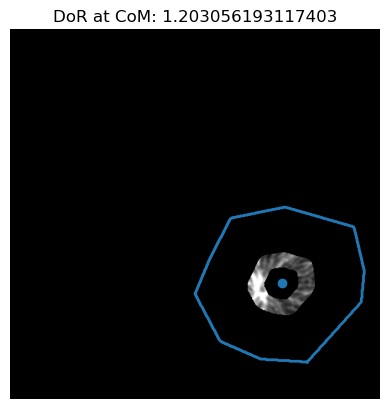

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


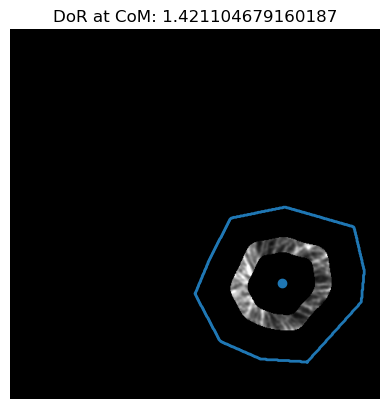

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


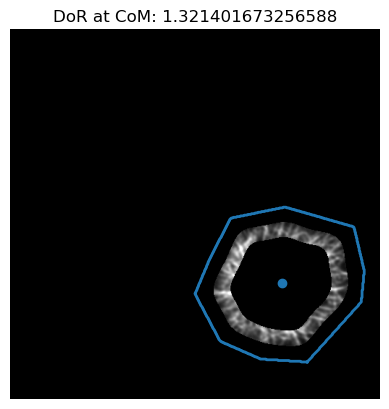

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


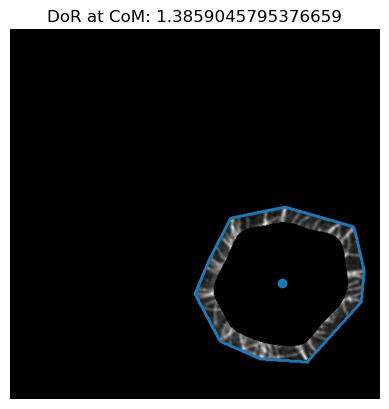

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


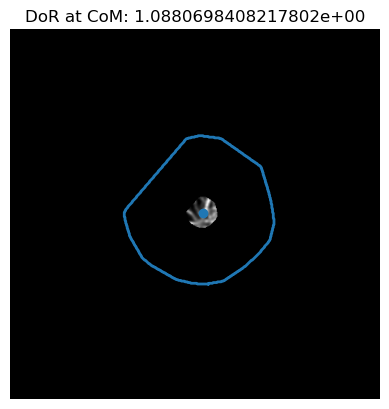

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


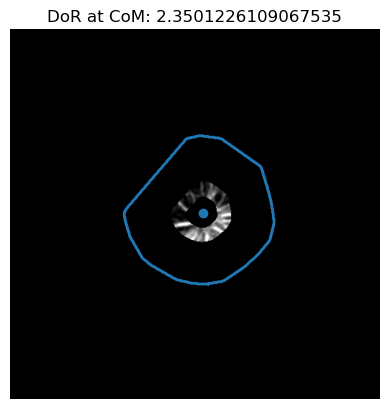

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


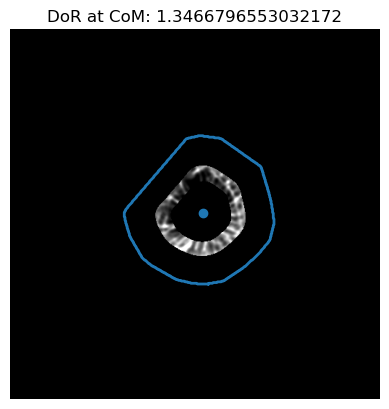

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


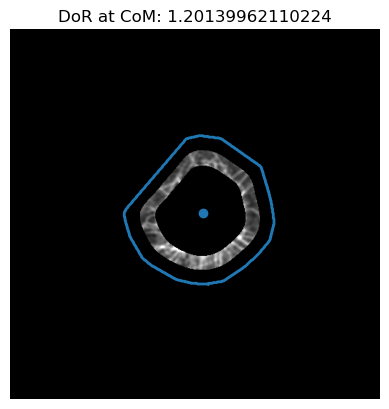

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


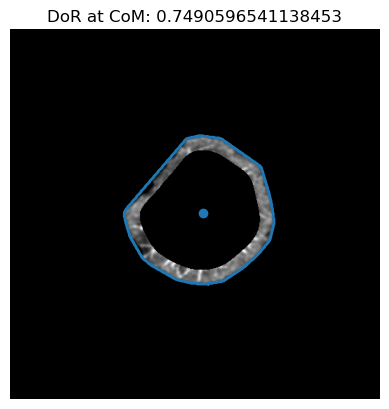

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


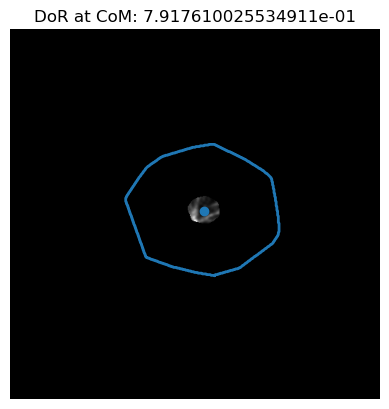

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


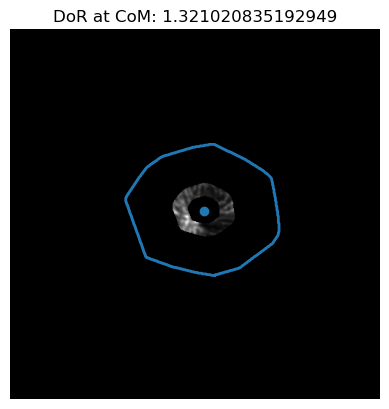

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


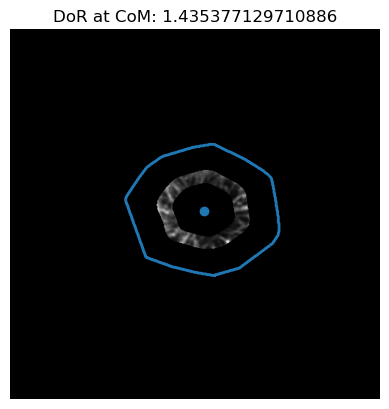

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


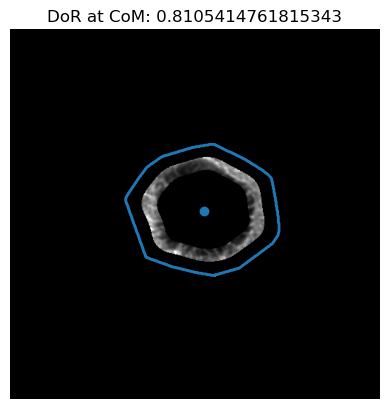

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


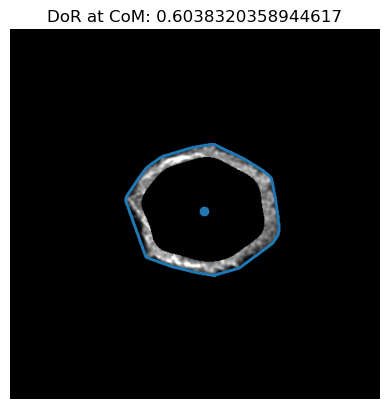

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


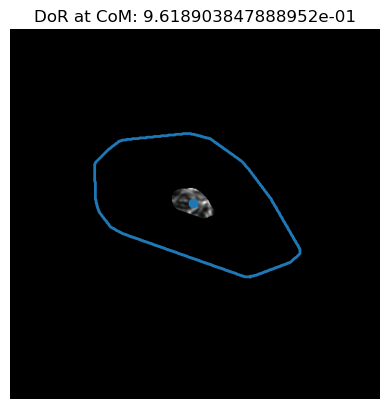

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


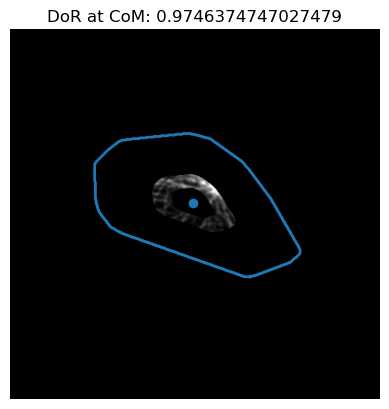

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


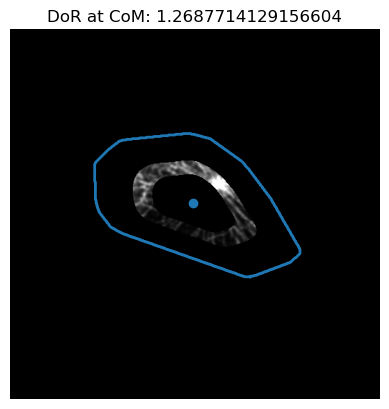

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


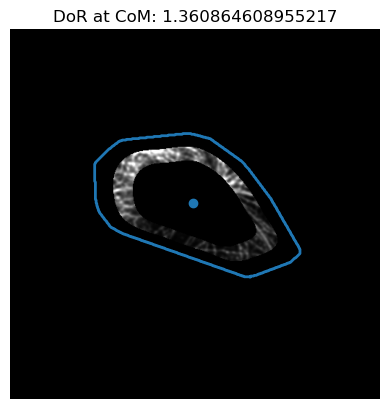

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


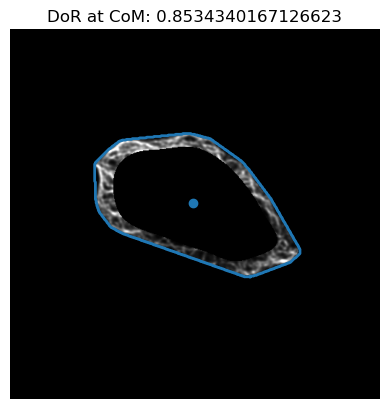

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


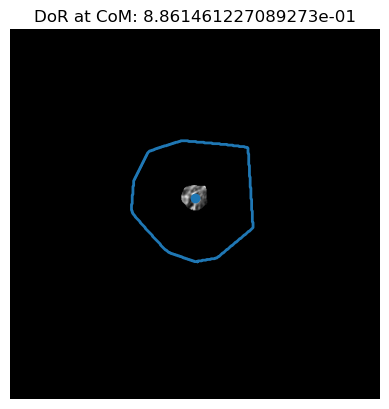

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


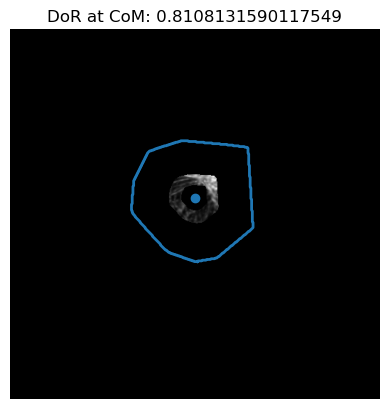

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


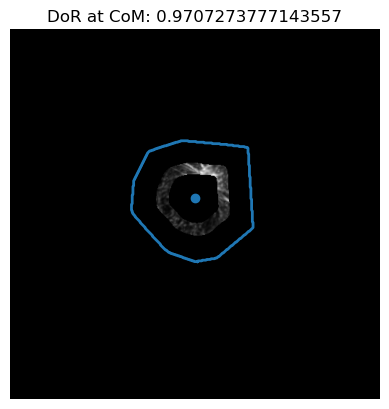

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


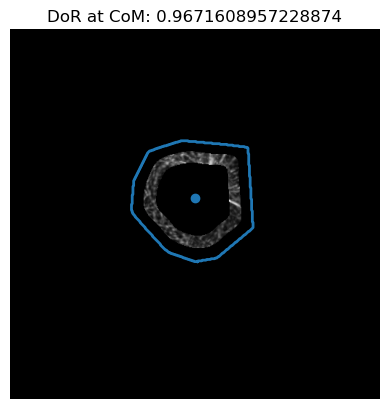

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


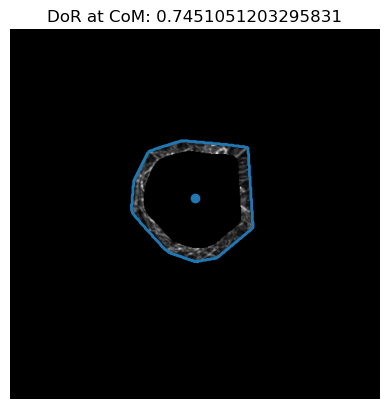

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


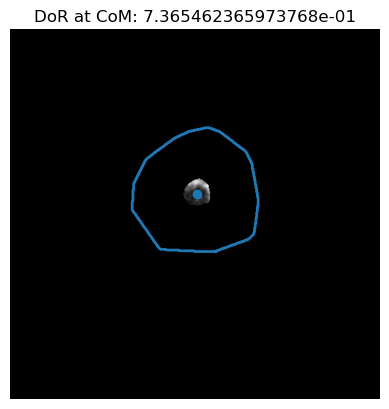

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


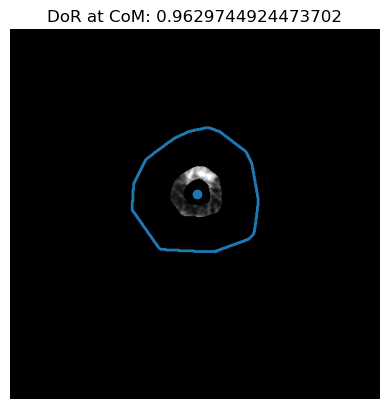

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


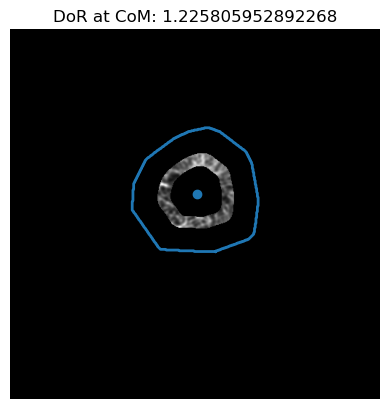

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


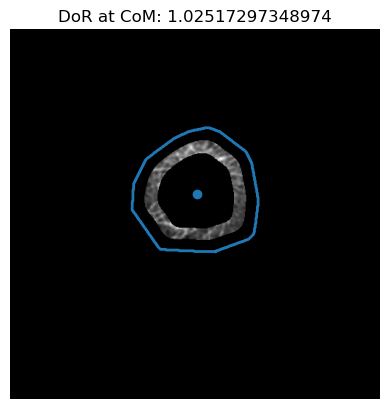

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


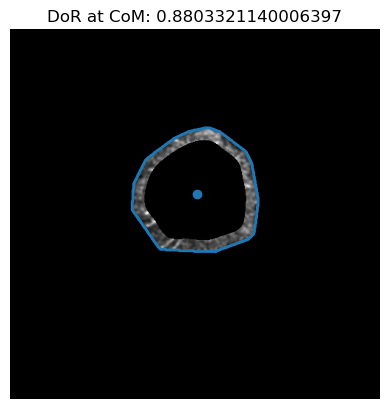

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


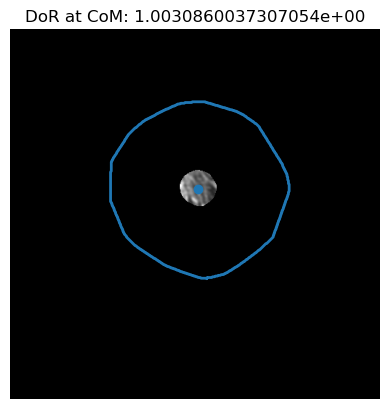

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


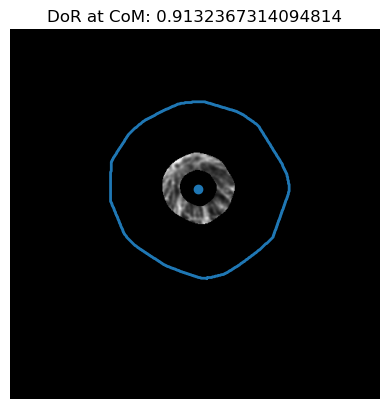

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


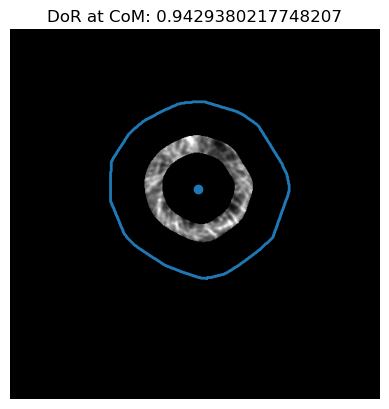

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


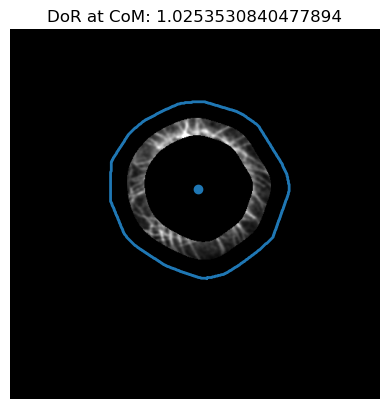

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


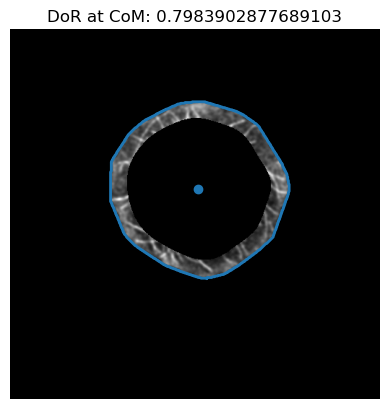

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


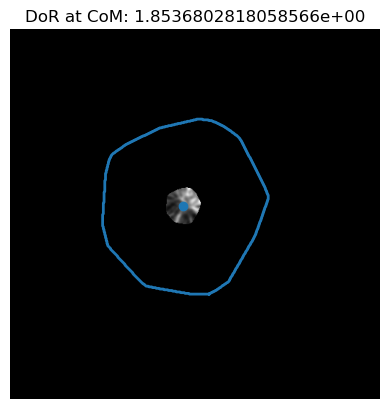

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


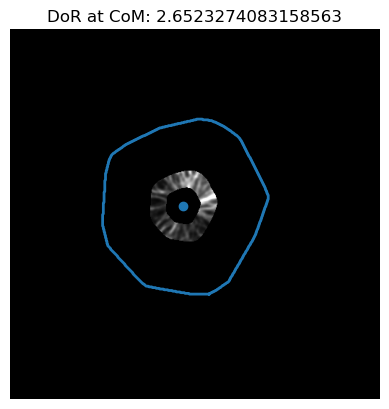

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


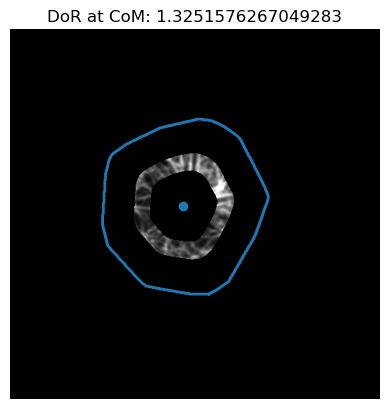

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


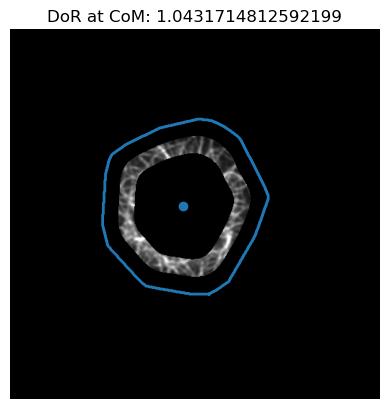

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


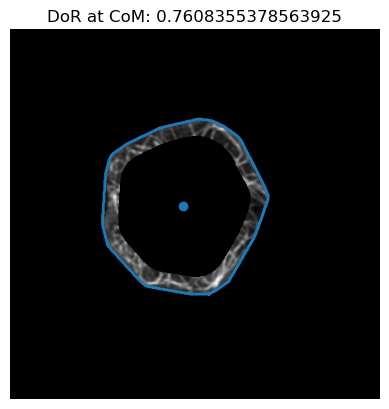

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


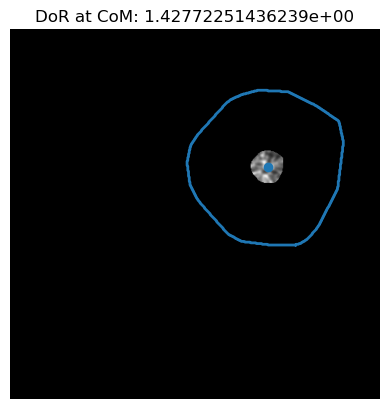

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


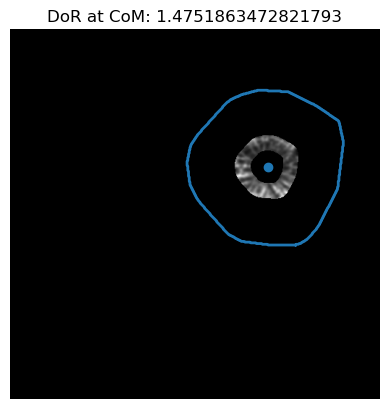

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


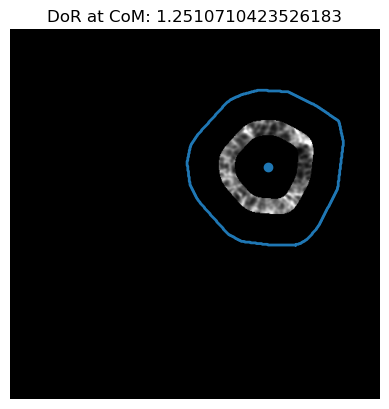

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


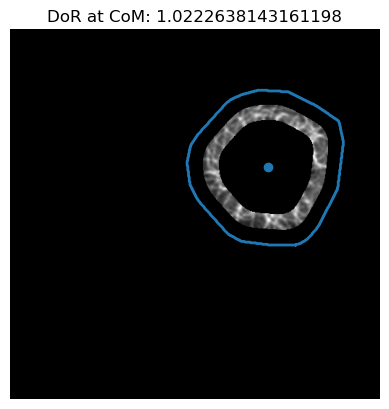

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


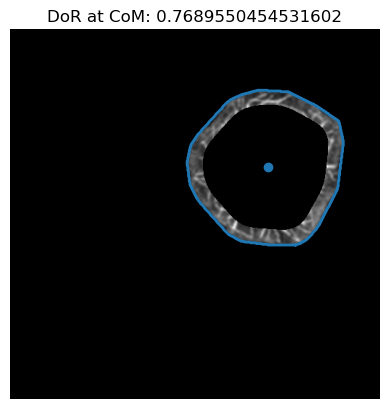

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


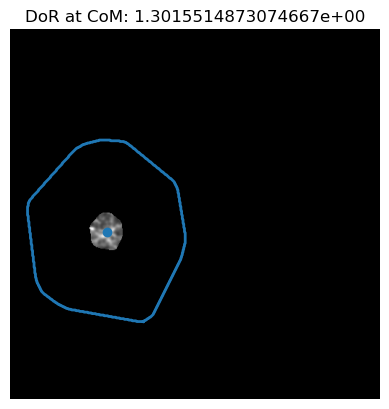

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


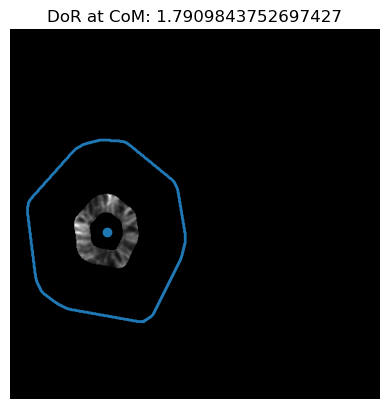

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


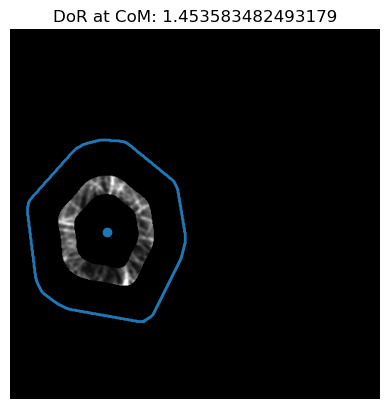

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


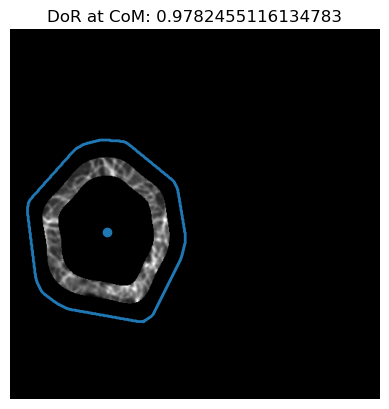

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


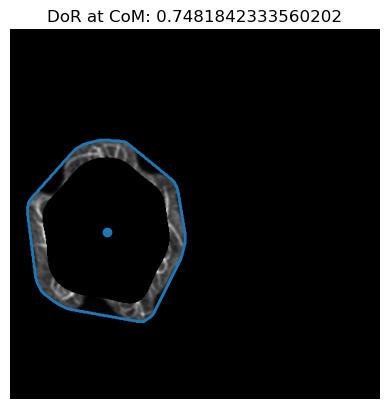

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


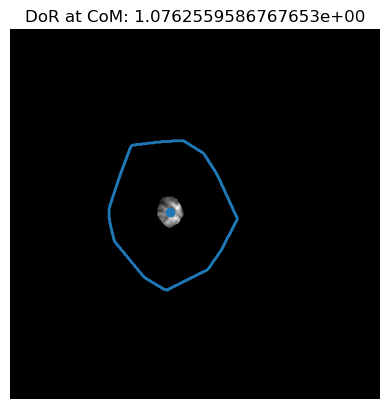

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


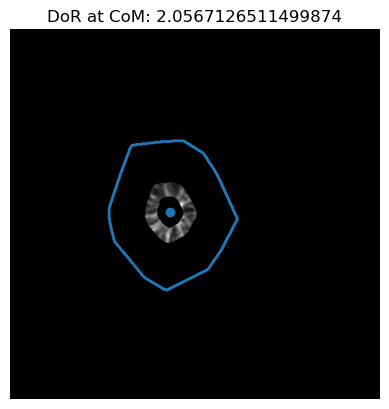

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


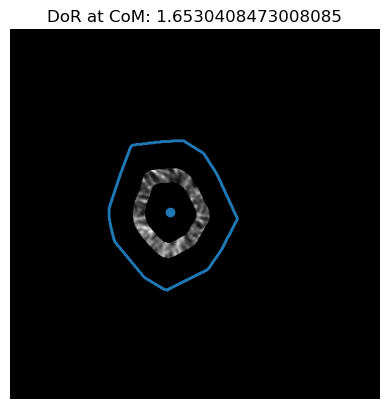

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


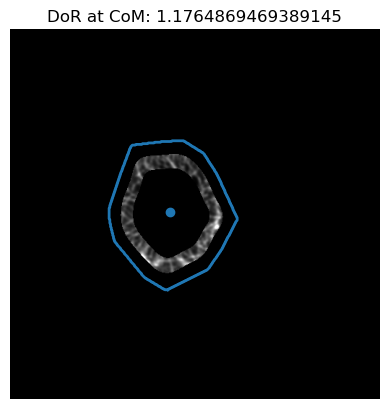

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


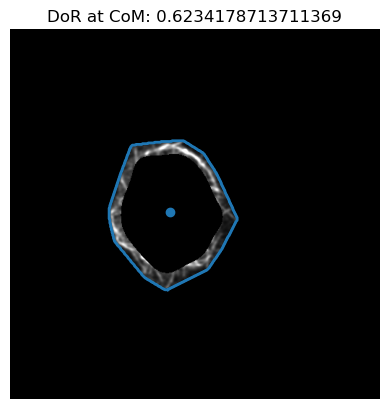

In [3]:
dot_prods_ctrl = find_radiality_centre('Data/MT_patient_slides/APC01_to_07/Ctrl/*[png, tif]')

  0%|          | 0/148 [00:00<?, ?it/s]

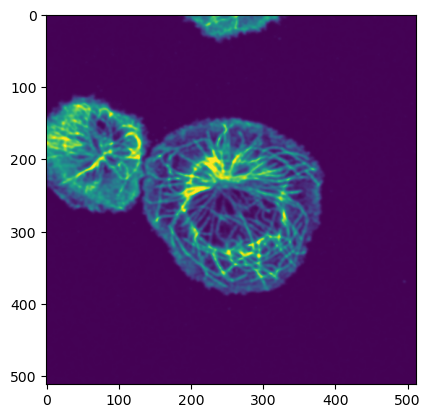

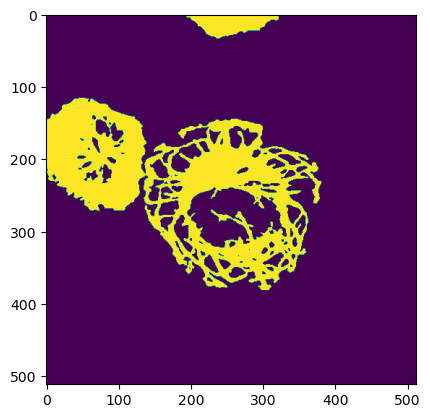

  0%|          | 0/160 [00:00<?, ?it/s]

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


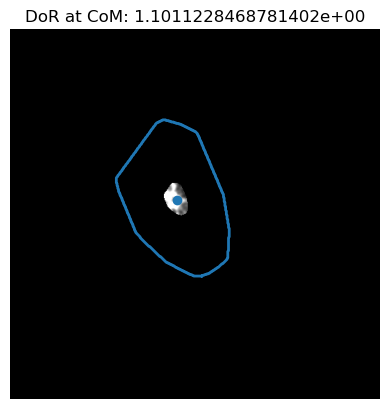

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


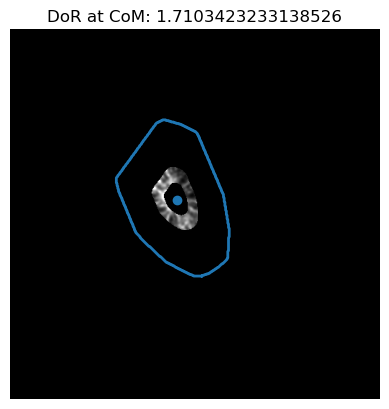

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


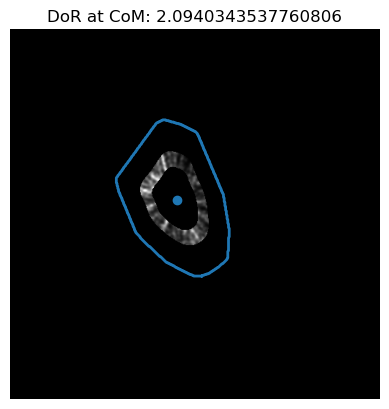

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


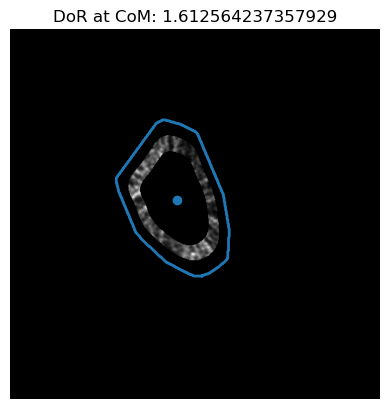

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


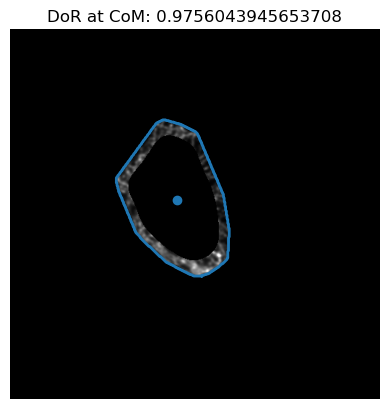

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


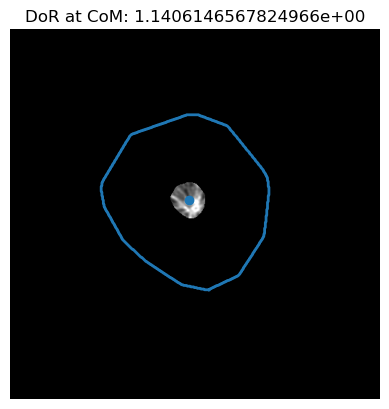

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


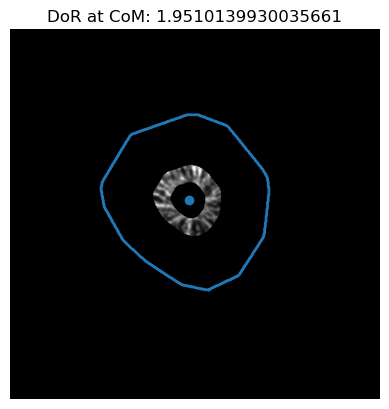

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


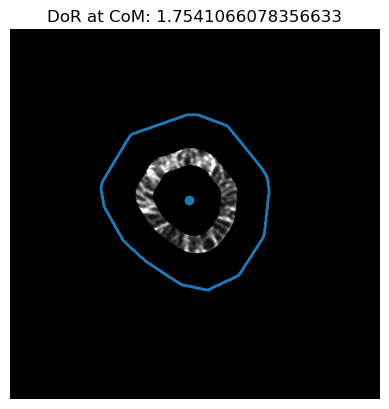

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


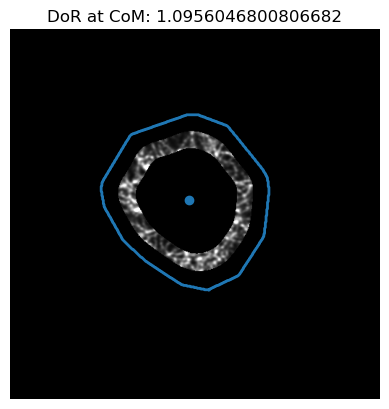

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


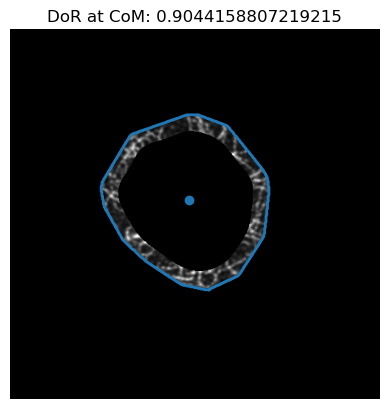

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


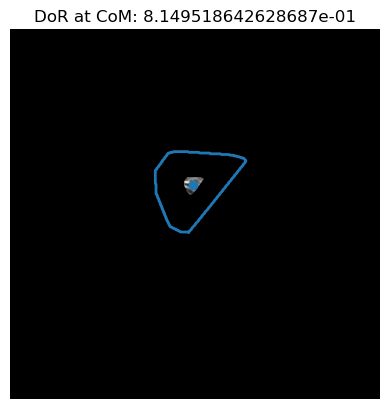

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


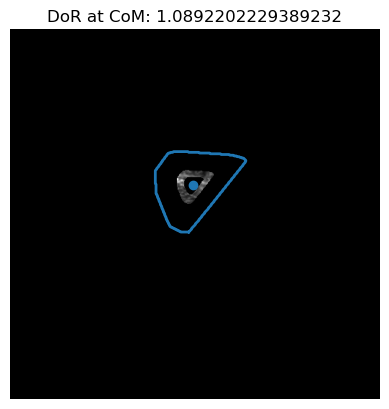

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


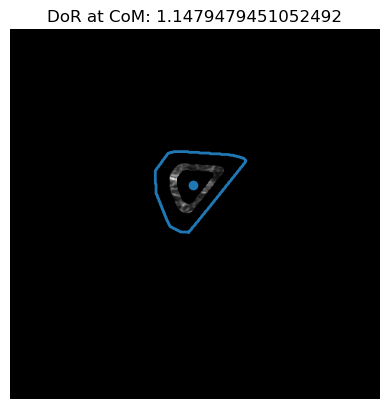

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


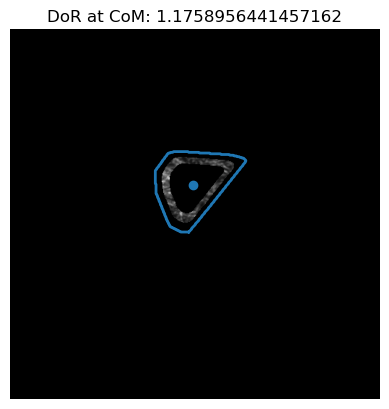

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


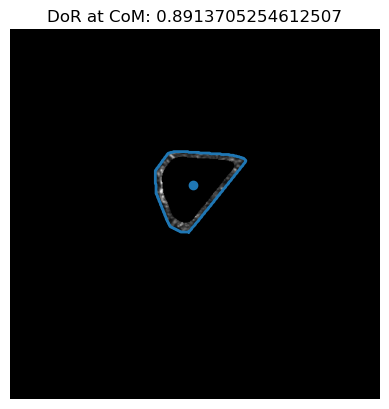

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


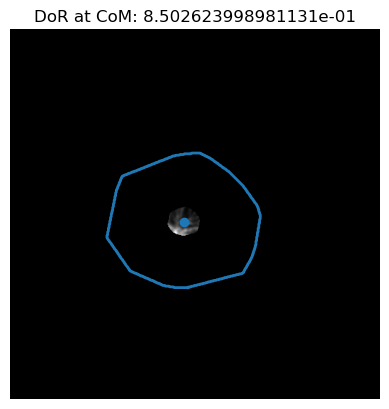

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


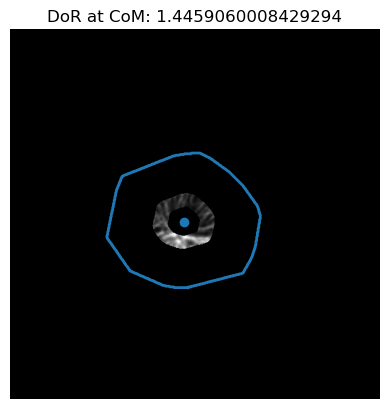

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


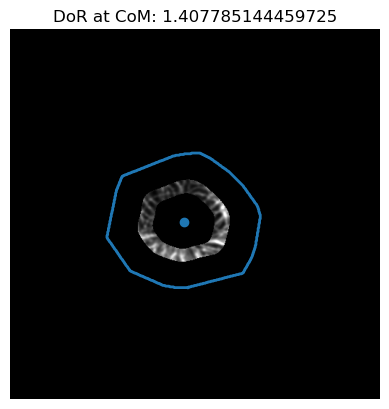

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


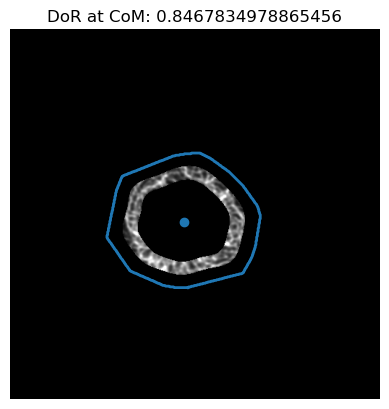

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


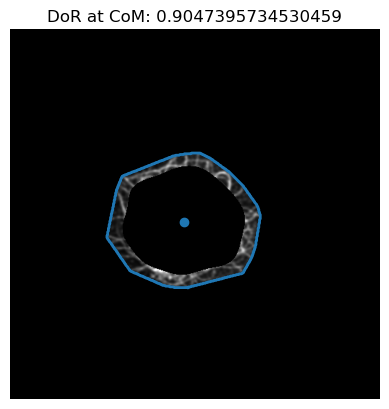

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


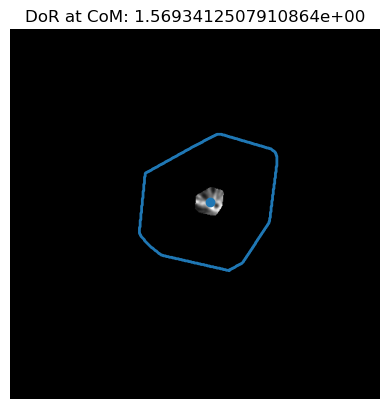

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


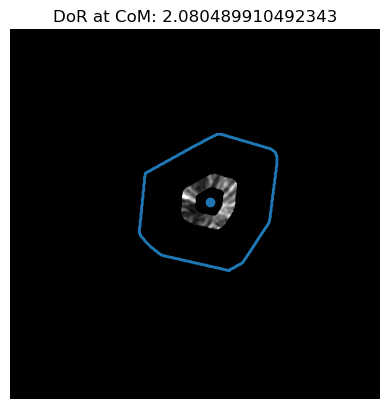

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


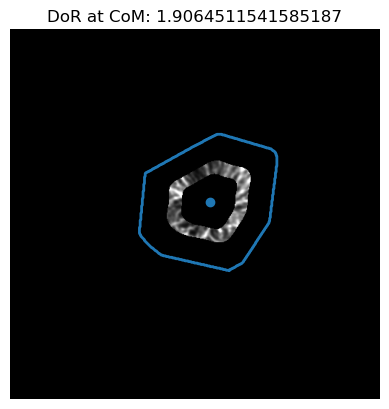

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


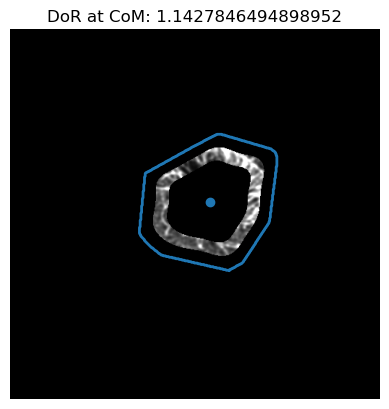

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


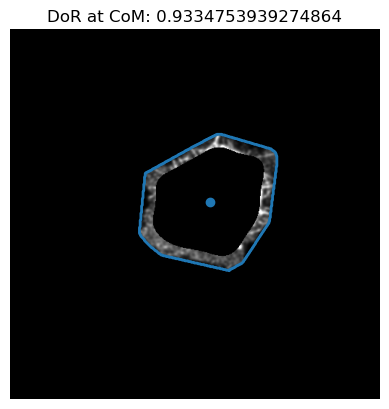

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


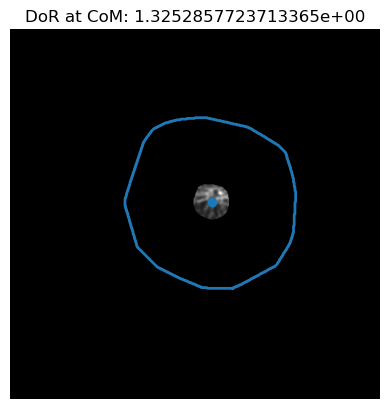

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


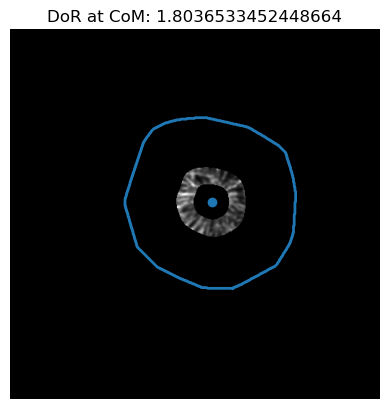

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


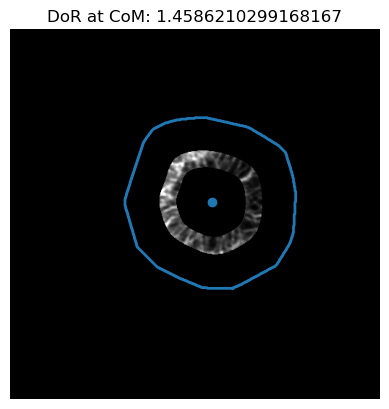

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


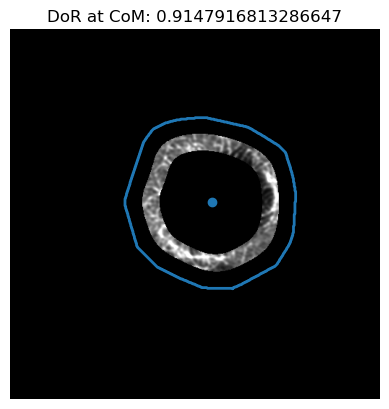

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


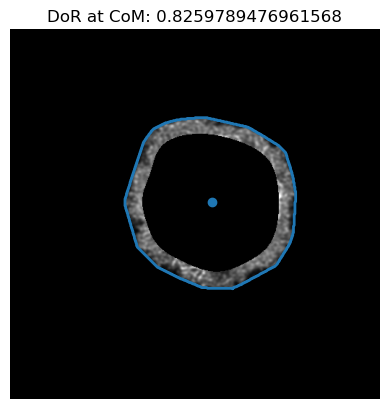

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


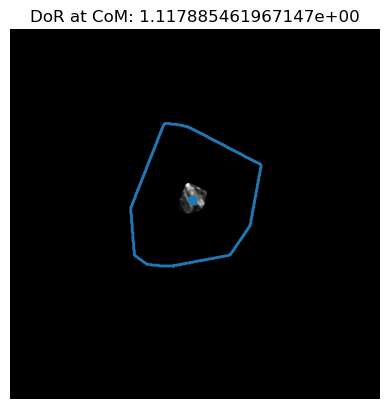

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


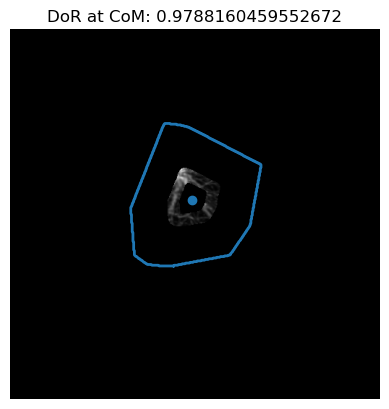

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


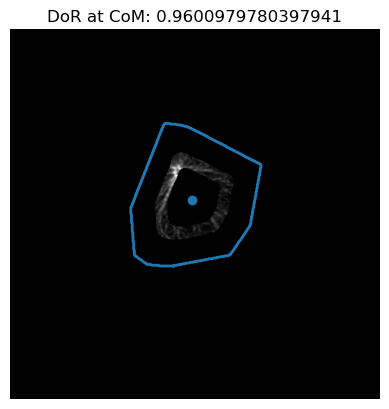

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


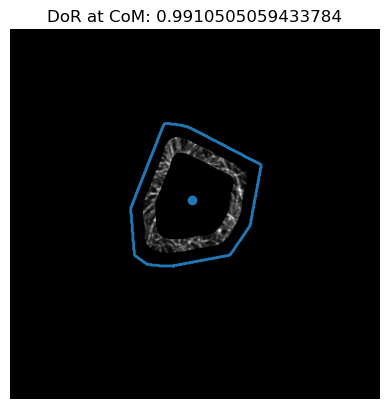

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


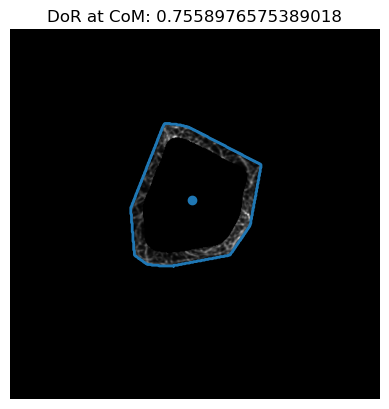

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


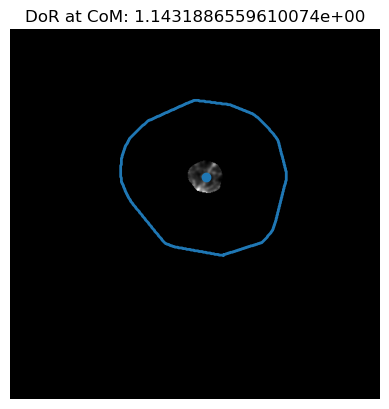

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


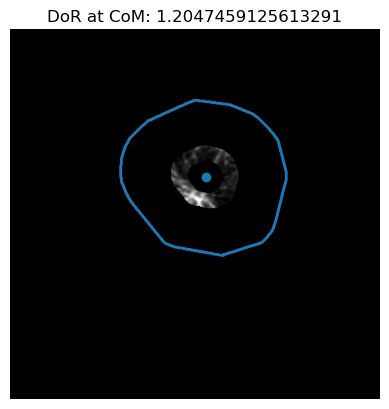

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


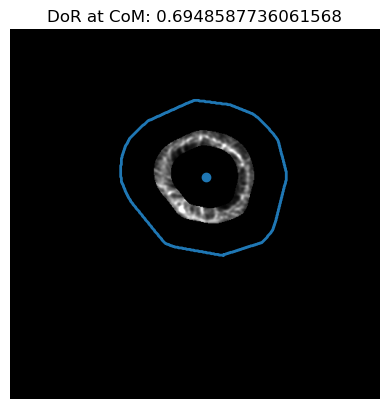

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


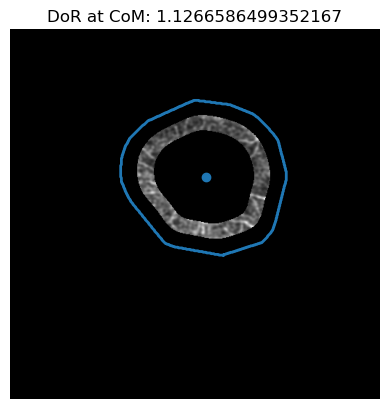

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


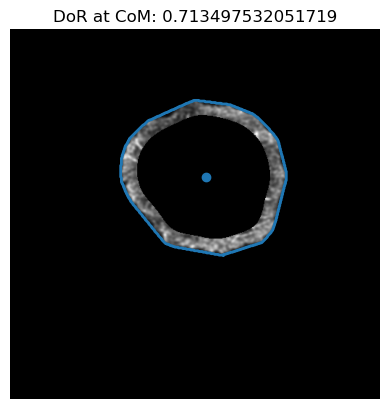

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


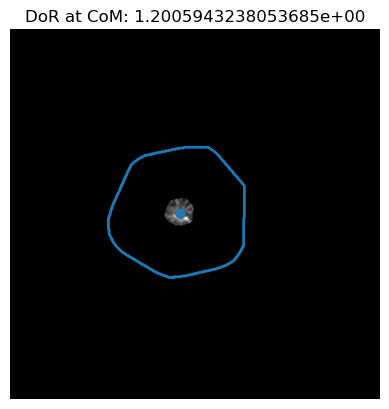

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


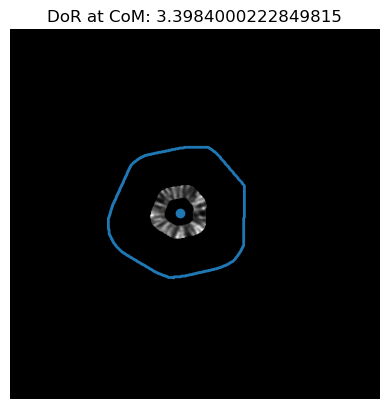

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


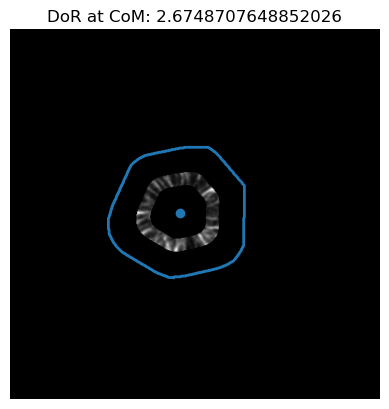

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


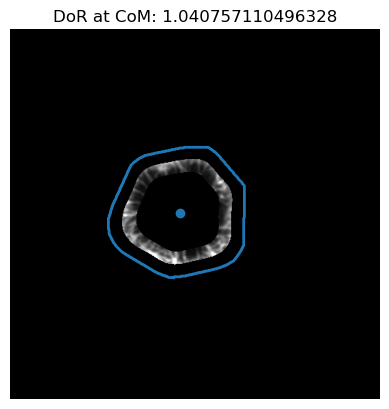

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


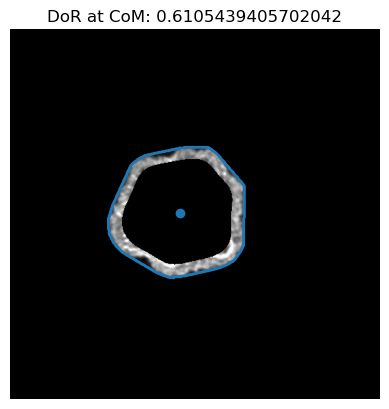

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


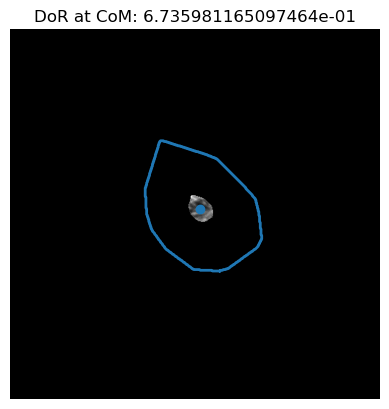

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


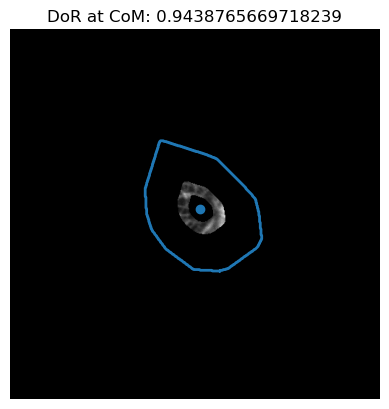

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


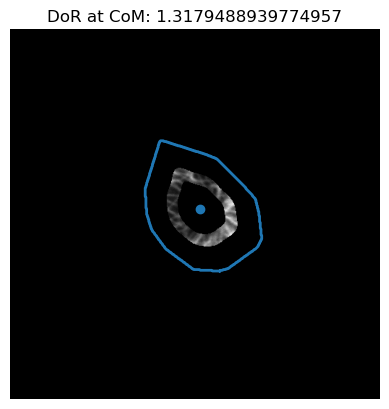

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


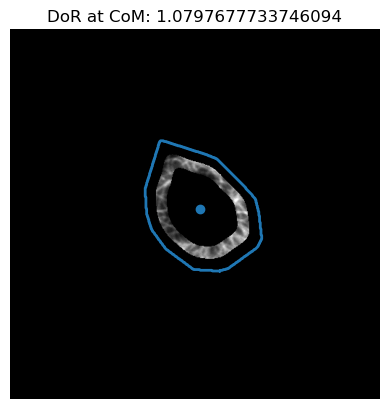

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


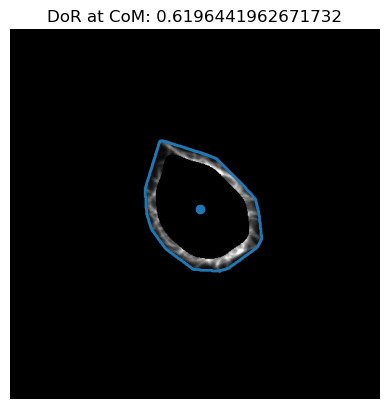

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


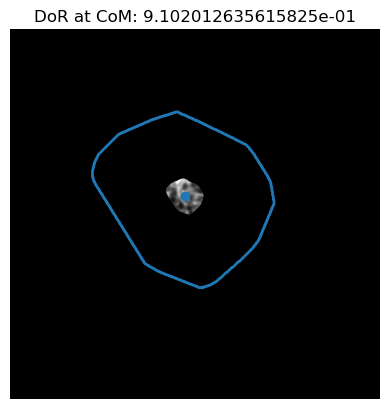

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


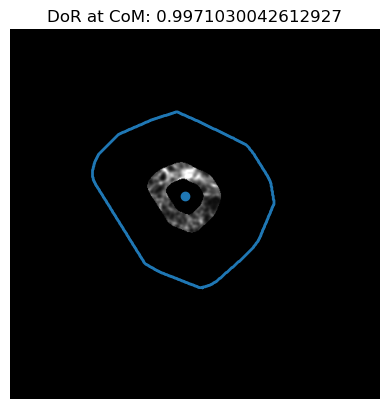

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


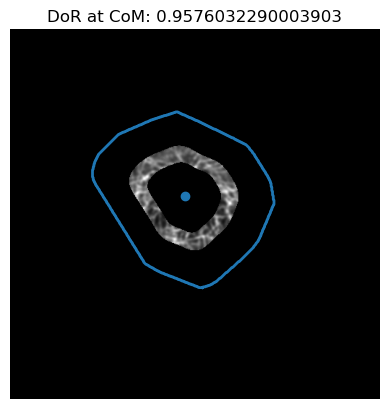

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


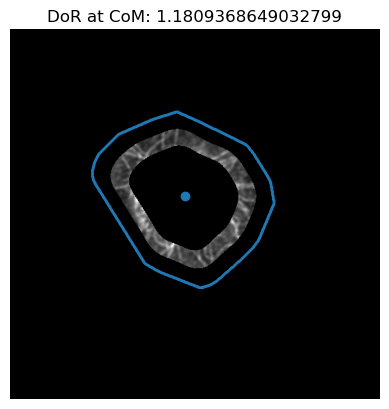

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


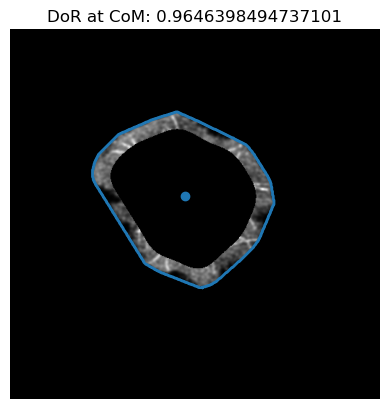

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


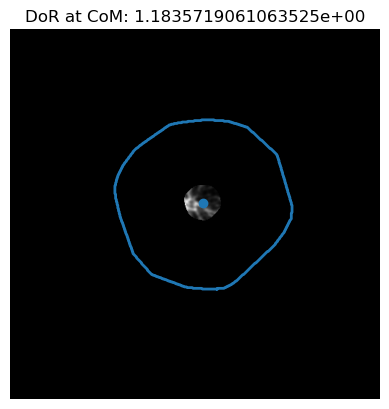

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


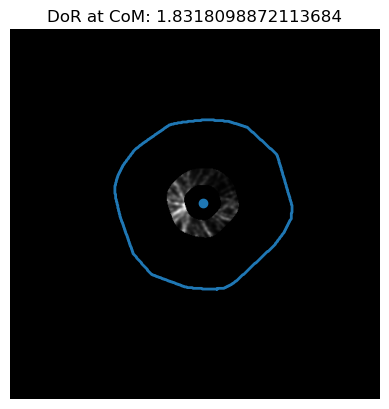

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


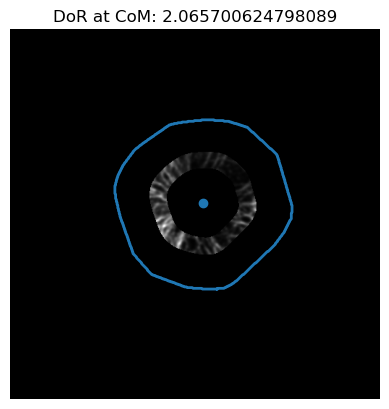

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


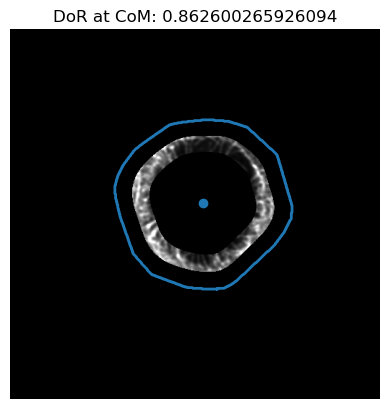

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


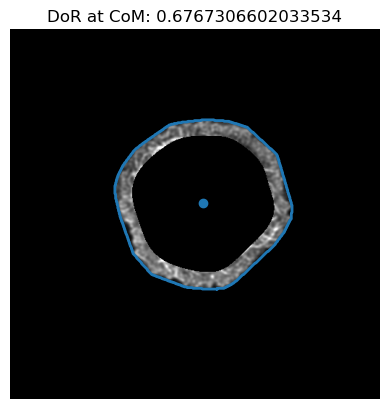

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


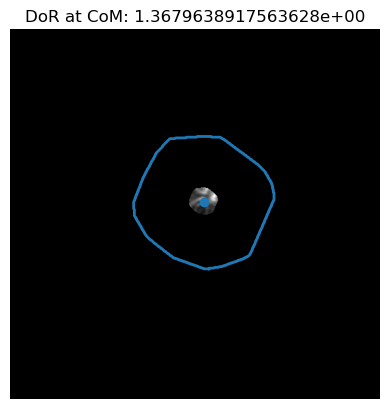

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


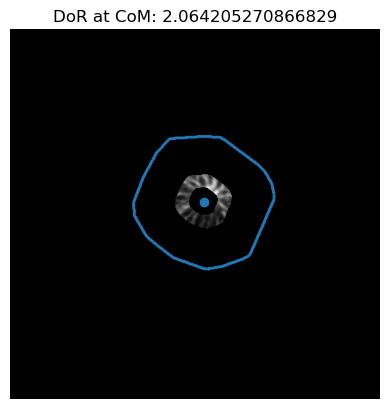

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


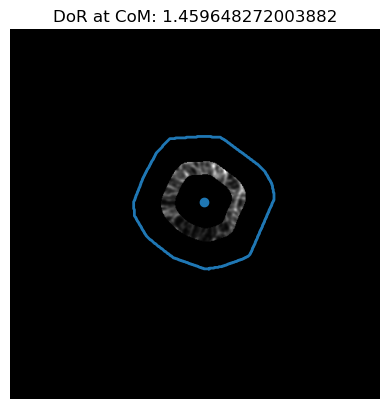

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


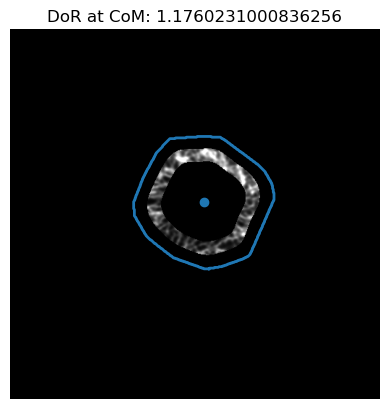

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


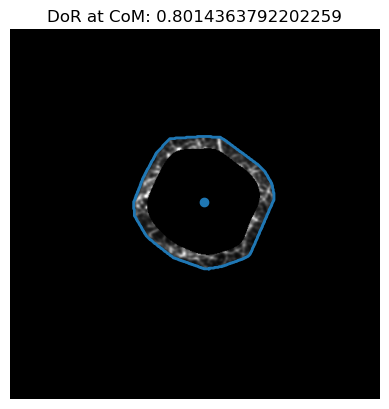

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


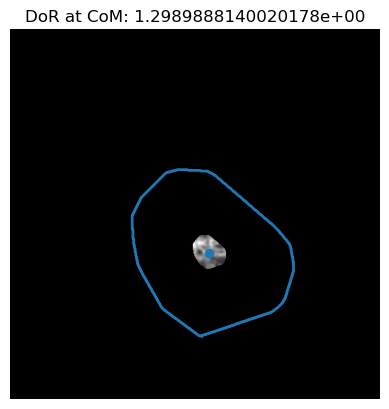

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


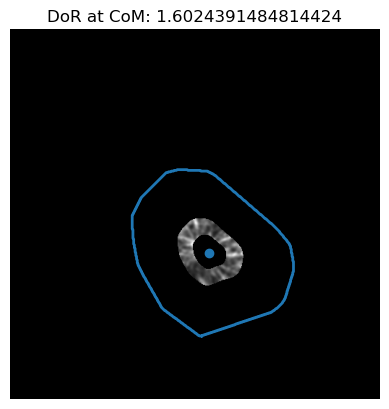

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


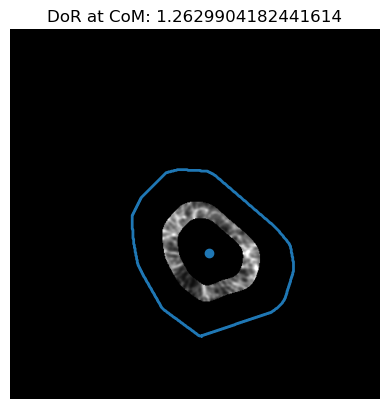

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


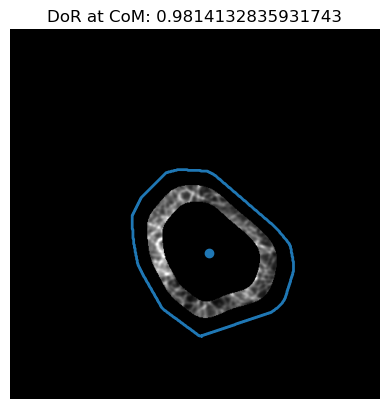

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


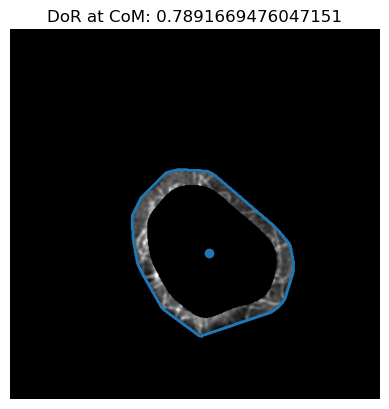

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


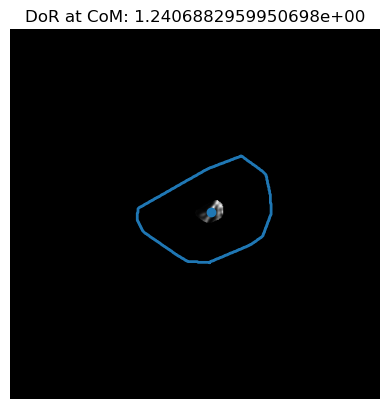

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


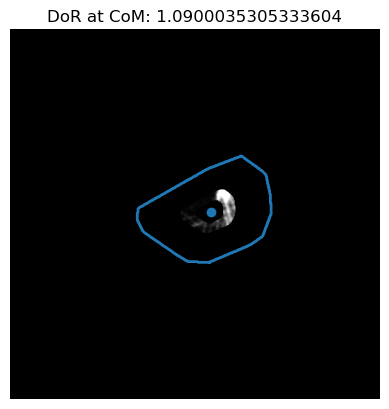

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


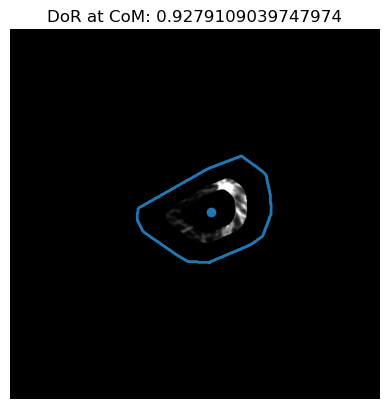

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


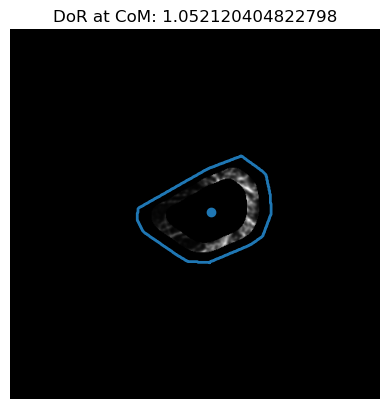

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


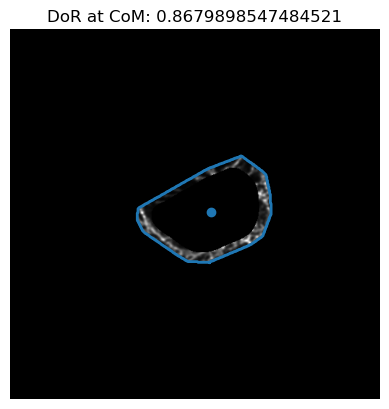

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


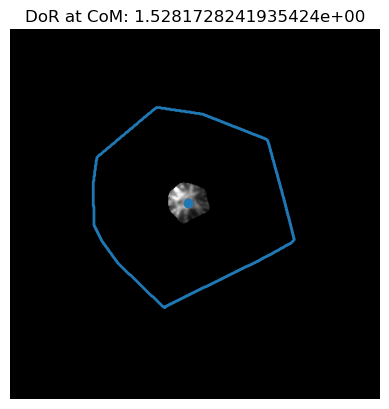

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


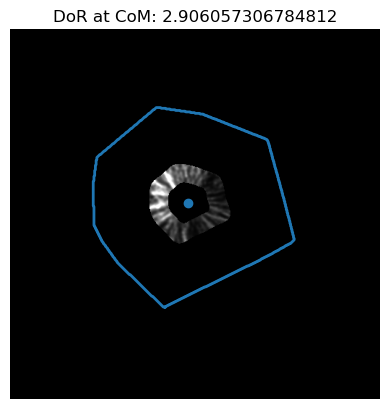

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


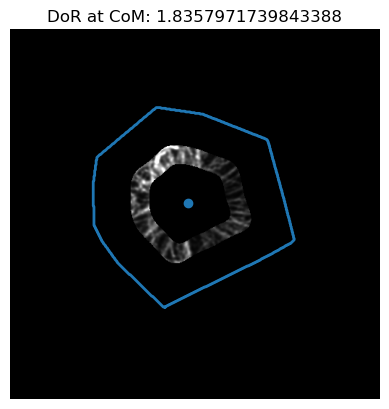

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


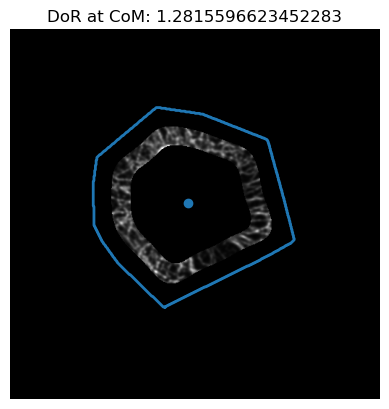

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


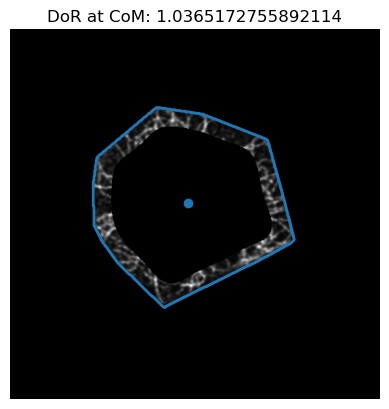

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


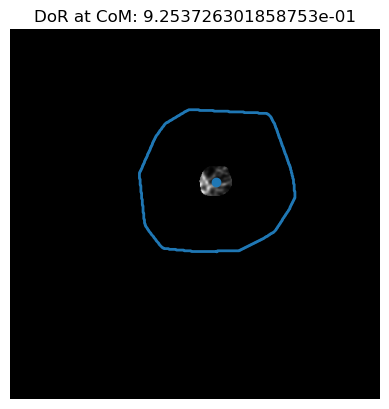

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


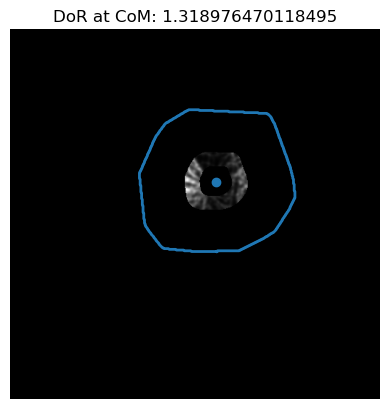

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


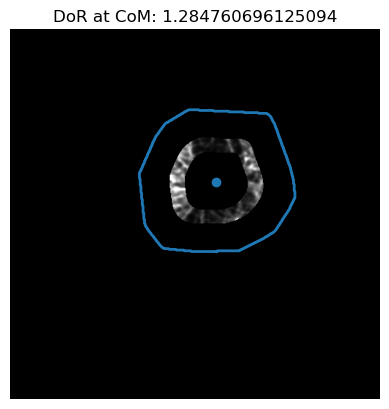

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


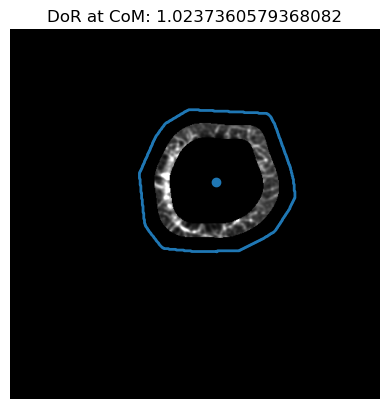

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


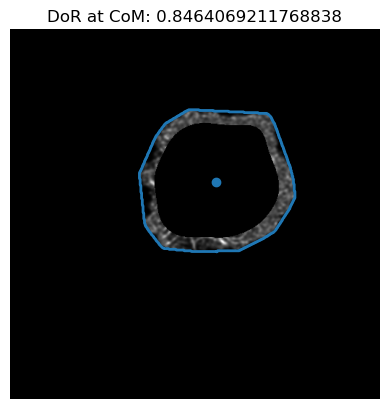

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


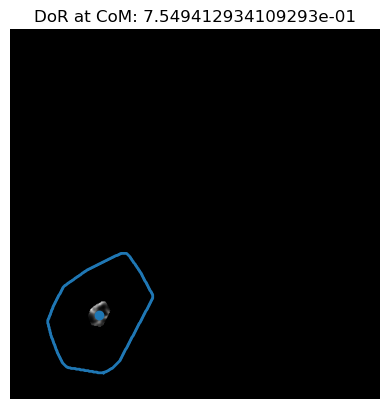

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


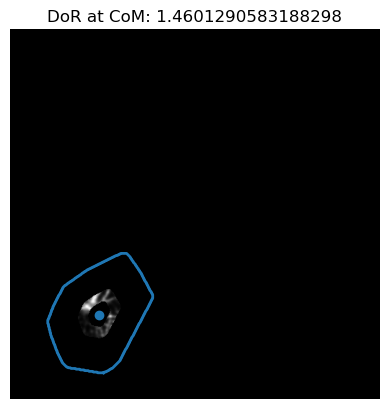

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


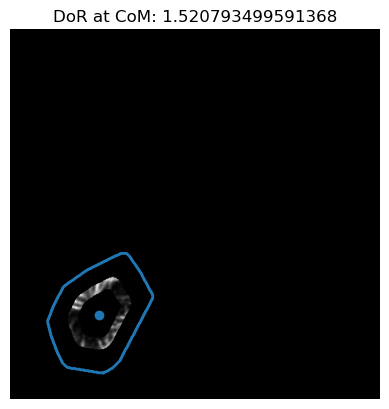

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


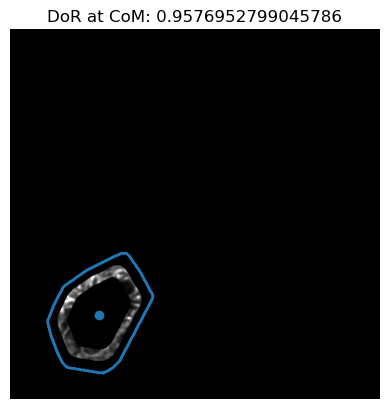

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


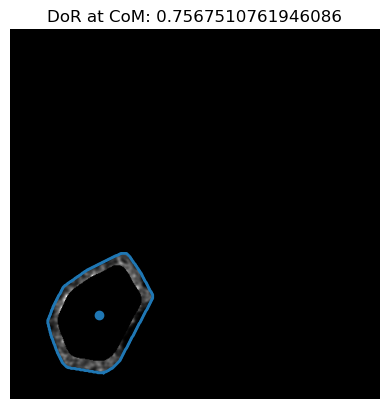

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


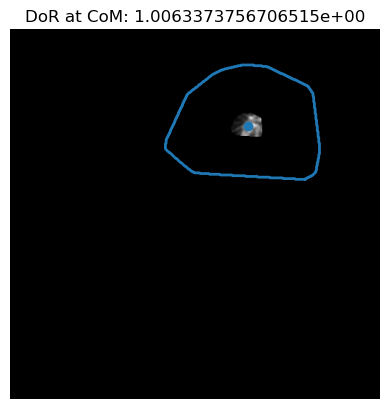

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


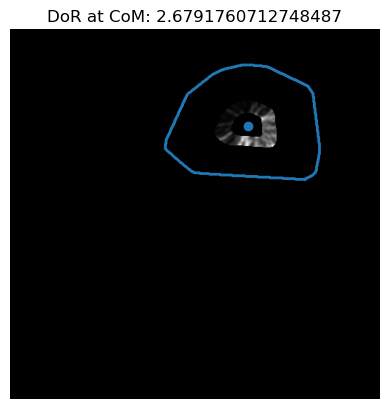

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


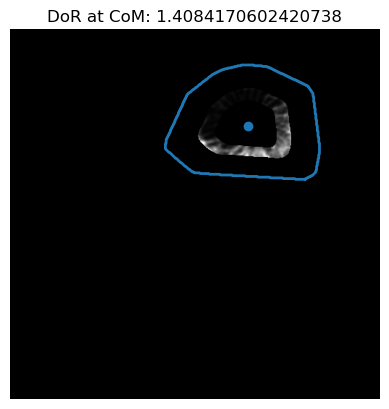

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


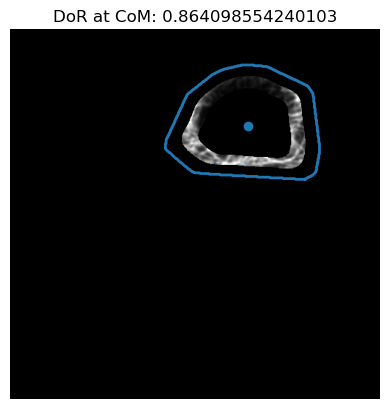

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


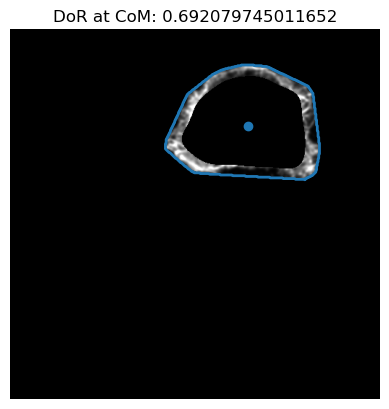

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


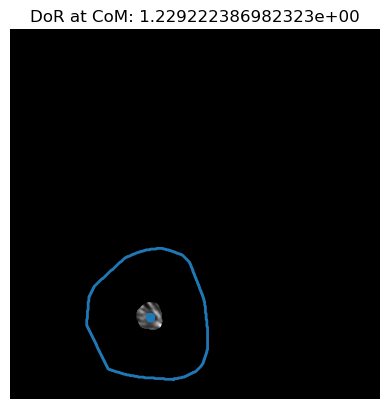

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


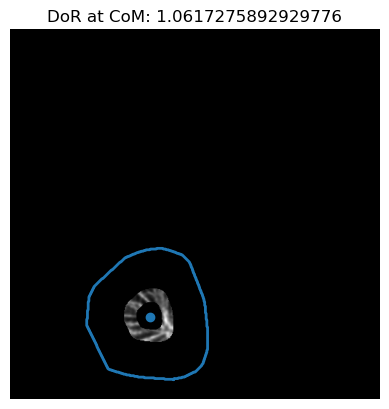

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


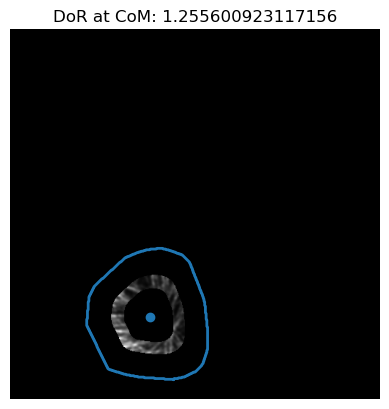

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


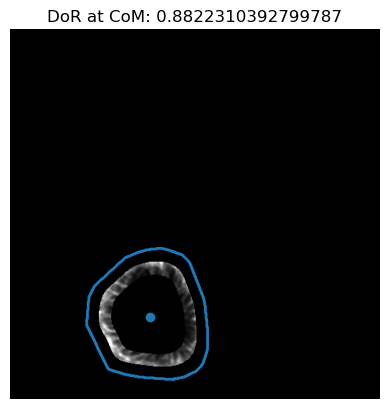

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


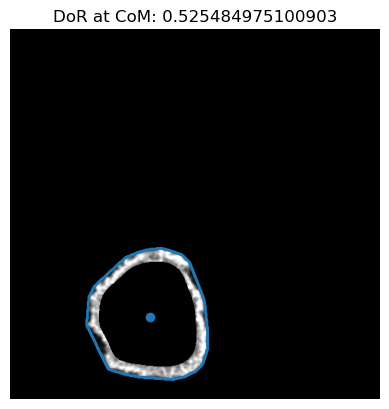

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


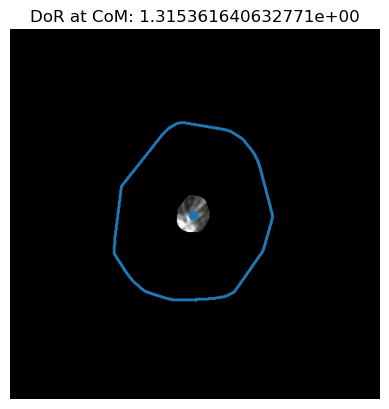

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


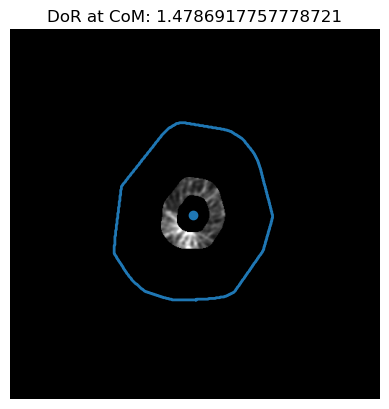

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


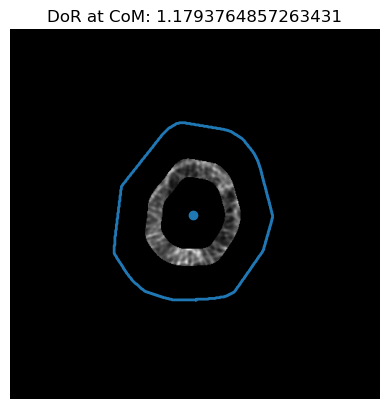

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


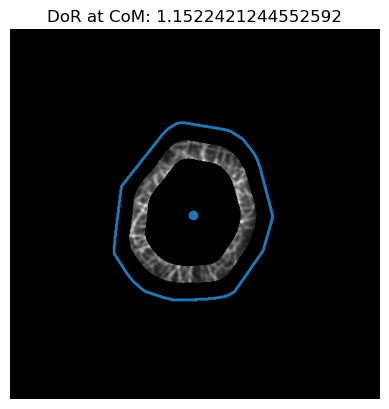

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


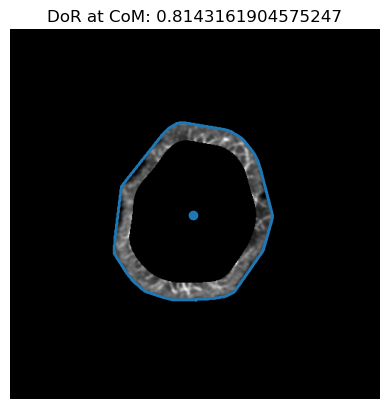

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


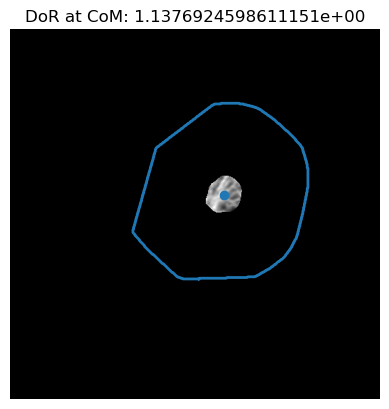

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


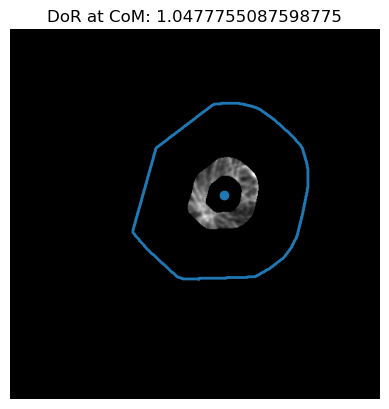

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


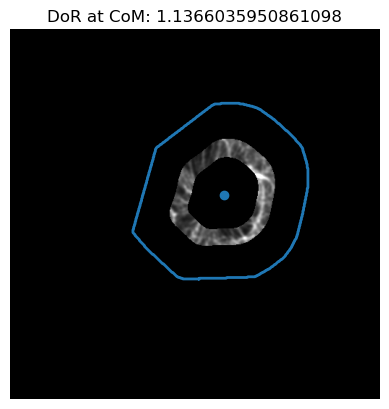

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


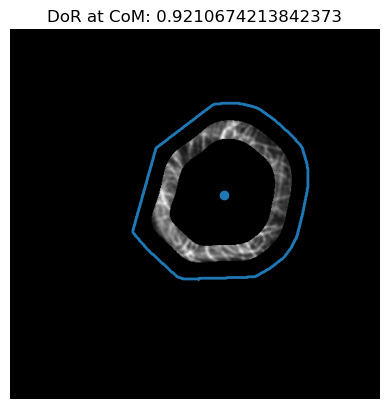

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


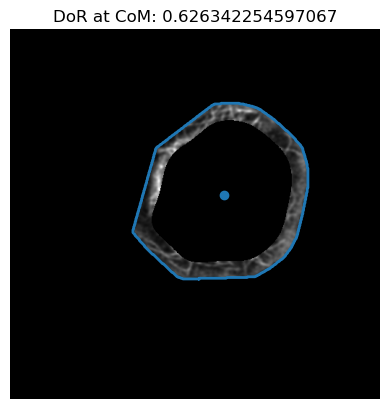

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


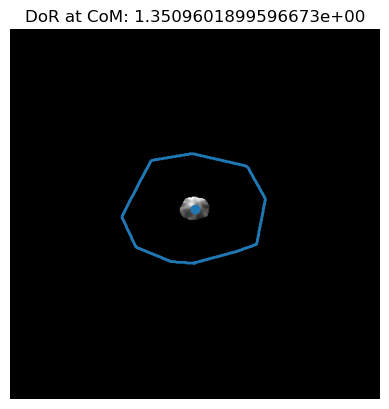

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


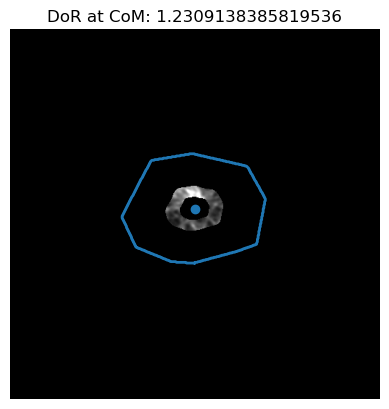

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


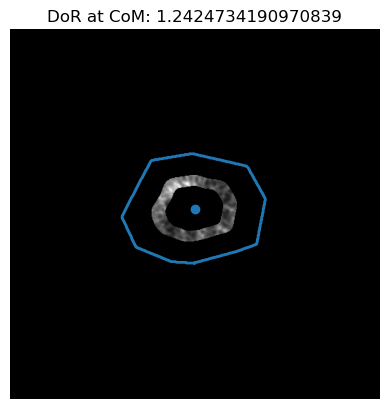

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


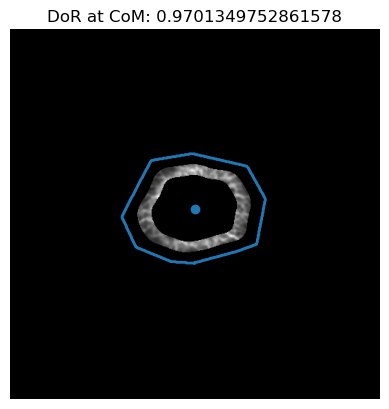

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


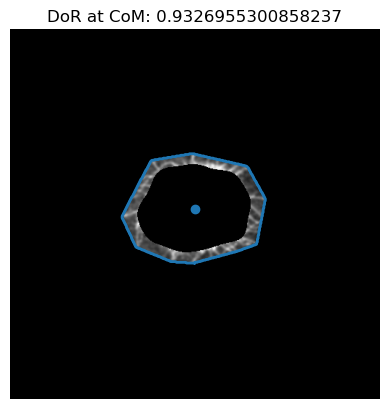

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


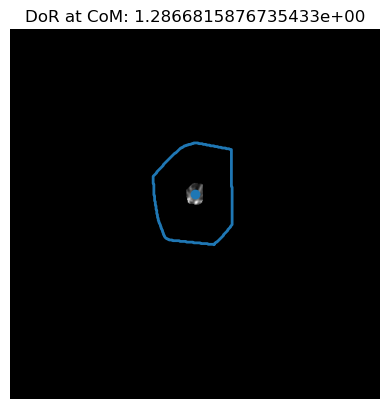

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


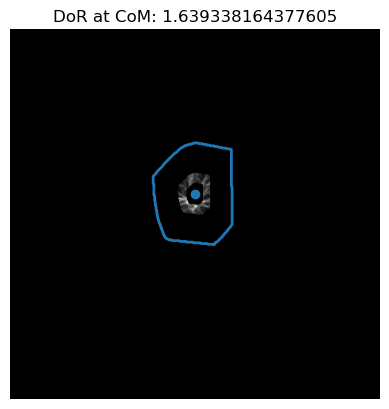

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


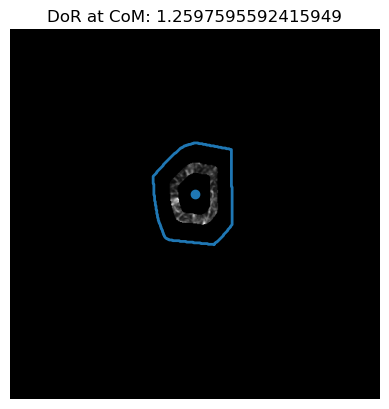

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


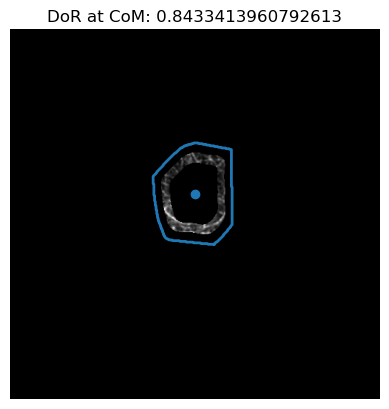

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


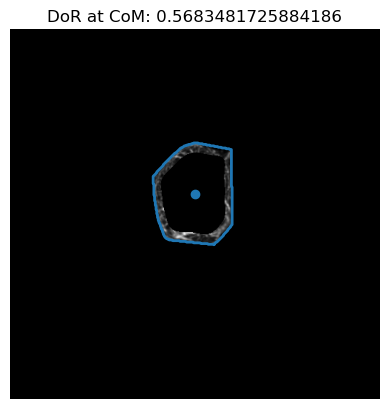

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


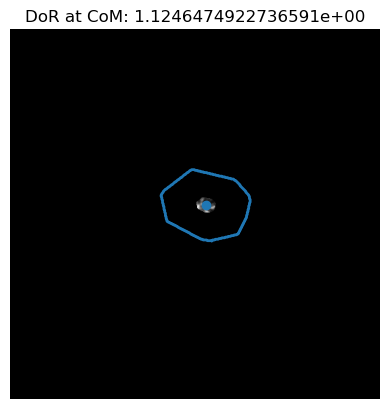

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


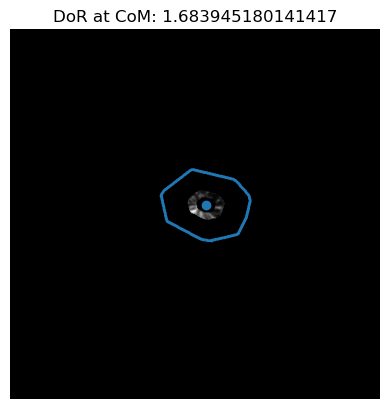

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


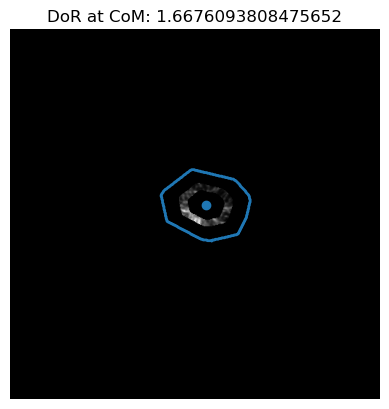

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


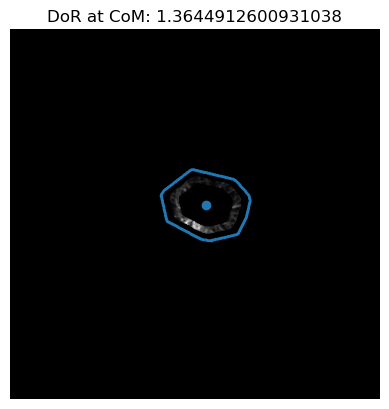

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


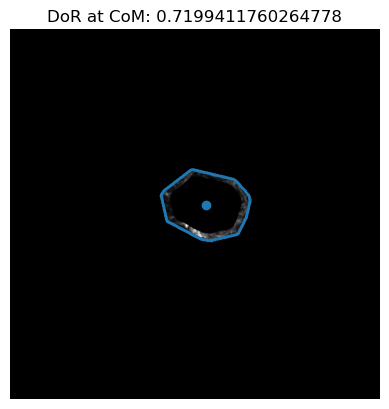

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


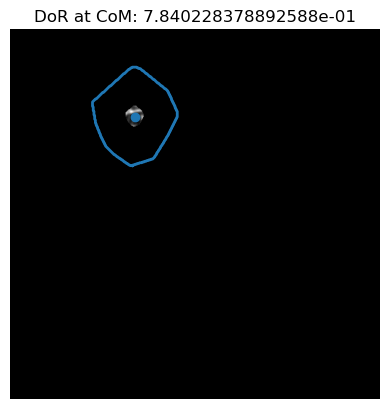

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


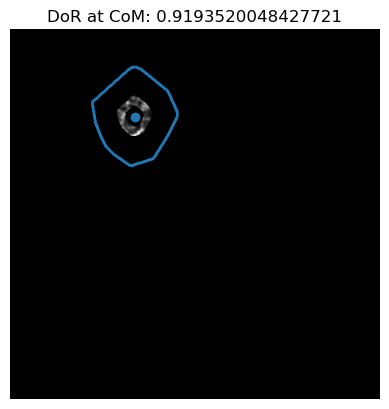

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


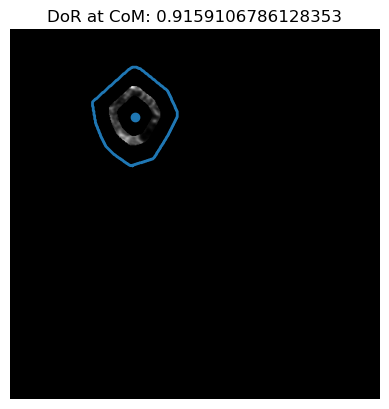

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


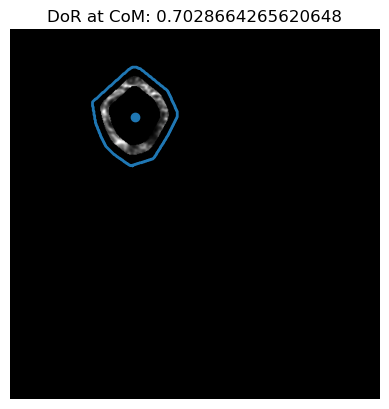

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


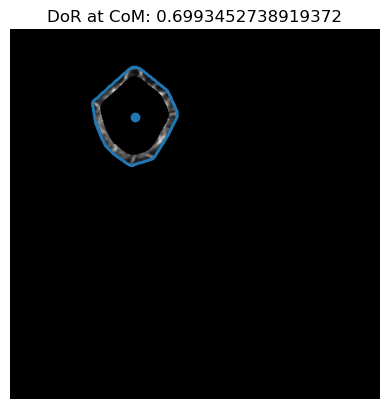

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


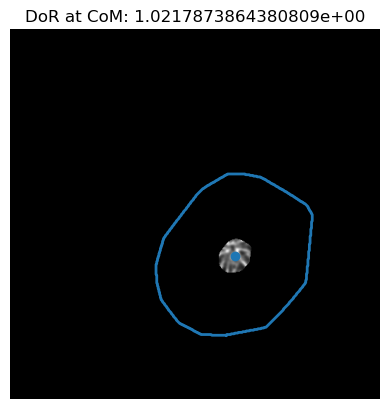

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


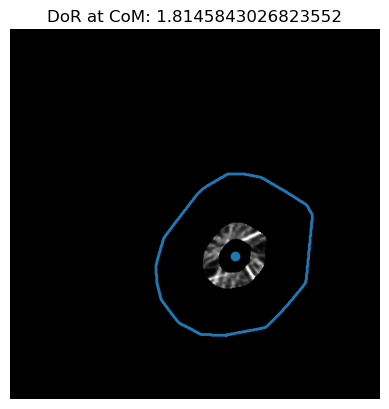

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


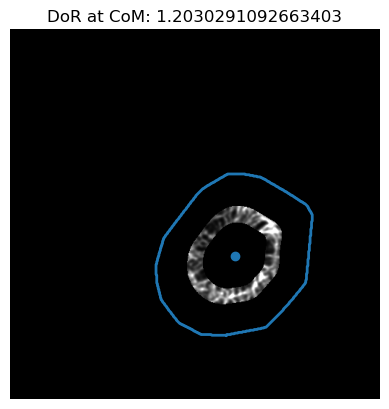

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


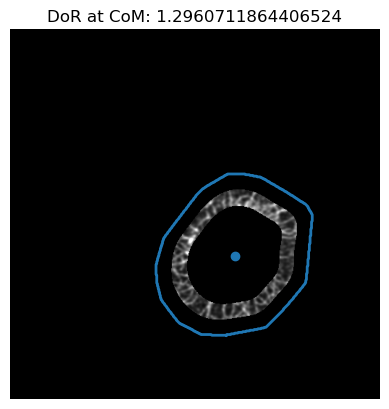

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


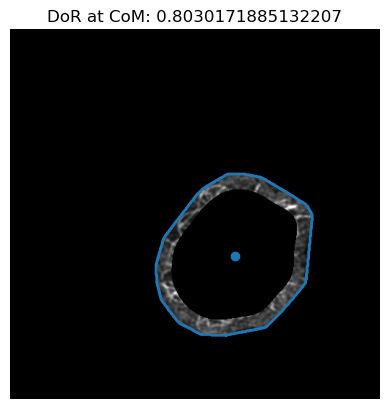

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


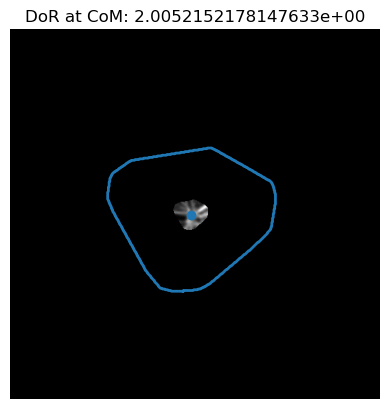

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


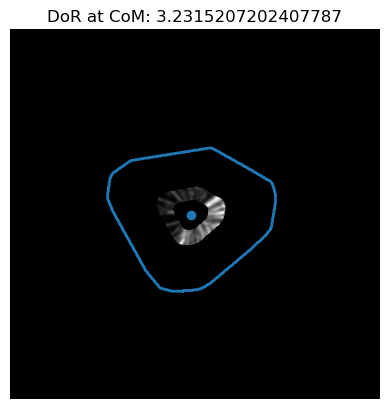

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


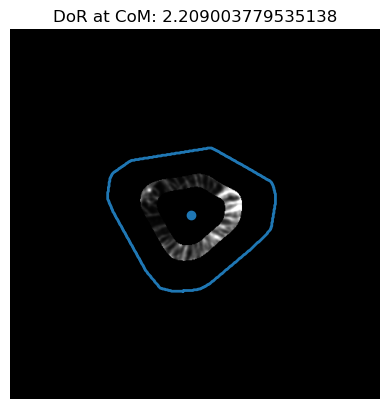

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


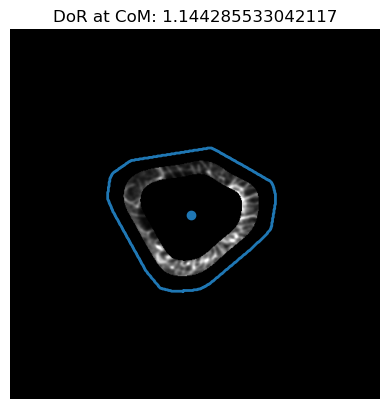

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


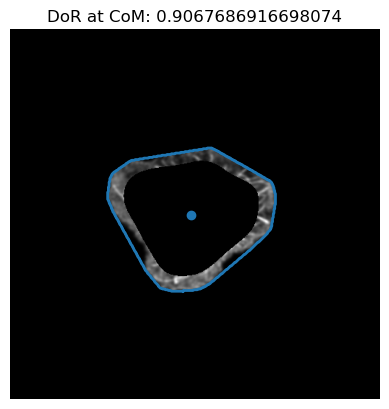

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


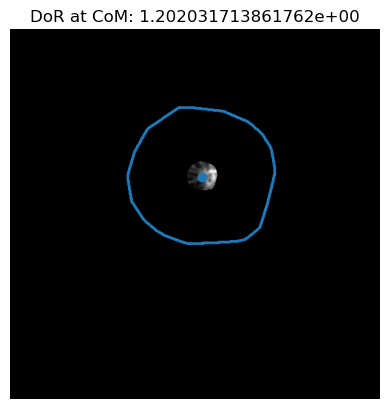

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


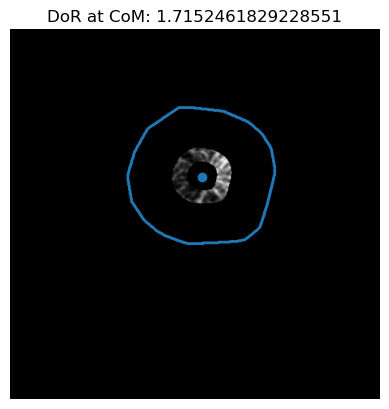

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


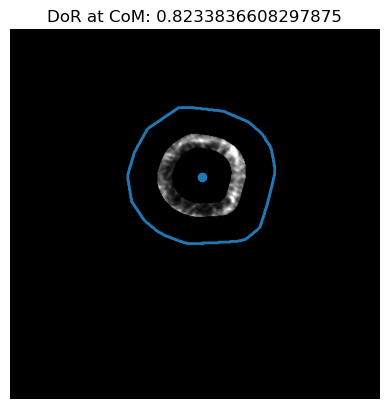

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


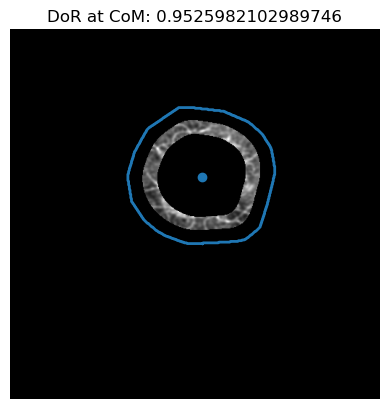

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


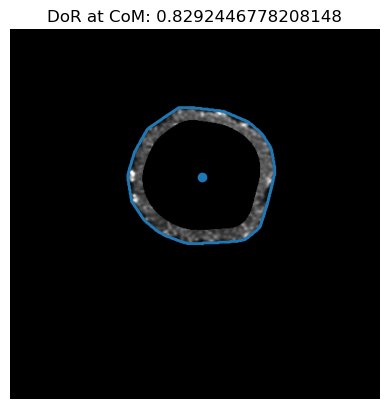

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


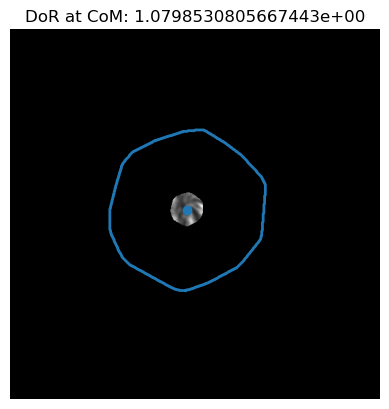

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


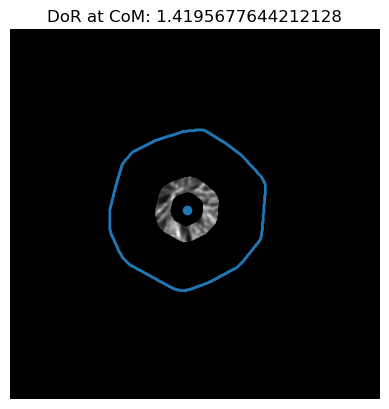

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


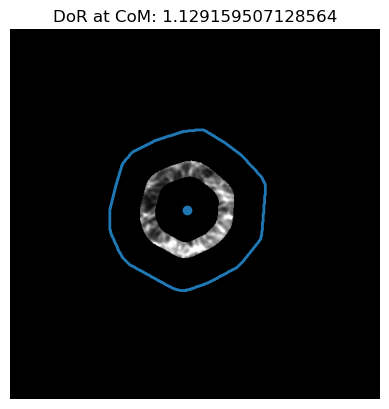

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


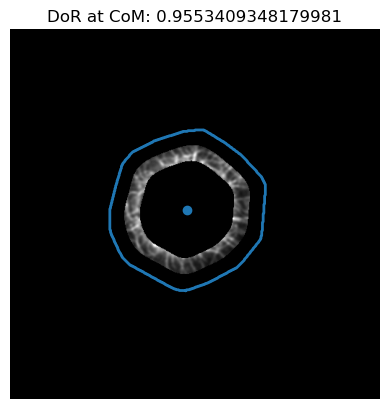

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


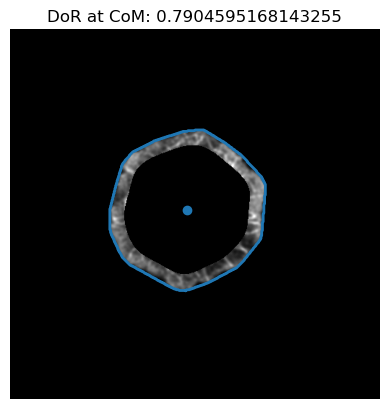

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


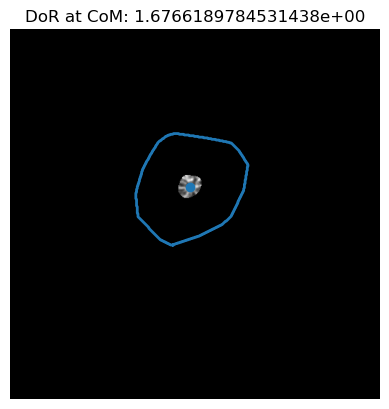

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


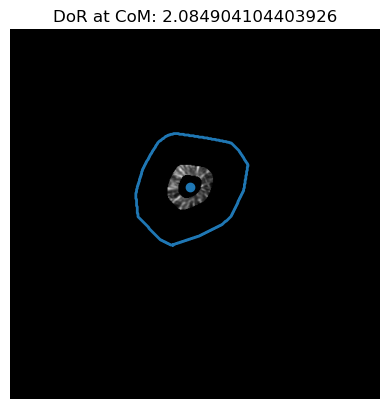

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


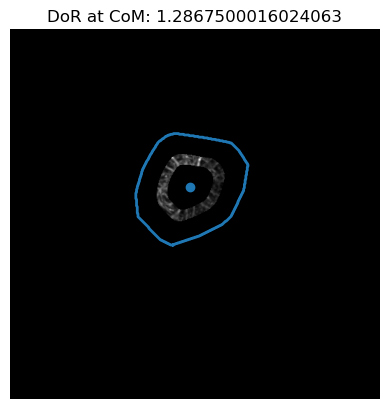

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


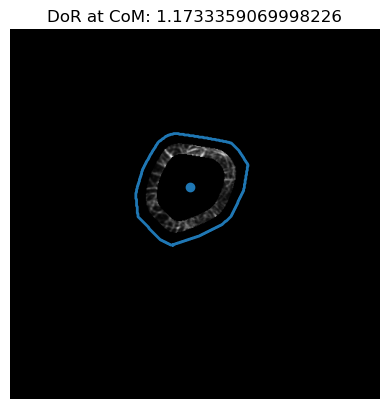

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


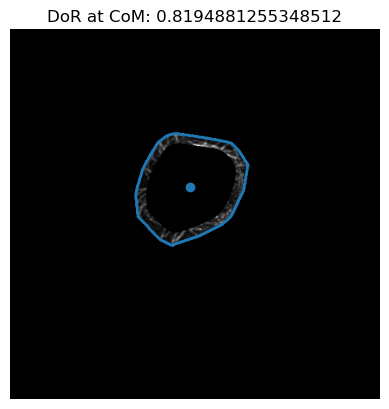

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


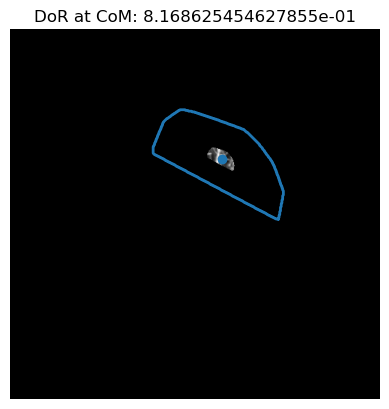

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


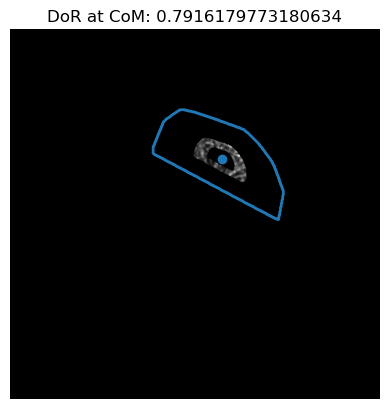

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


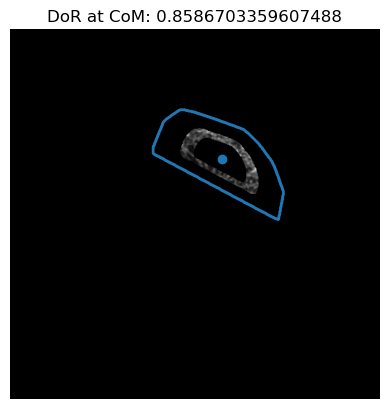

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


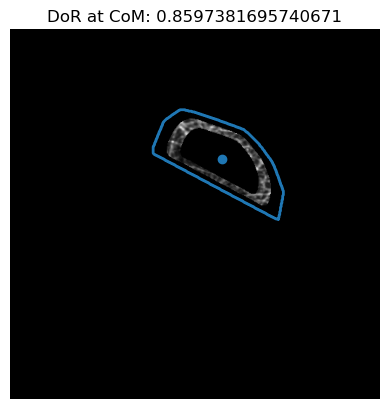

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


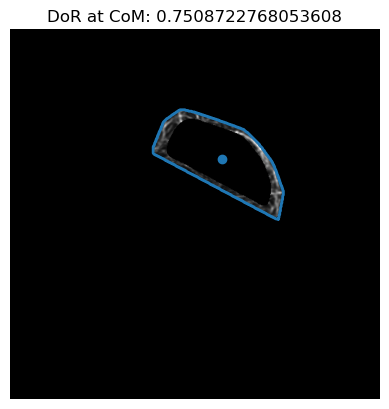

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


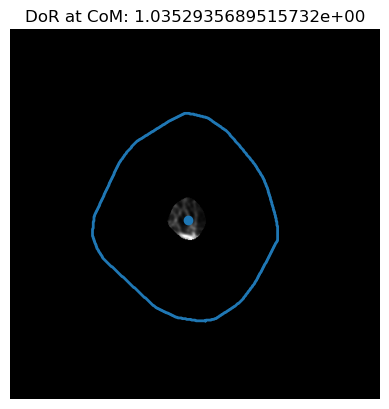

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


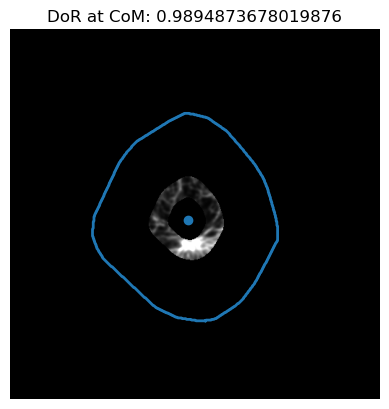

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


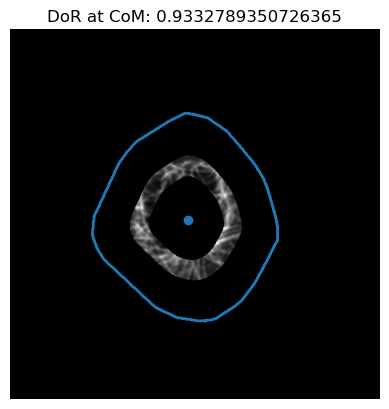

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


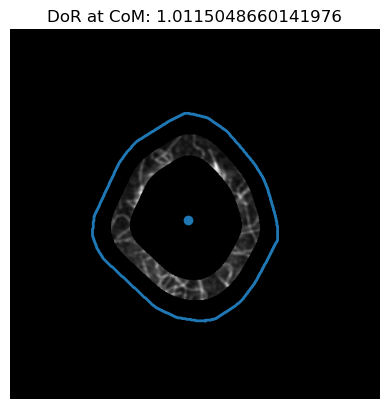

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


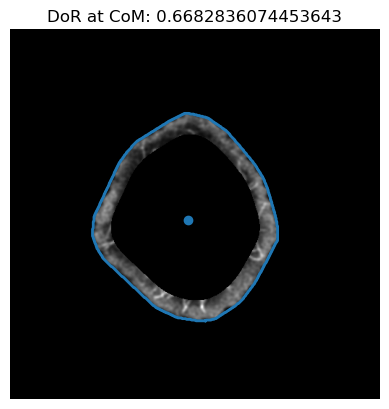

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


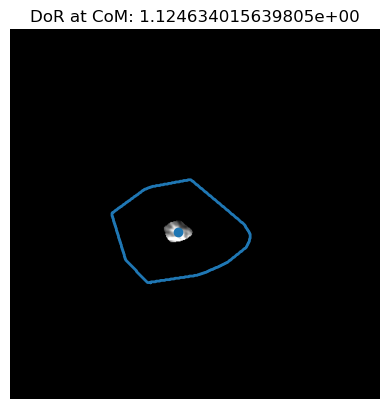

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


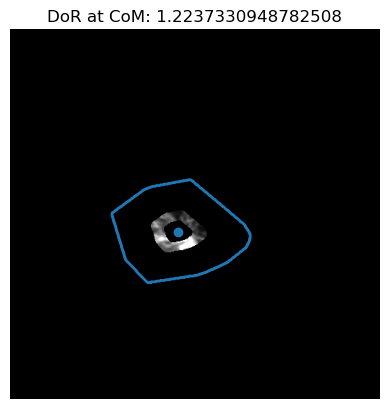

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


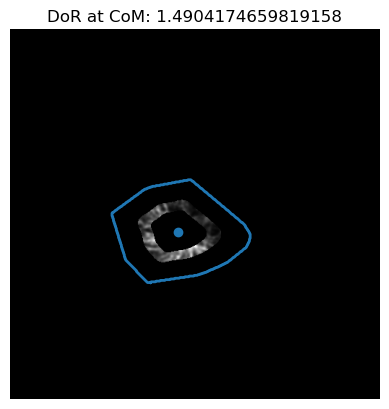

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


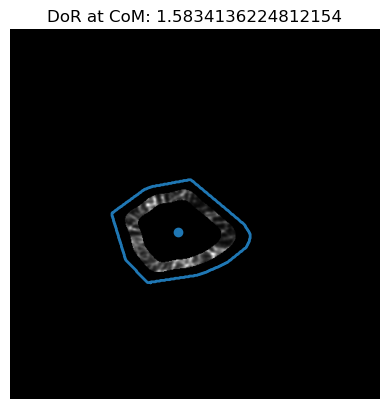

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


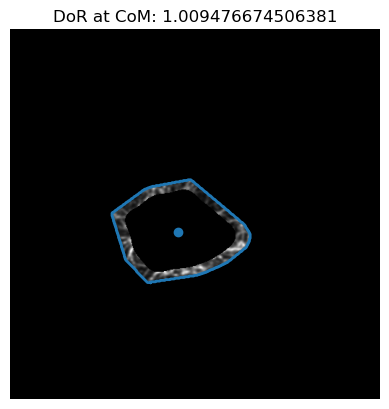

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


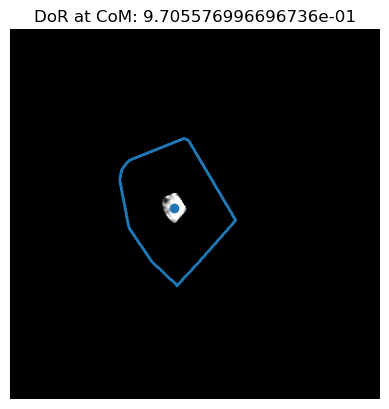

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


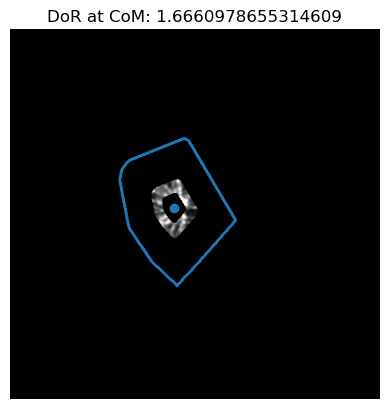

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


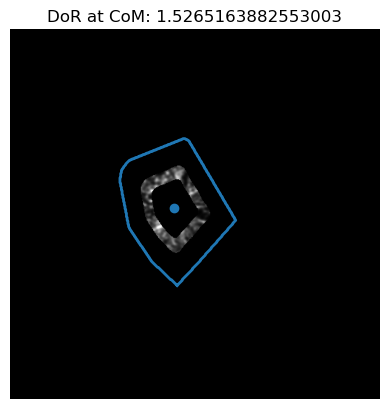

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


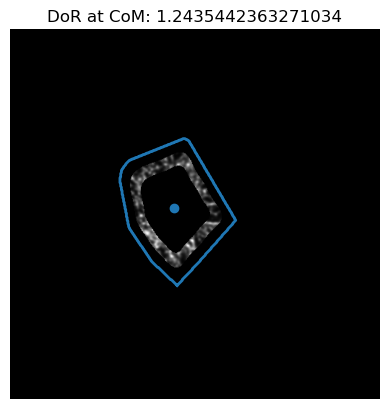

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


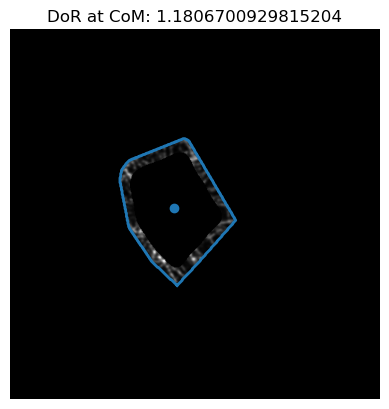

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


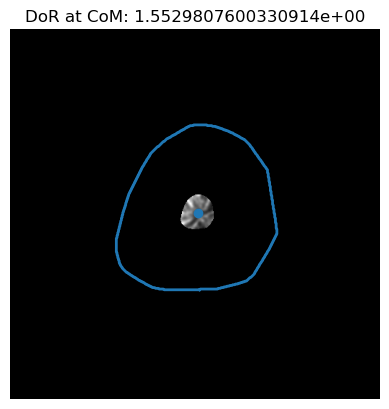

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


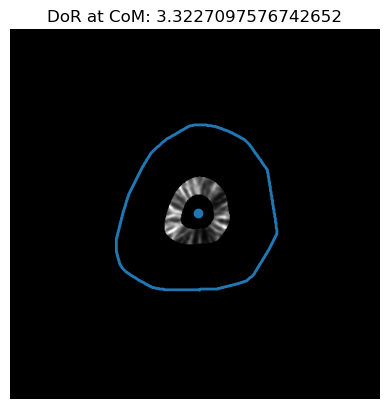

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


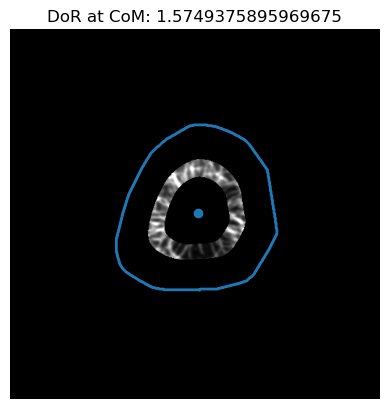

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


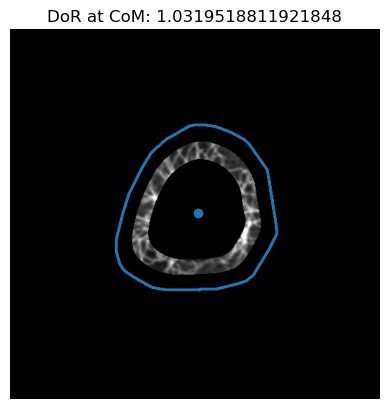

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


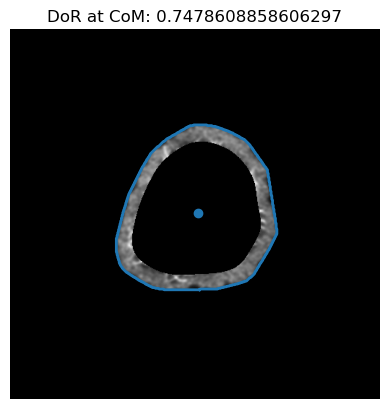

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


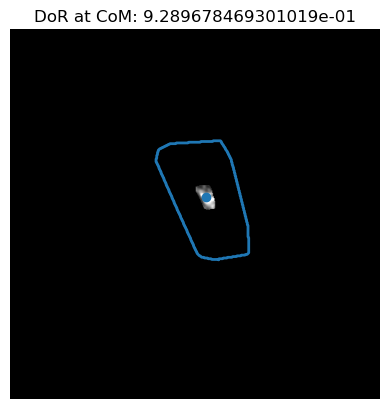

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


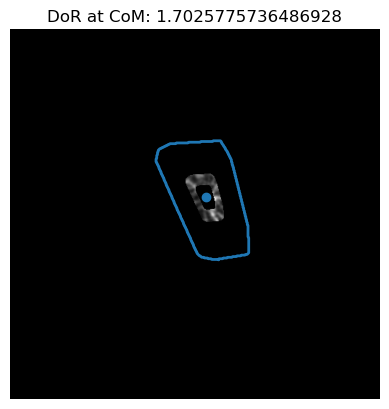

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


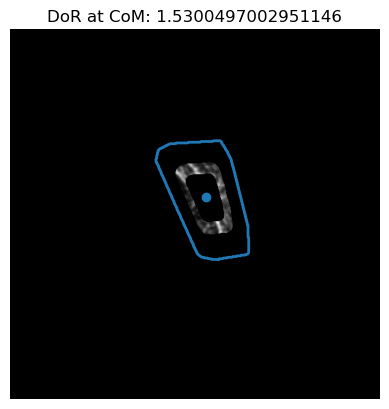

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


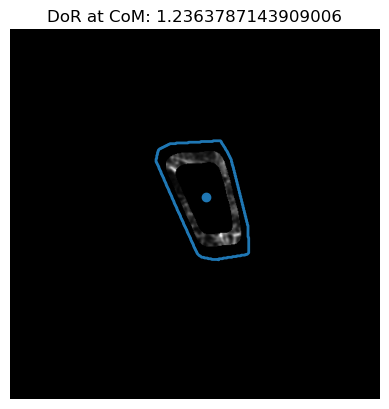

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


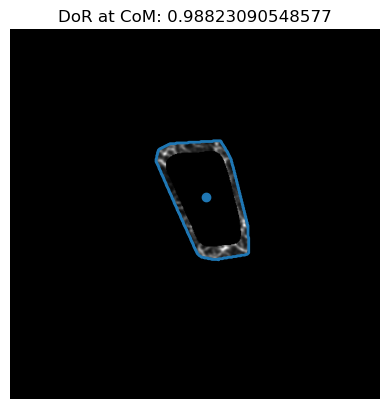

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


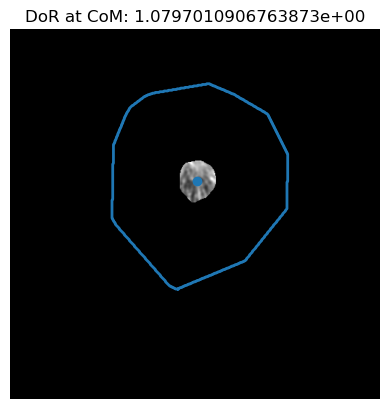

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


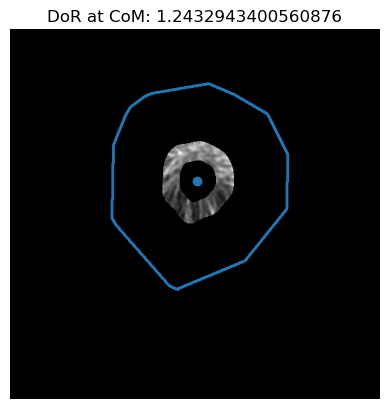

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


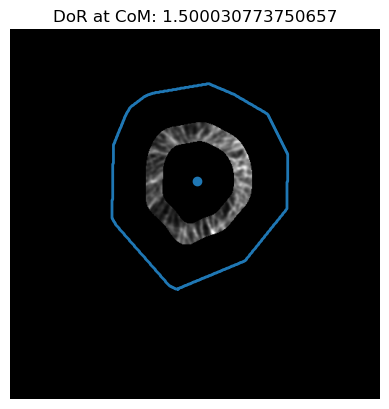

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


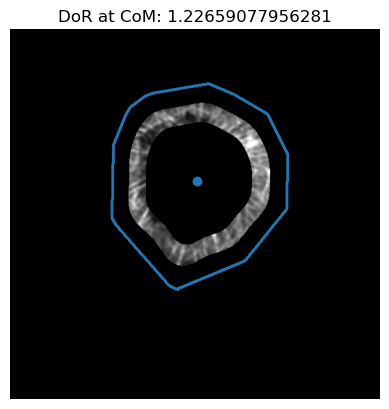

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


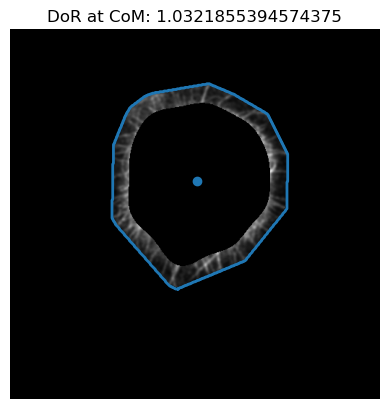

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


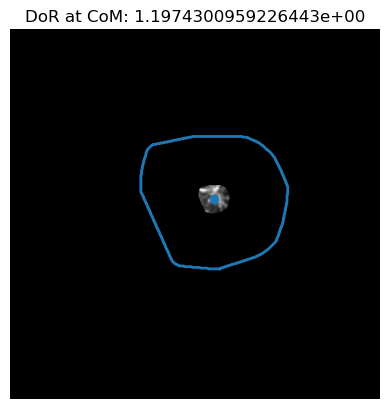

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


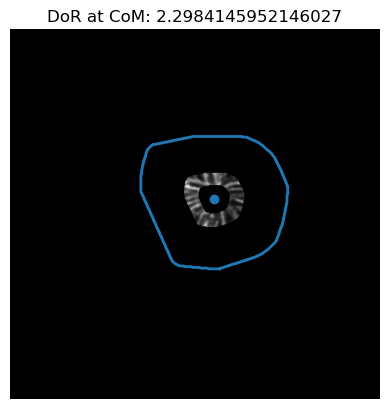

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


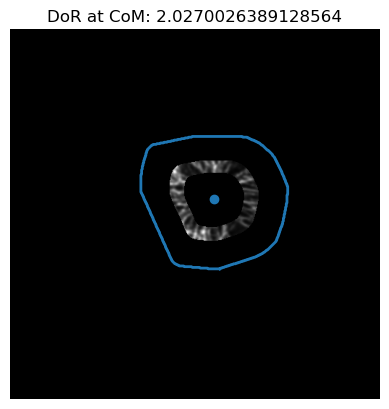

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


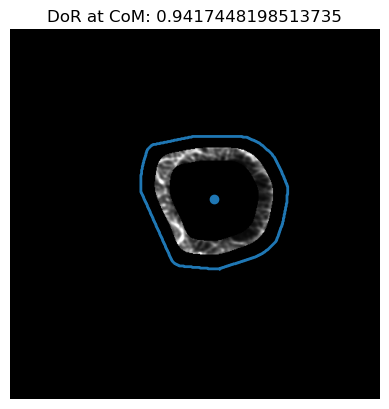

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


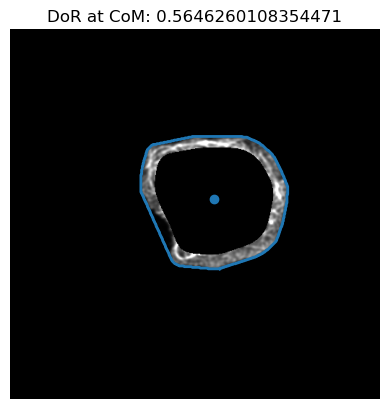

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


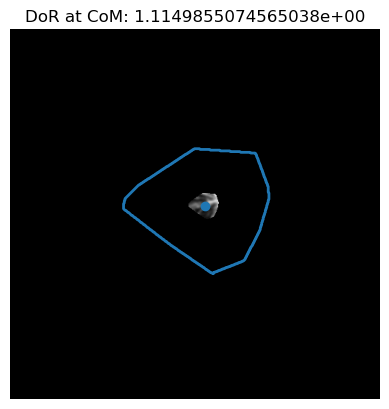

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


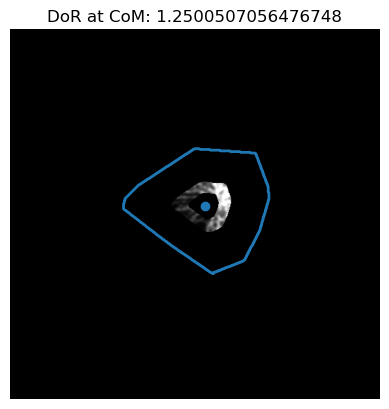

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


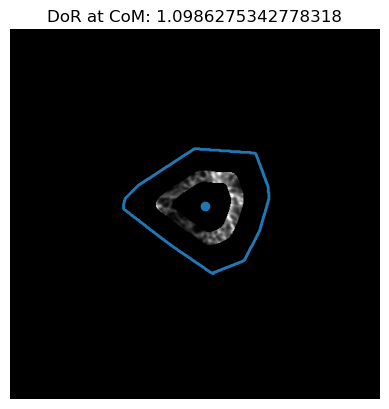

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


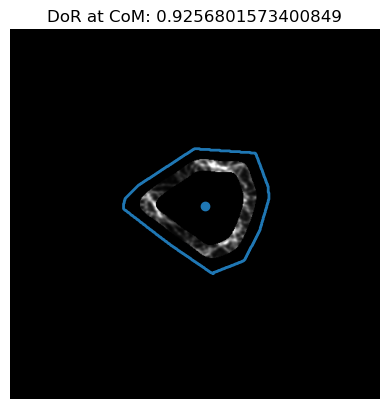

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


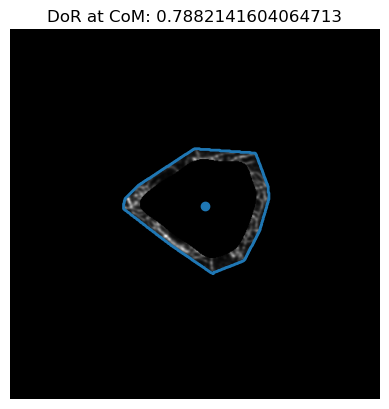

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


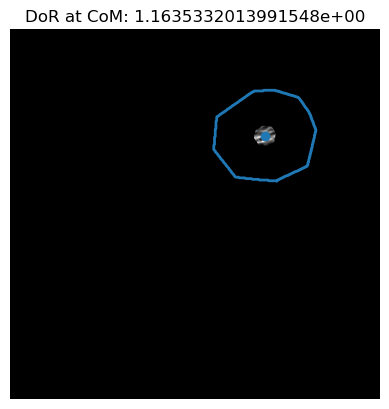

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


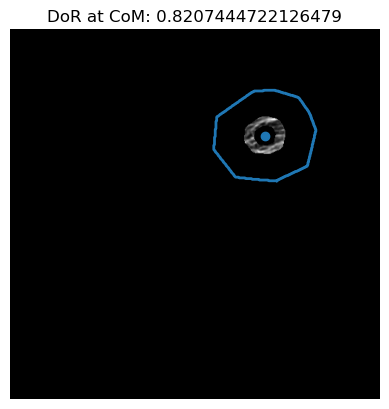

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


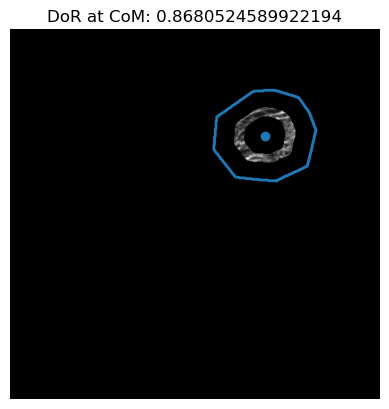

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


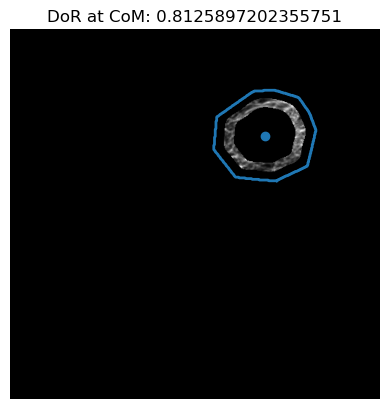

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


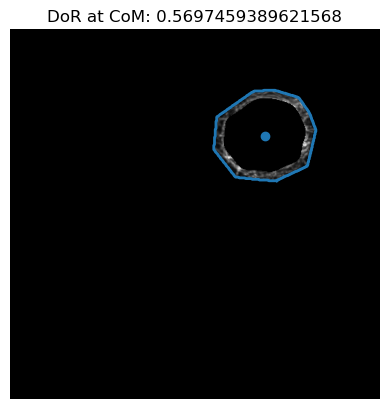

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


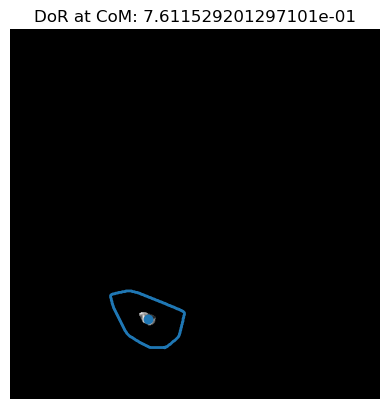

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


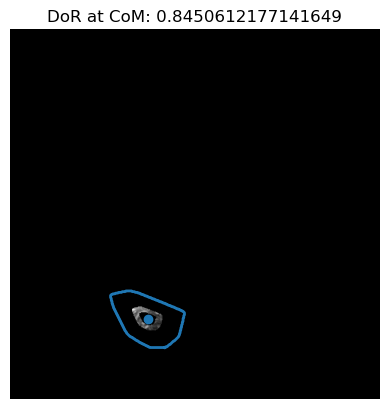

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


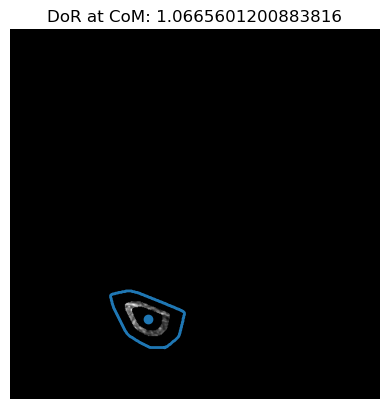

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


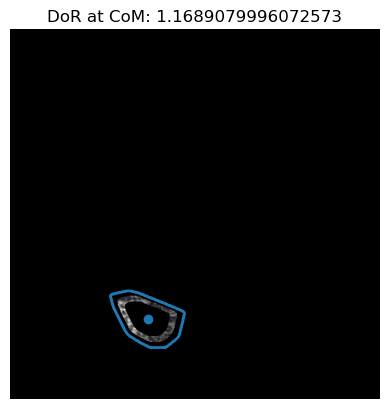

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


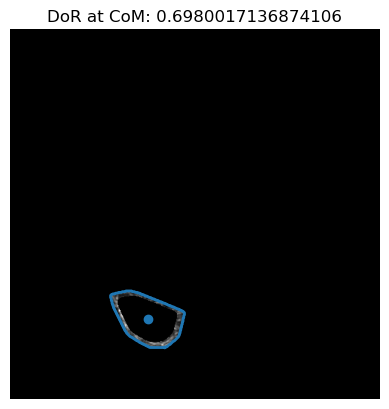

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


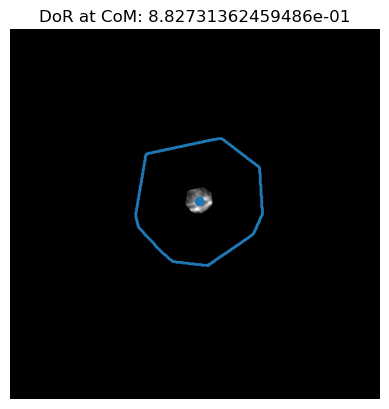

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


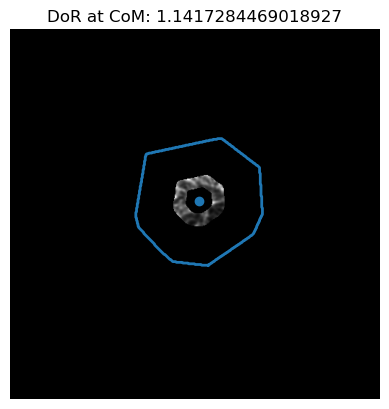

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


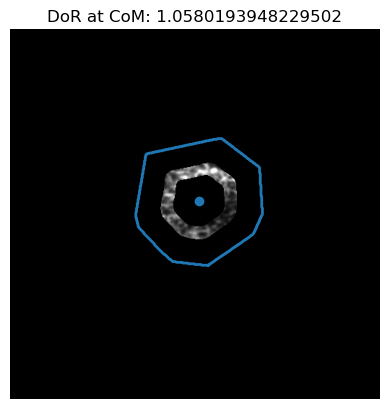

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


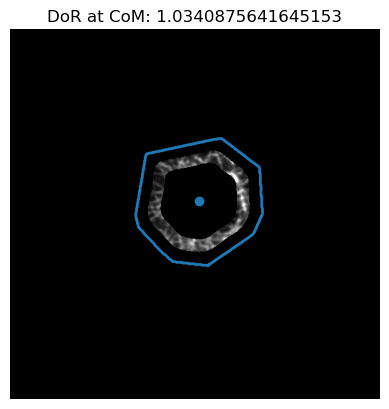

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


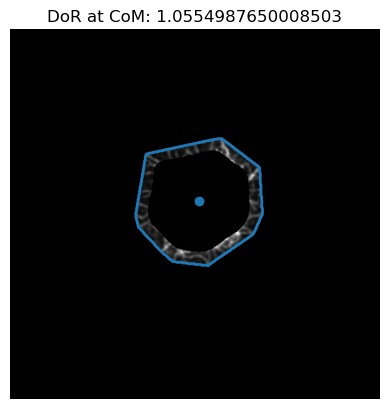

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


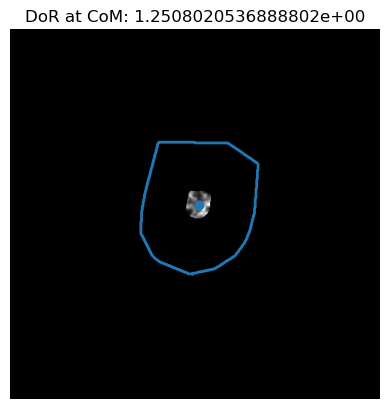

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


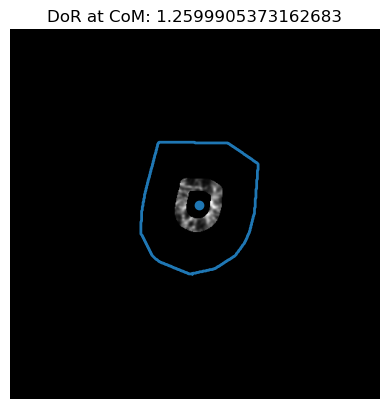

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


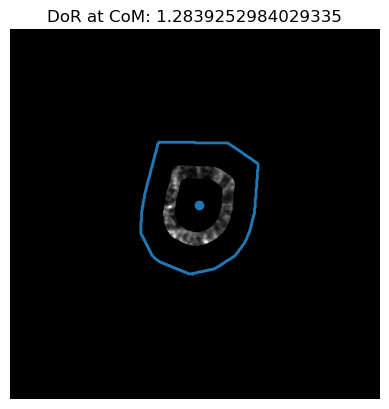

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


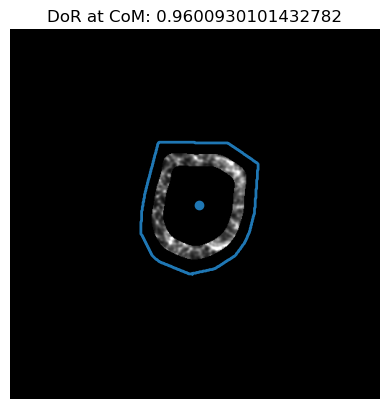

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


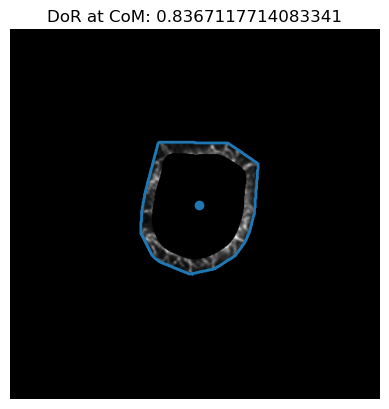

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


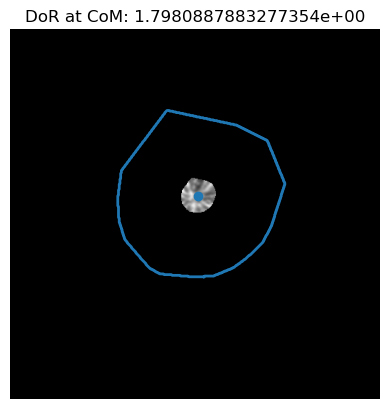

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


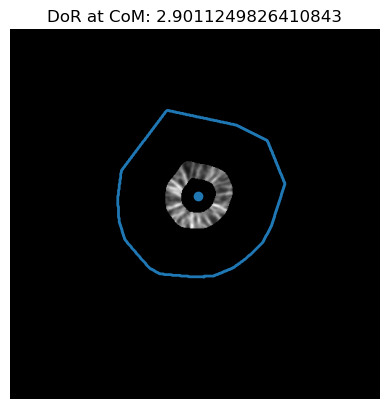

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


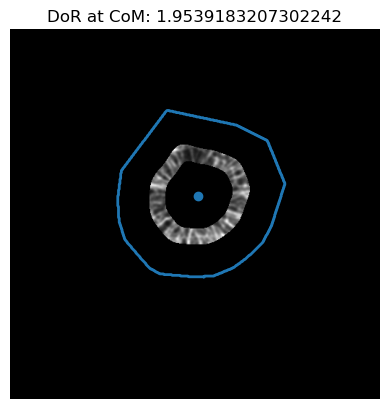

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


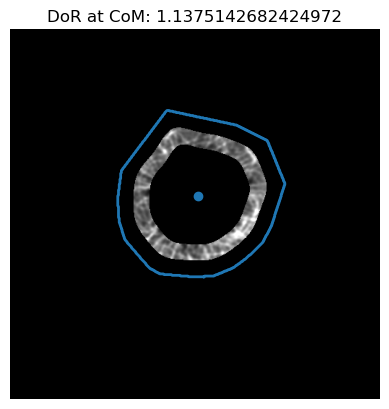

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


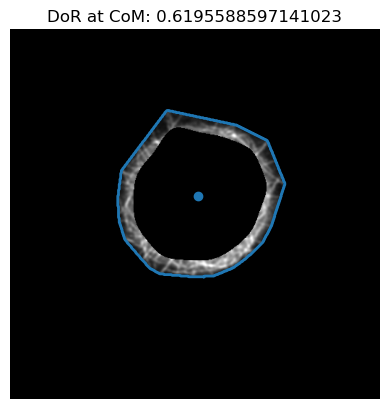

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


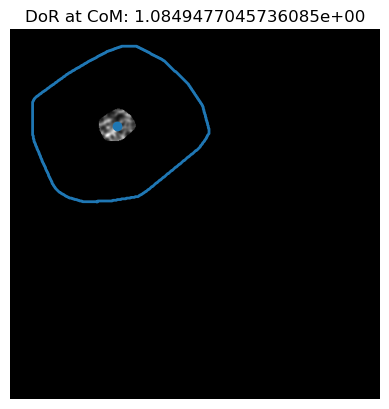

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


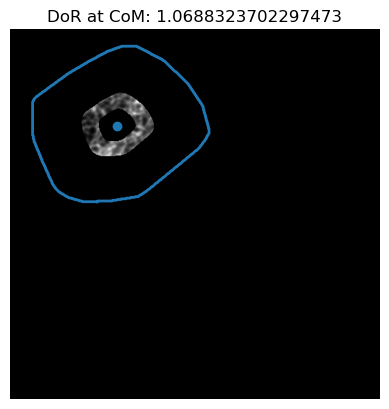

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


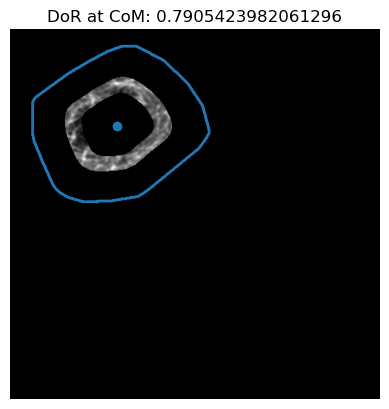

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


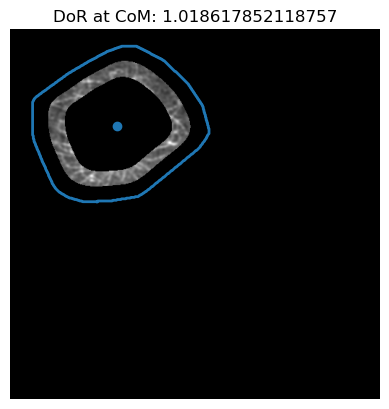

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


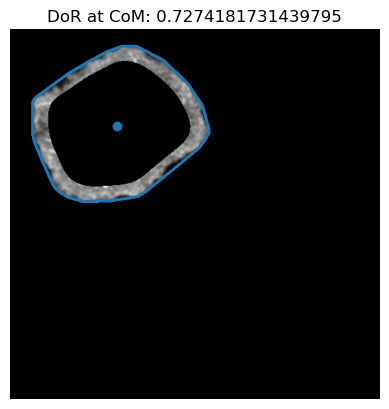

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


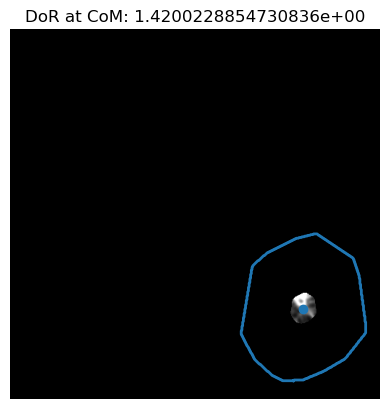

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


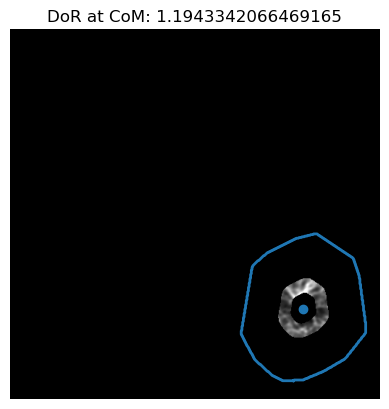

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


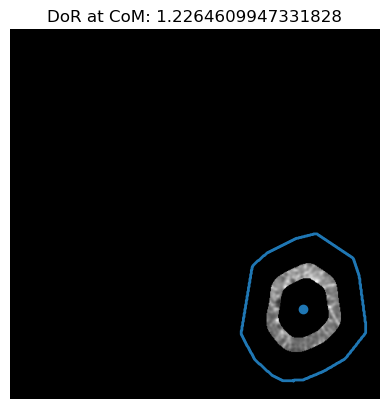

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


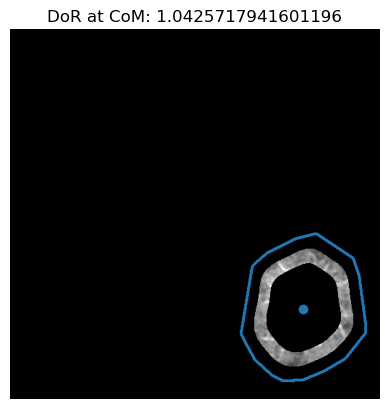

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


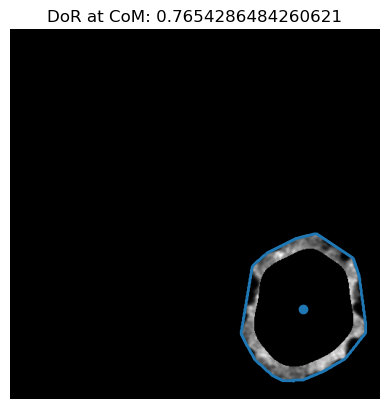

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


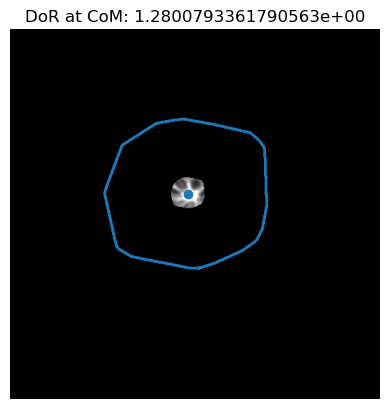

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


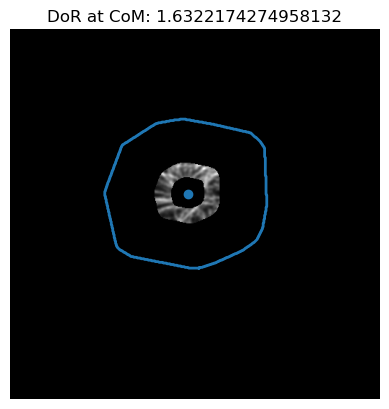

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


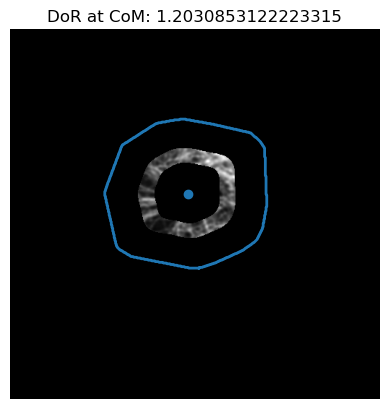

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


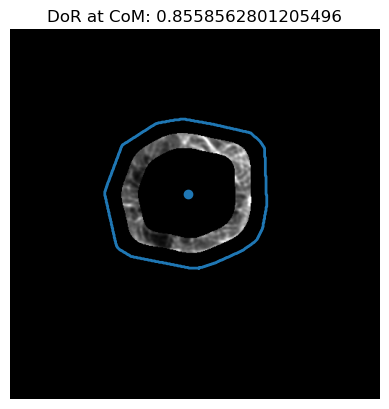

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


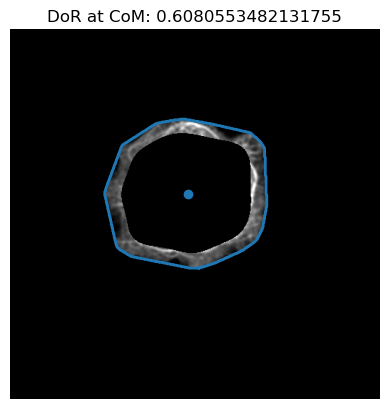

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


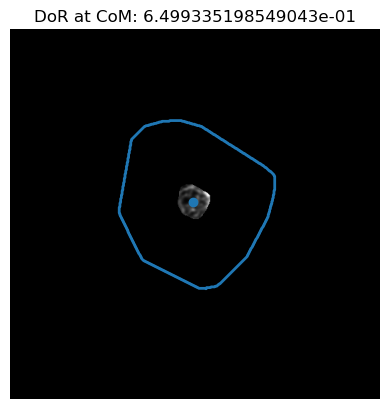

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


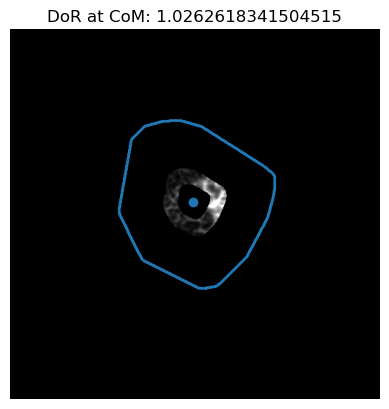

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


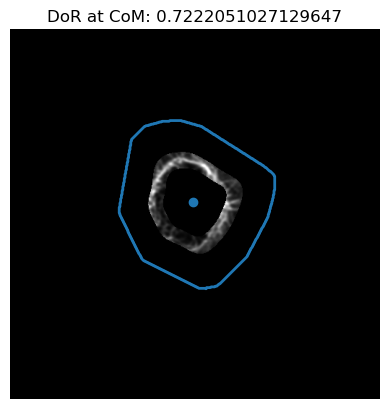

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


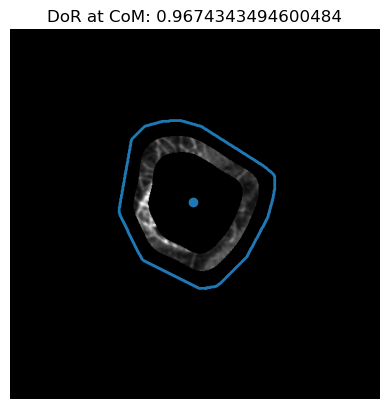

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


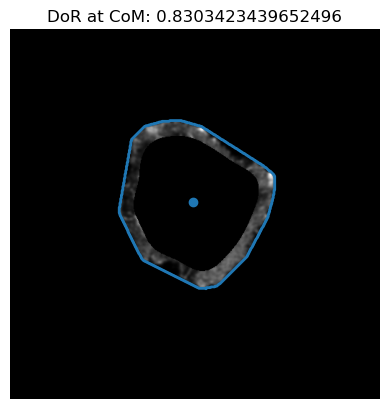

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


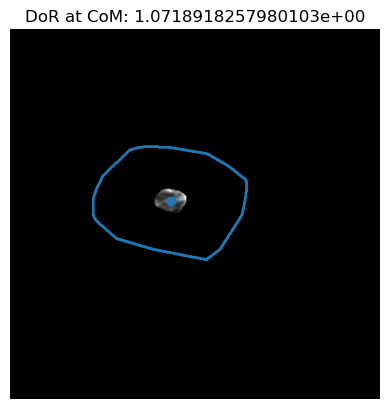

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


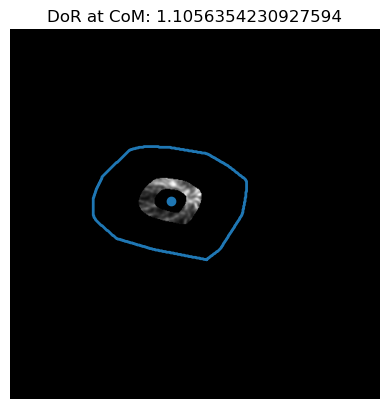

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


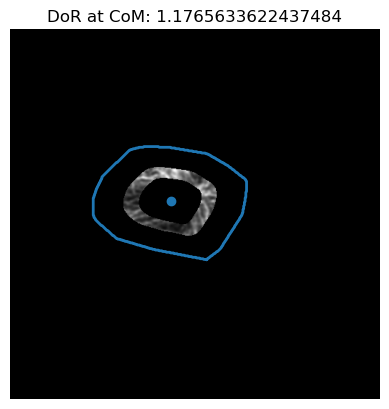

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


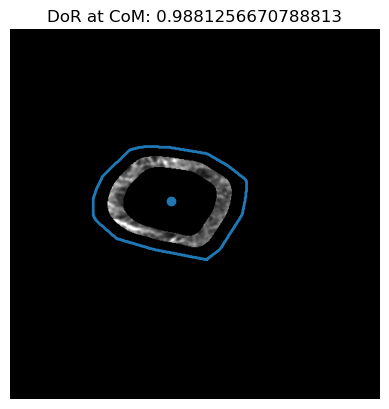

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


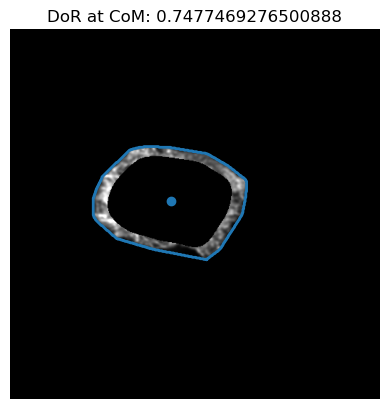

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


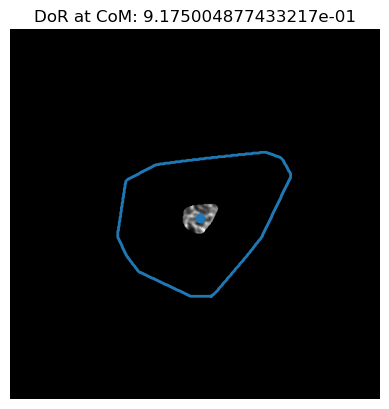

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


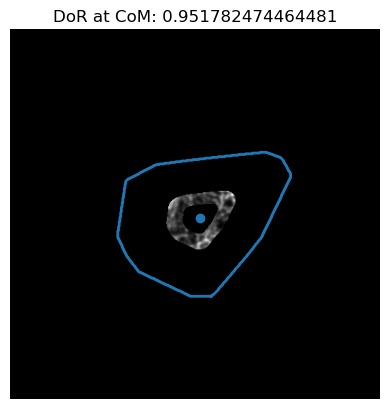

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


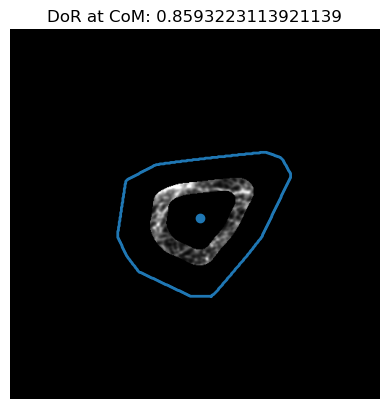

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


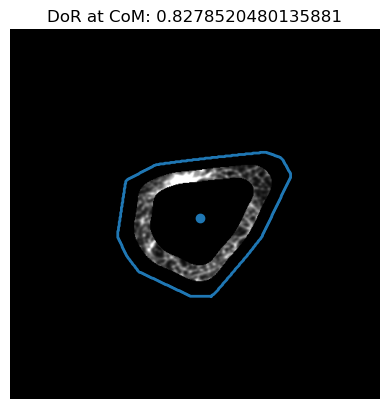

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


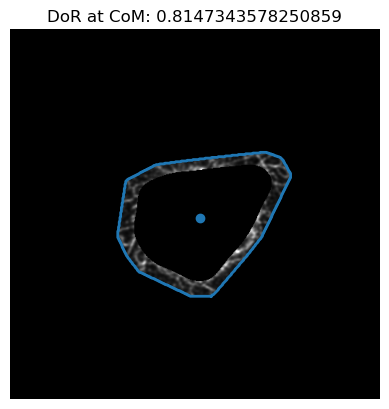

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


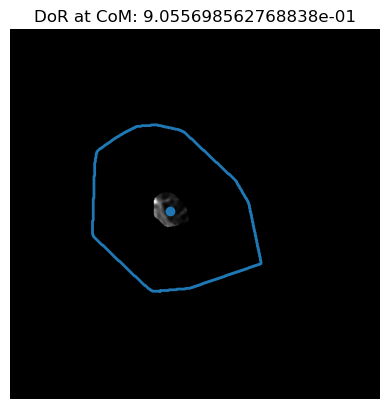

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


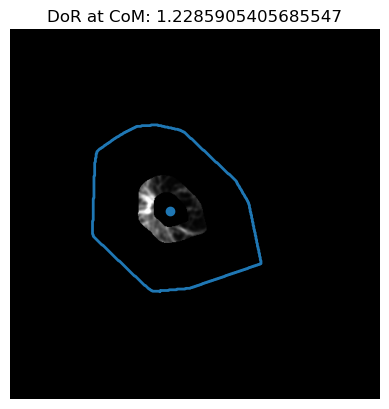

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


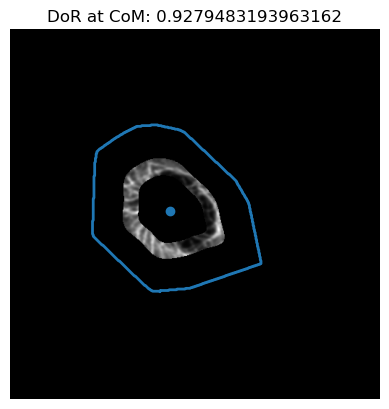

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


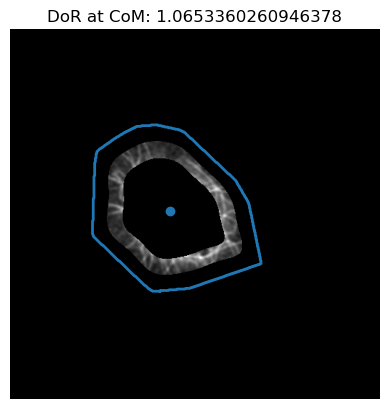

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


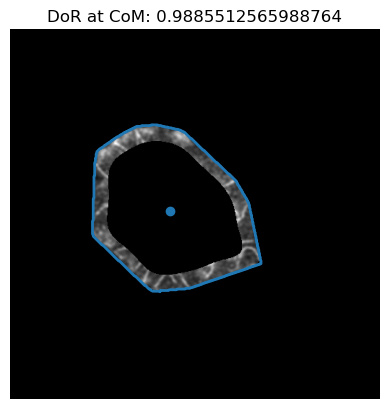

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


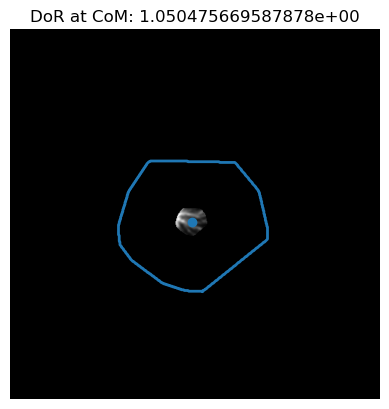

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


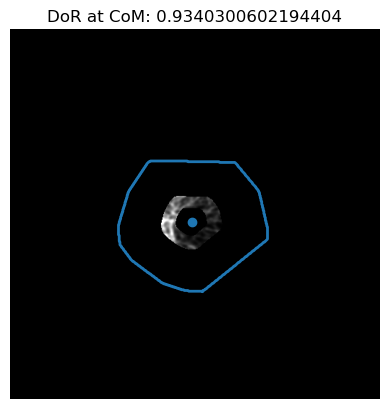

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


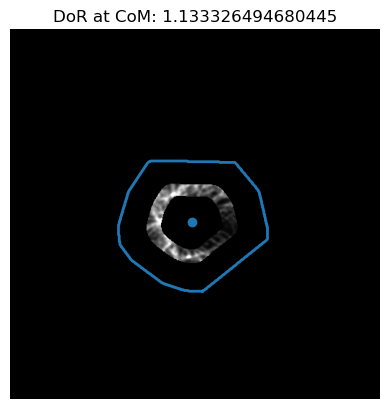

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


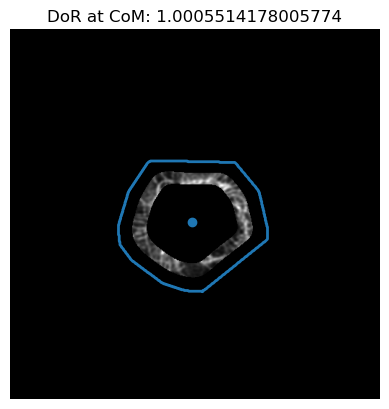

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


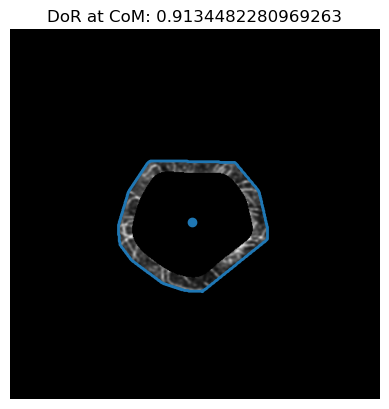

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


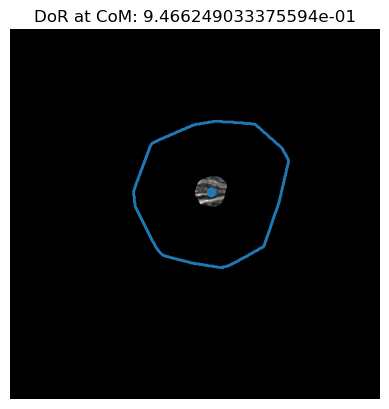

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


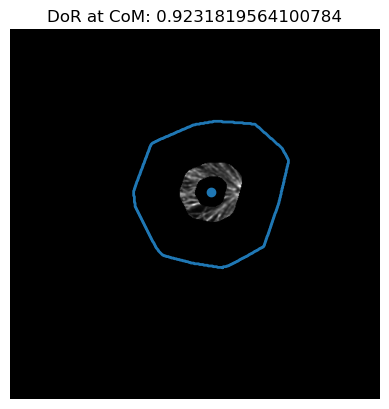

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


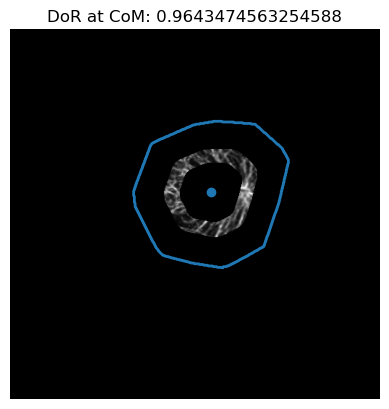

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


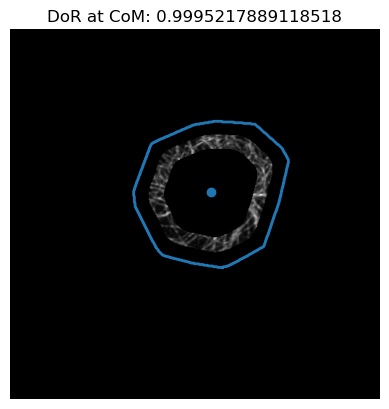

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


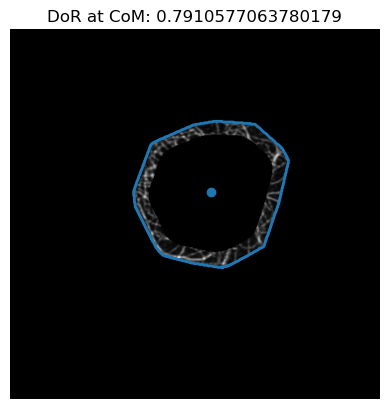

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


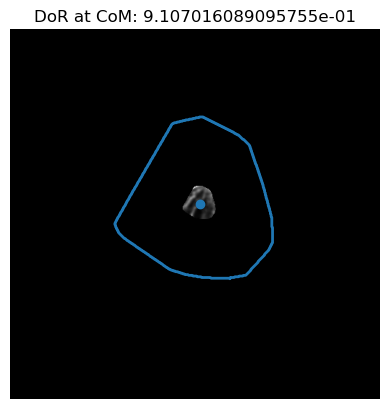

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


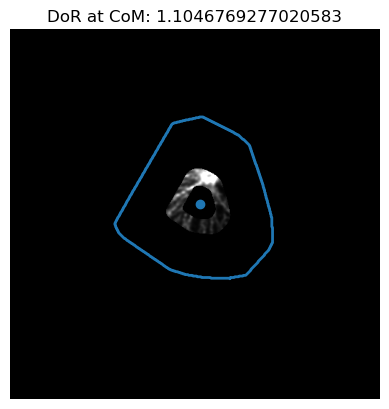

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


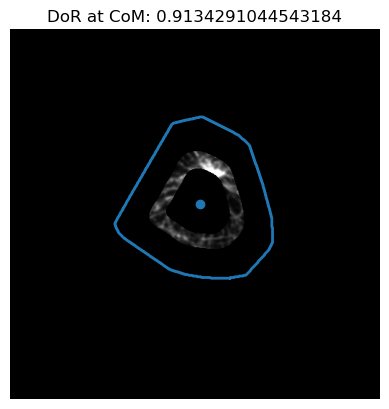

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


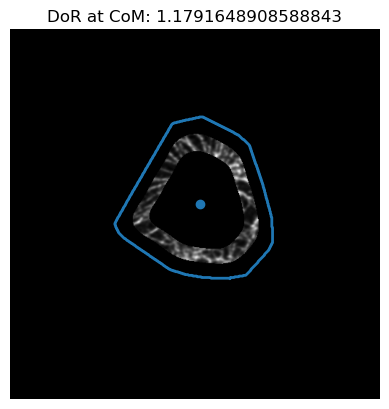

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


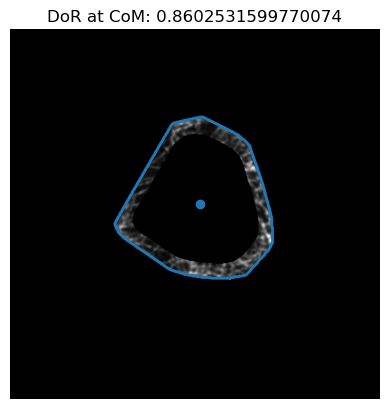

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


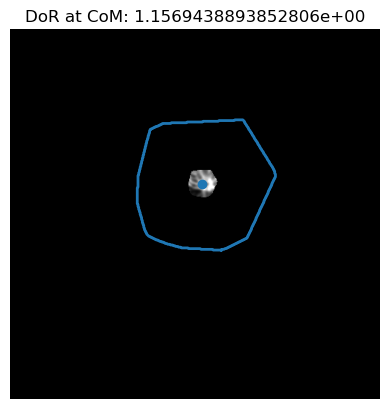

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


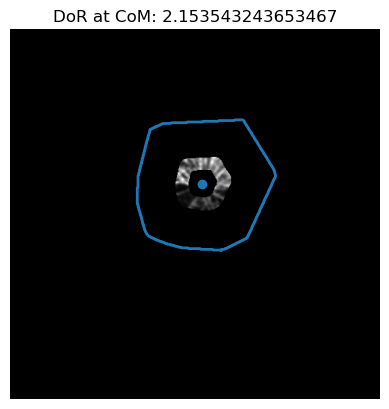

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


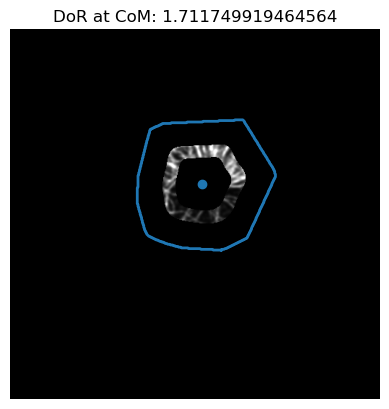

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


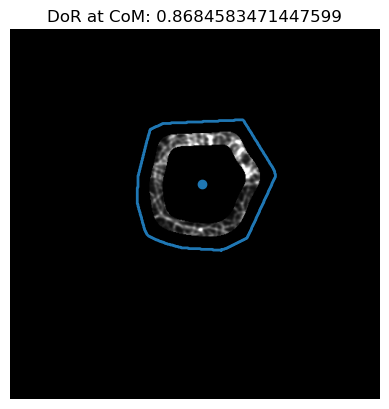

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


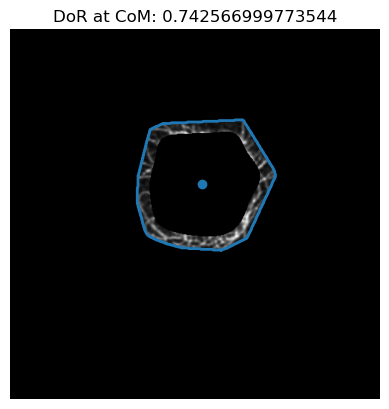

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


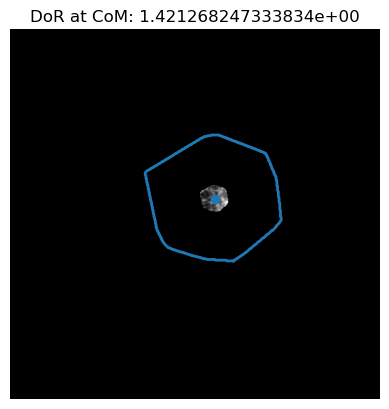

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


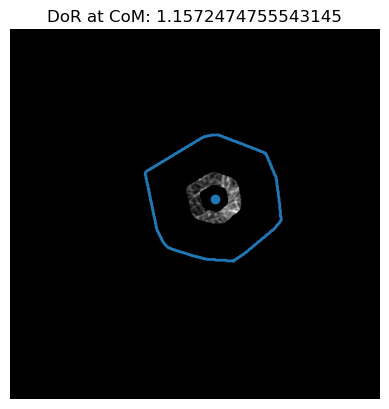

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


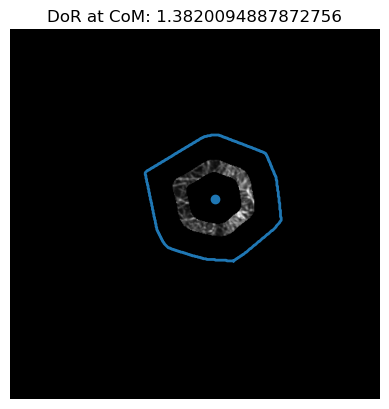

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


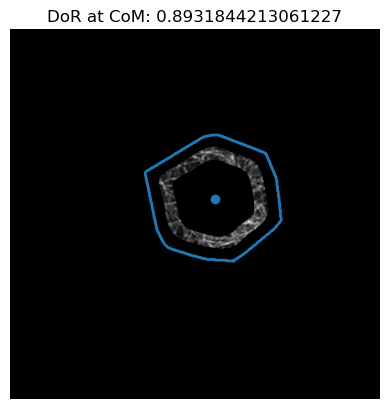

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


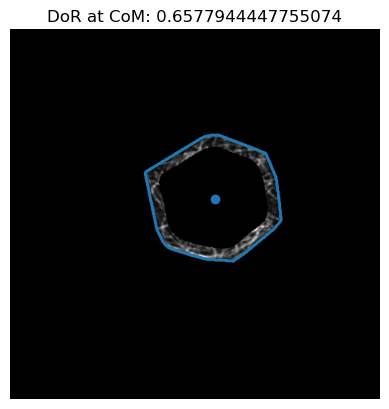

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


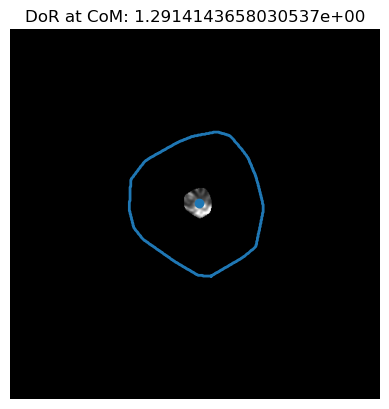

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


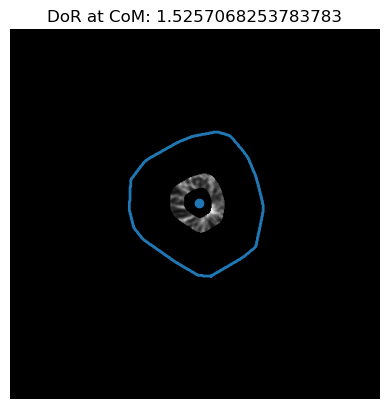

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


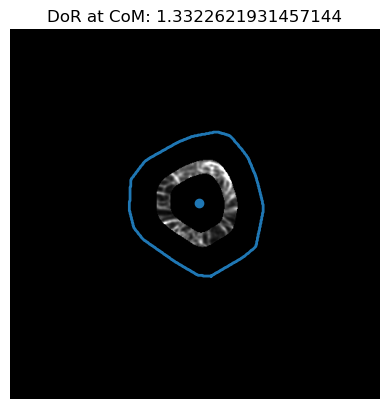

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


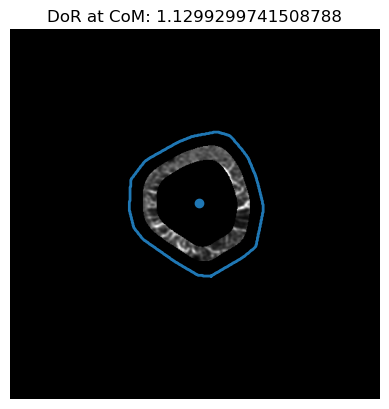

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


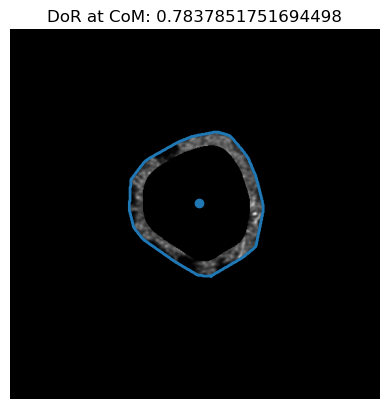

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


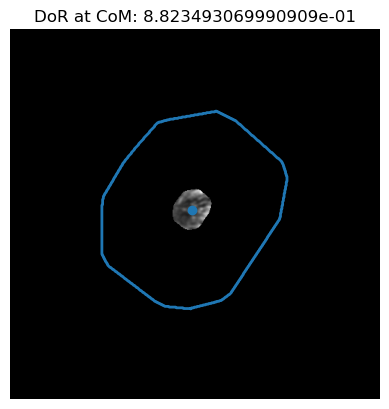

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


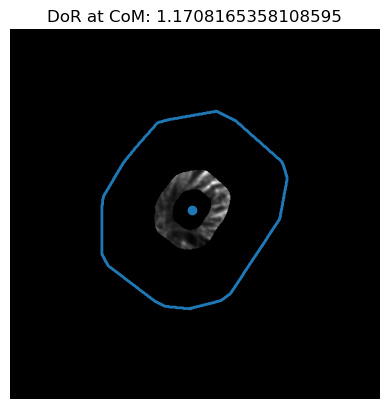

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


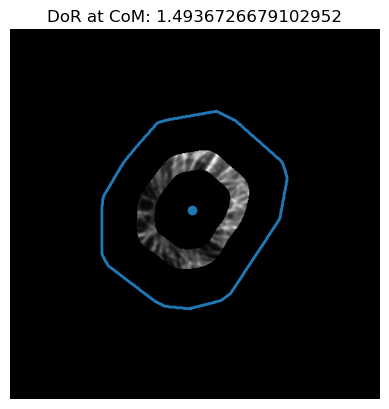

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


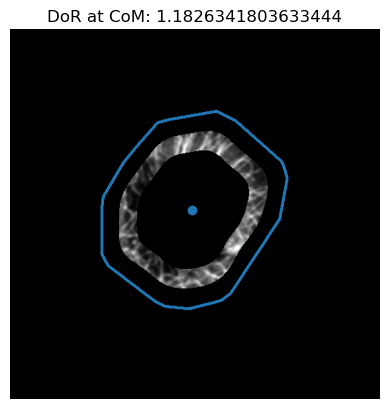

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


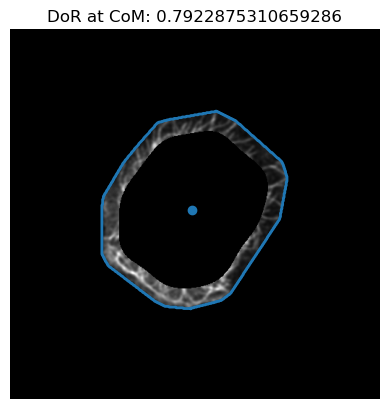

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


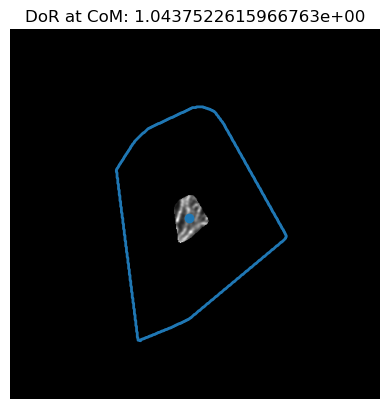

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


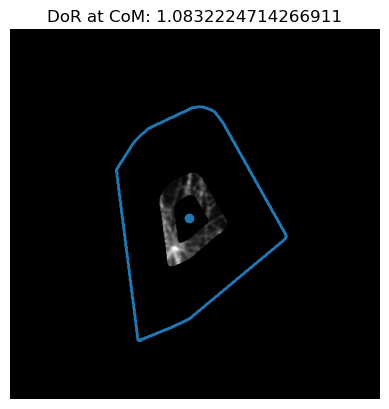

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


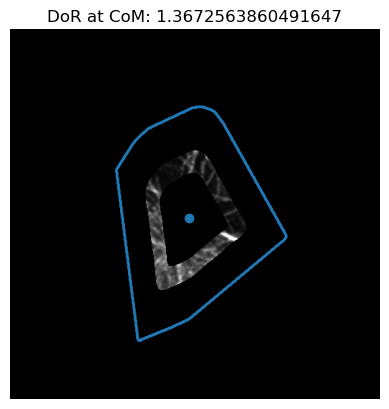

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


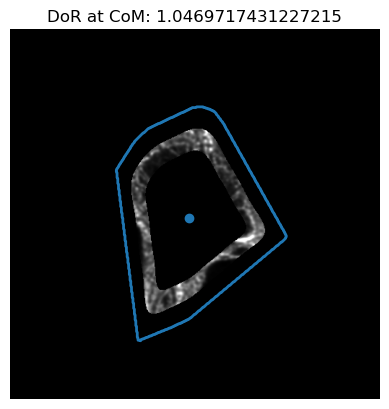

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


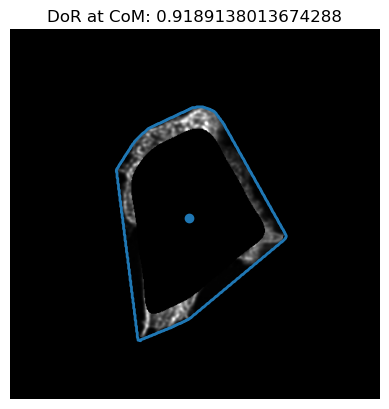

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


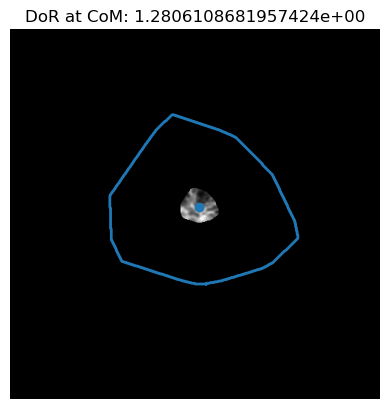

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


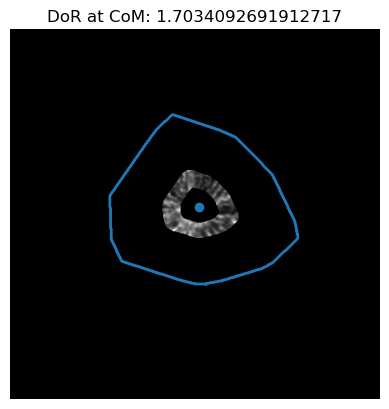

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


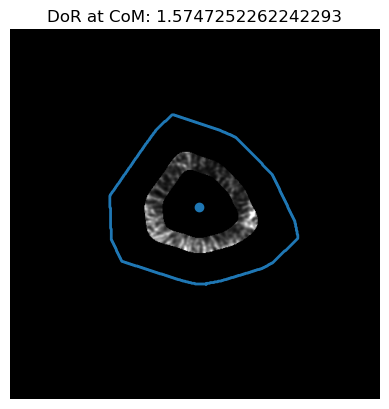

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


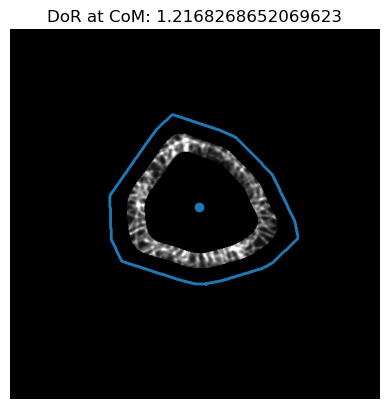

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


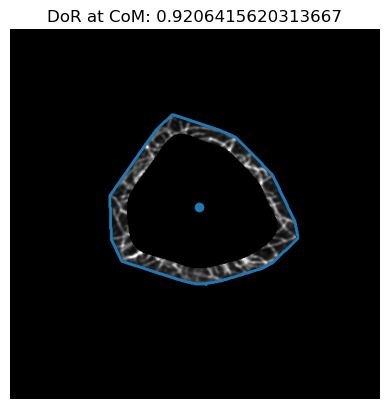

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


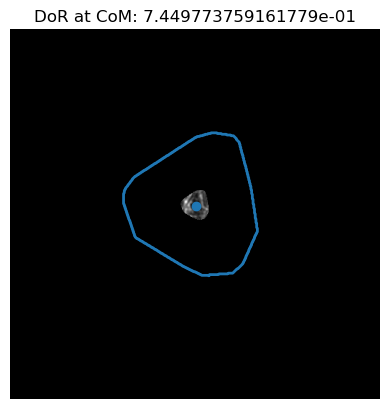

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


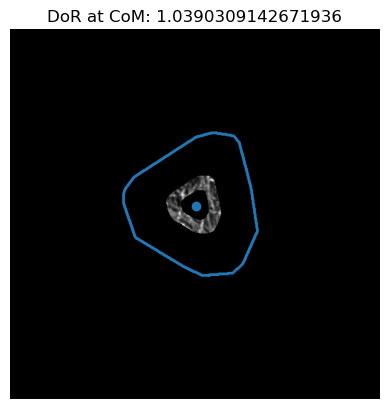

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


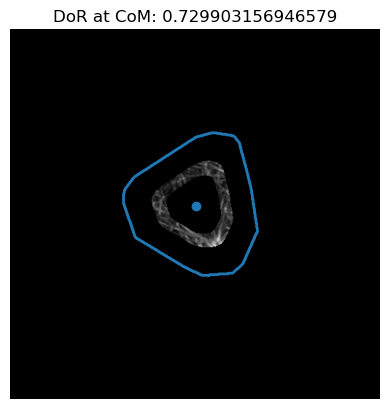

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


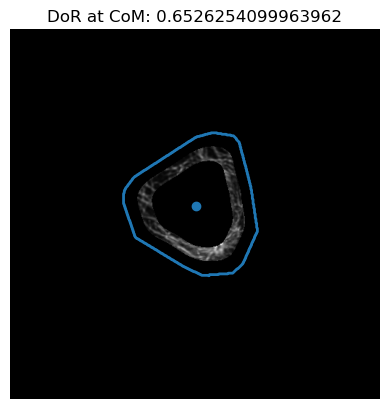

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


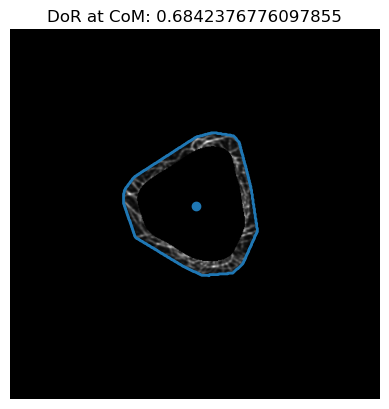

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


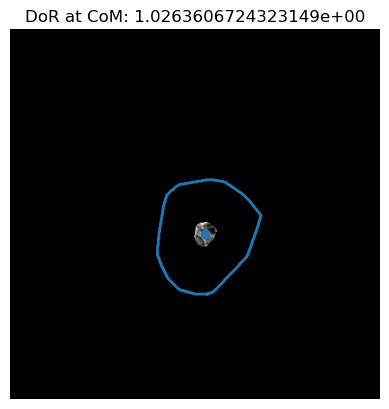

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


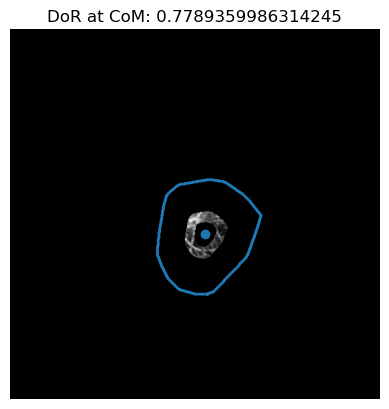

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


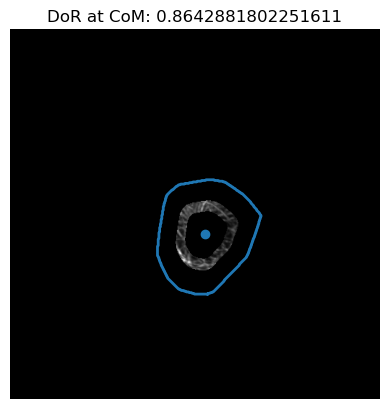

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


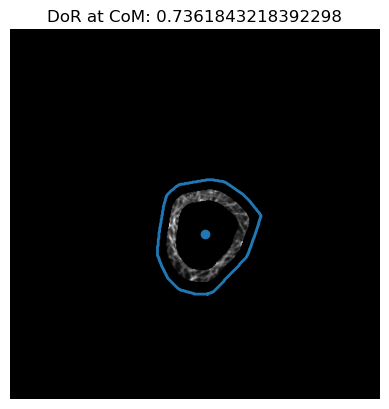

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


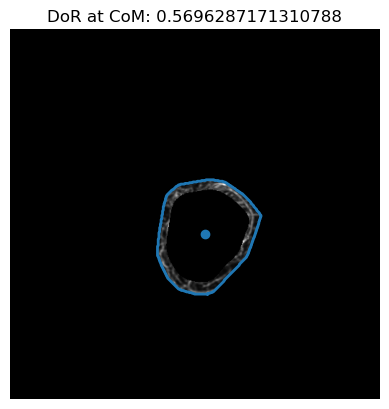

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


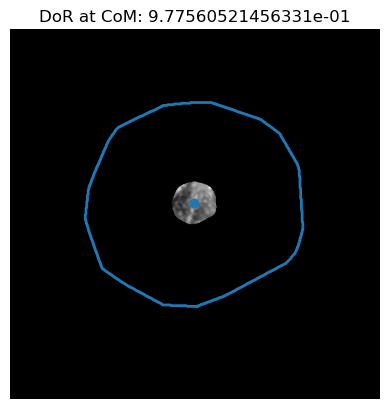

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


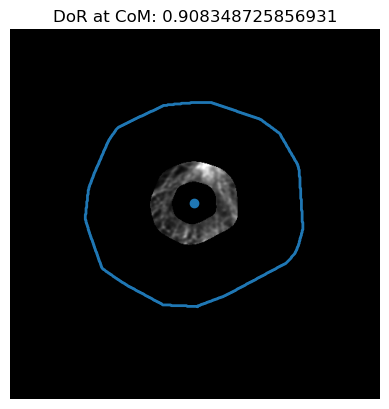

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


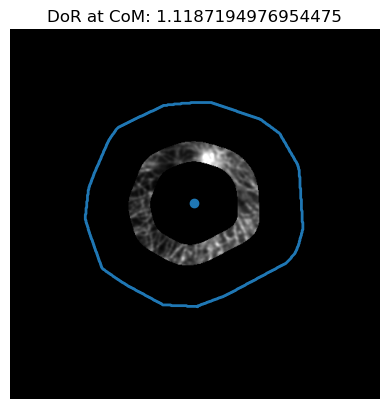

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


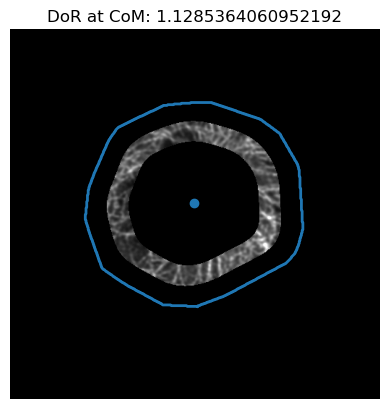

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


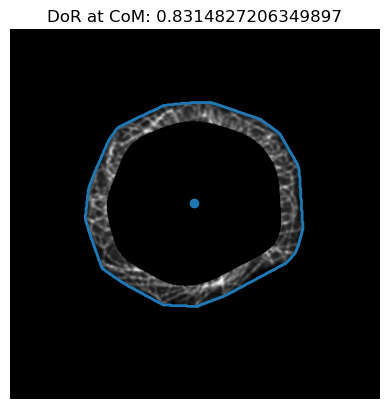

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


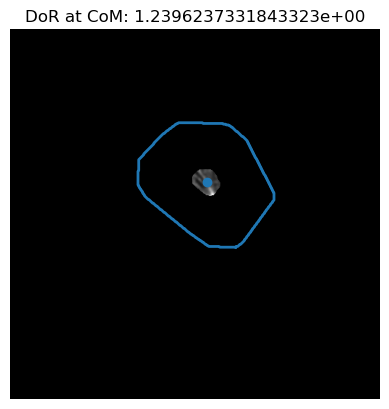

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


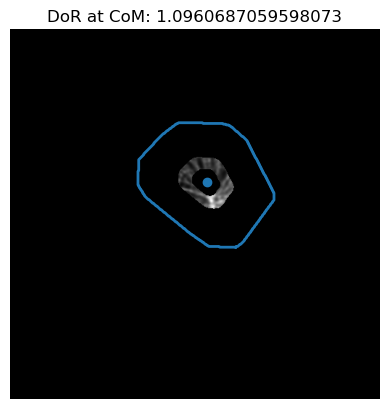

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


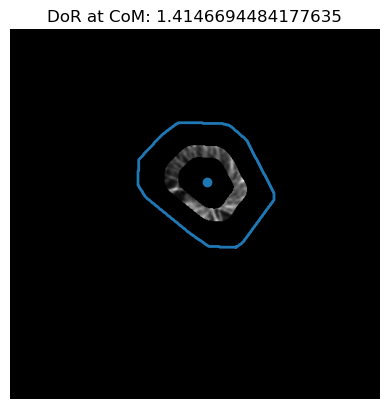

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


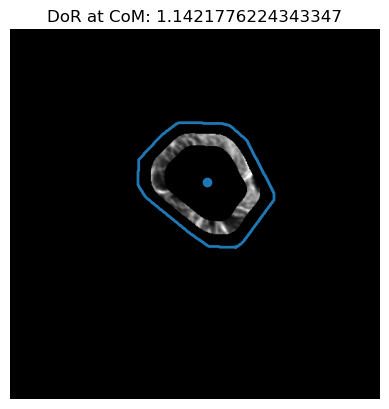

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


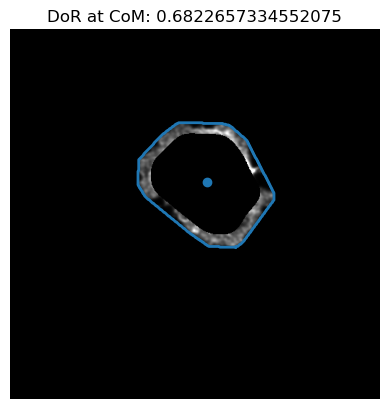

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


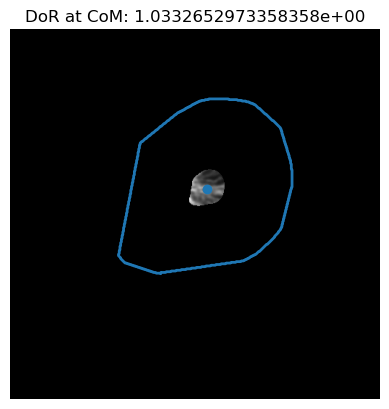

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


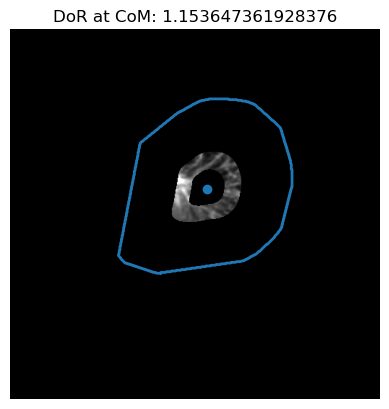

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


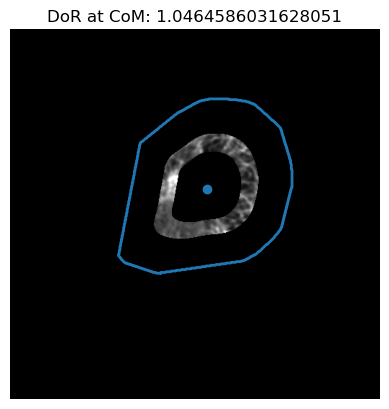

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


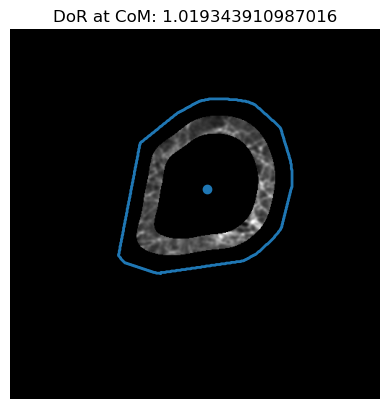

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


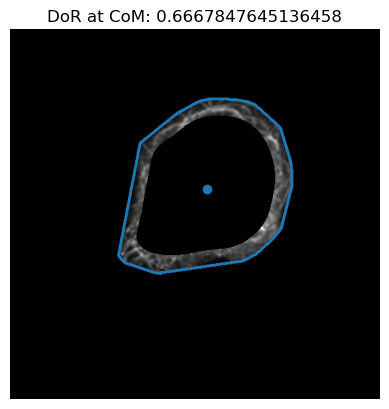

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


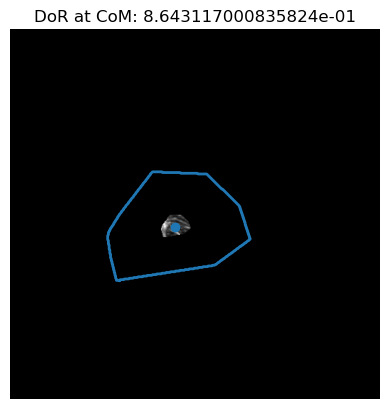

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


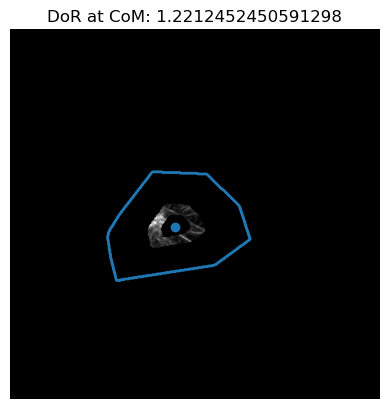

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


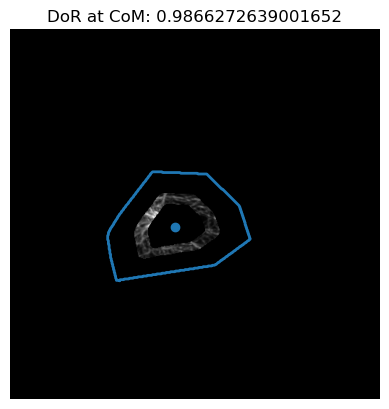

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


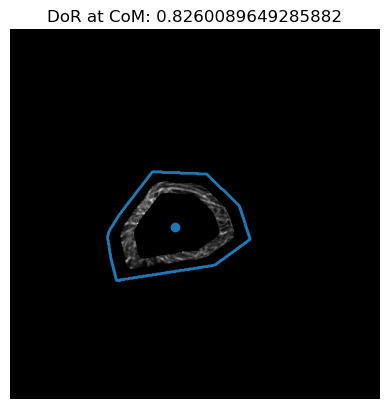

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


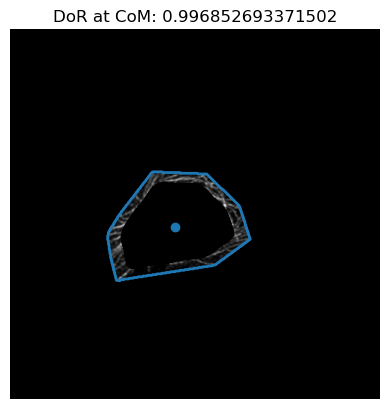

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


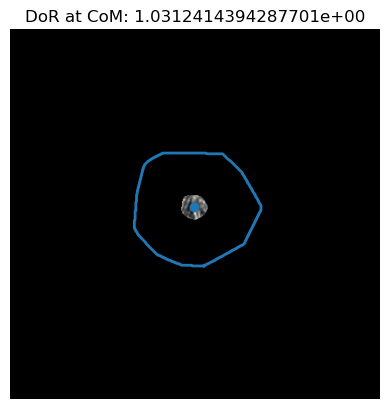

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


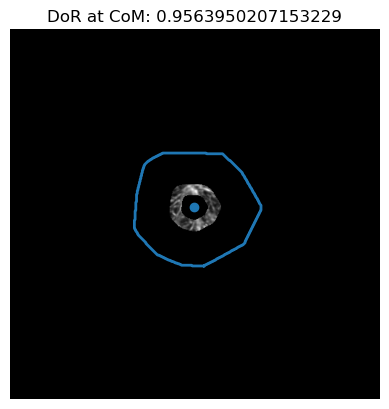

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


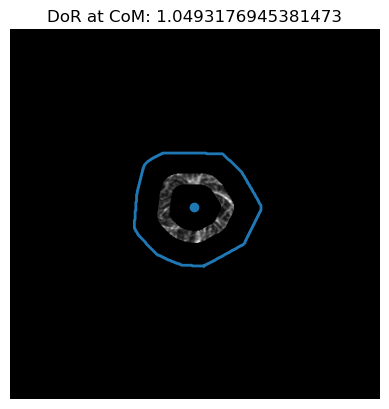

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


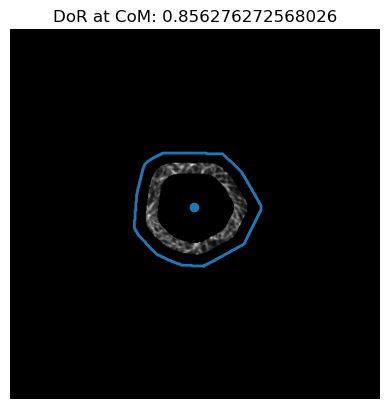

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


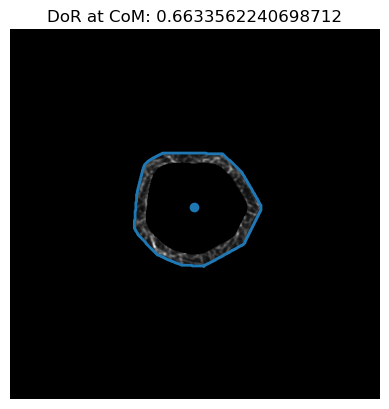

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


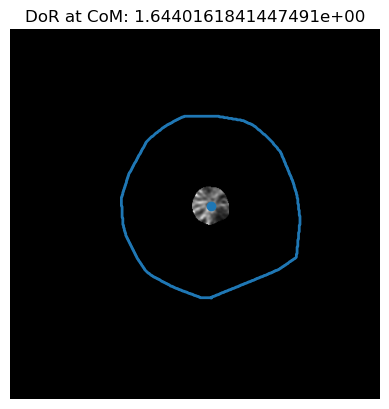

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


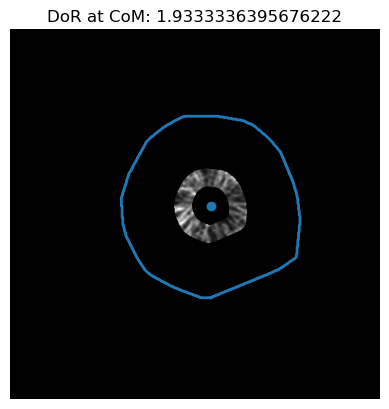

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


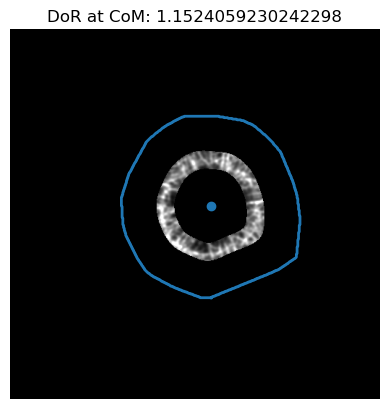

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


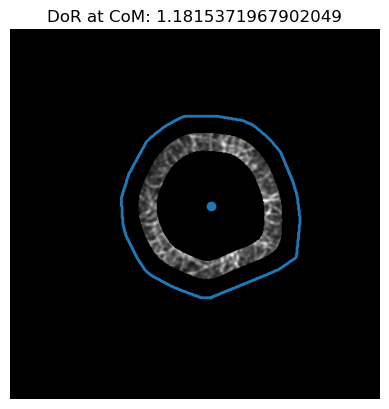

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


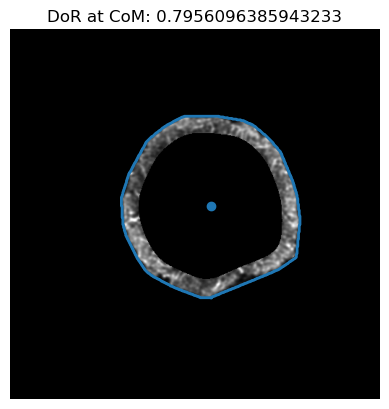

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


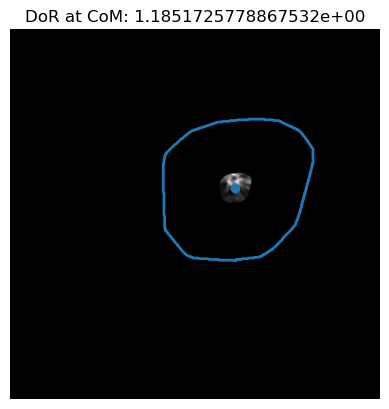

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


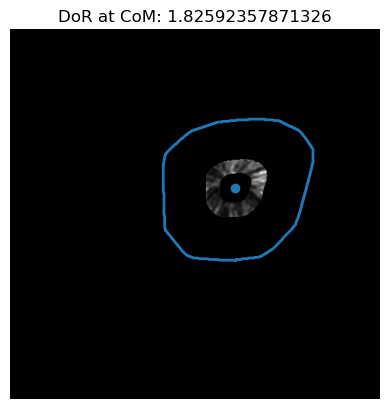

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


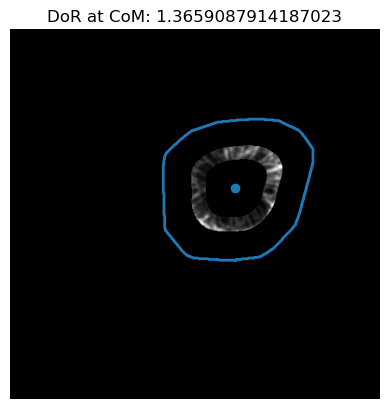

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


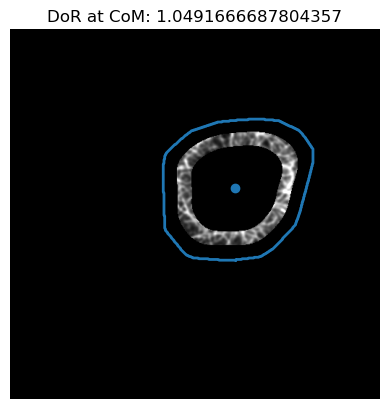

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


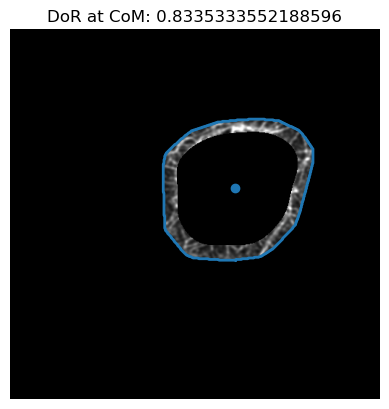

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


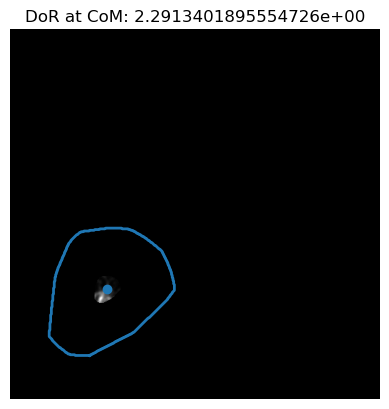

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


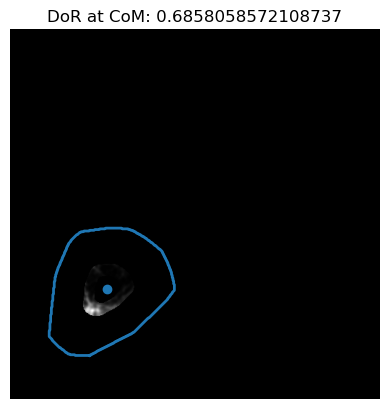

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


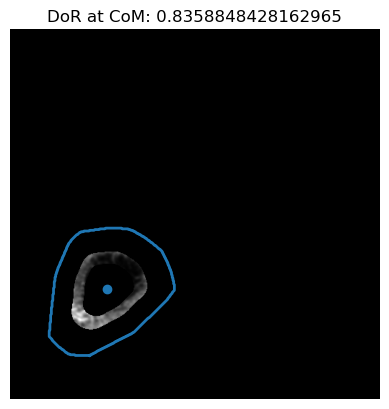

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


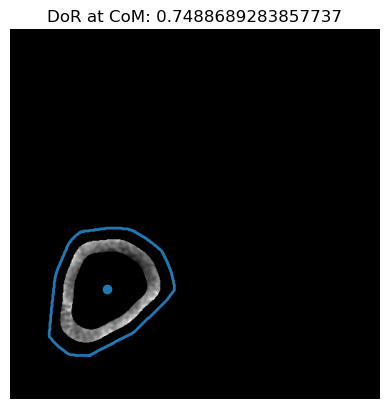

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


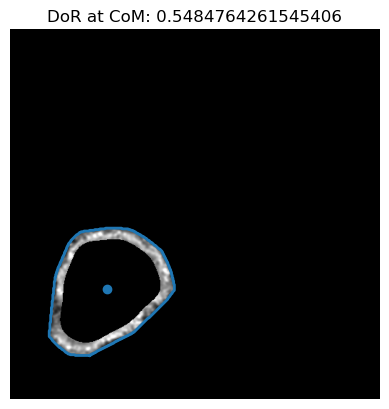

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


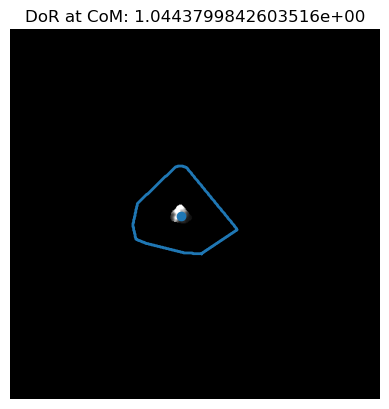

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


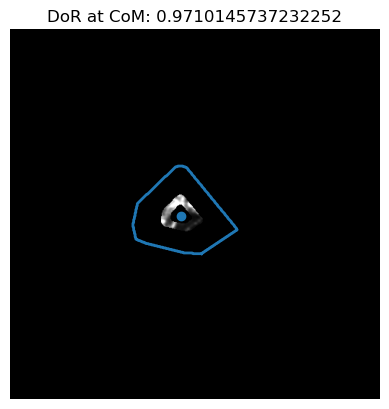

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


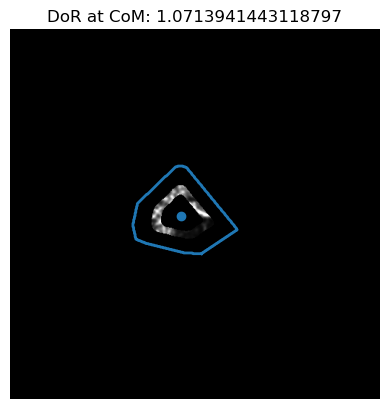

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


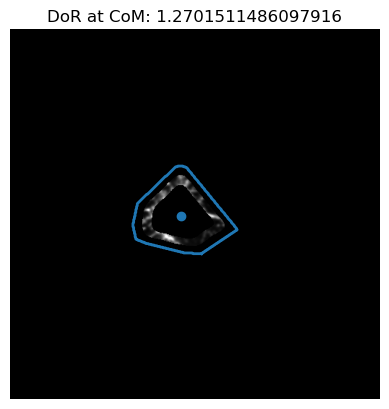

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


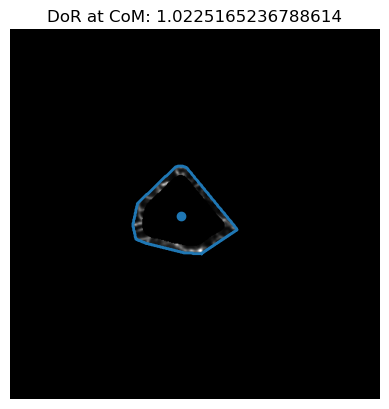

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


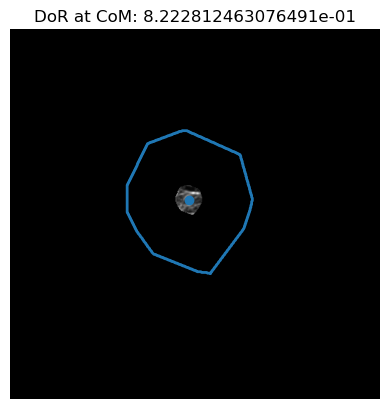

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


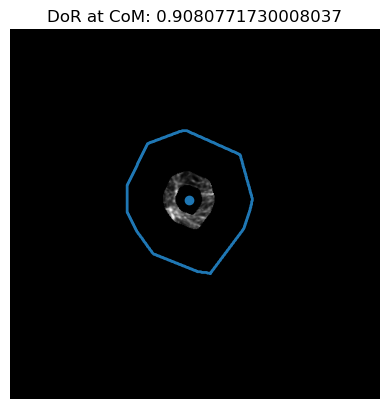

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


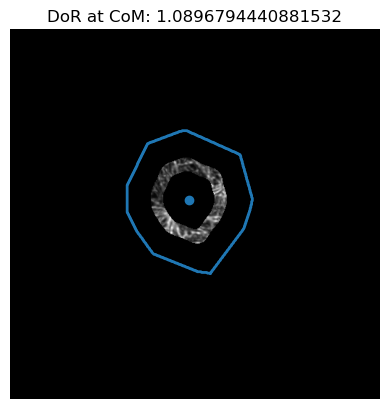

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


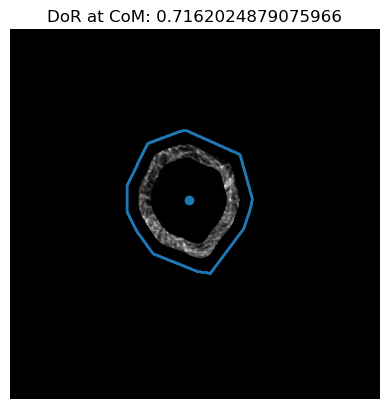

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


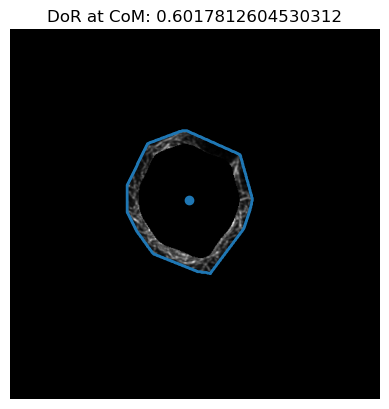

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


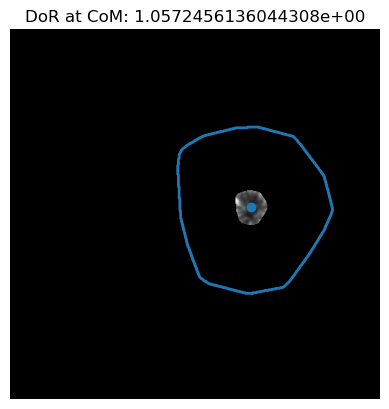

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


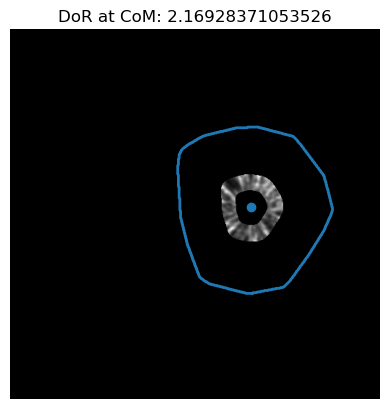

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


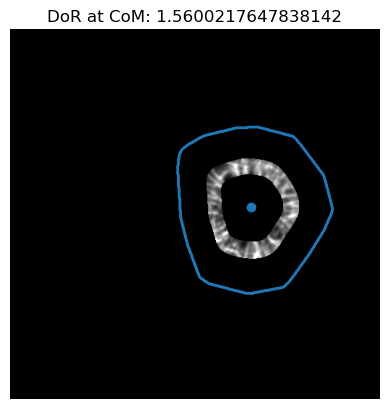

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


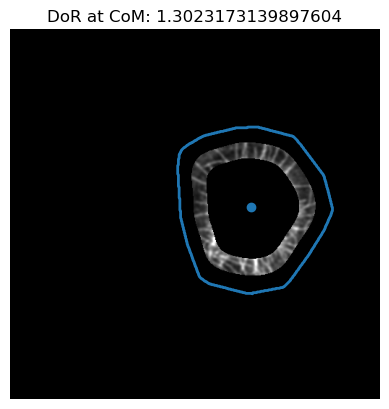

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


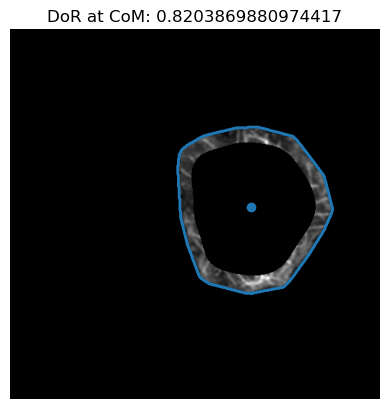

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


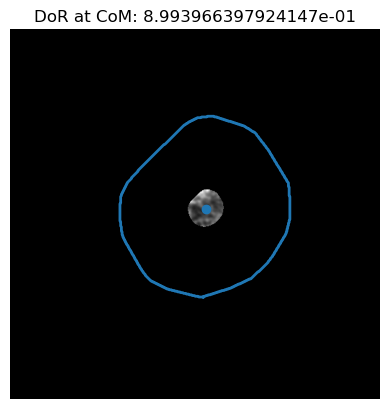

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


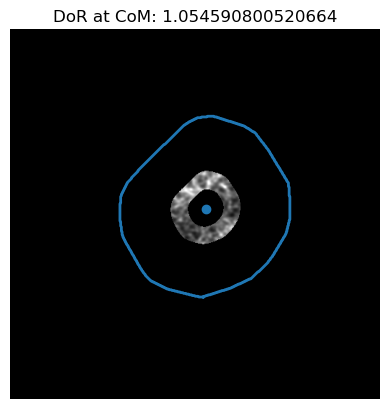

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


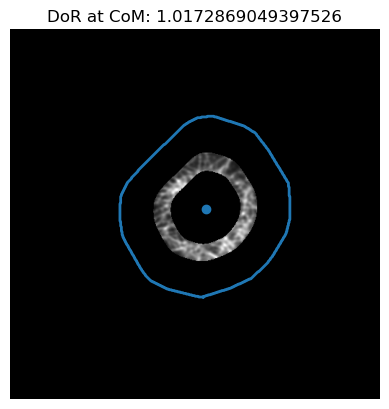

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


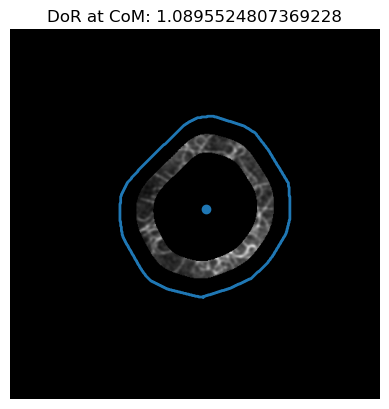

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


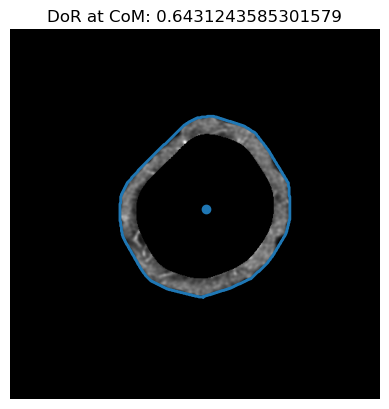

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


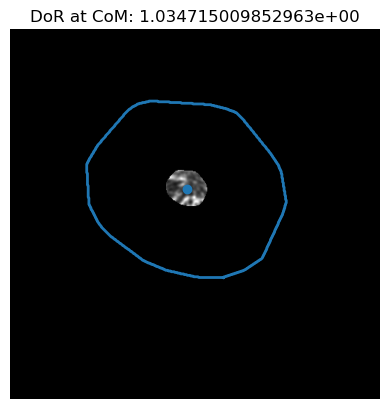

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


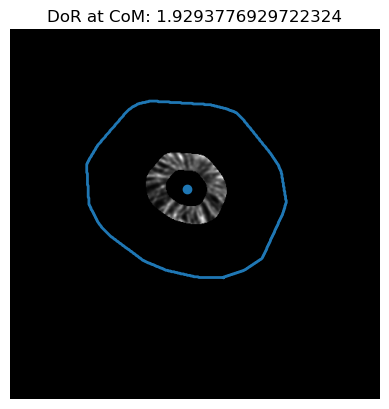

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


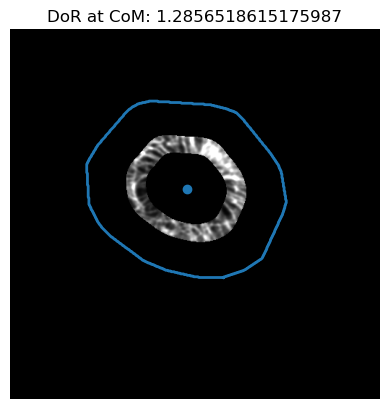

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


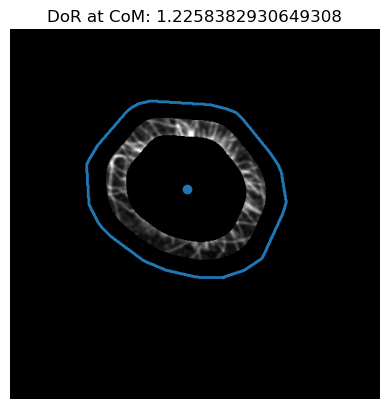

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


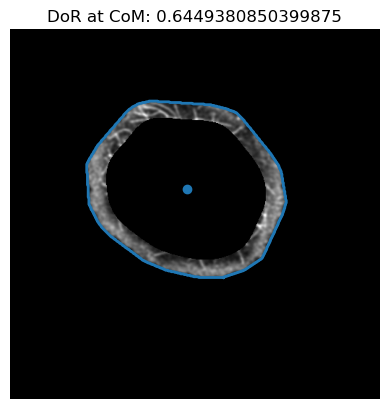

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


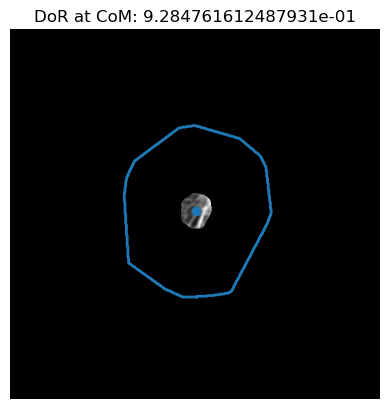

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


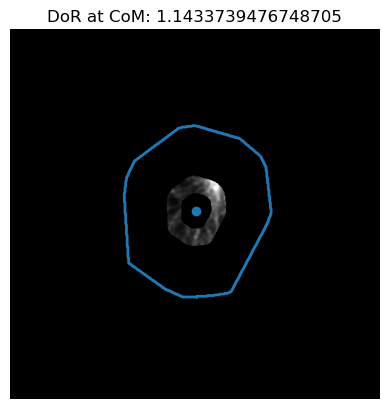

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


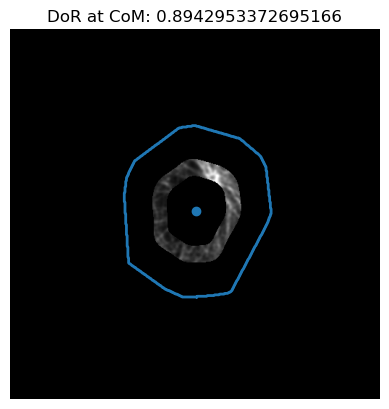

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


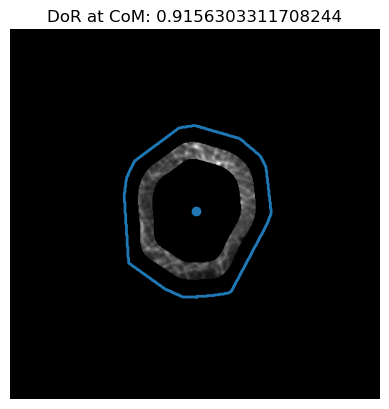

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


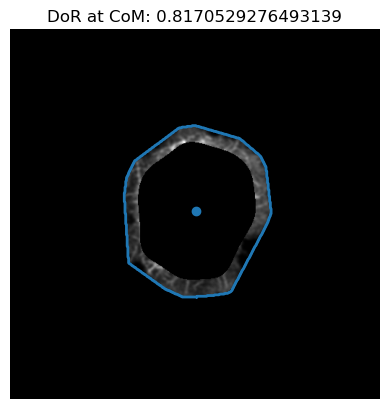

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


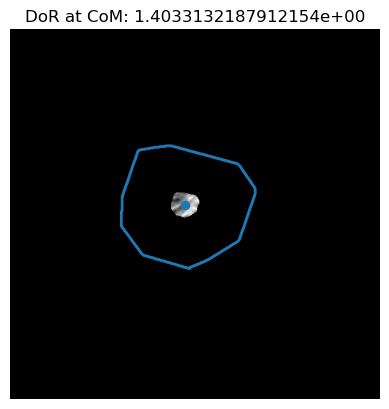

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


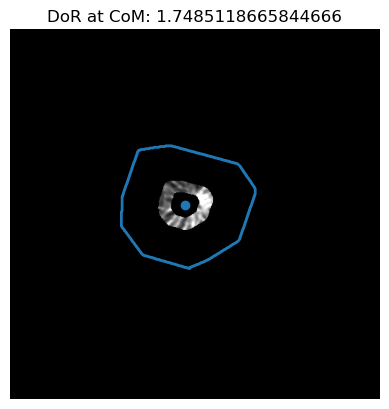

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


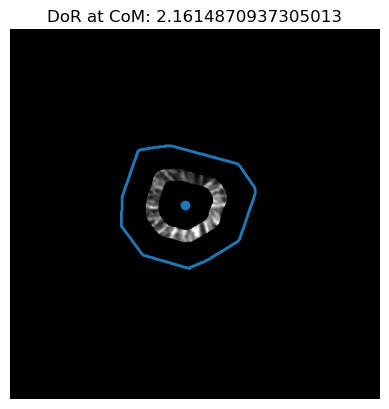

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


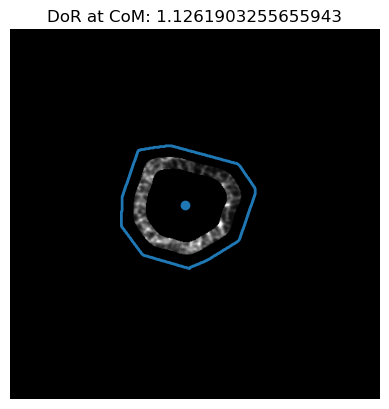

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


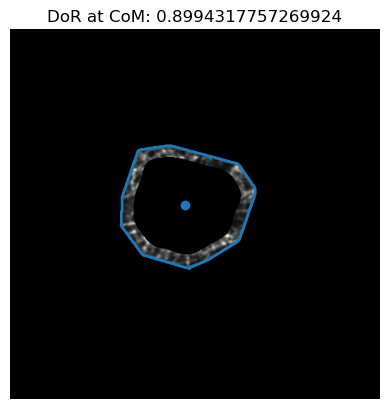

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


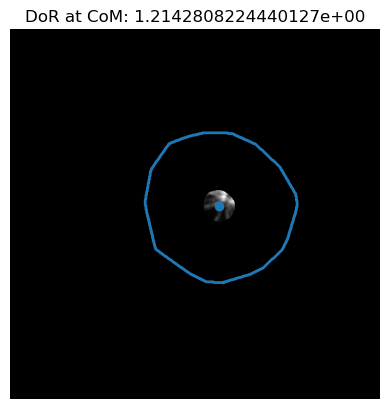

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


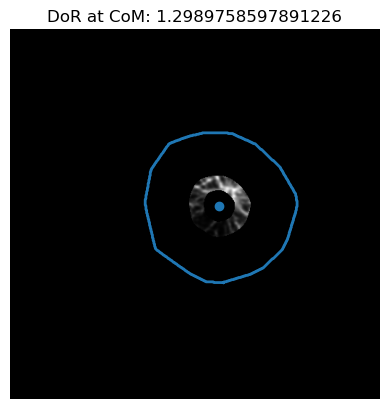

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


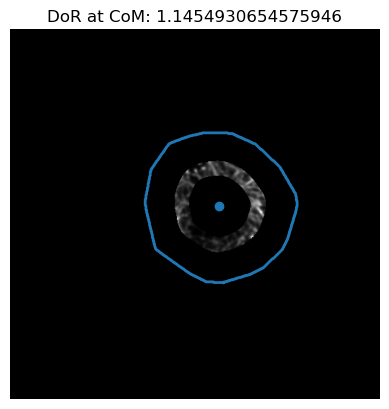

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


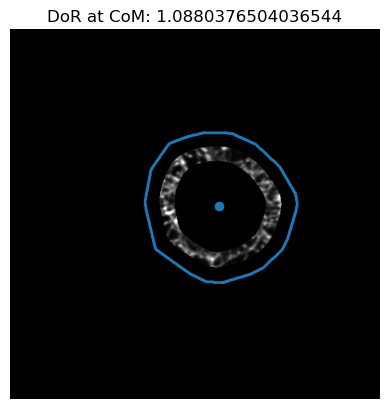

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


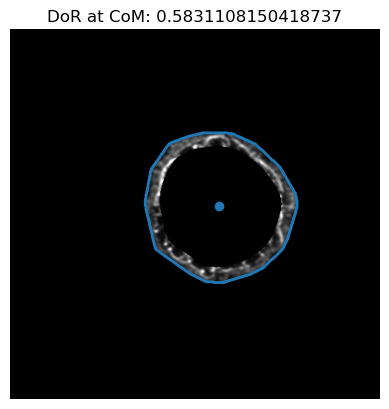

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


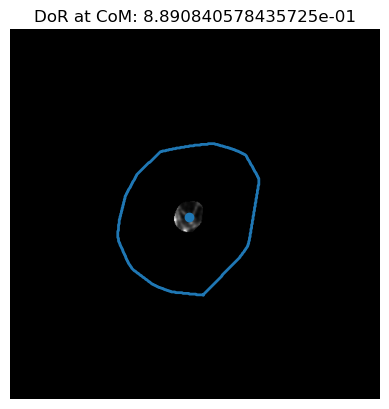

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


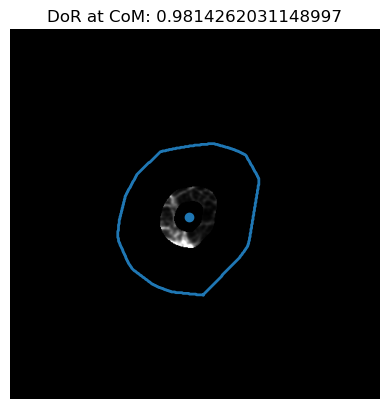

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


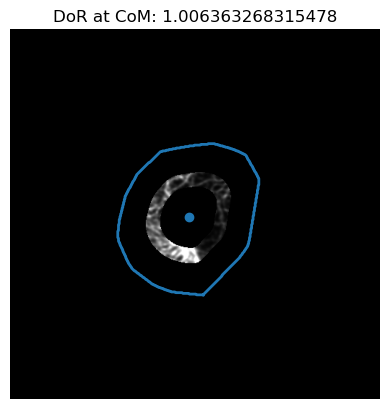

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


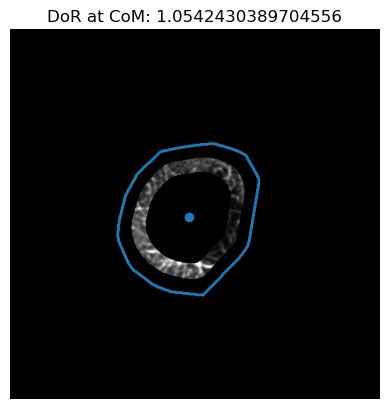

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


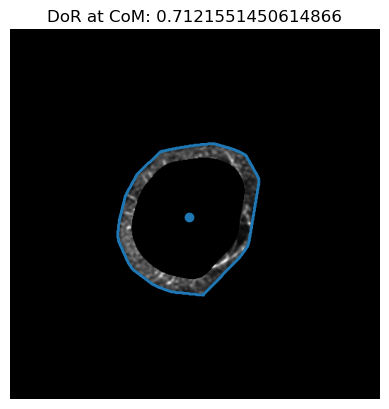

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


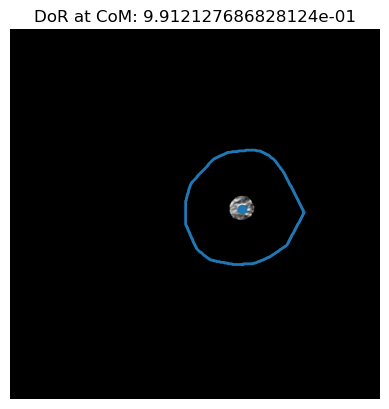

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


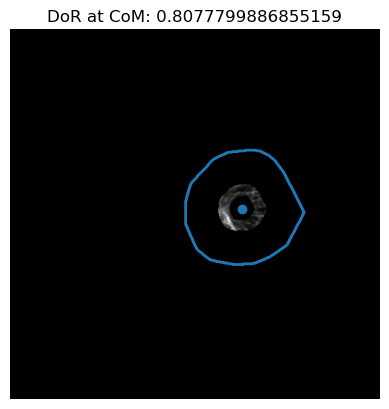

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


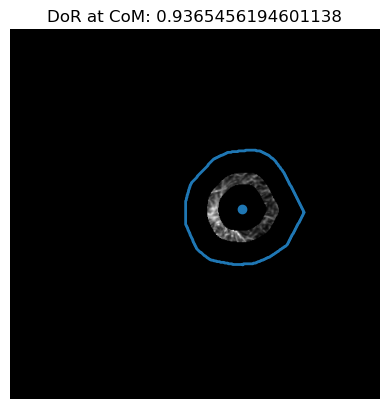

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


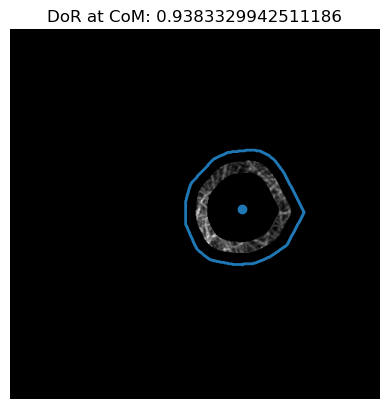

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


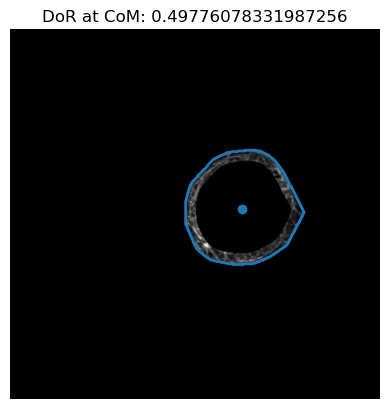

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


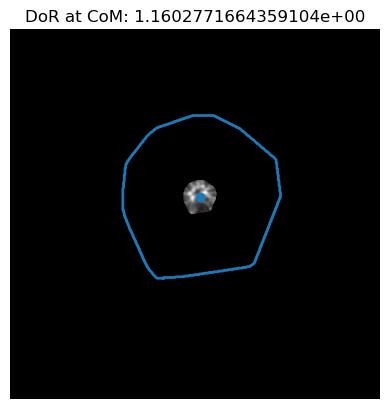

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


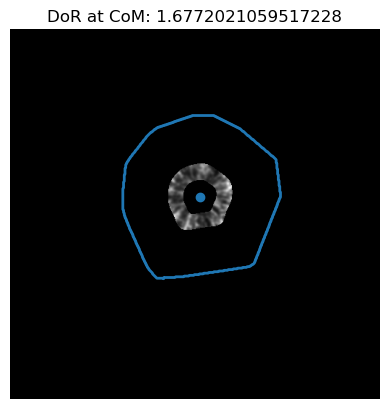

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


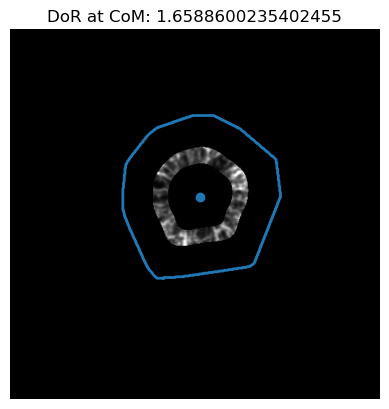

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


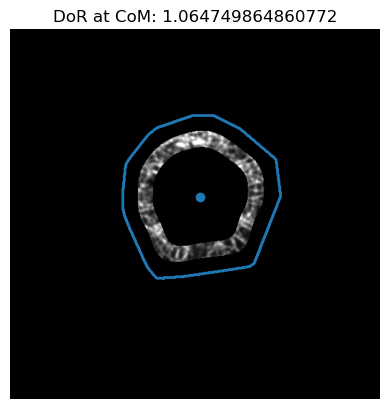

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


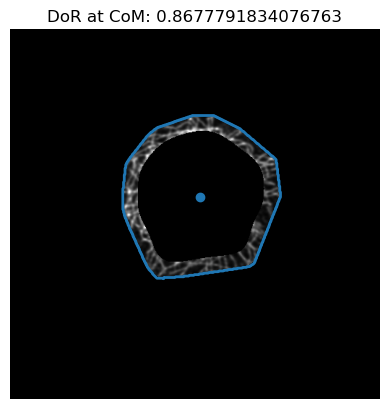

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


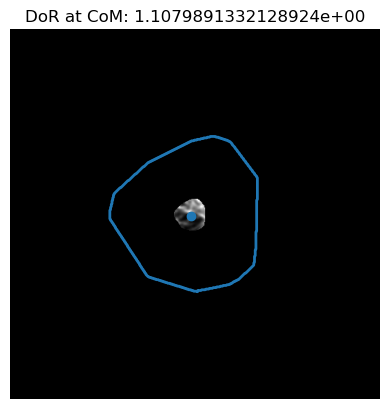

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


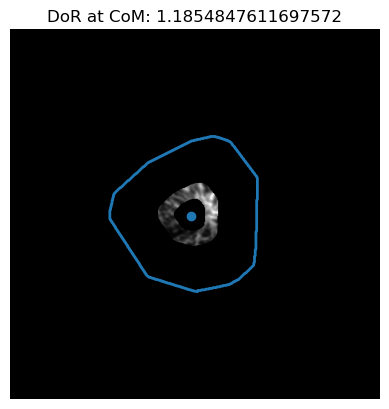

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


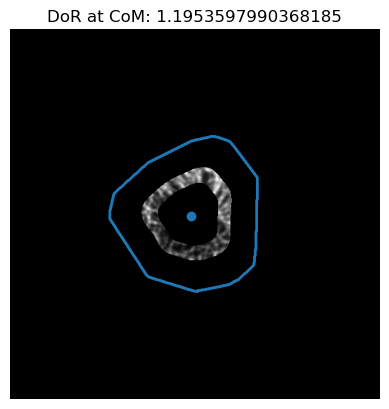

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


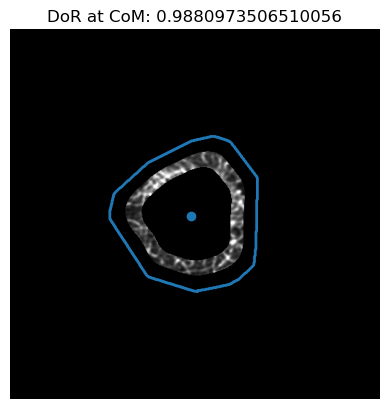

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


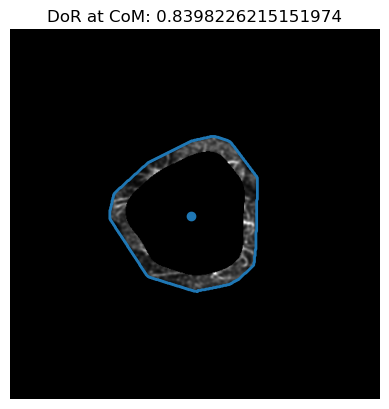

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


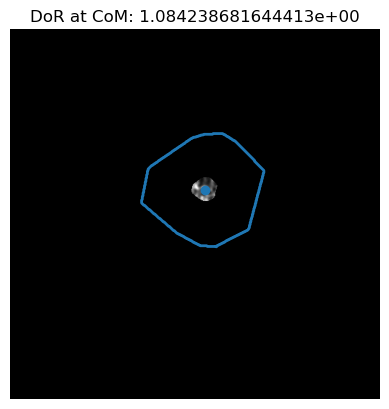

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


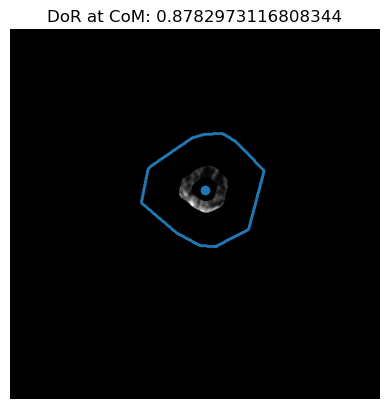

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


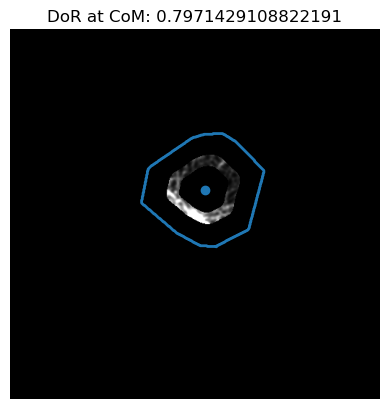

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


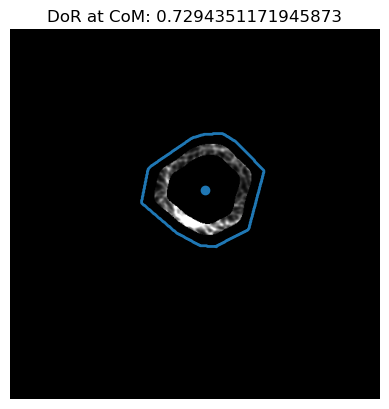

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


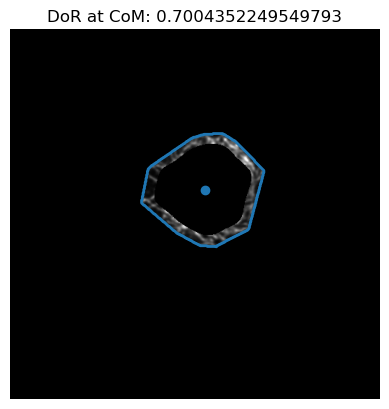

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


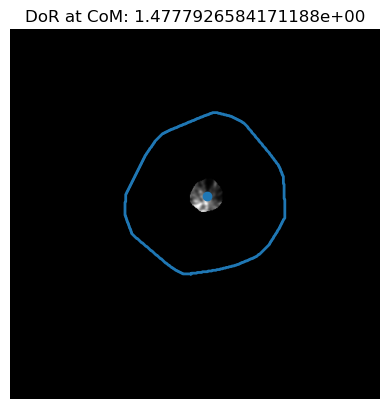

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


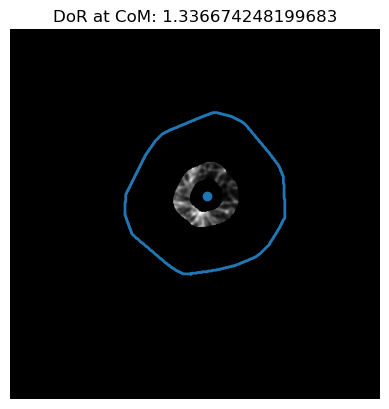

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


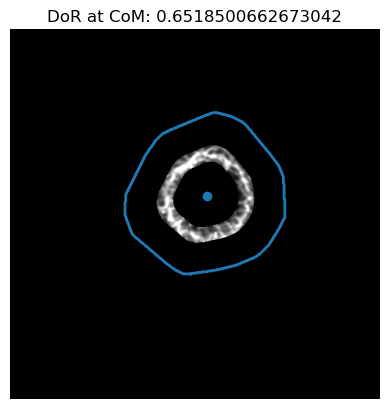

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


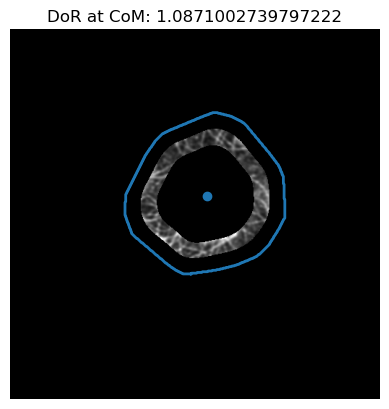

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


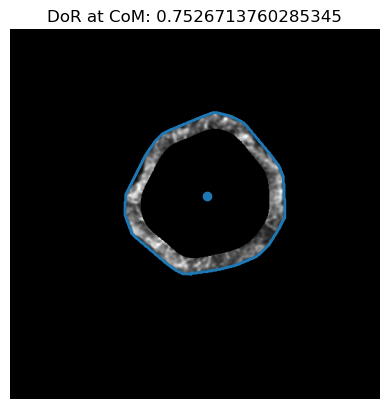

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


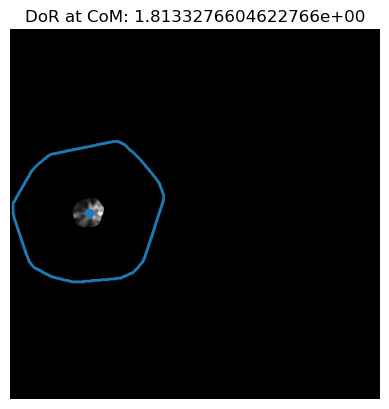

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


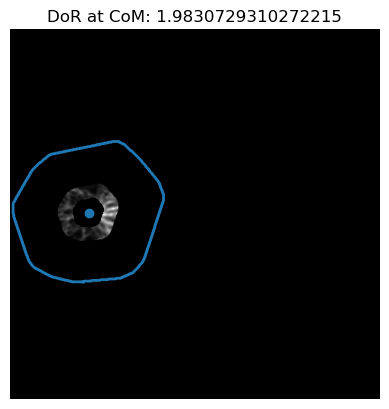

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


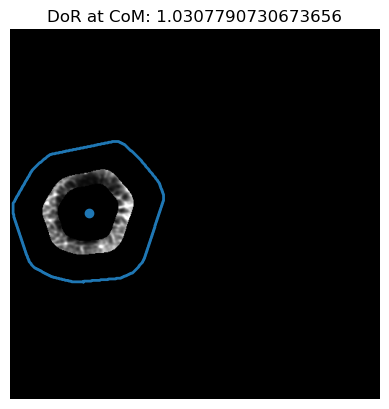

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


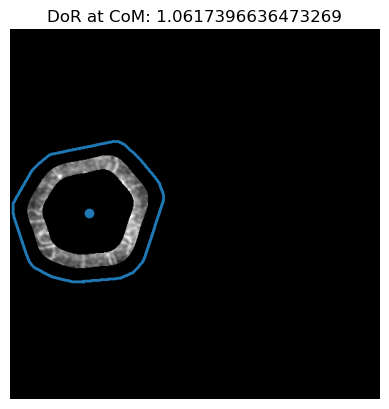

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


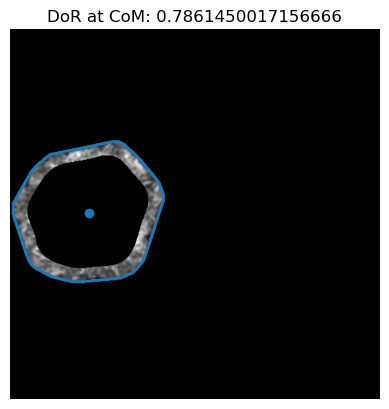

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


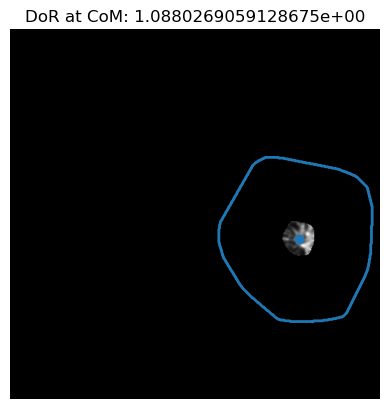

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


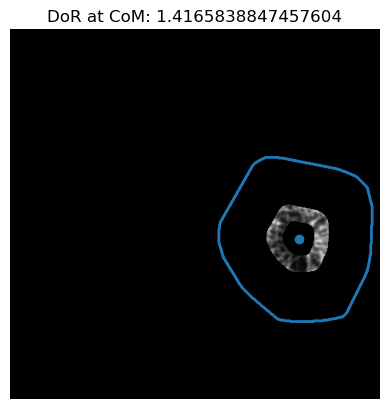

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


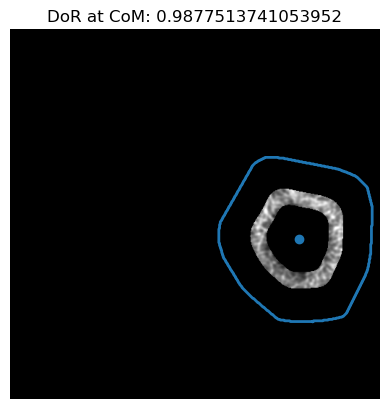

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


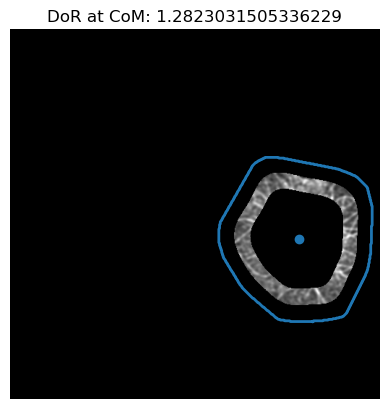

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


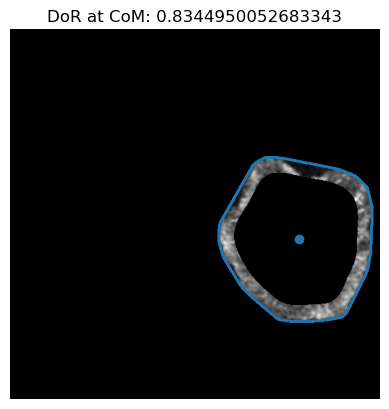

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


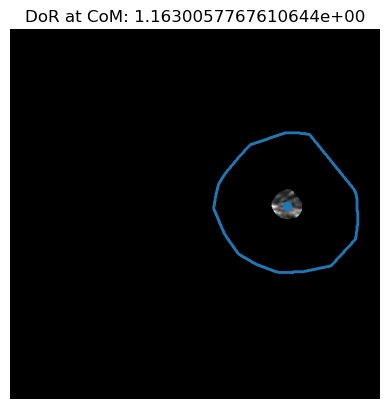

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


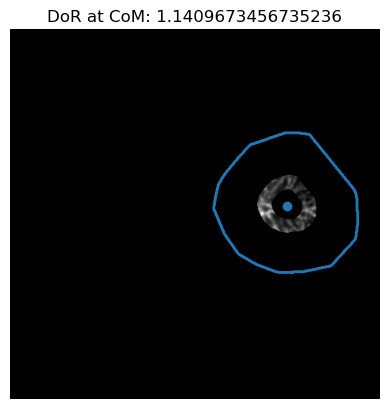

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


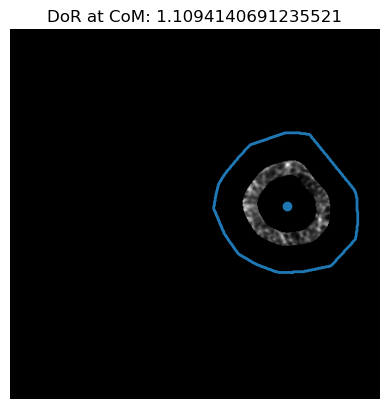

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


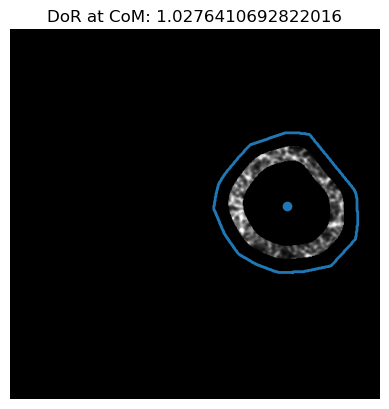

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


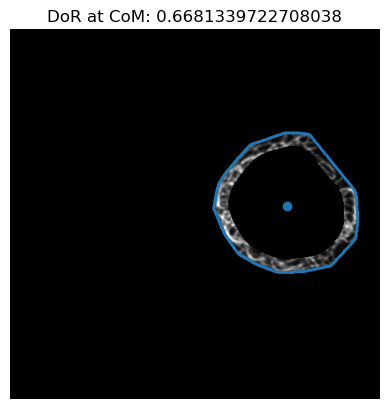

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


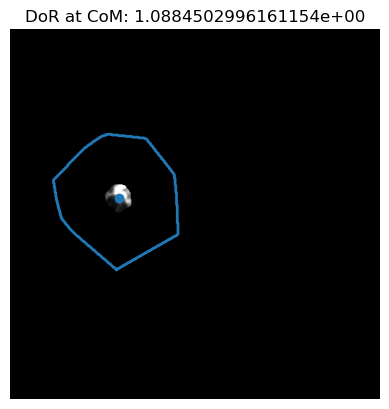

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


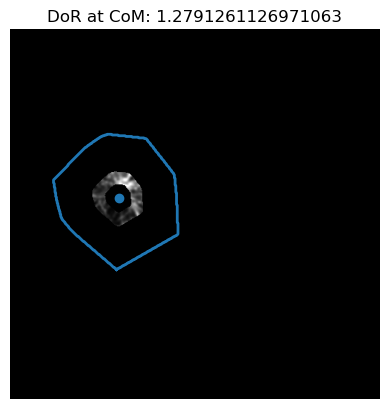

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


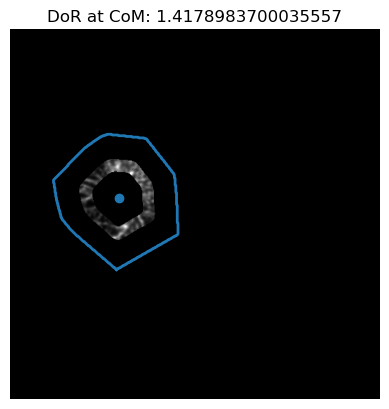

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


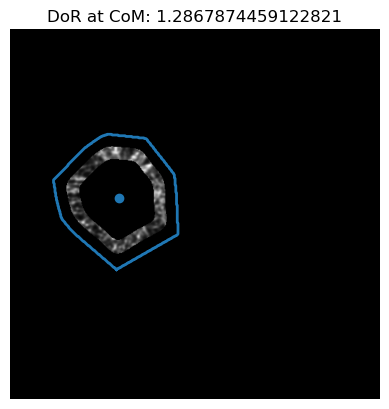

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


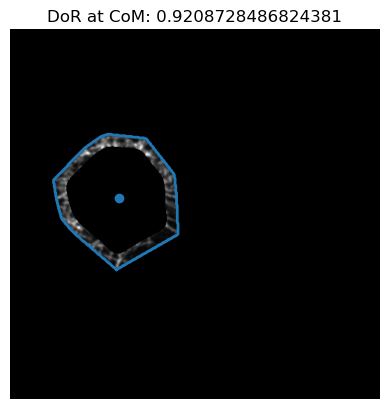

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


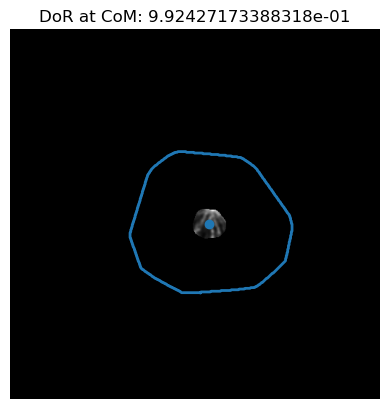

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


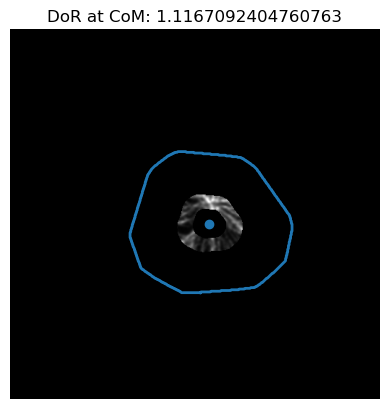

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


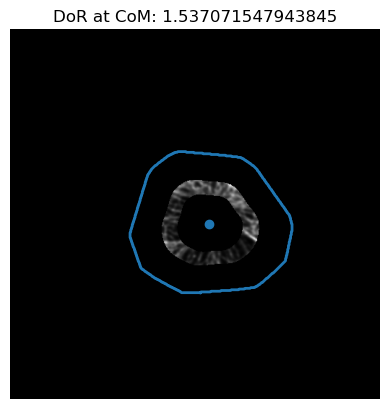

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


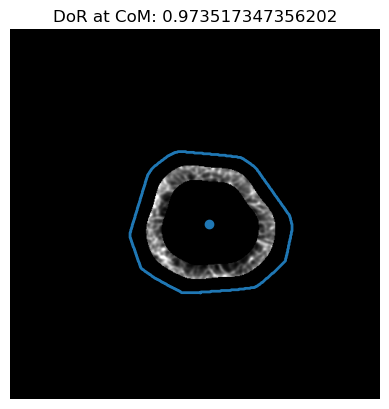

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


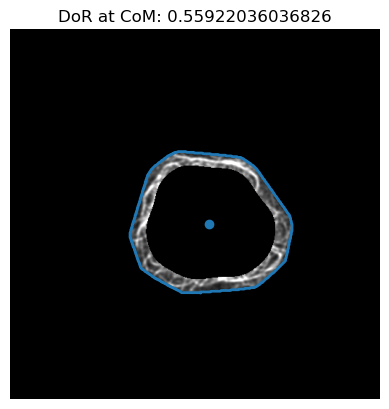

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


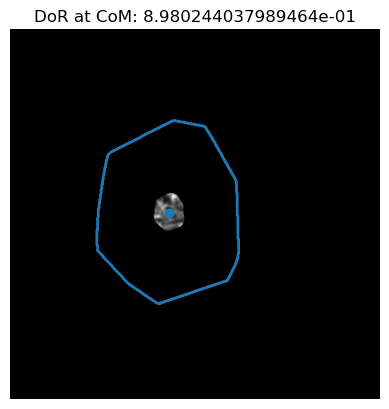

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


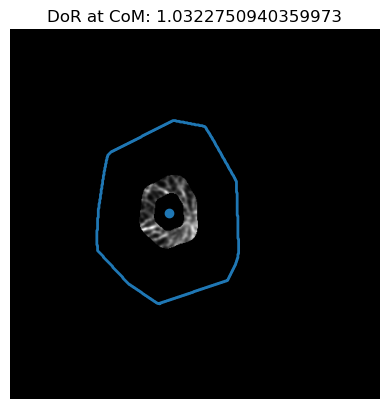

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


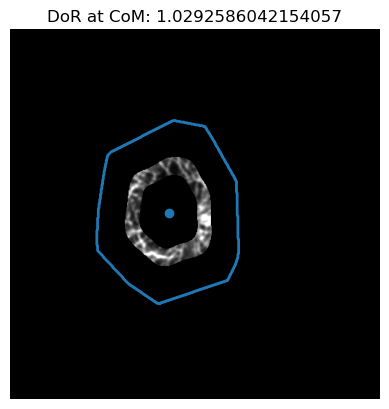

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


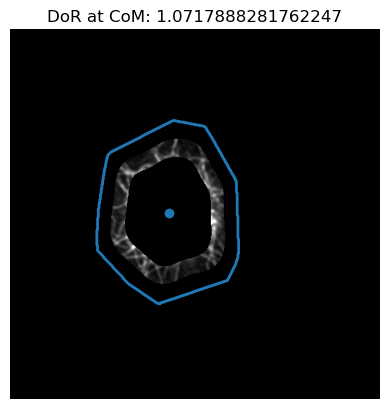

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


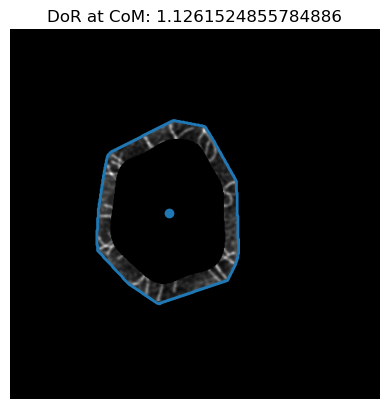

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


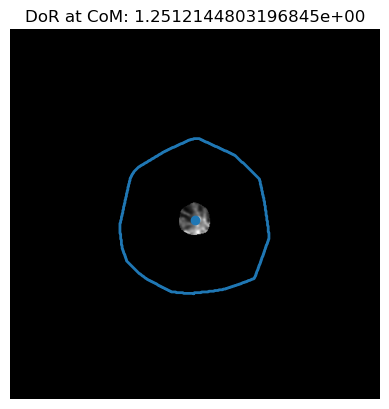

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


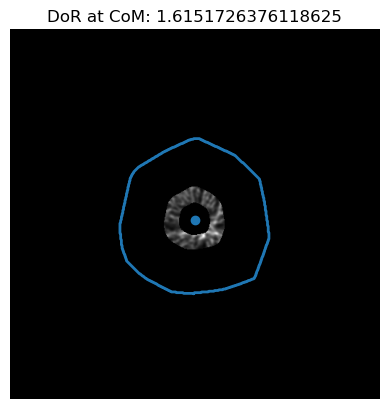

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


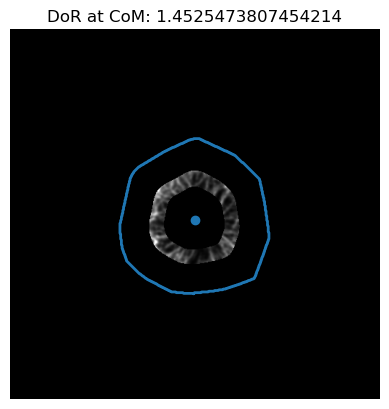

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


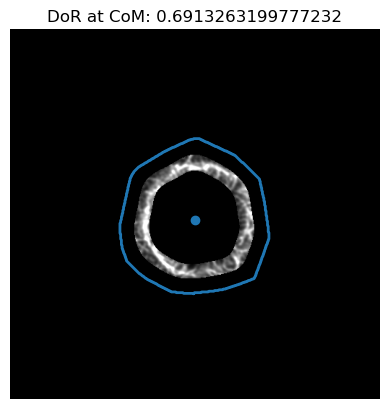

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


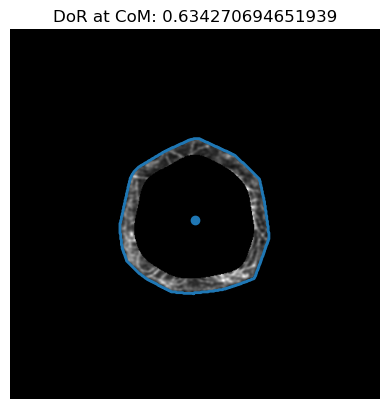

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


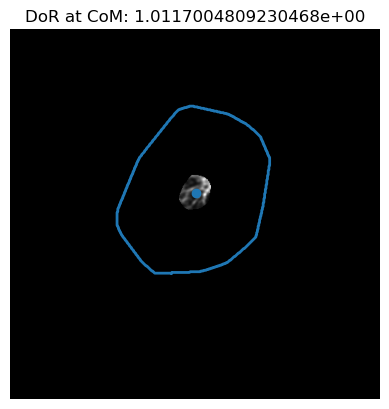

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


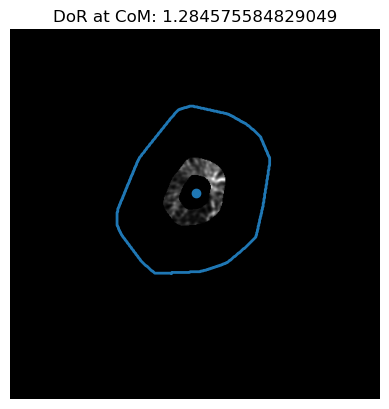

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


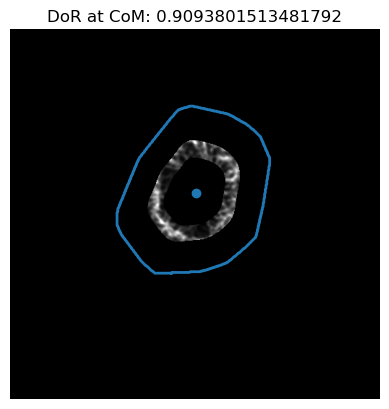

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


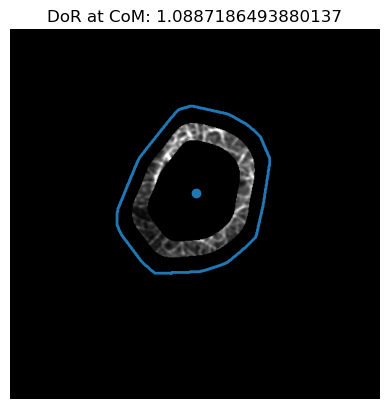

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


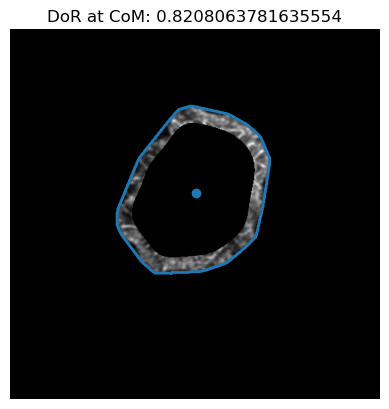

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


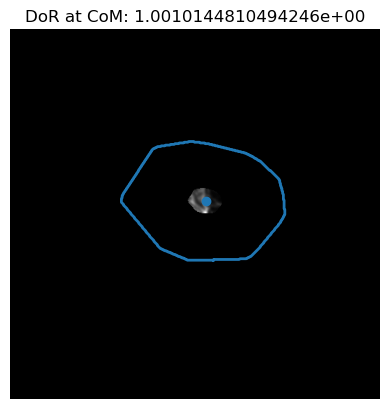

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


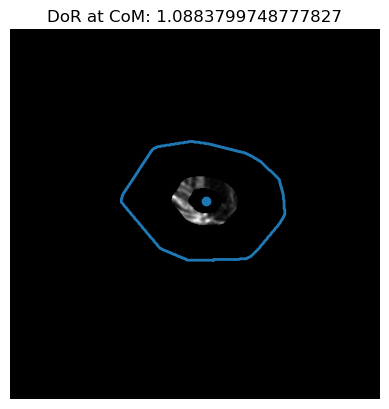

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


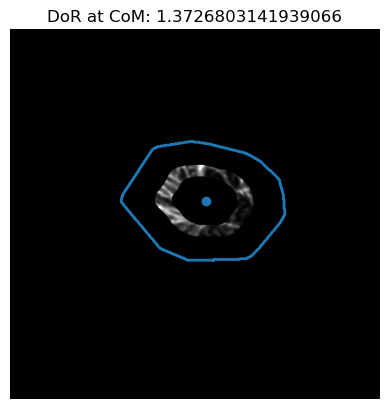

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


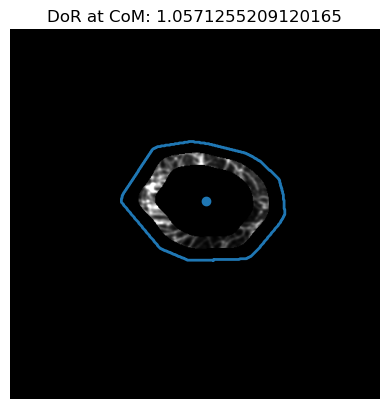

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


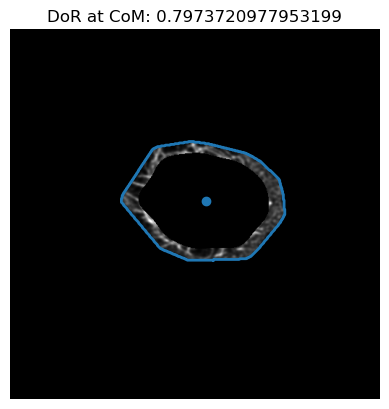

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


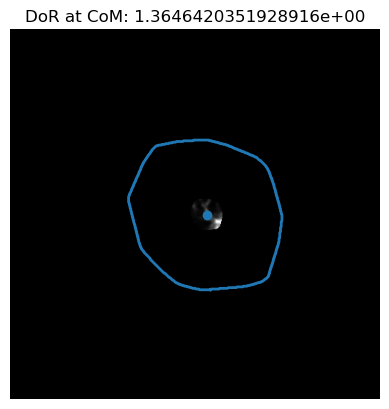

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


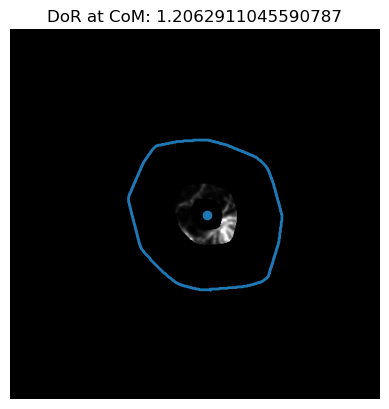

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


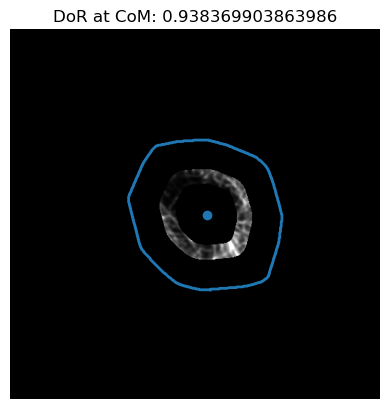

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


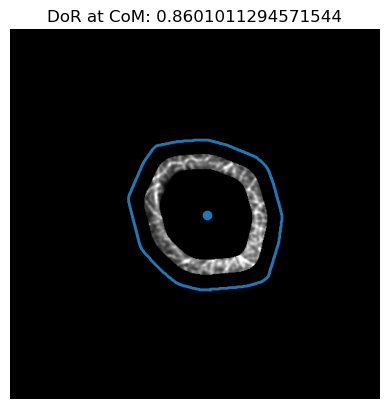

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


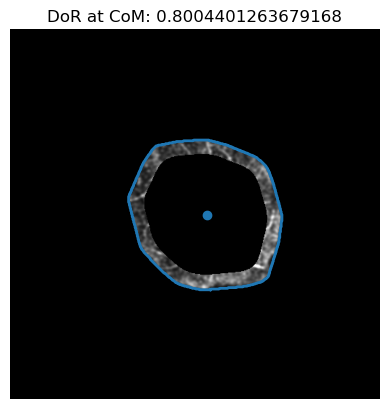

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


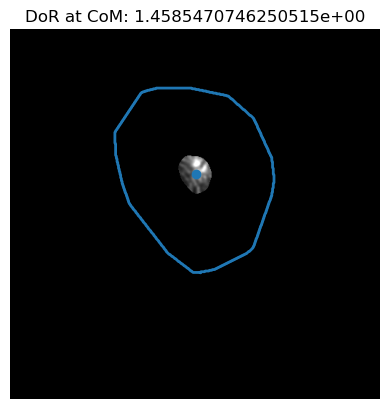

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


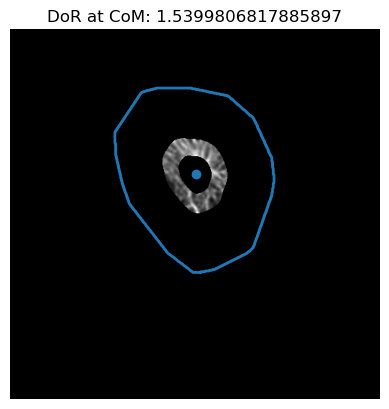

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


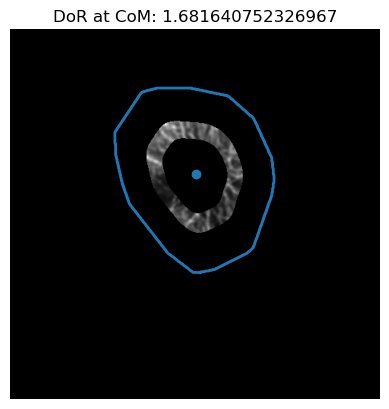

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


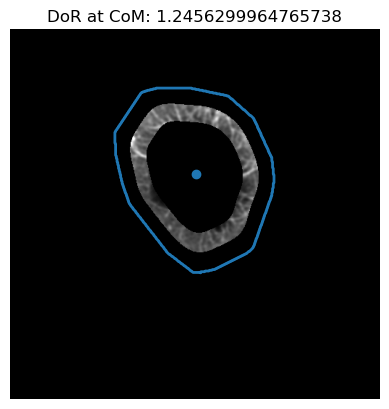

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


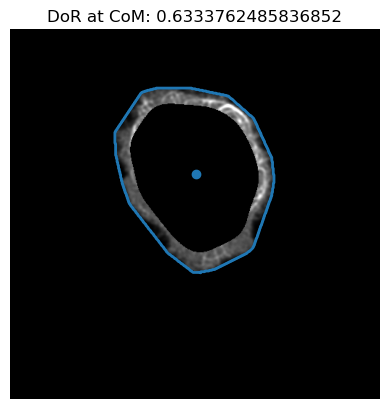

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


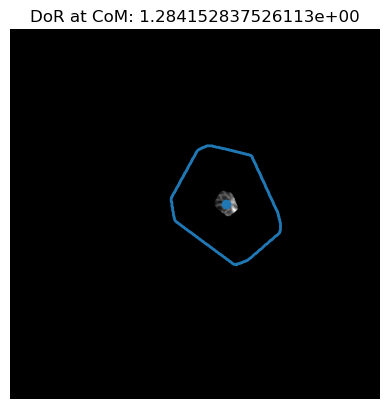

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


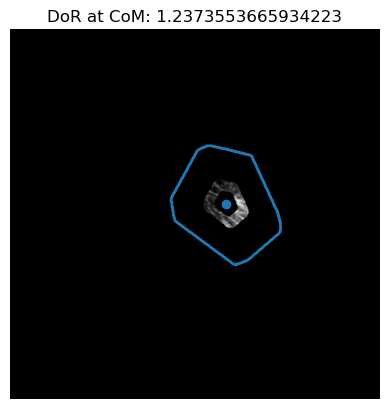

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


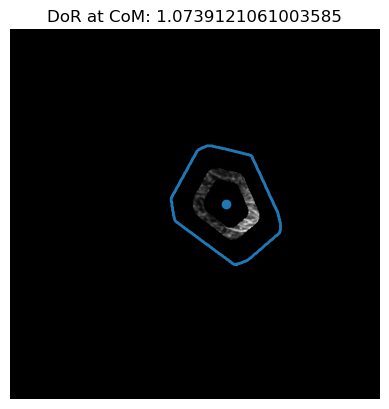

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


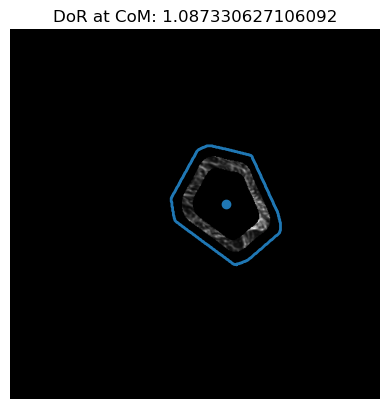

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


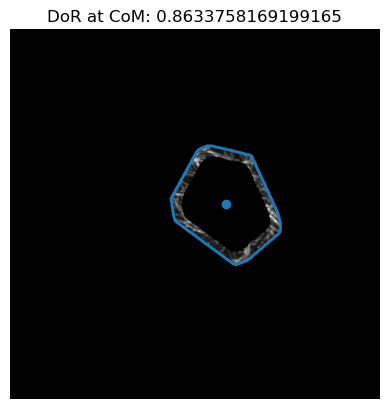

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


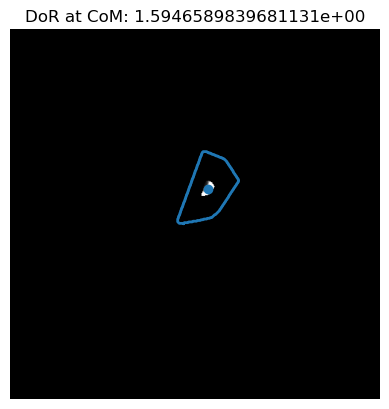

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


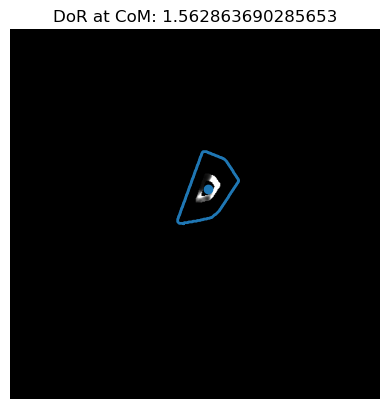

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


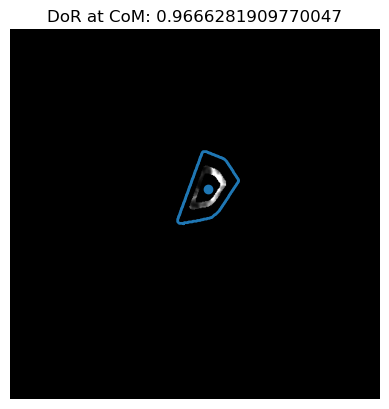

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


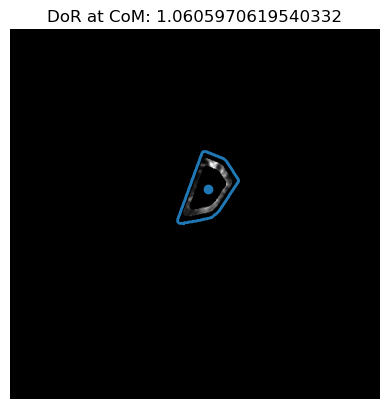

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


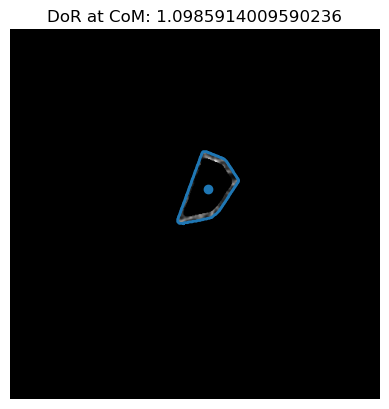

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


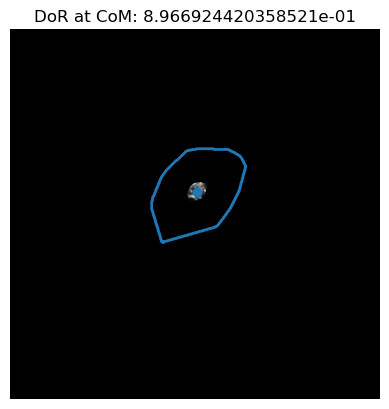

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


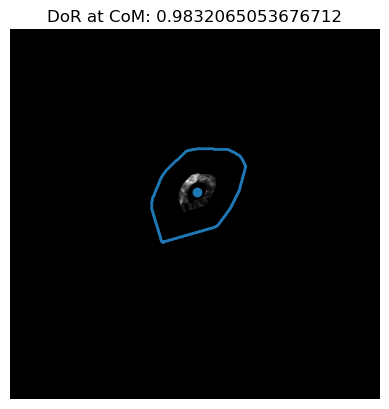

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


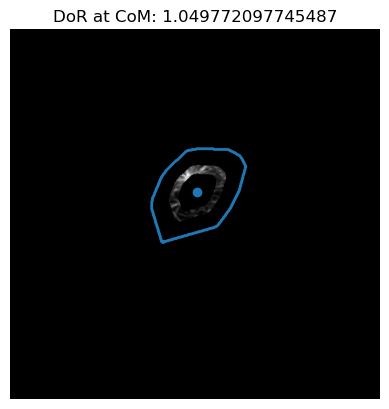

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


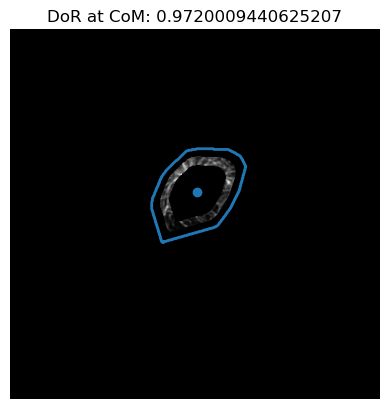

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


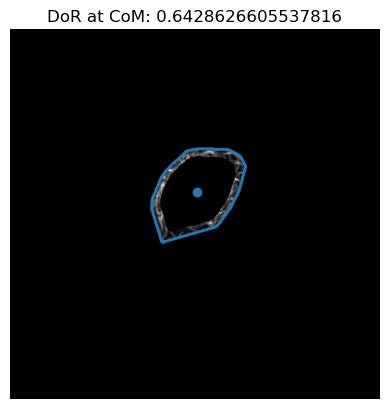

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


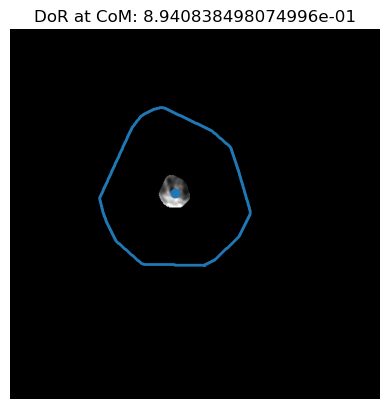

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


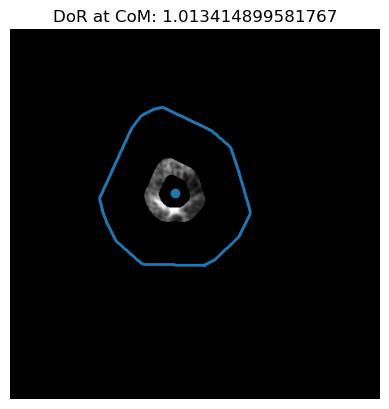

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


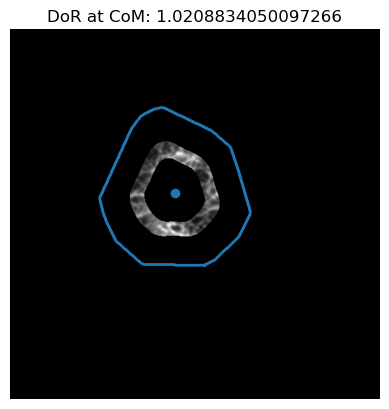

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


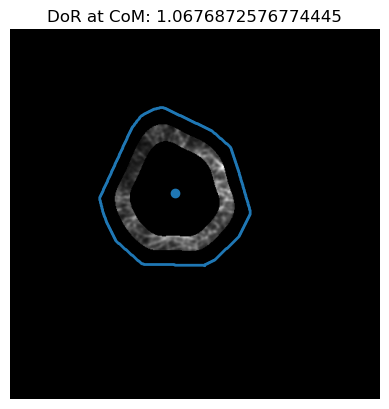

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


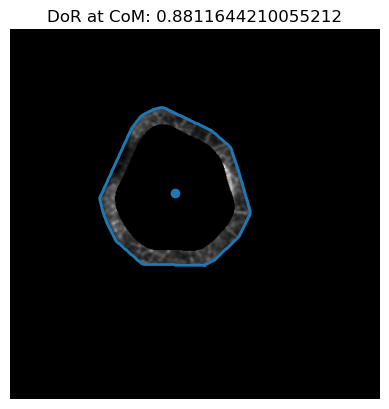

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


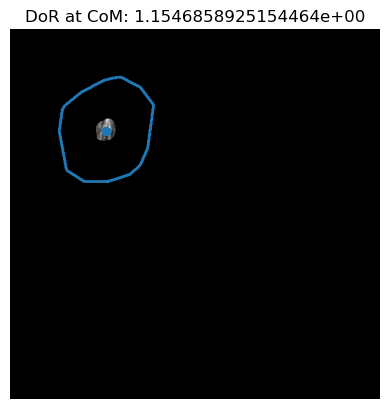

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


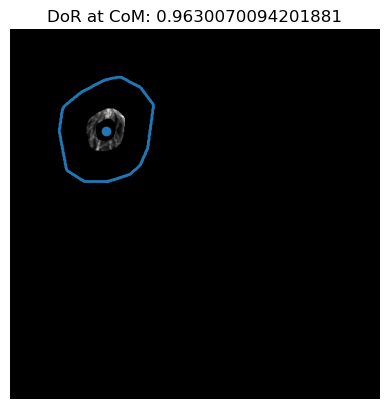

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


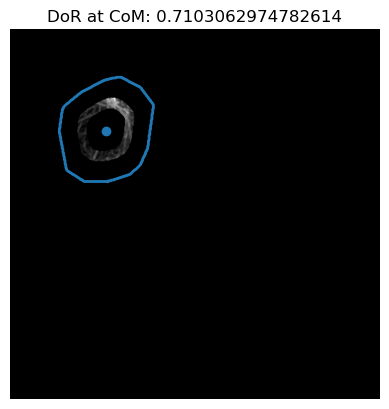

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


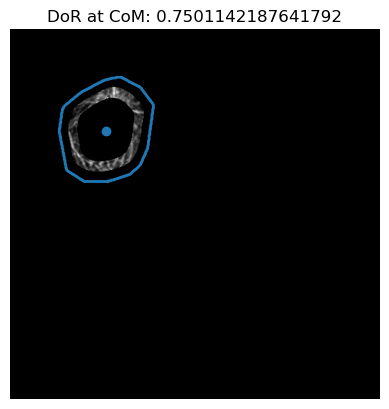

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


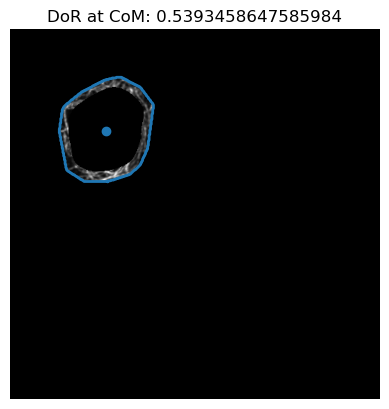

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


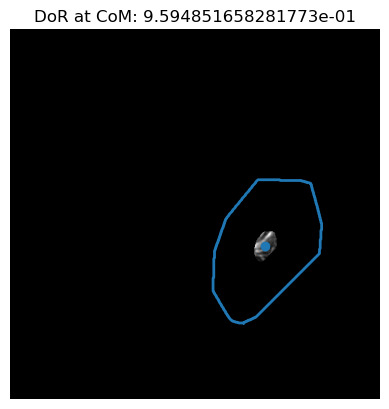

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


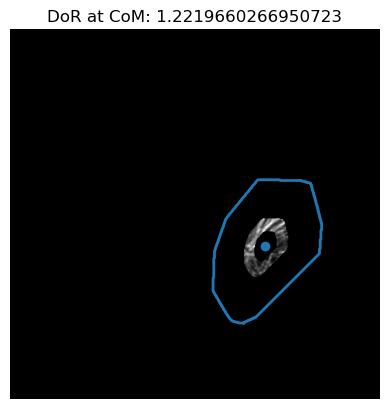

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


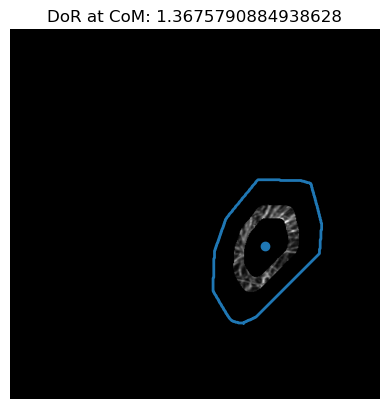

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


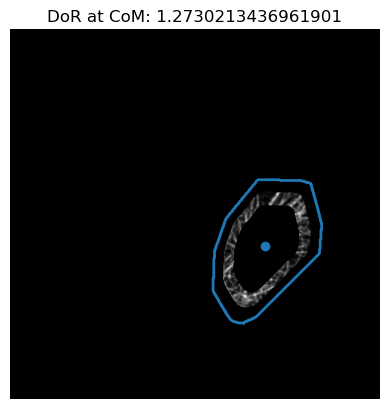

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


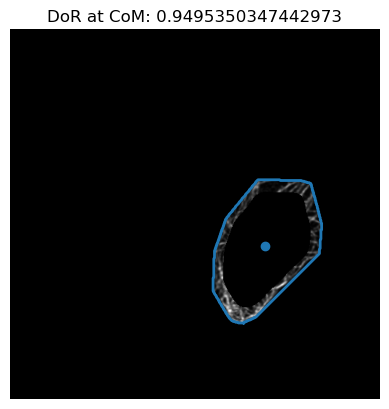

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


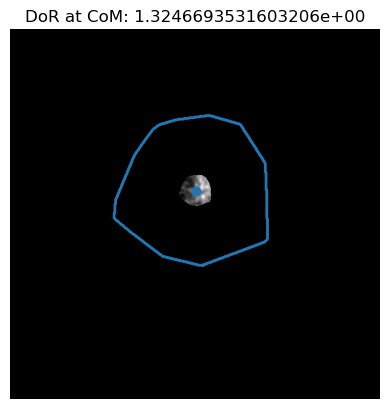

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


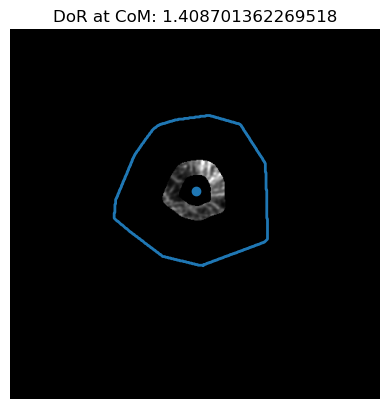

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


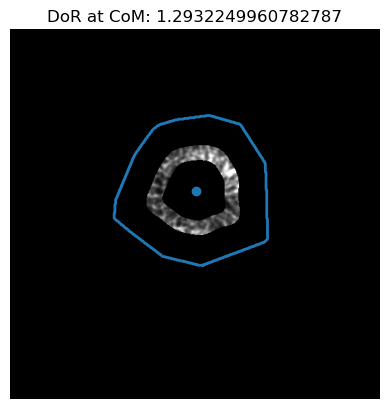

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


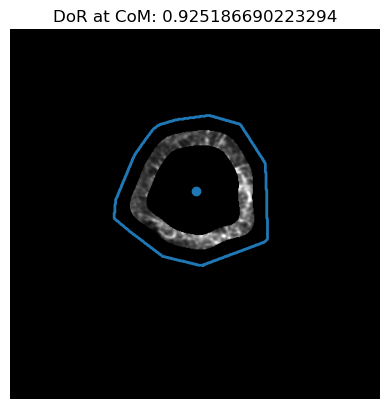

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


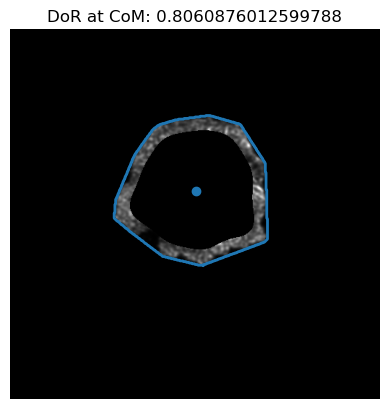

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


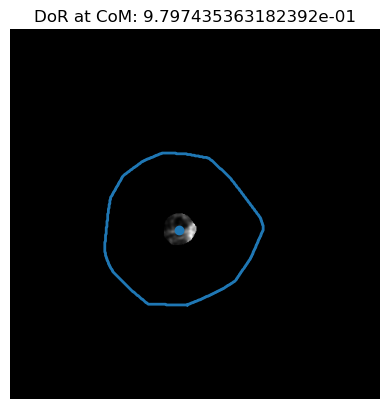

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


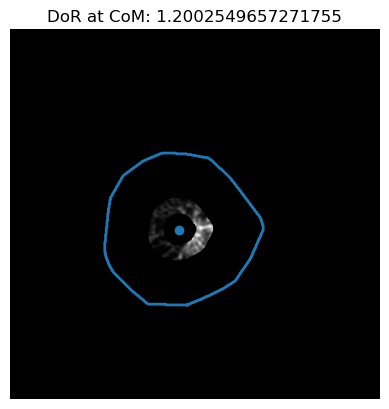

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


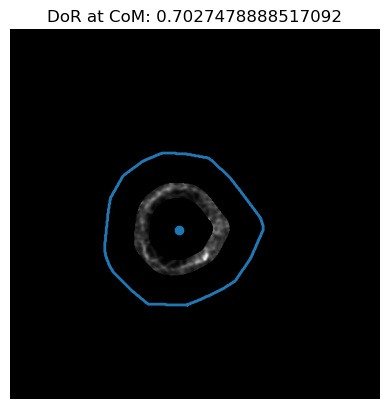

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


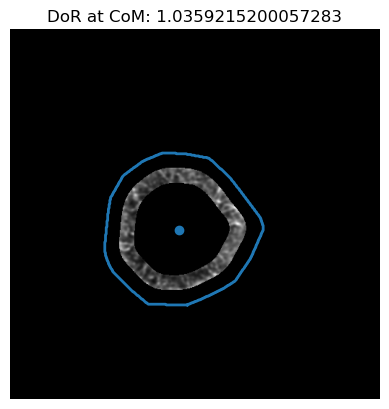

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


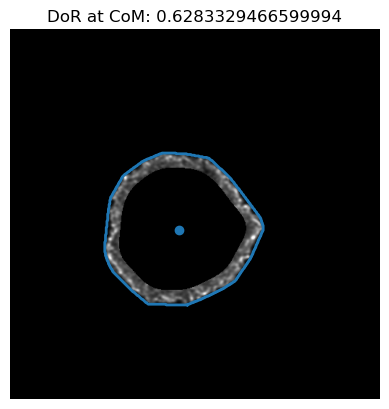

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


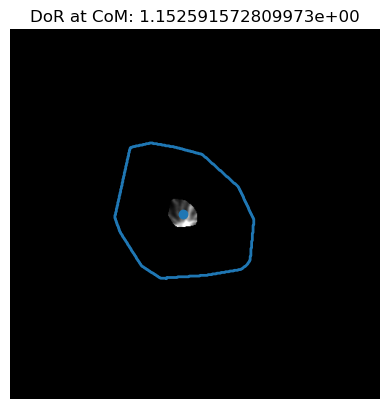

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


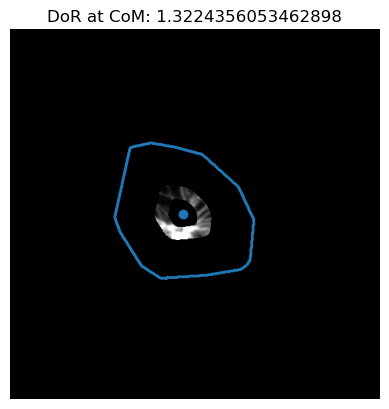

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


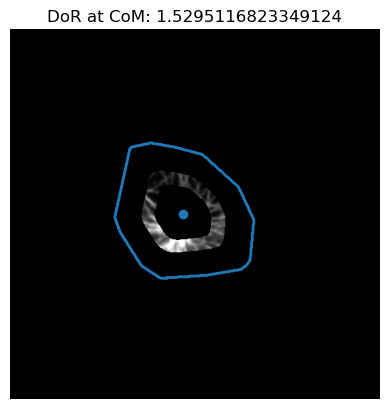

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


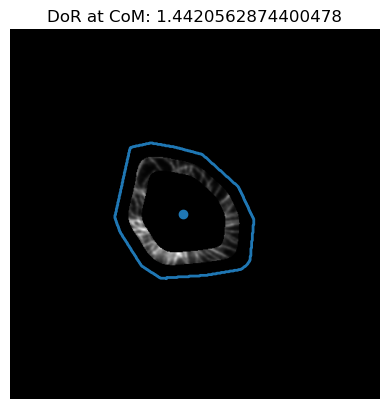

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


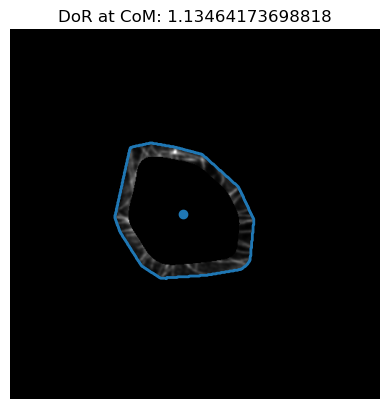

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


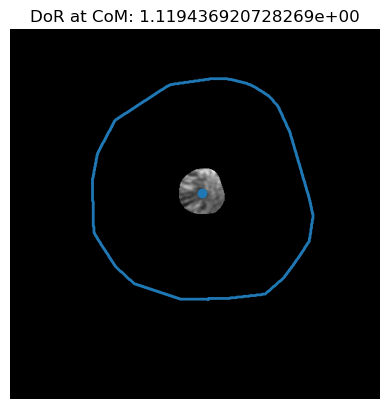

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


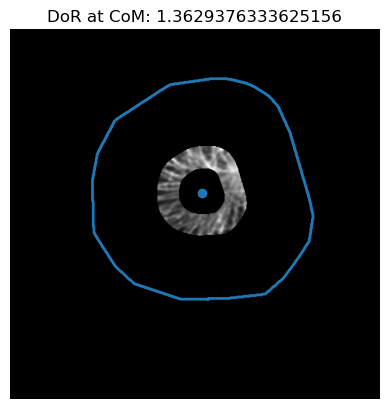

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


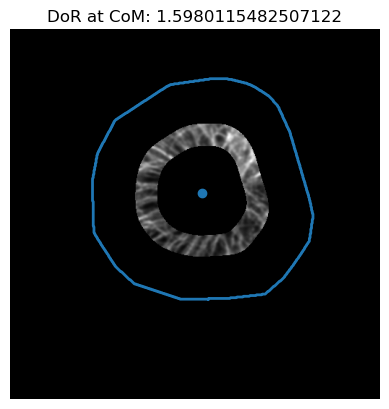

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


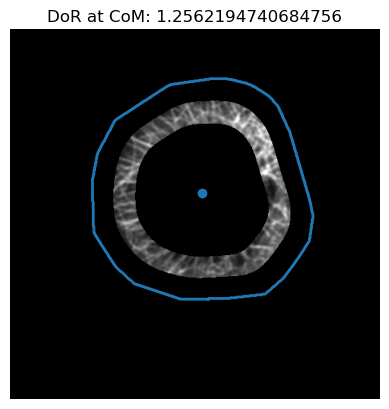

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


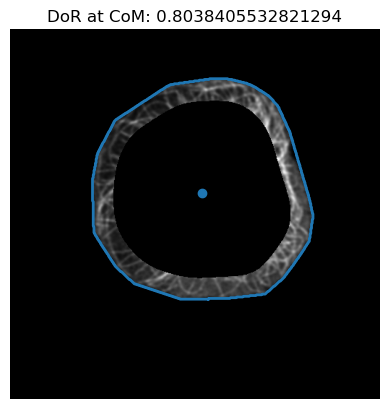

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


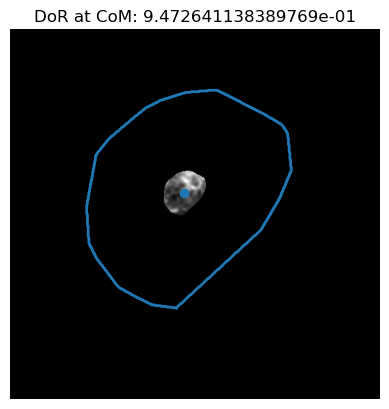

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


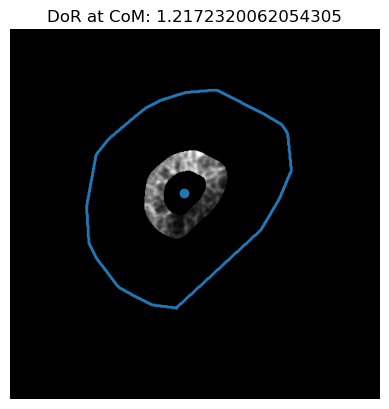

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


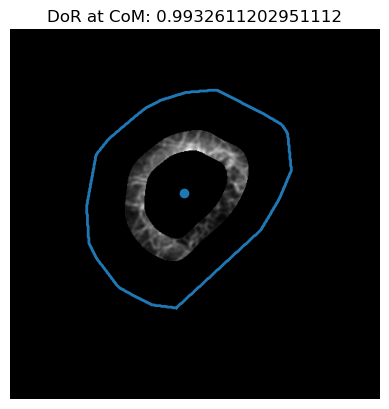

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


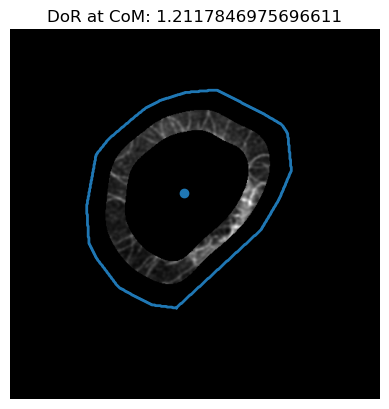

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


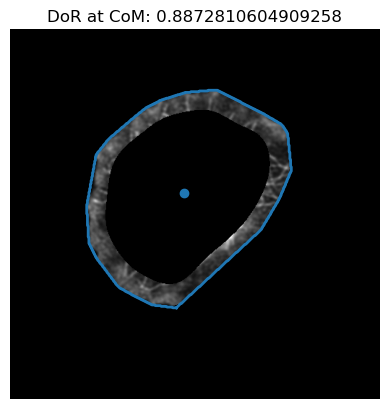

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


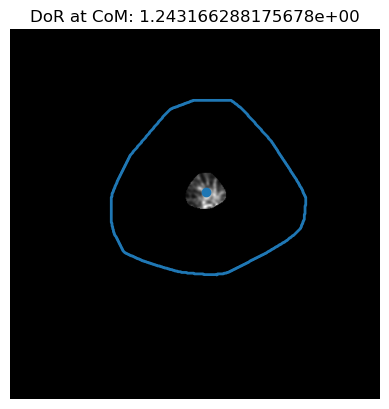

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


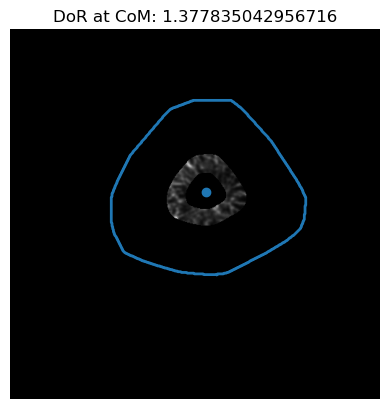

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


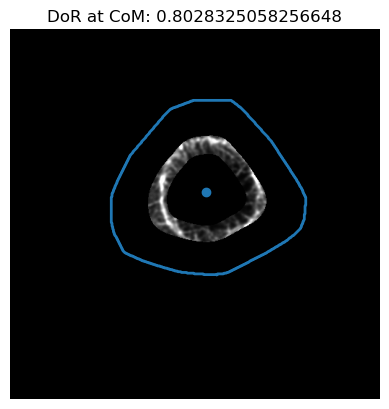

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


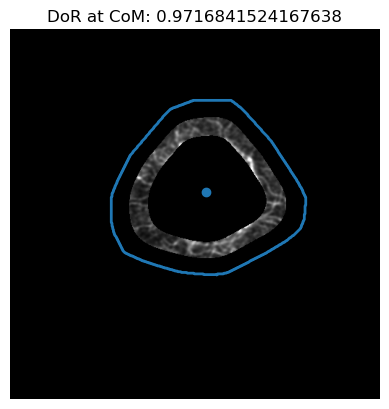

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


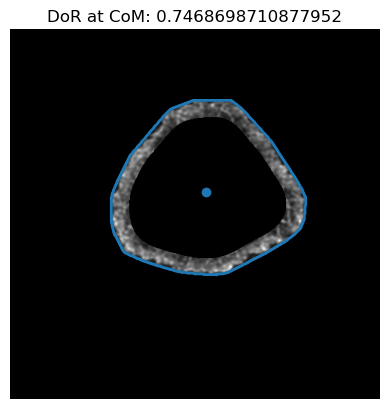

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


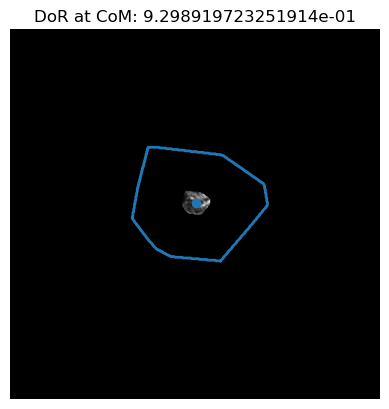

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


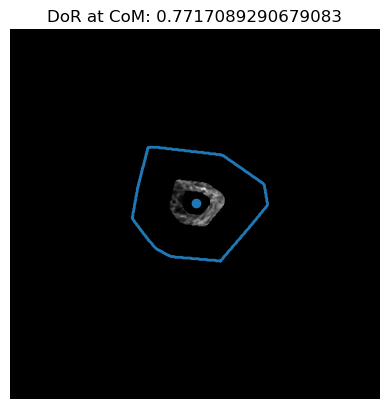

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


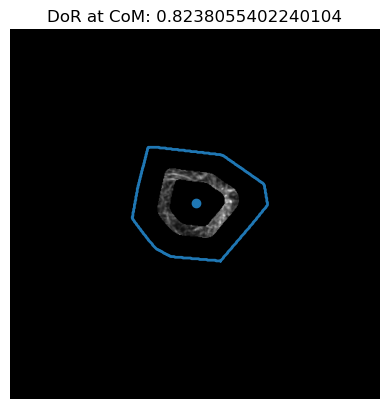

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


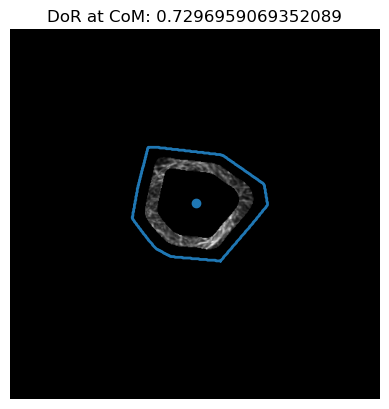

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


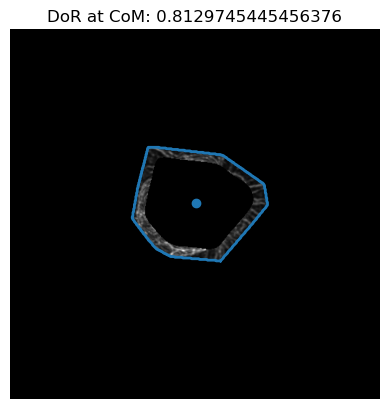

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


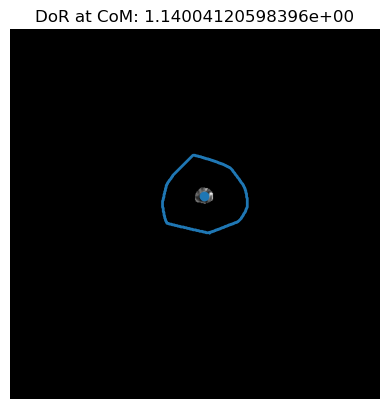

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


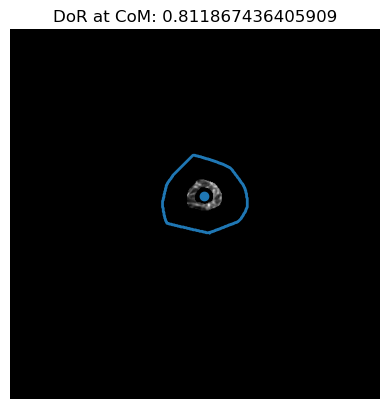

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


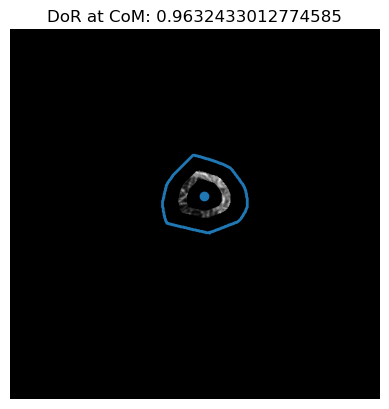

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


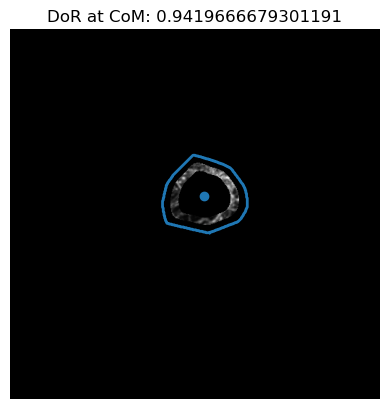

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


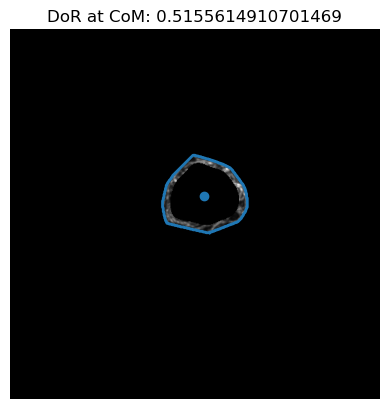

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


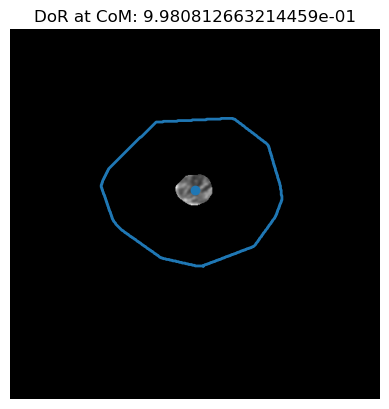

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


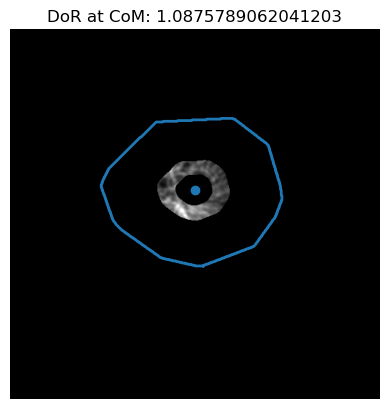

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


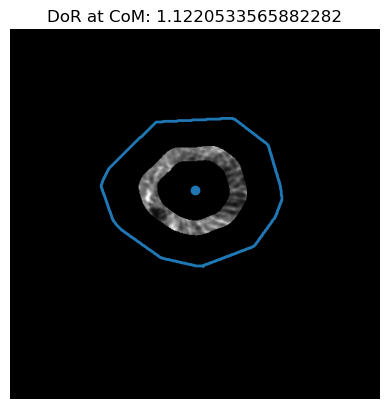

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


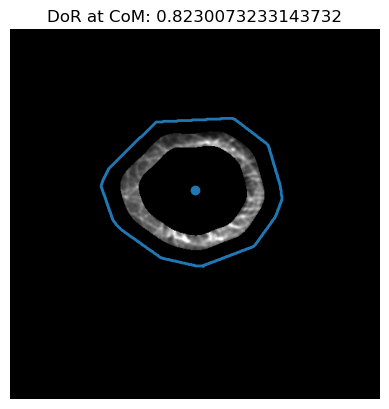

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


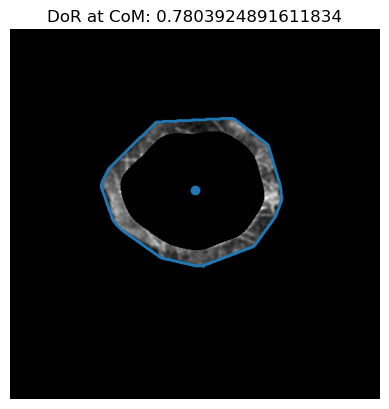

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


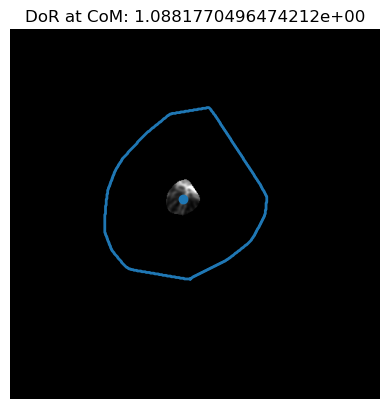

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


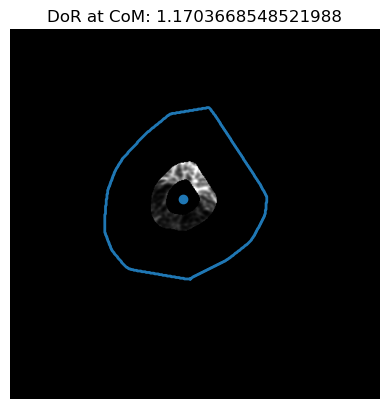

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


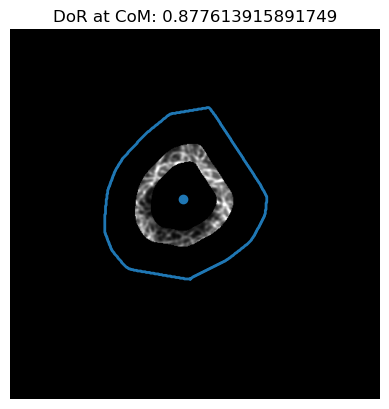

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


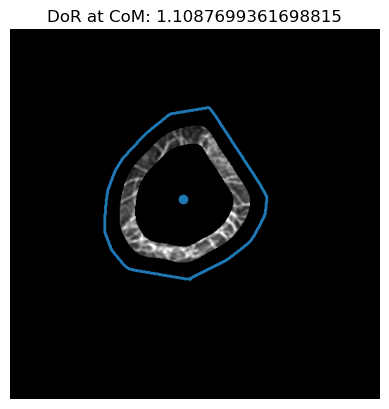

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


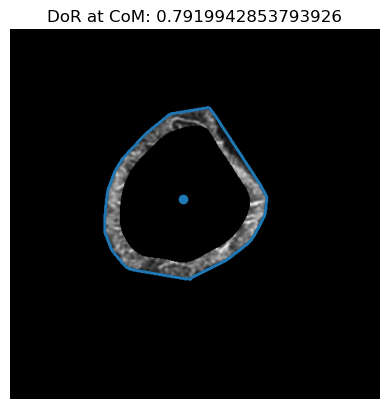

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


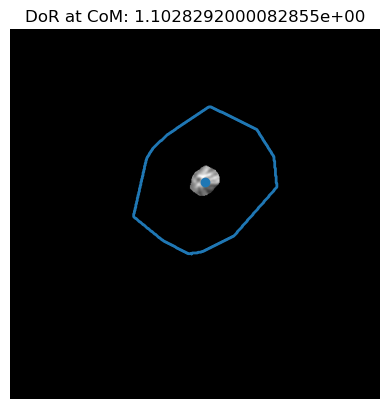

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


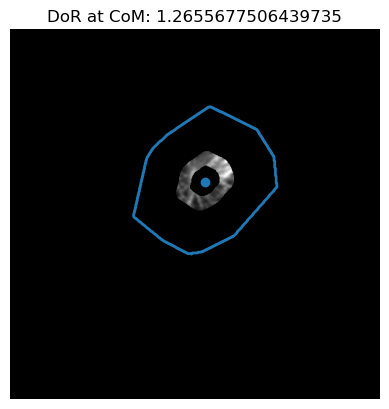

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


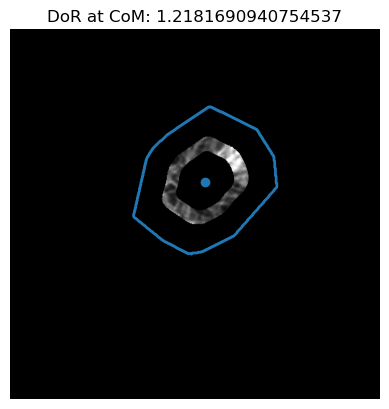

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


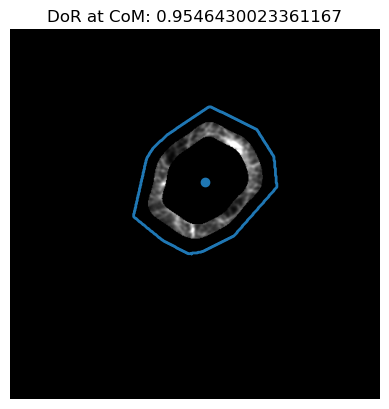

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


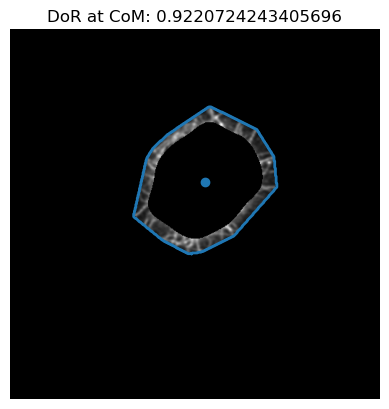

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


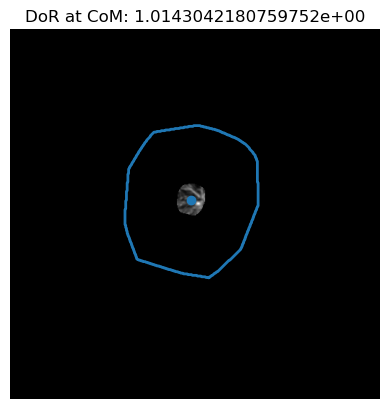

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


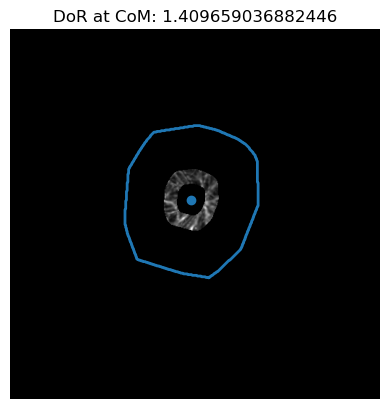

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


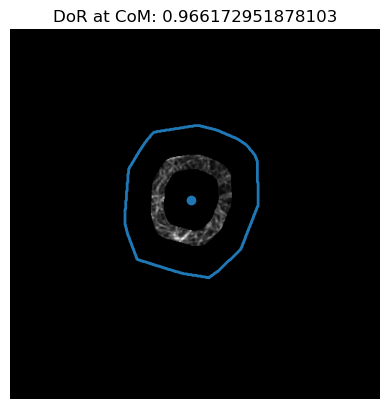

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


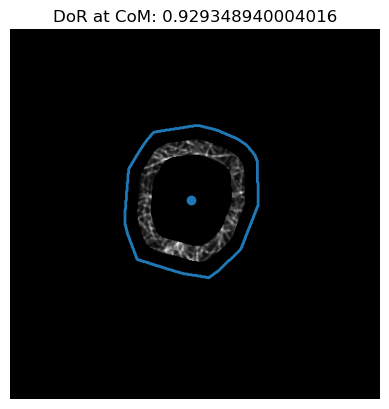

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


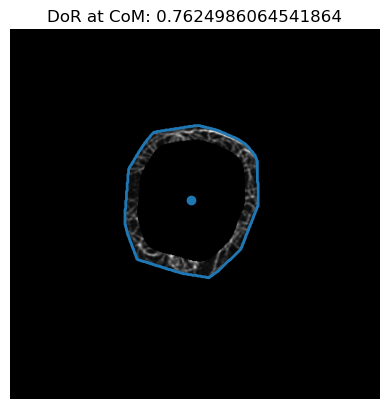

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


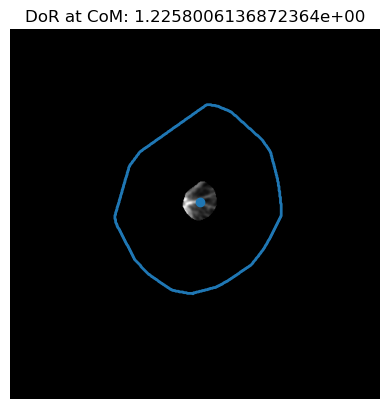

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


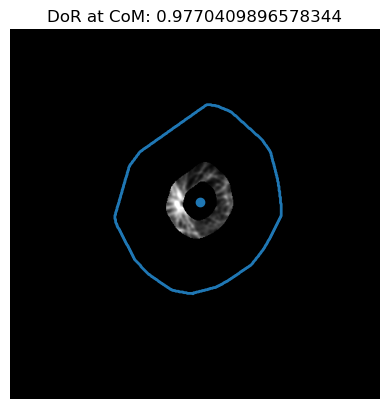

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


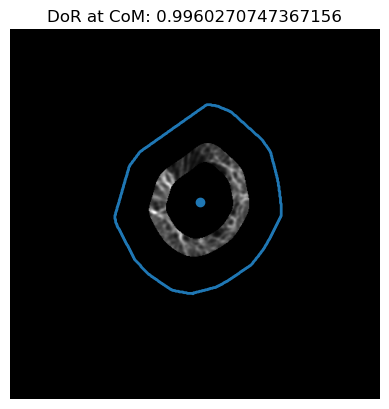

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


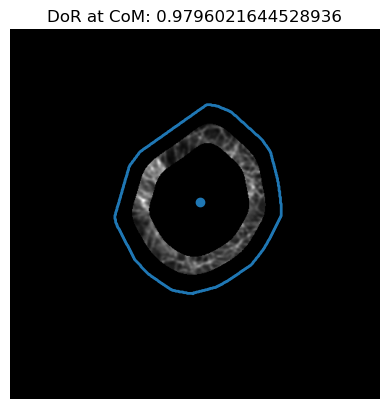

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


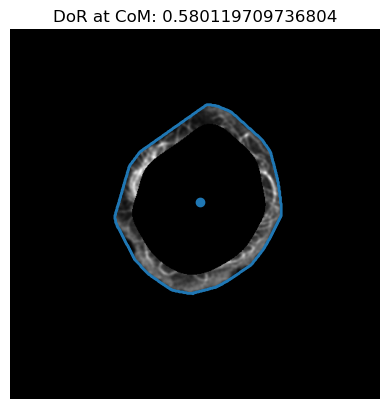

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


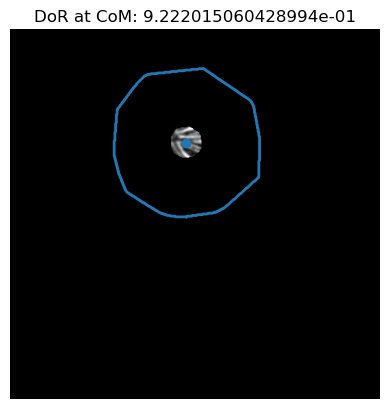

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


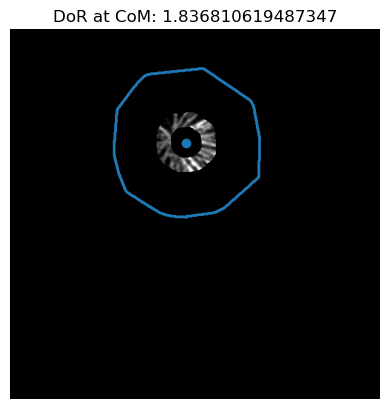

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


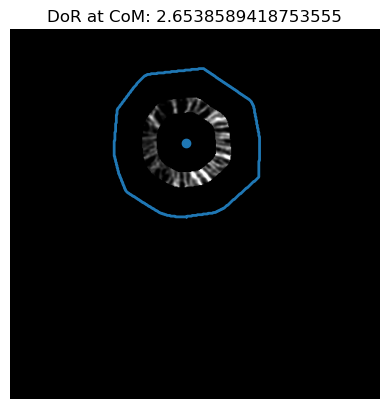

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


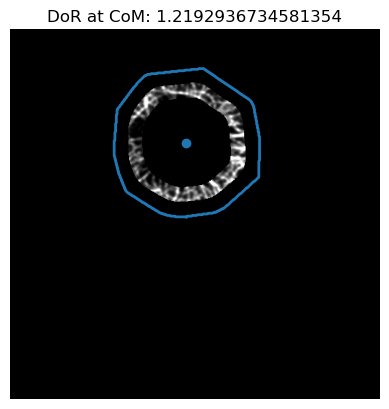

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


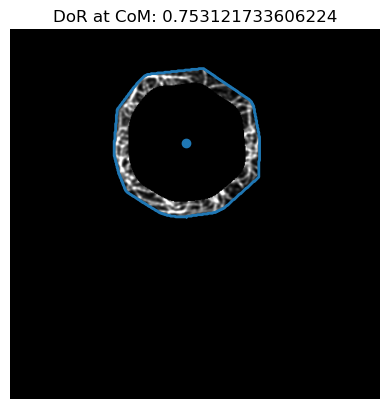

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


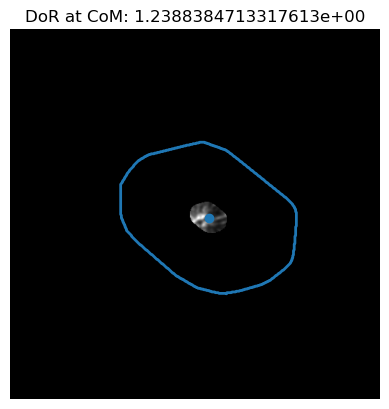

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


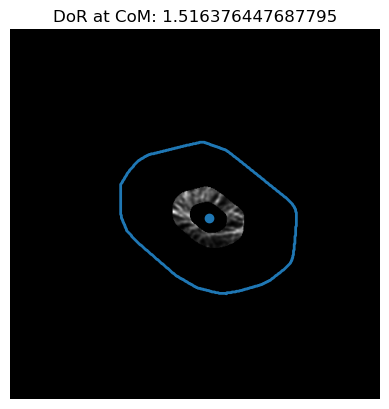

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


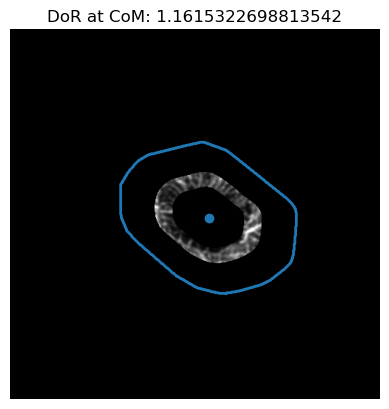

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


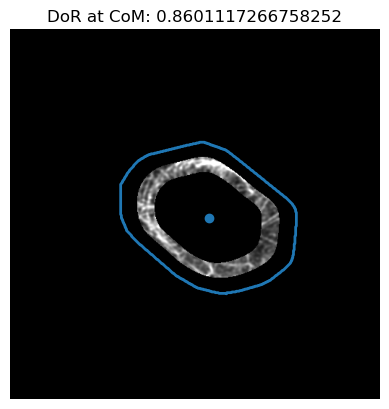

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


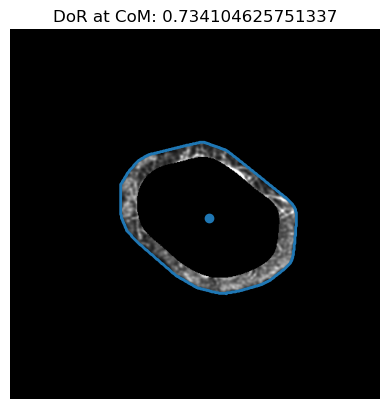

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


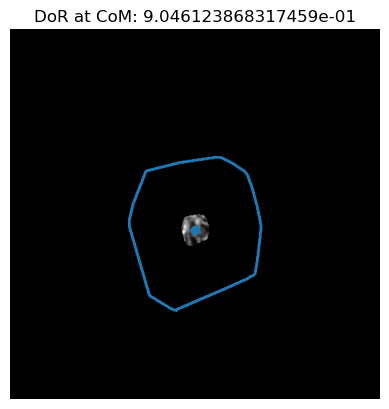

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


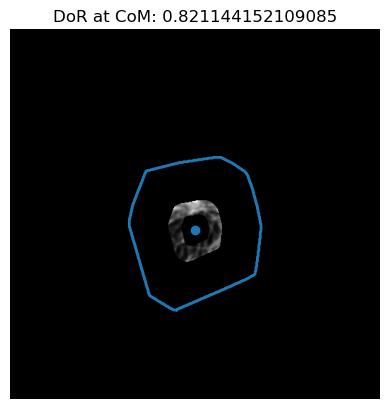

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


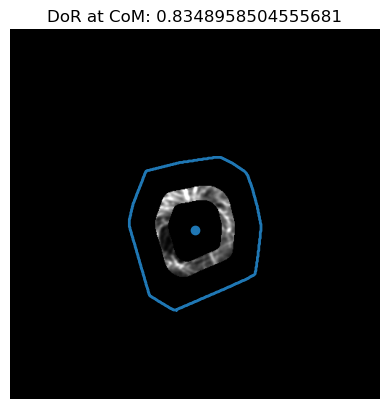

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


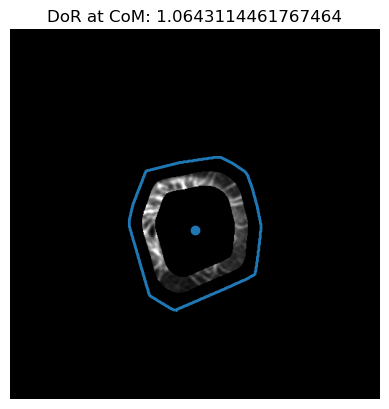

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


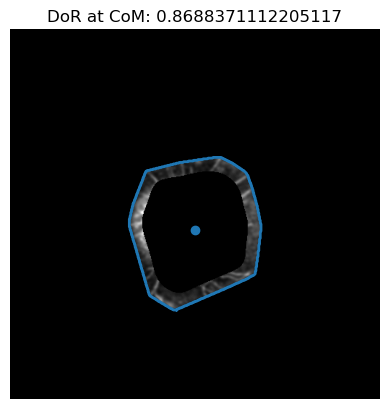

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


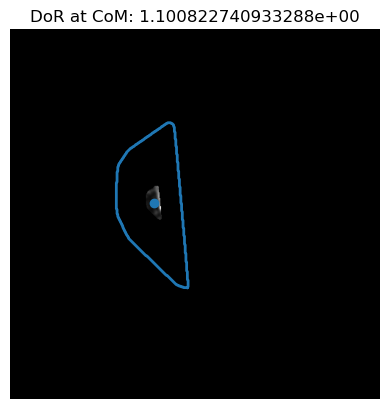

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


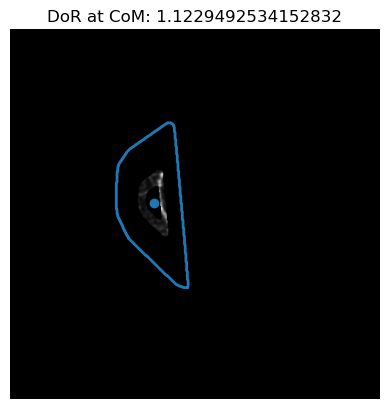

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


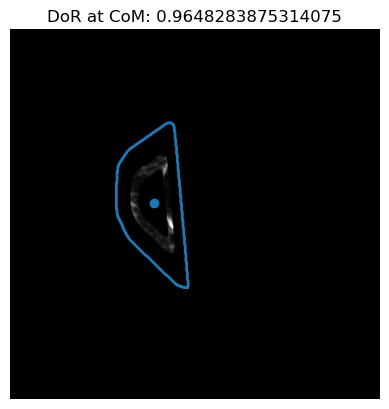

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


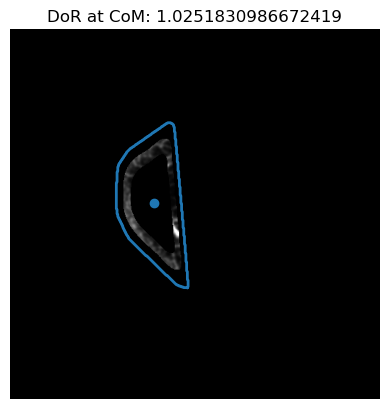

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


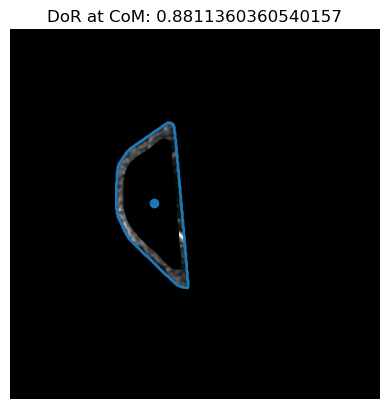

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


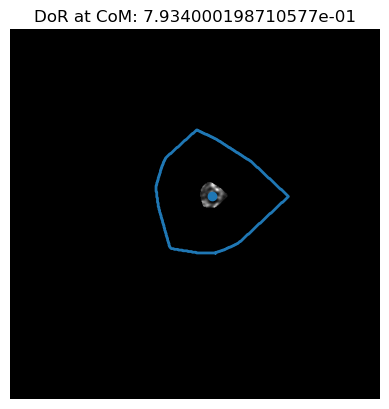

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


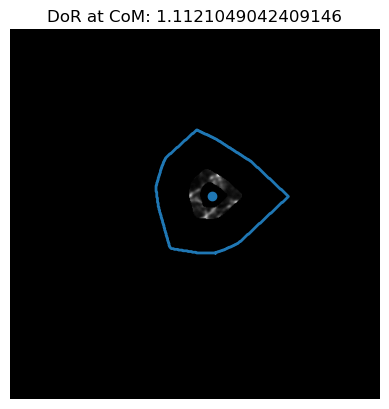

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


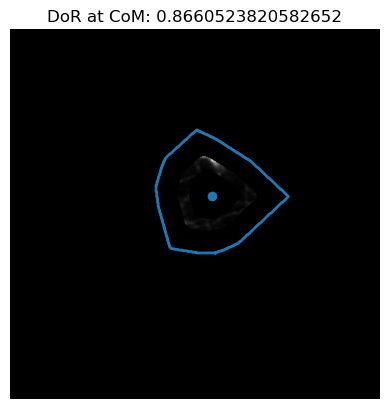

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


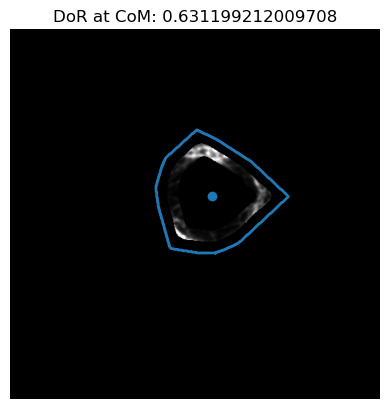

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


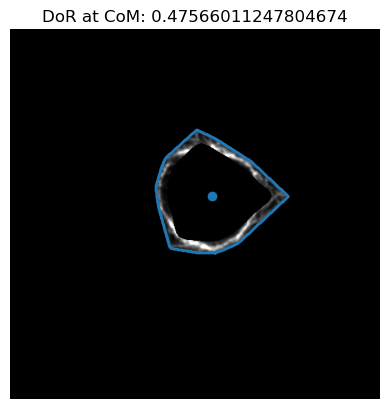

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


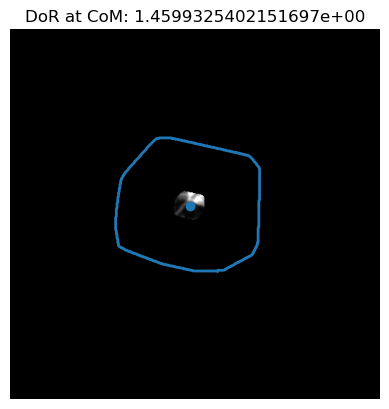

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


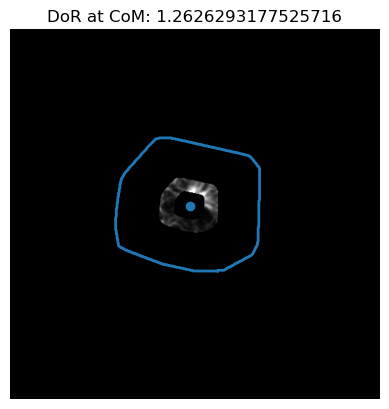

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


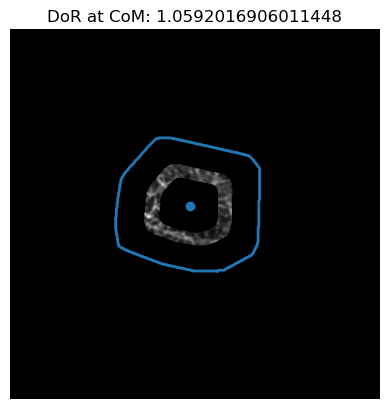

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


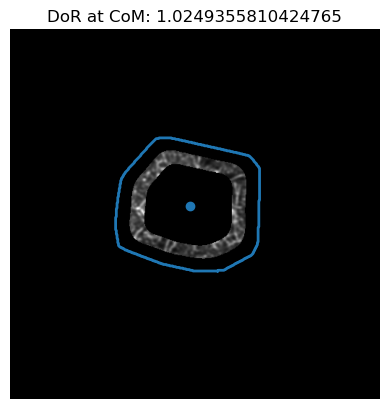

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


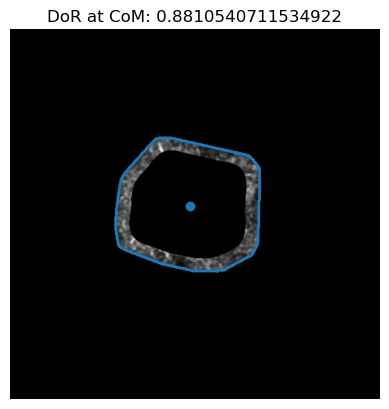

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


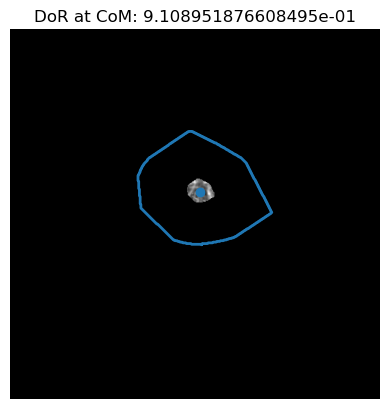

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


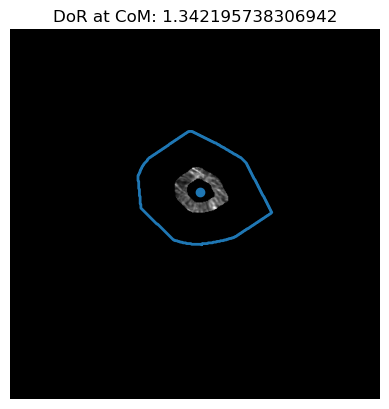

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


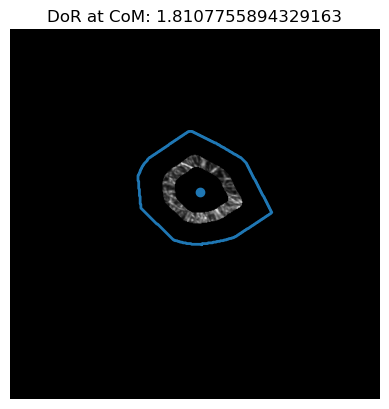

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


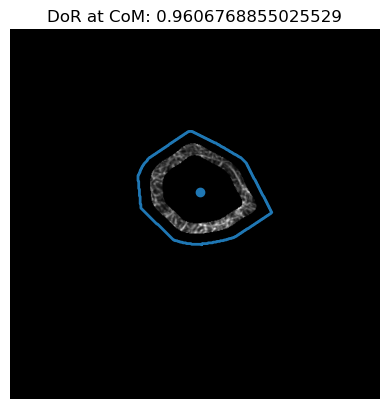

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


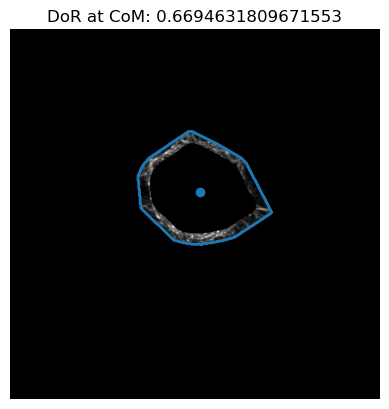

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


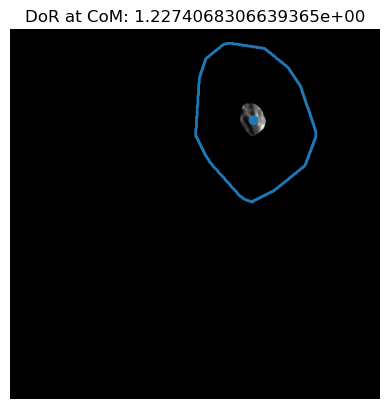

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


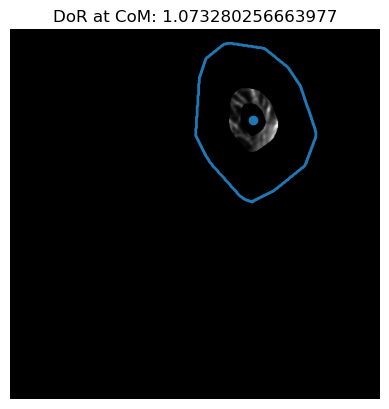

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


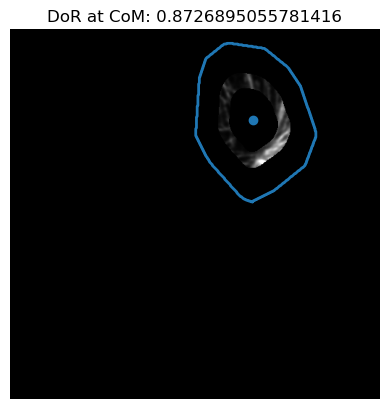

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


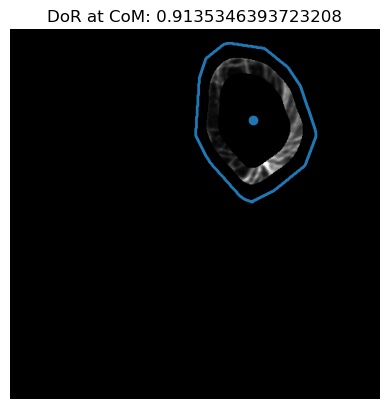

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


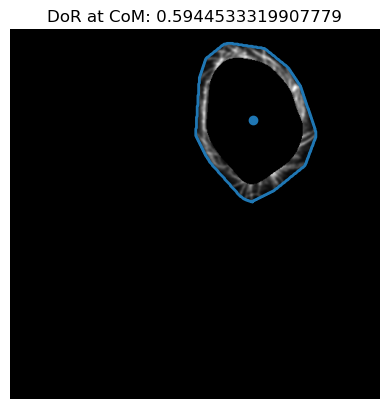

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


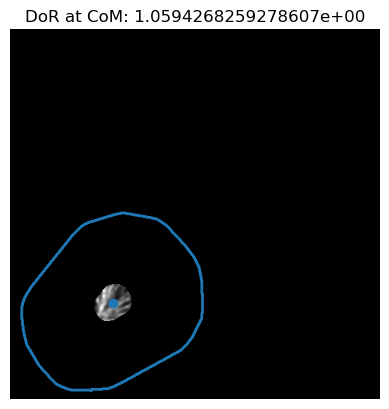

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


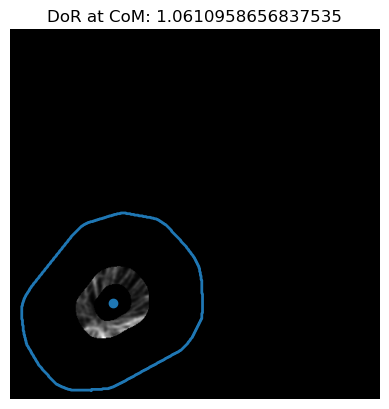

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


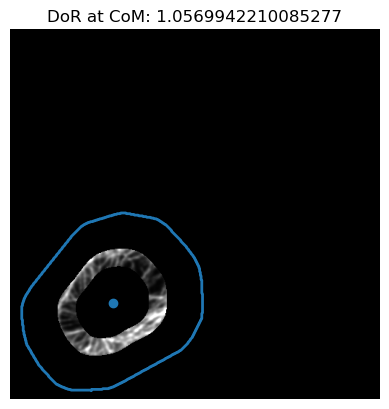

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


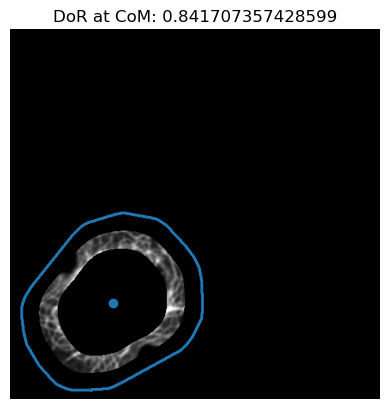

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


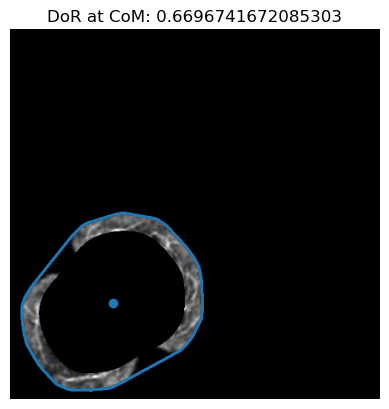

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


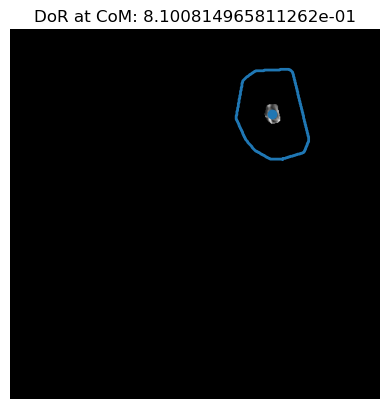

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


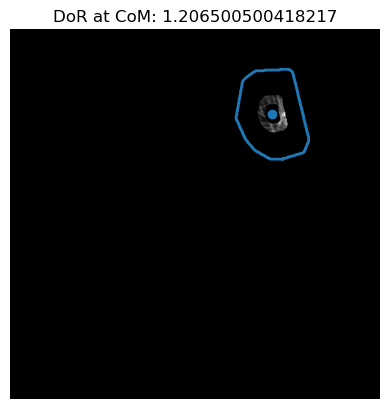

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


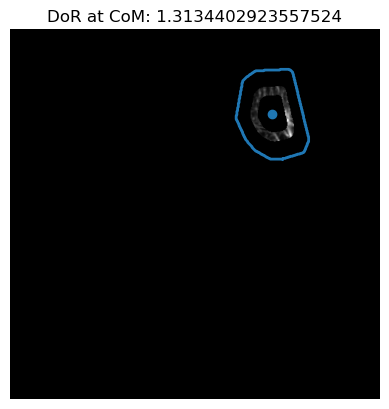

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


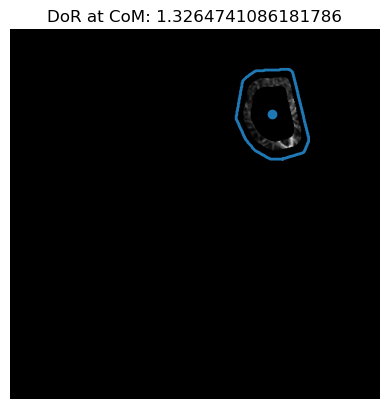

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


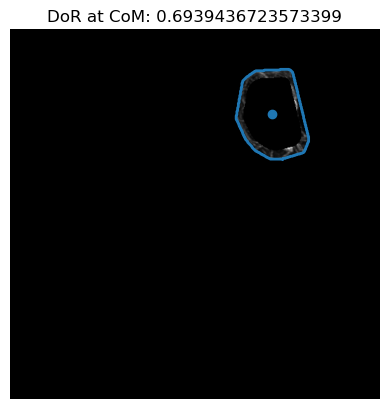

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


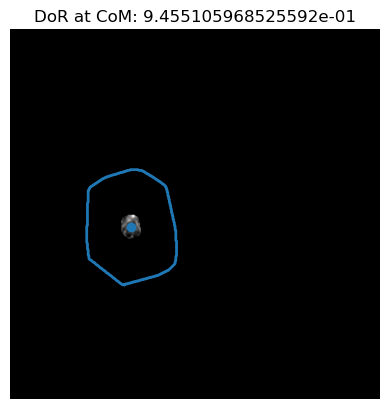

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


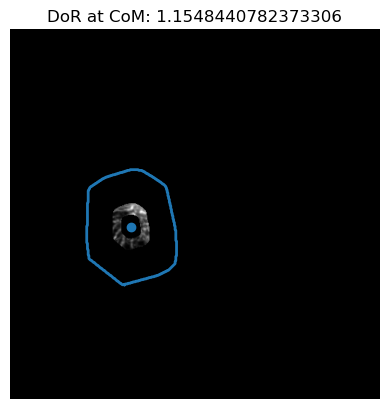

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


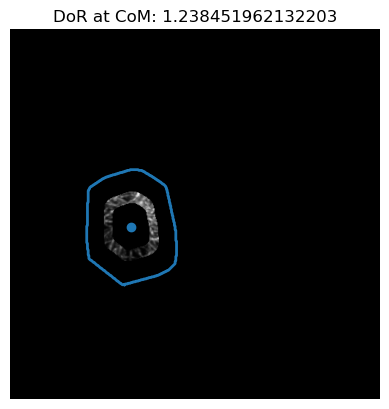

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


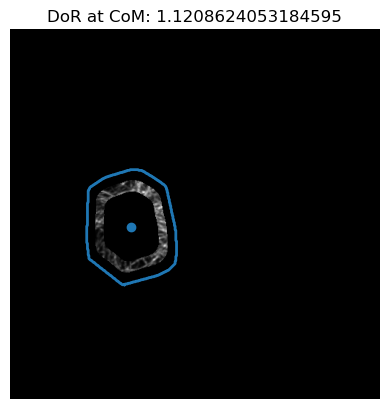

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


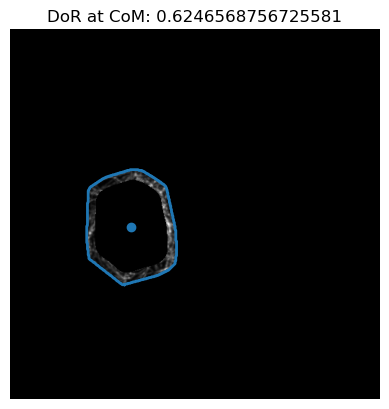

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


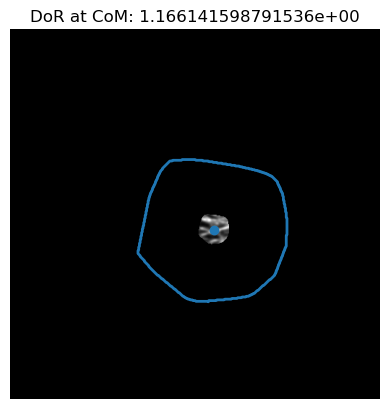

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


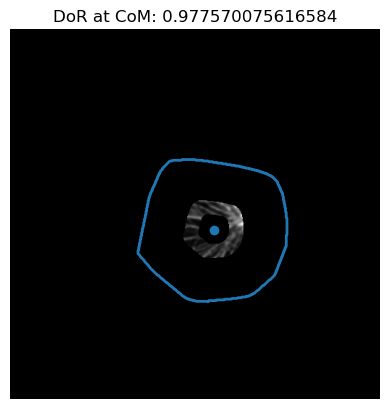

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


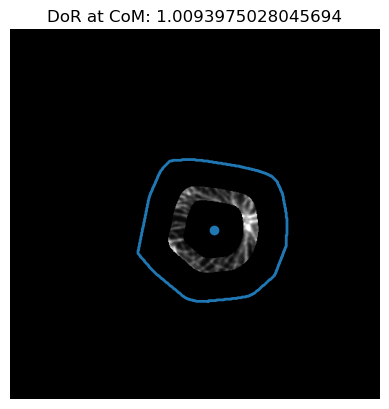

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


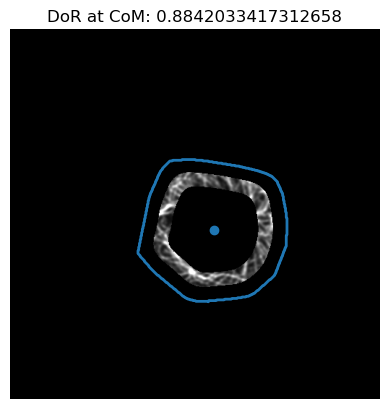

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


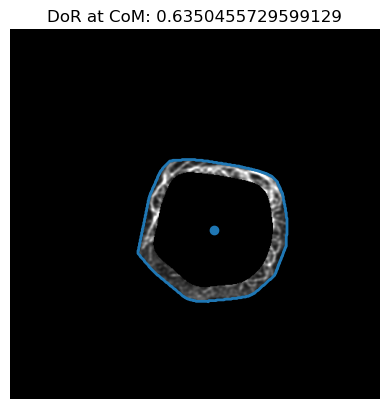

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


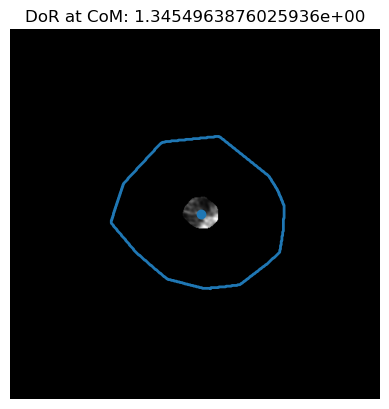

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


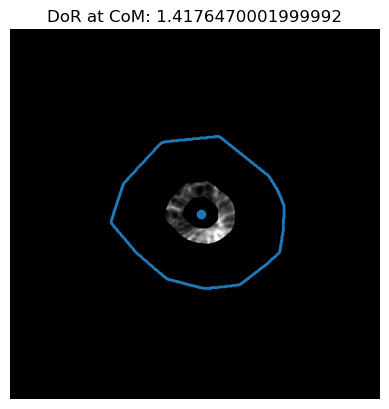

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


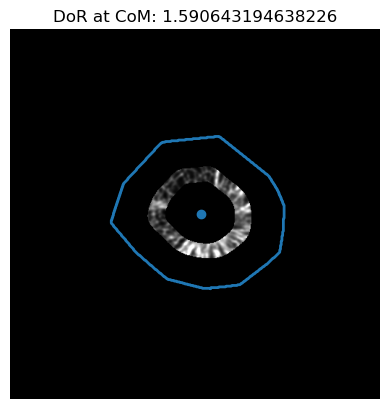

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


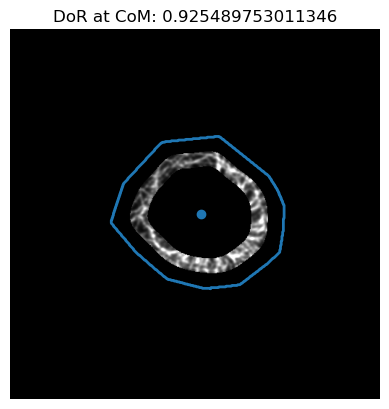

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


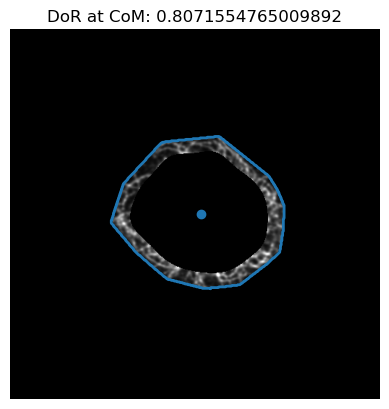

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


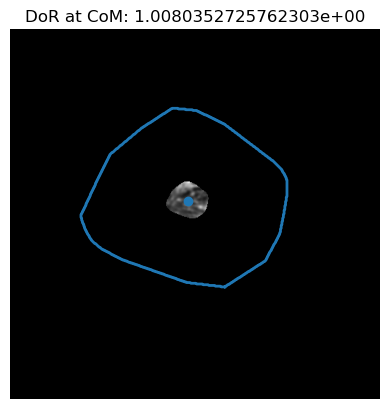

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


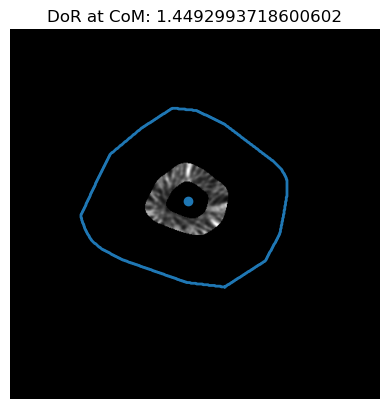

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


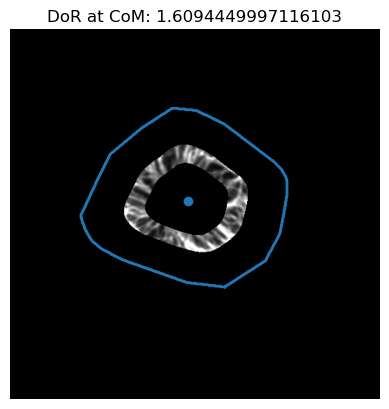

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


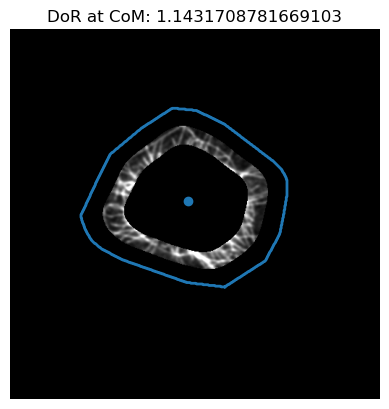

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


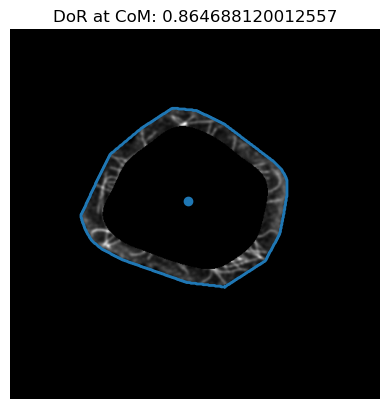

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


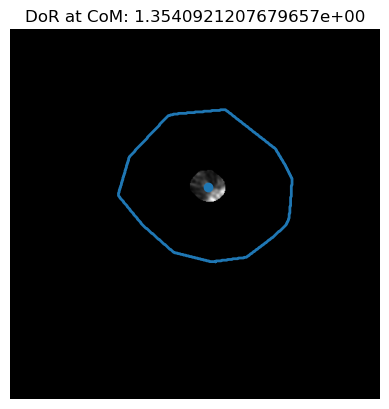

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


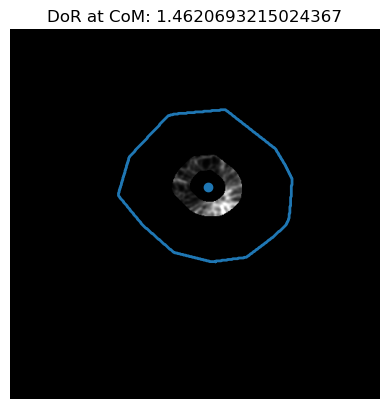

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


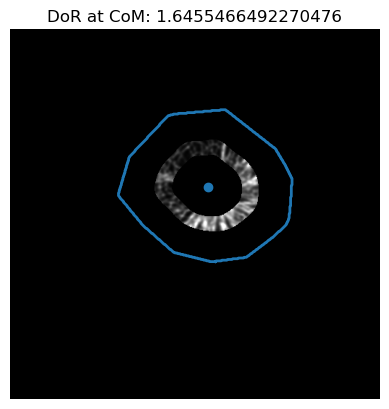

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


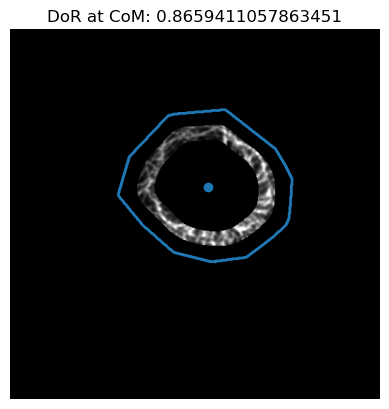

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


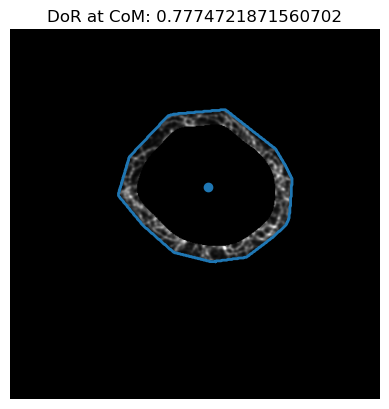

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


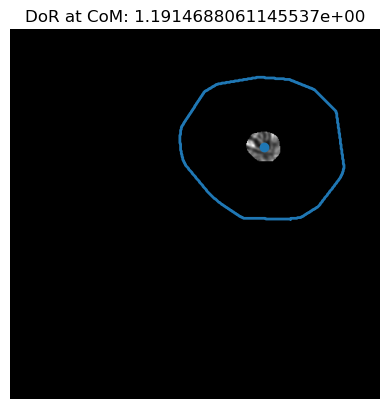

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


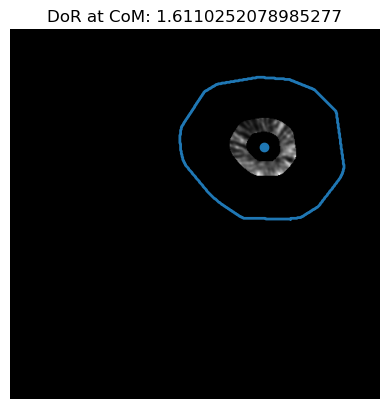

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


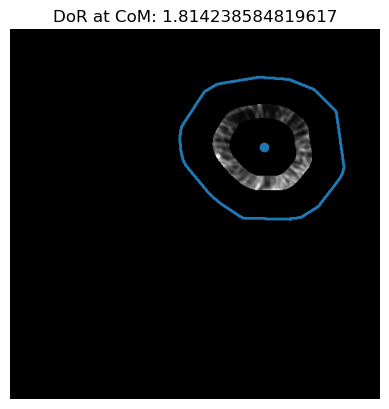

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


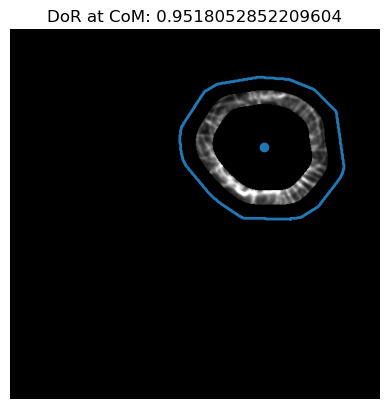

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


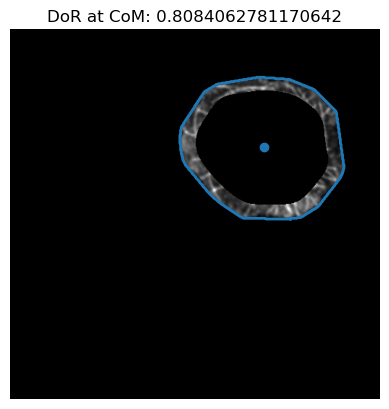

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


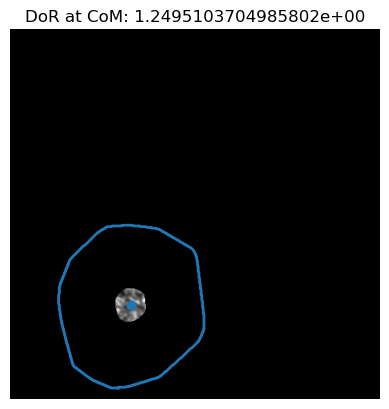

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


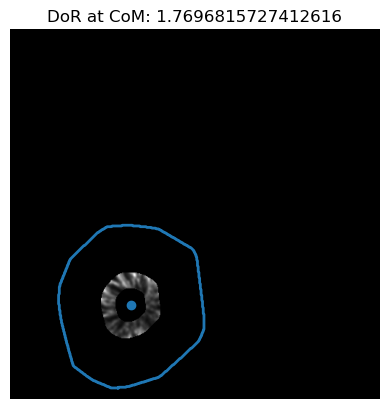

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


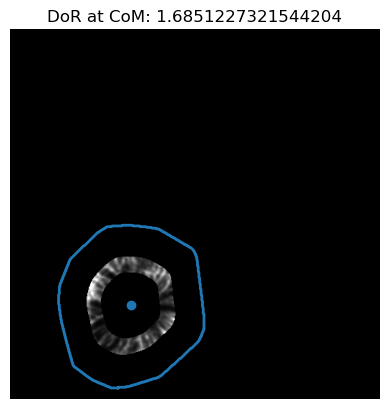

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


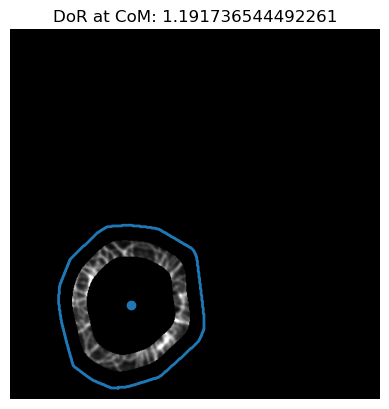

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


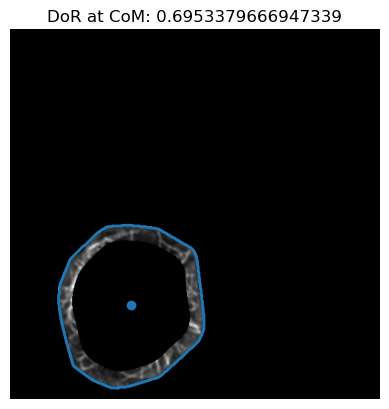

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


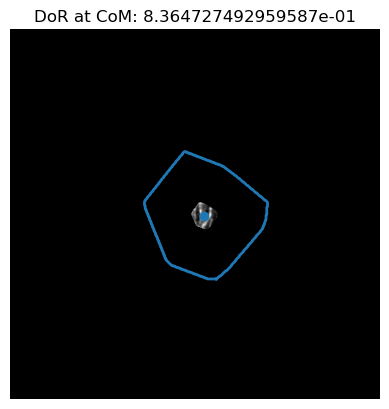

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


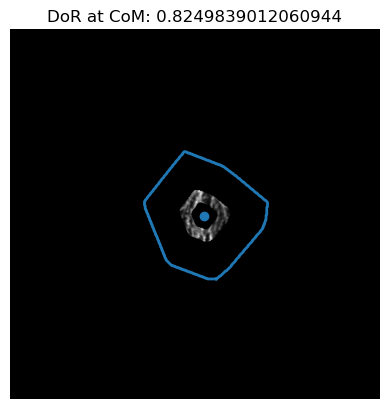

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


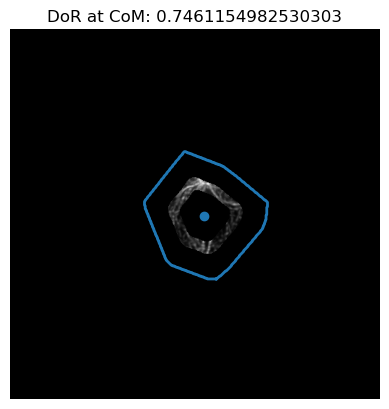

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


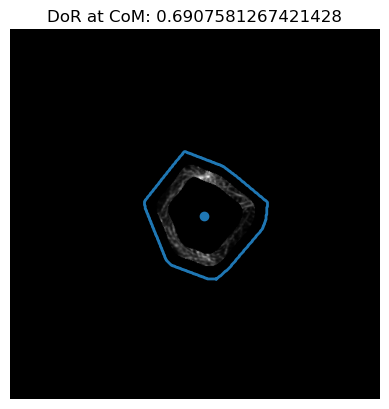

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


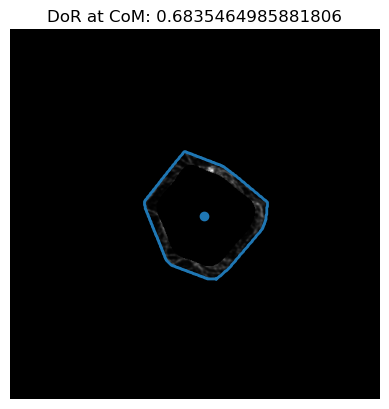

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


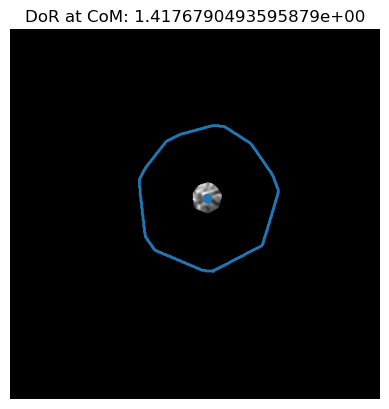

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


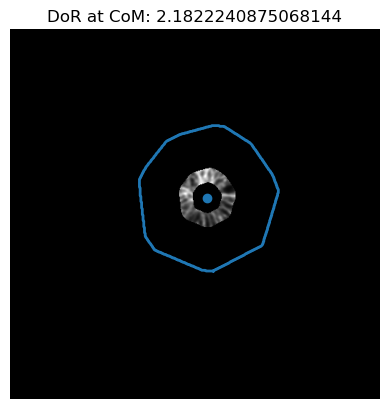

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


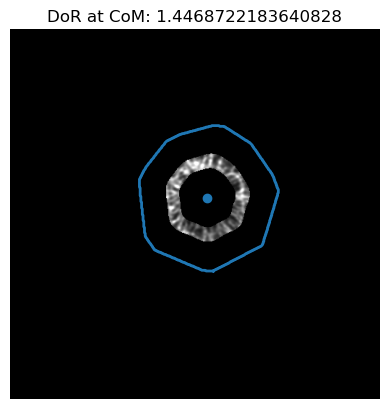

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


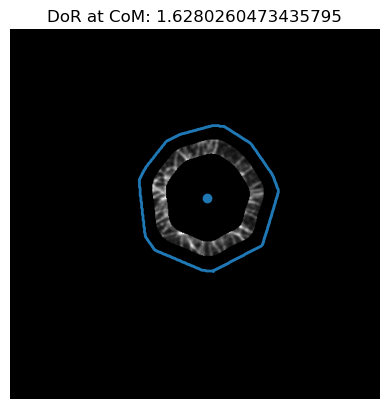

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


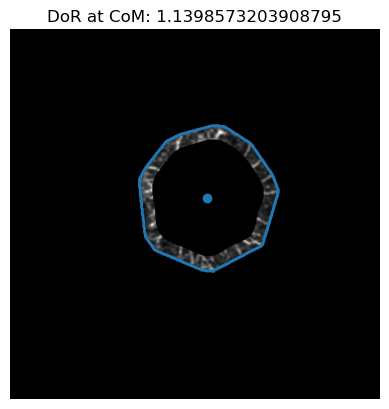

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


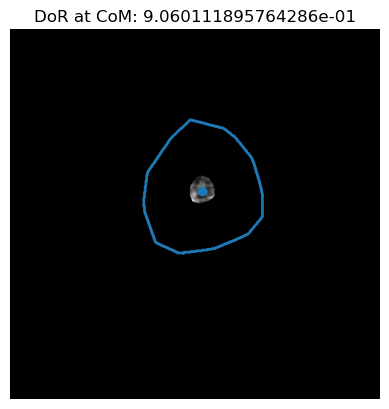

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


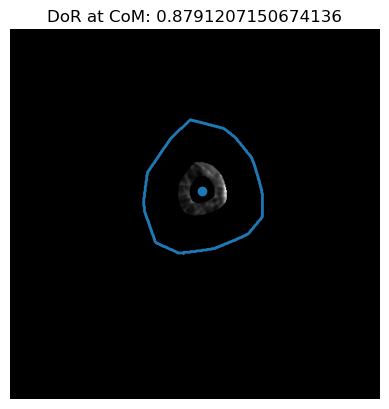

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


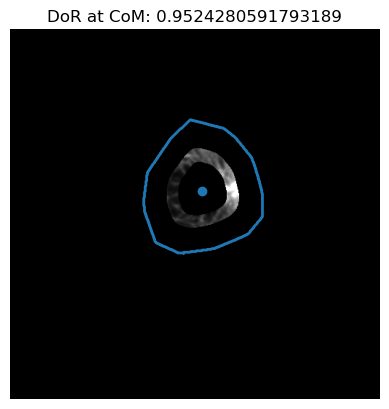

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


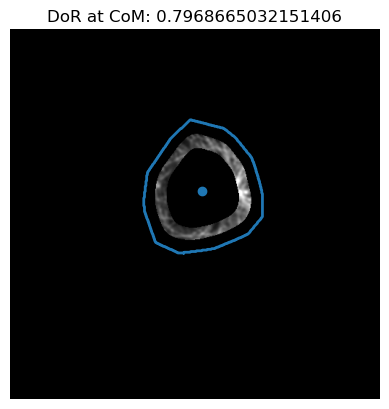

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


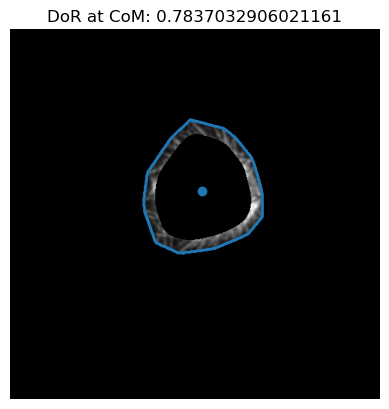

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


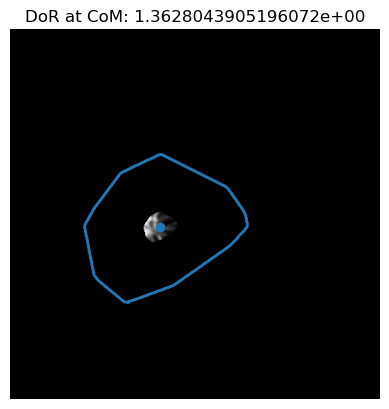

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


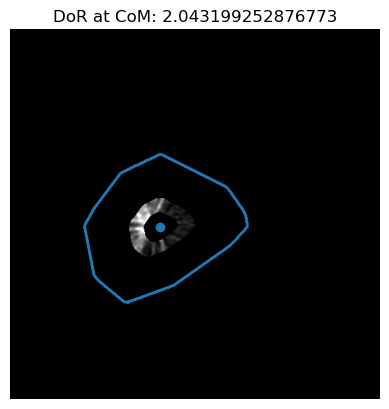

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


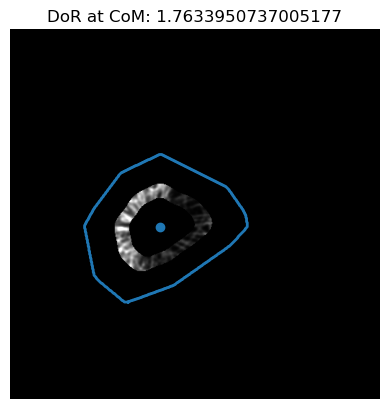

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


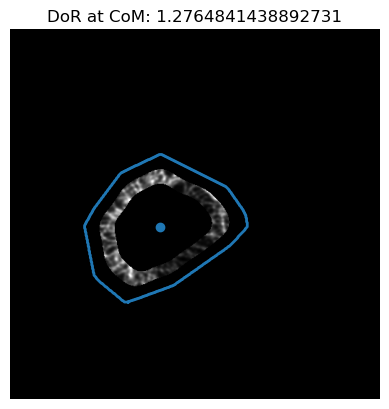

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


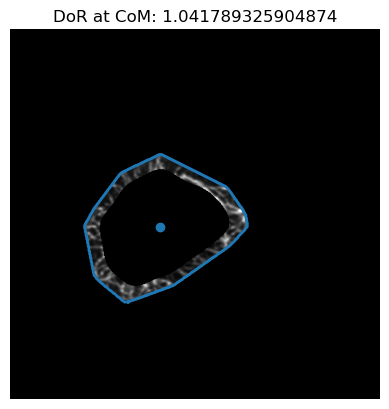

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


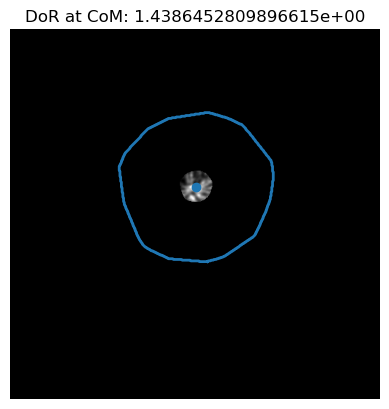

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


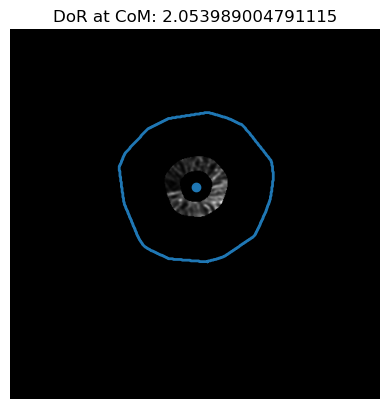

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


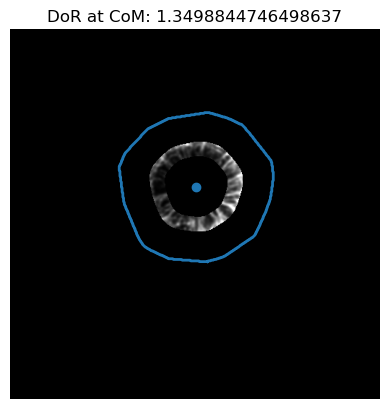

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


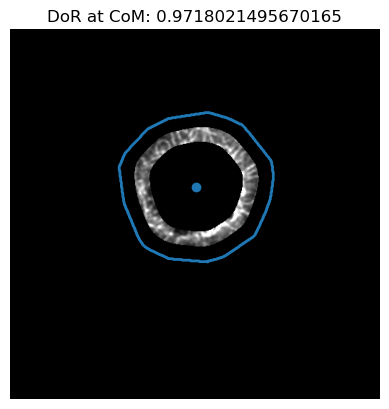

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


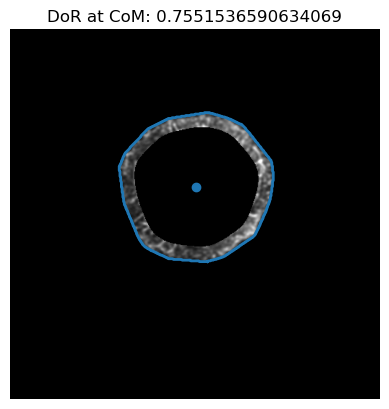

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


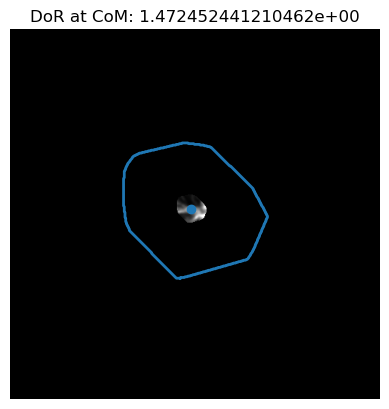

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


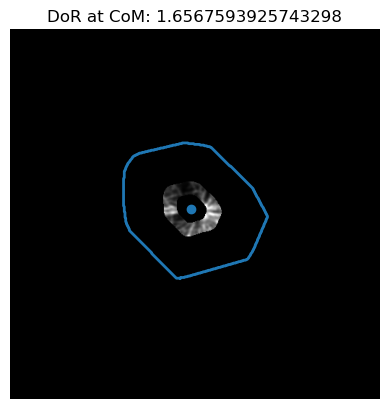

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


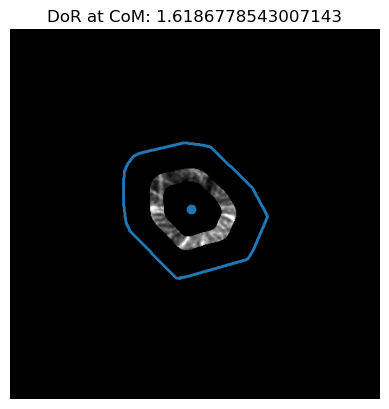

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


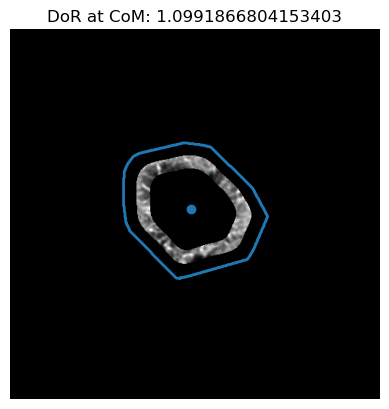

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


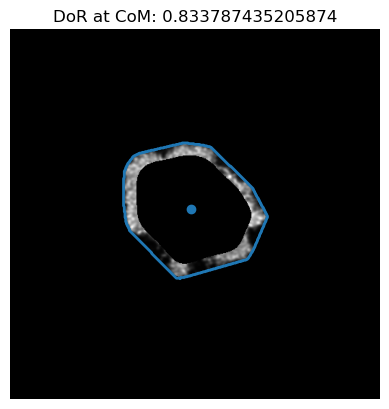

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


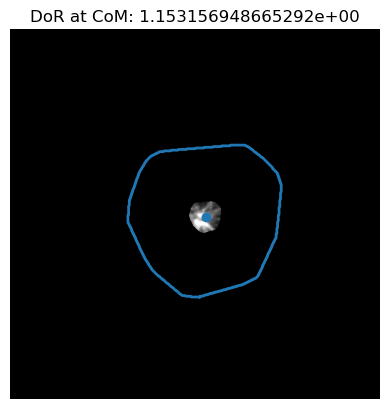

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


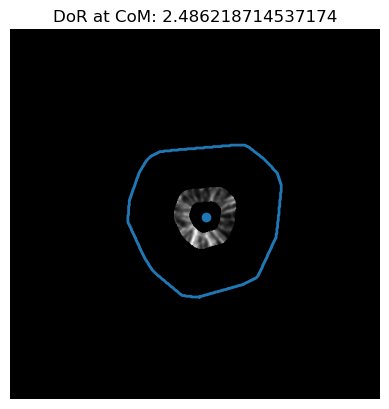

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


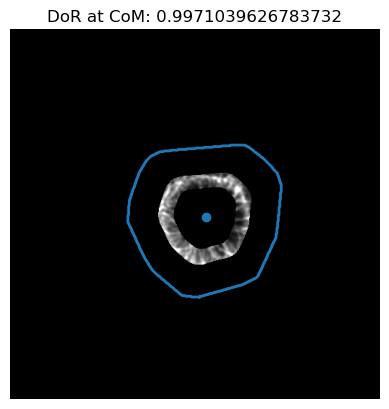

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


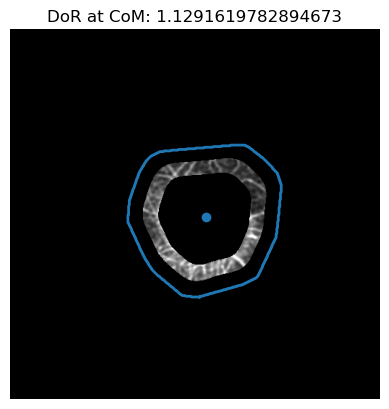

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


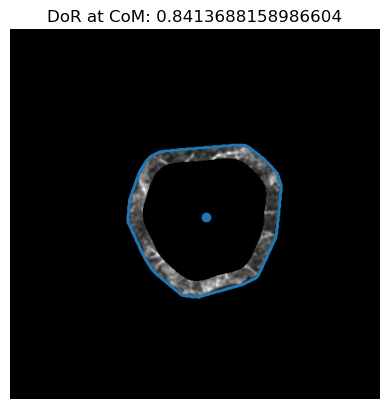

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


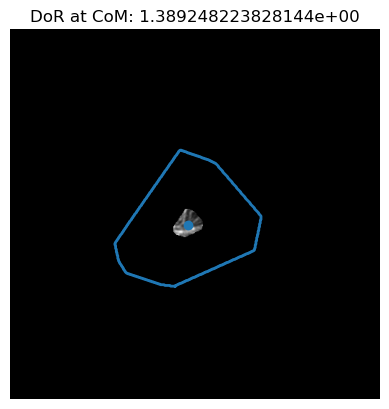

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


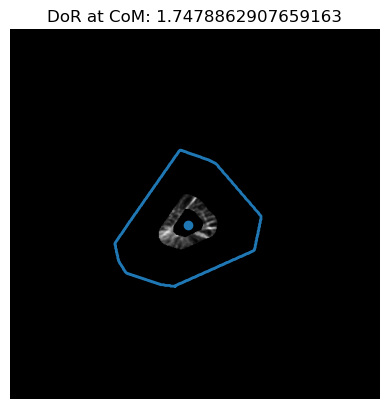

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


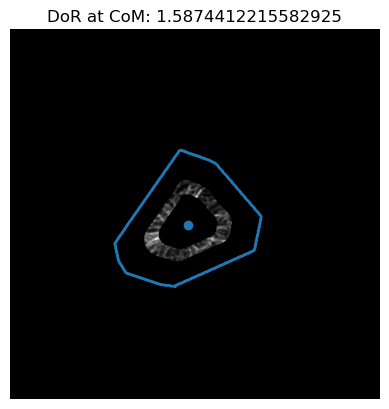

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


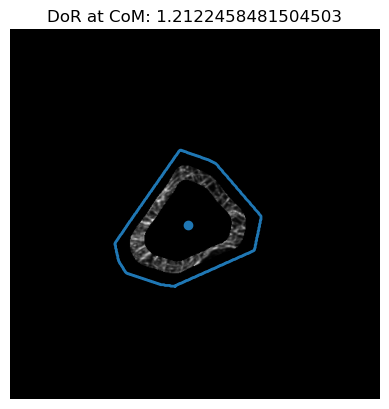

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


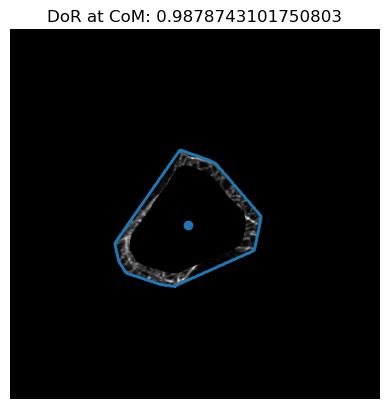

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


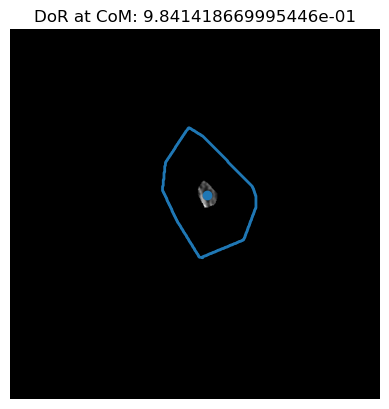

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


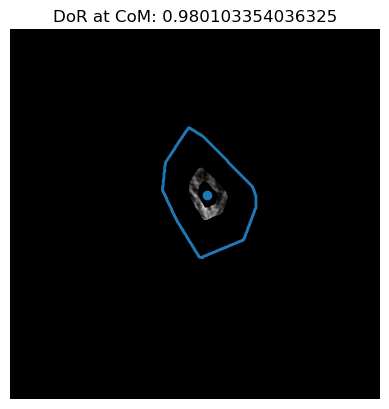

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


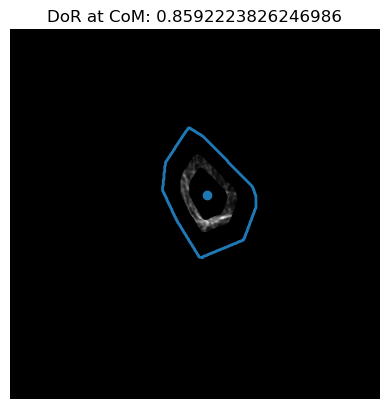

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


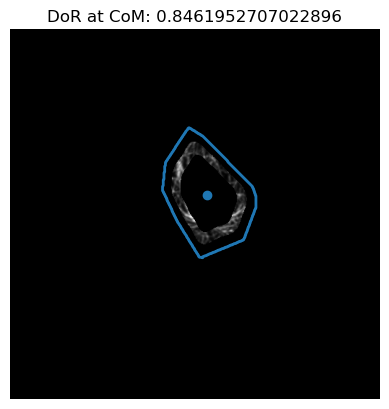

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


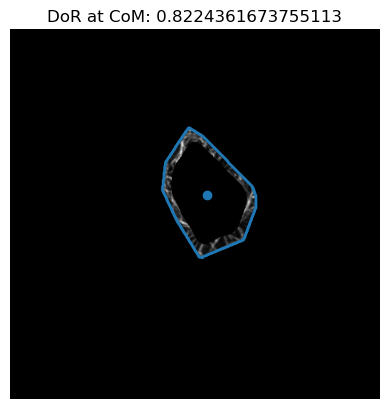

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


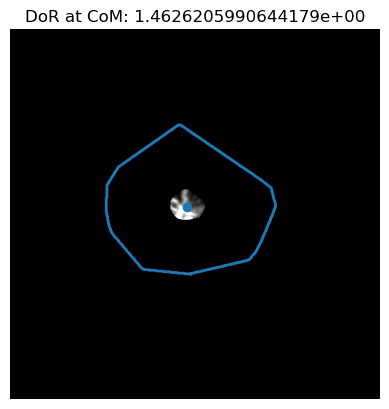

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


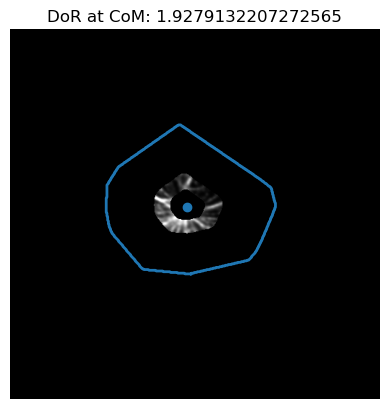

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


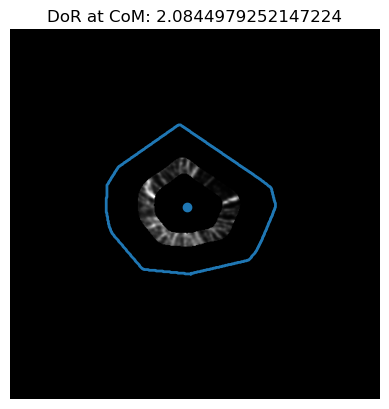

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


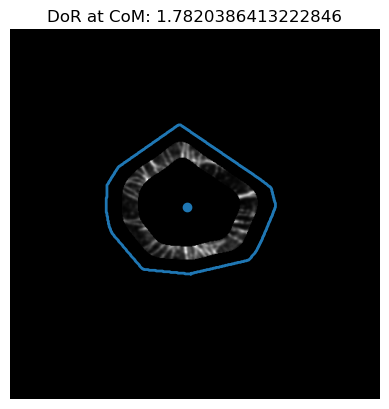

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


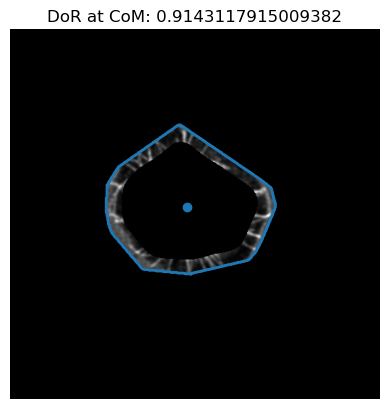

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


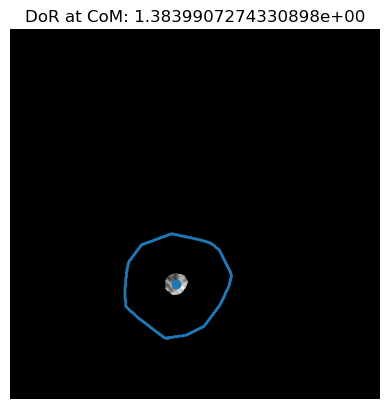

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


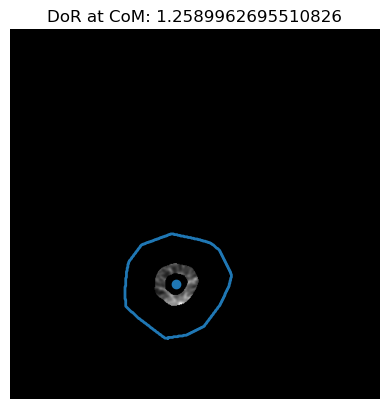

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


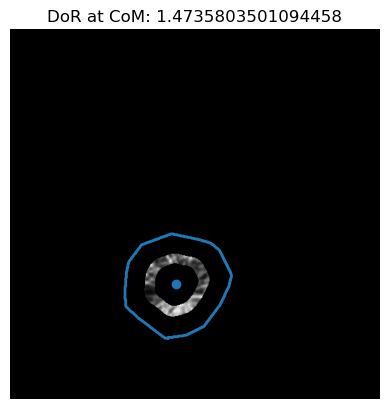

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


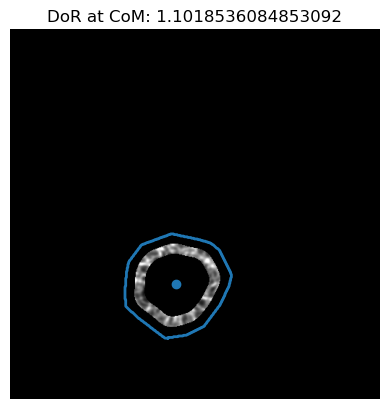

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


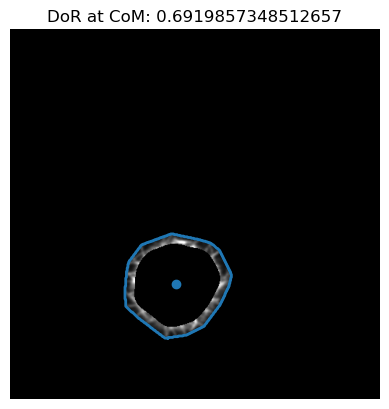

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


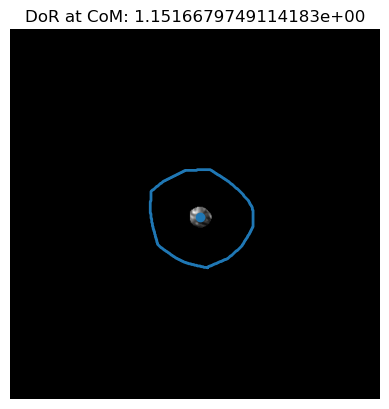

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


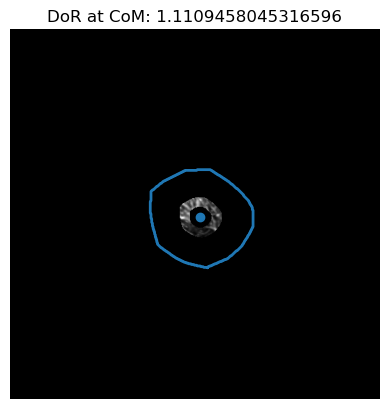

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


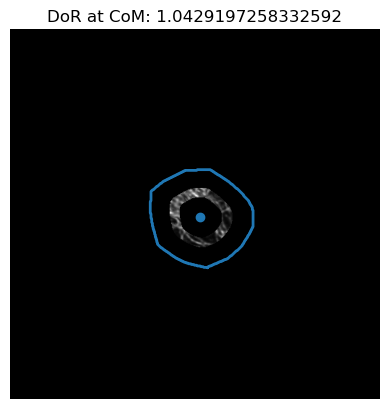

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


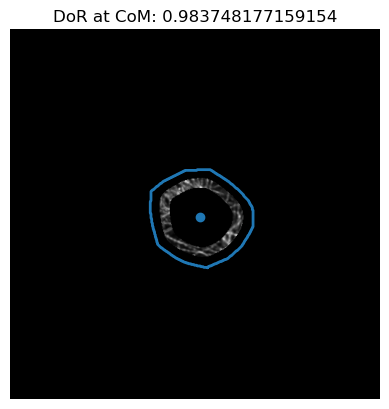

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


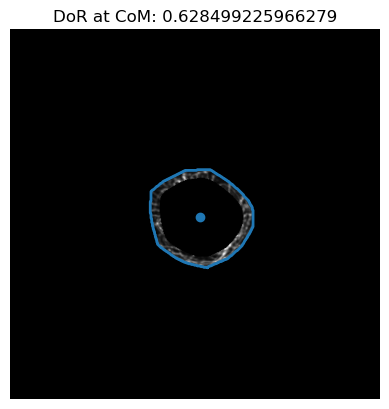

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


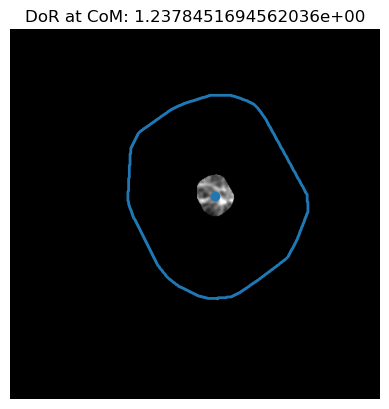

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


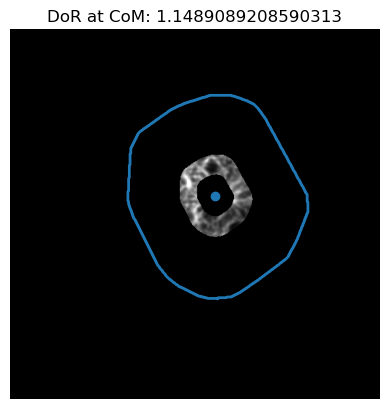

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


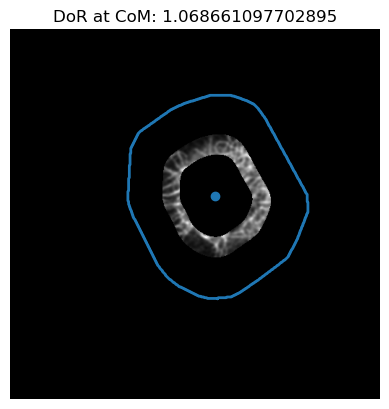

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


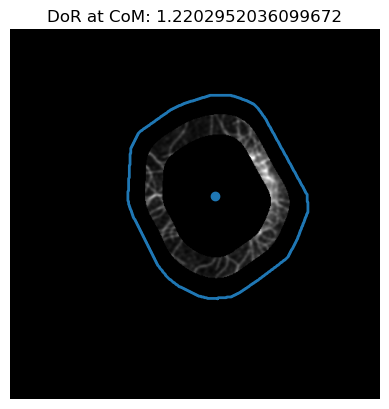

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


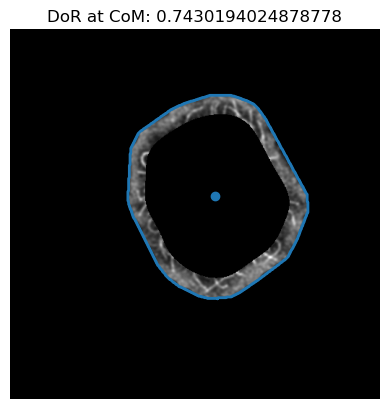

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


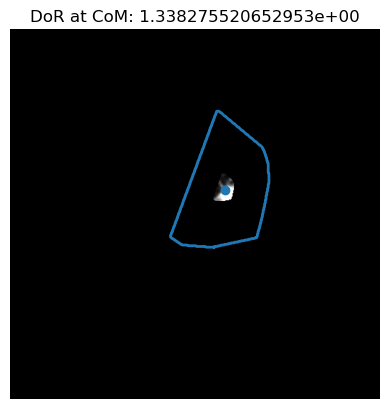

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


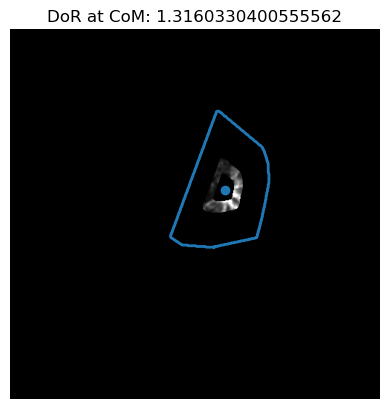

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


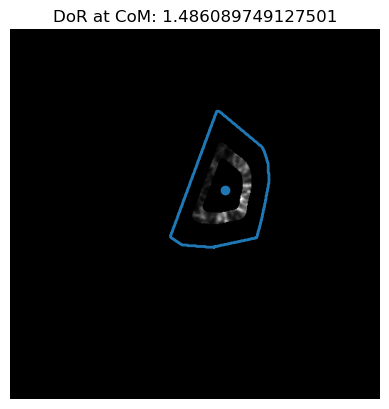

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


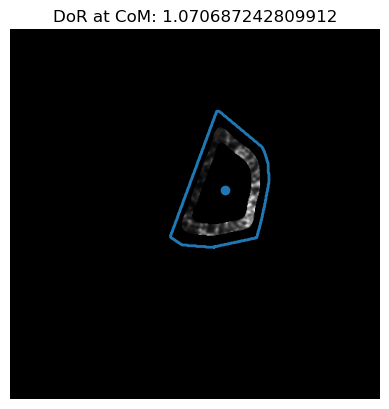

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


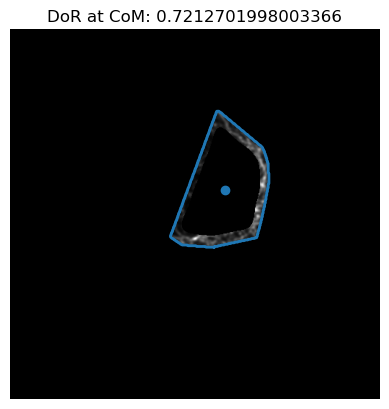

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


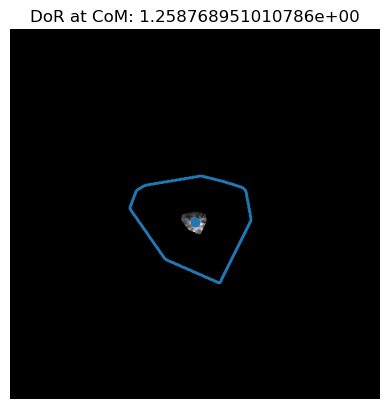

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


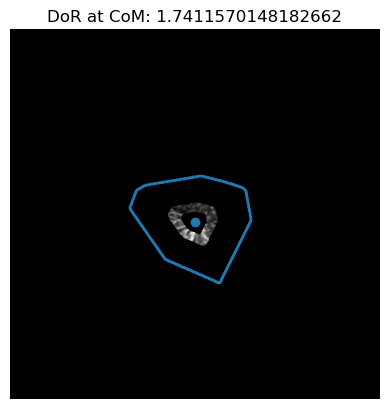

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


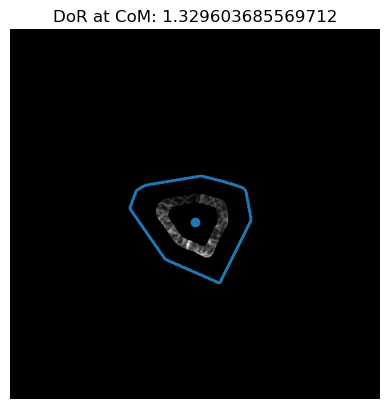

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


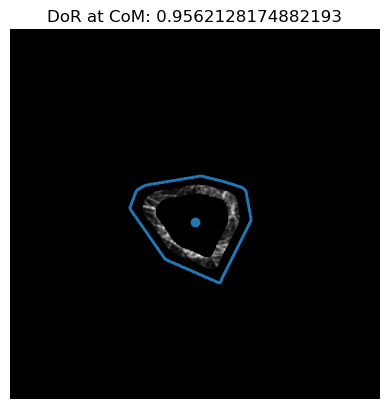

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


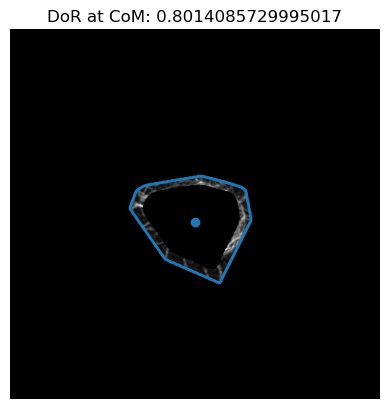

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


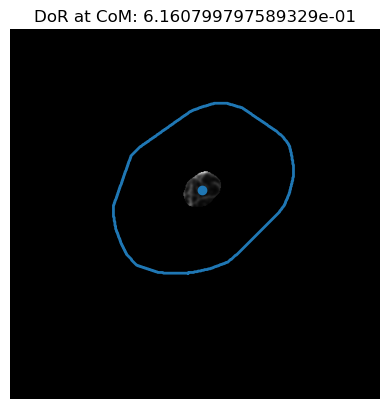

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


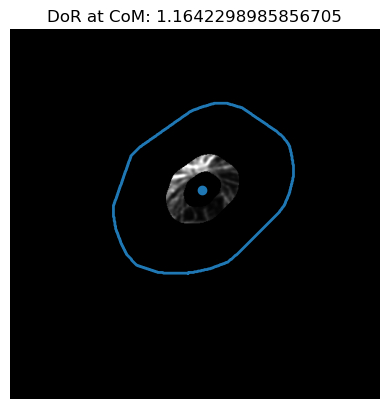

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


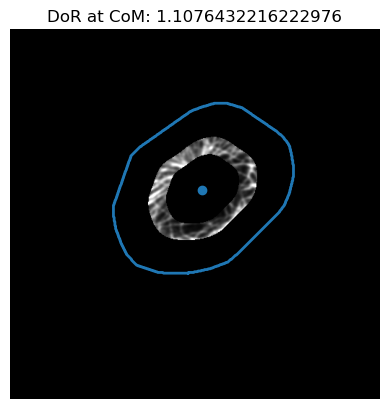

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


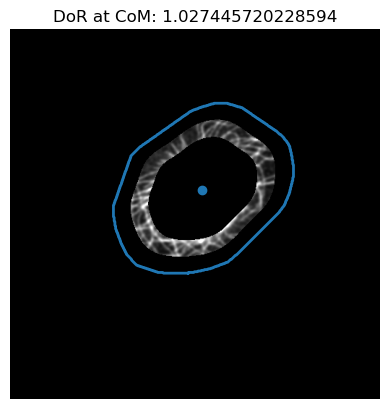

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


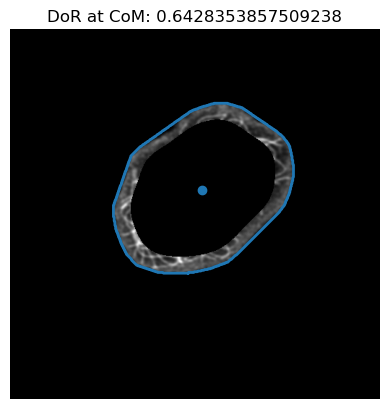

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


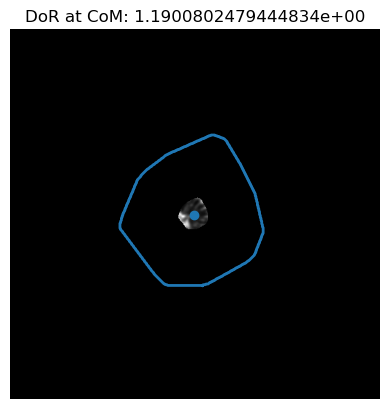

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


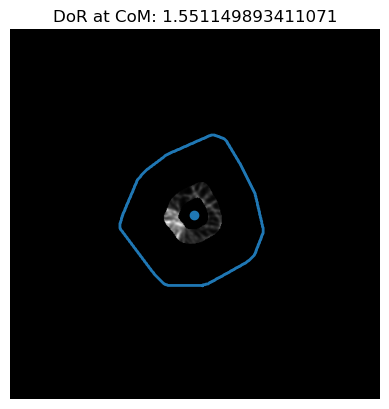

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


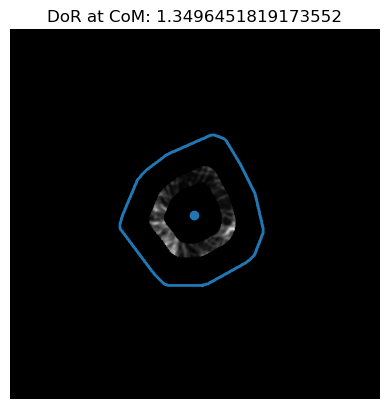

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


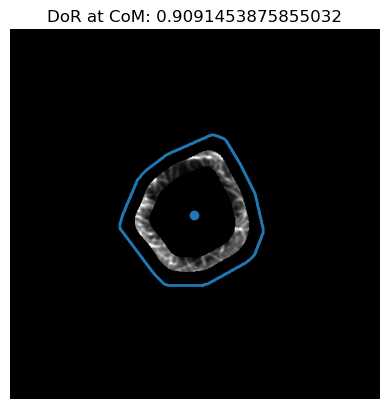

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


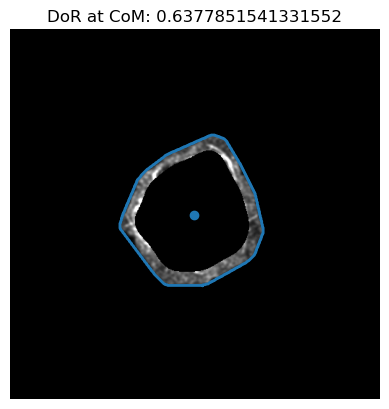

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


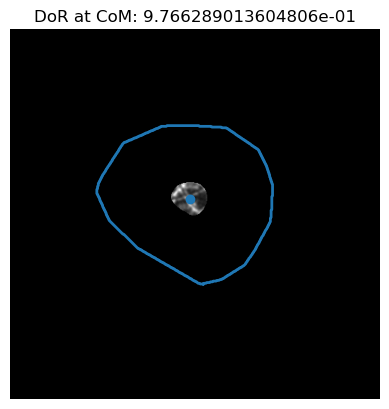

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


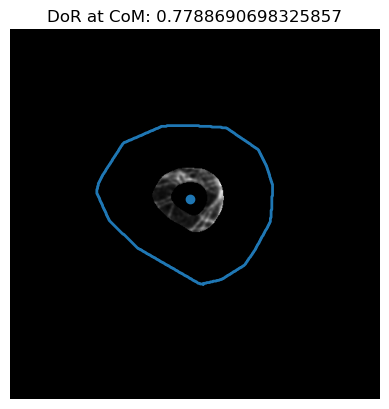

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


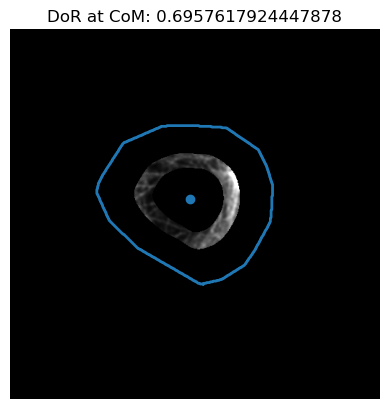

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


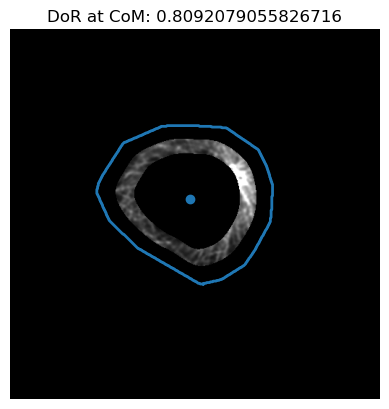

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


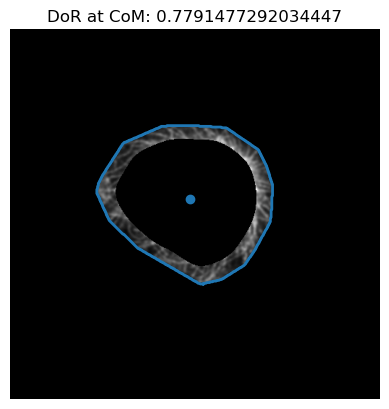

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


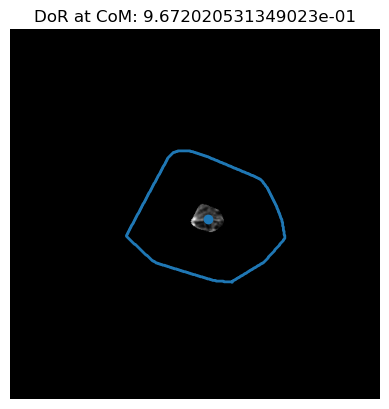

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


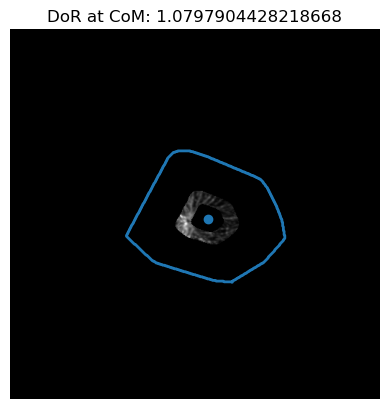

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


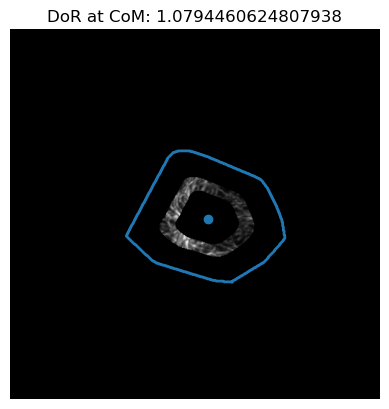

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


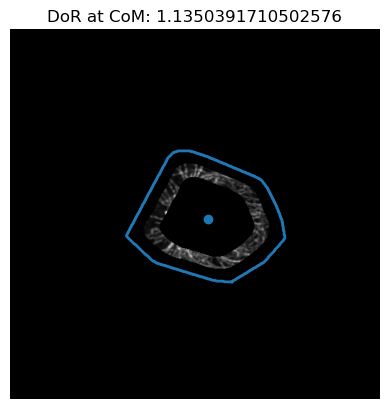

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


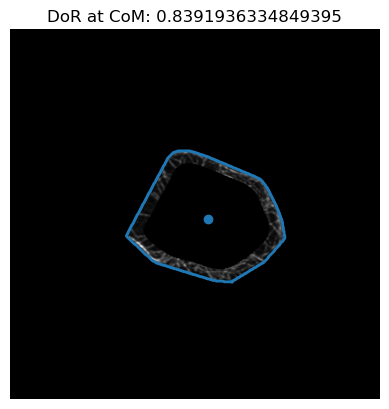

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


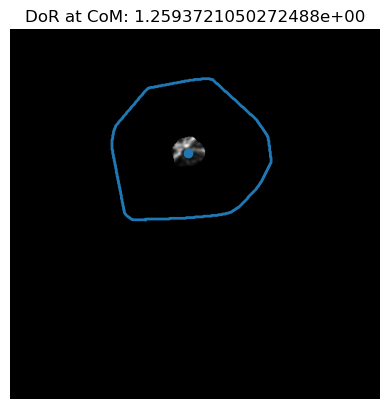

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


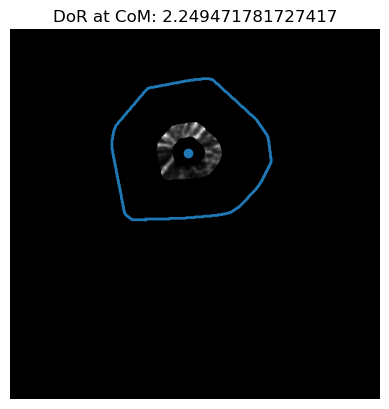

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


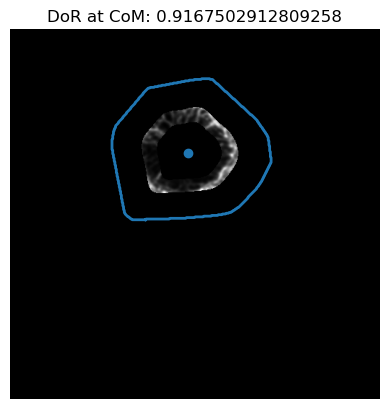

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


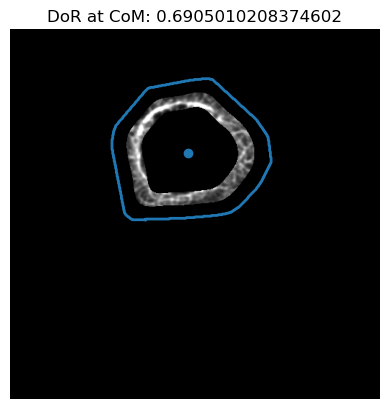

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


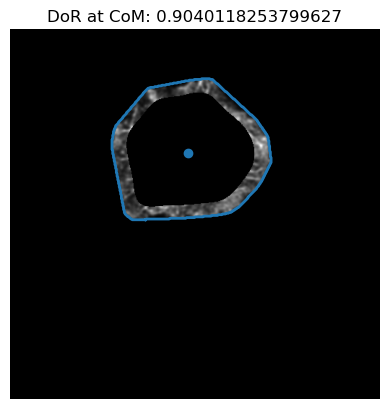

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


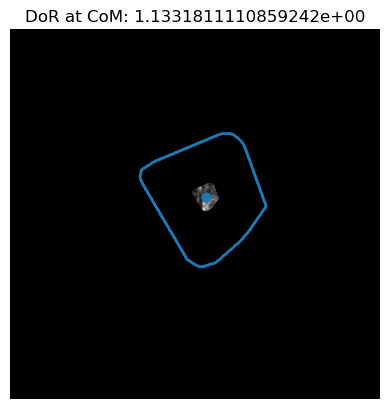

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


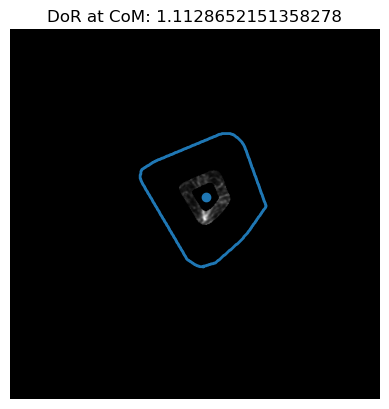

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


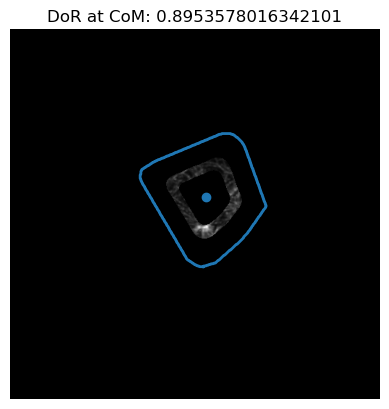

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


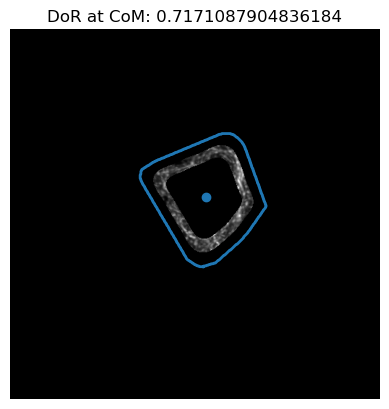

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


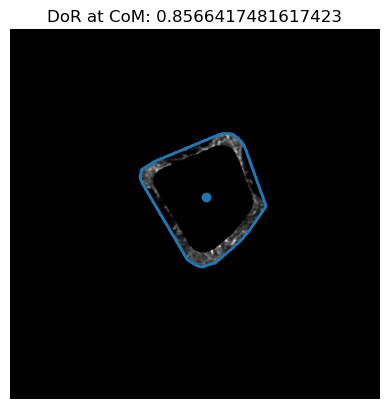

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


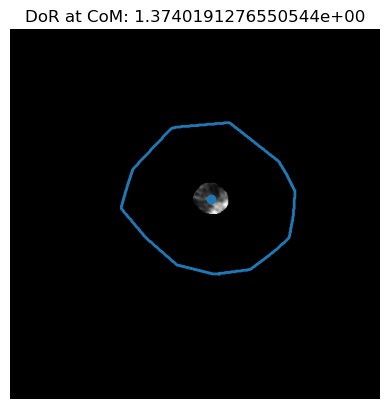

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


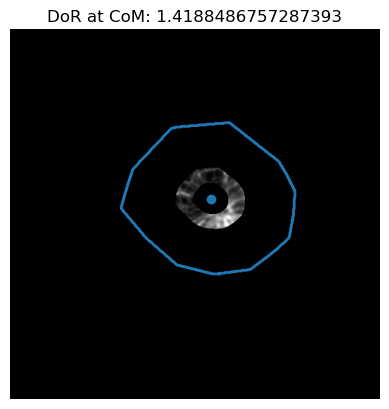

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


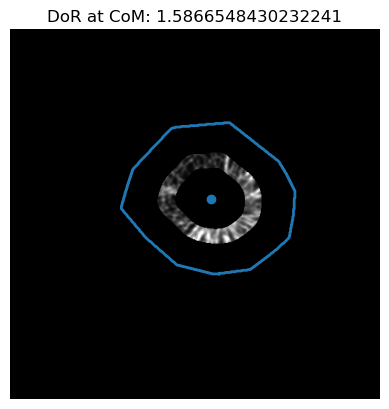

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


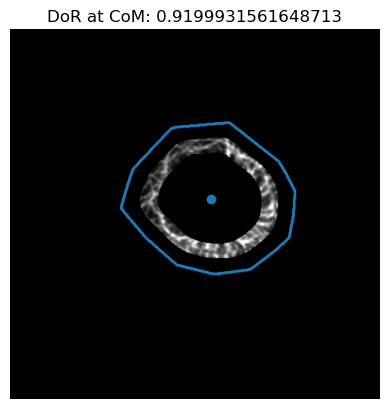

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


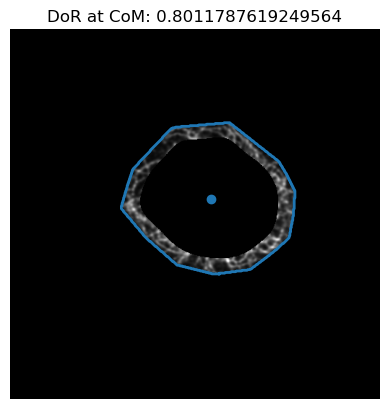

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


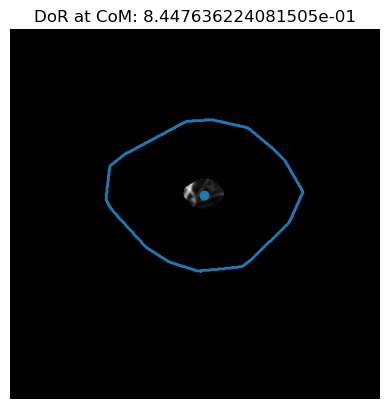

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


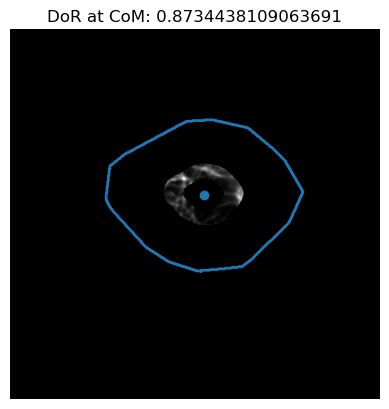

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


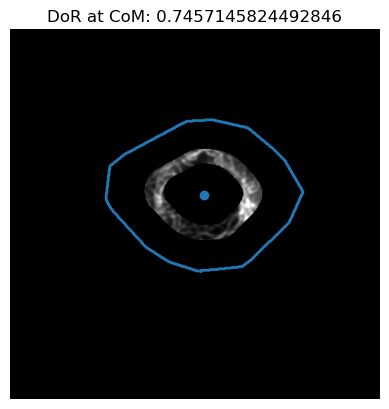

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


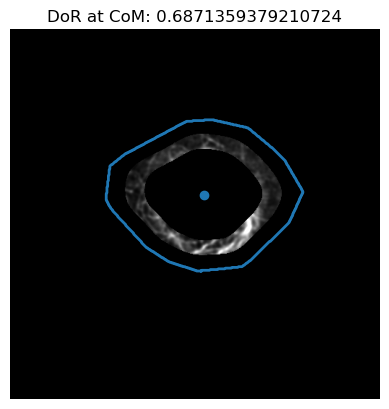

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


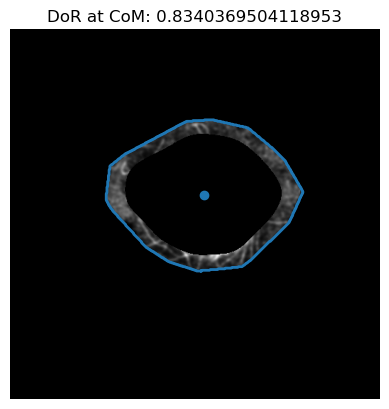

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


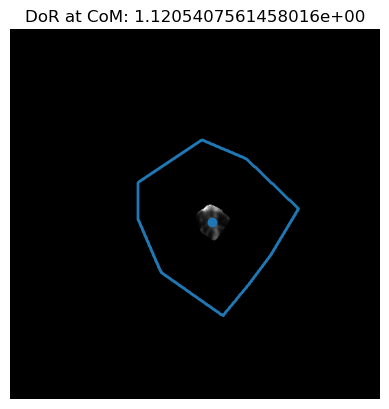

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


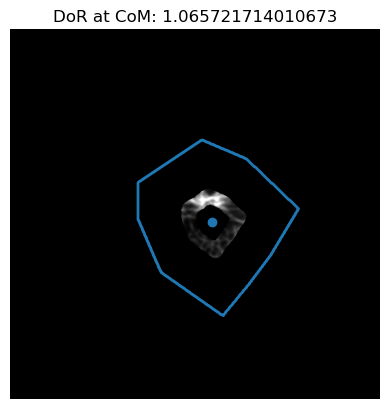

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


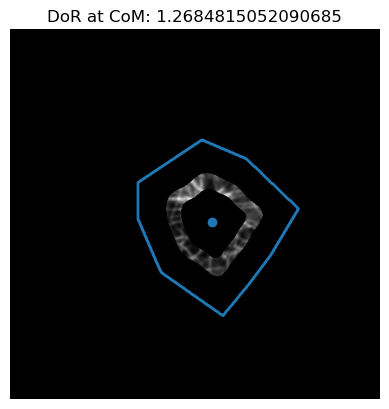

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


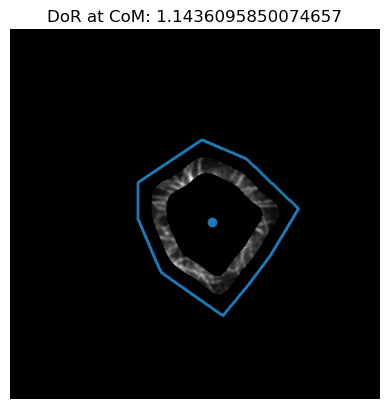

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


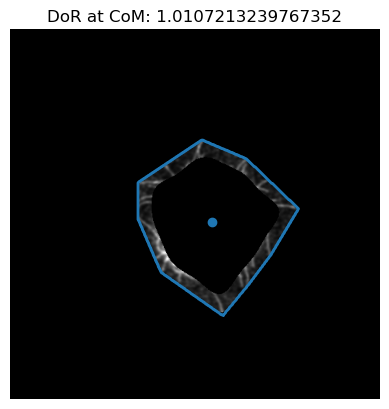

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


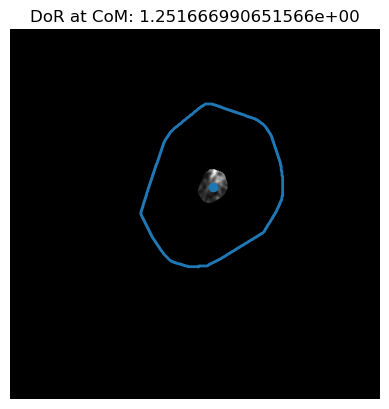

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


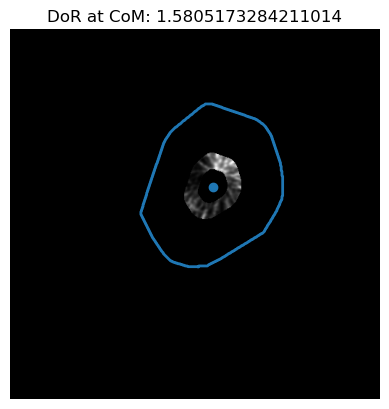

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


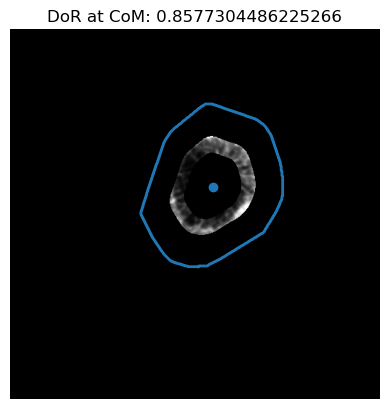

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


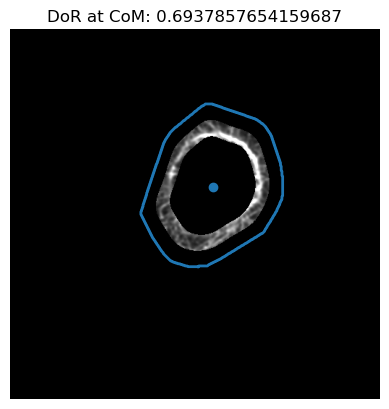

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


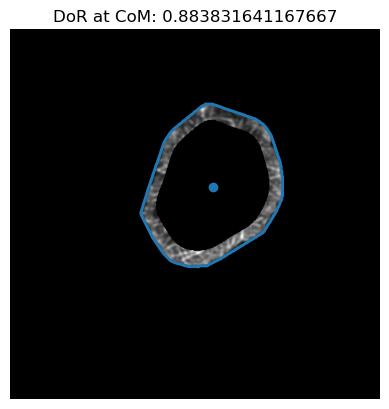

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


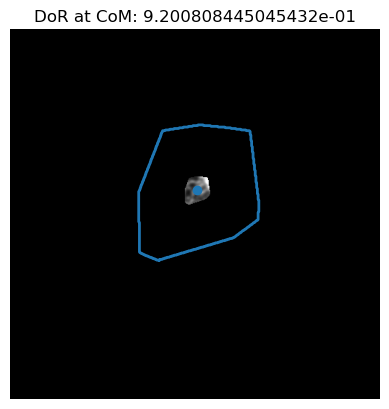

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


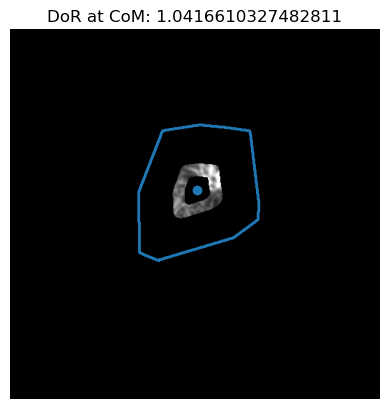

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


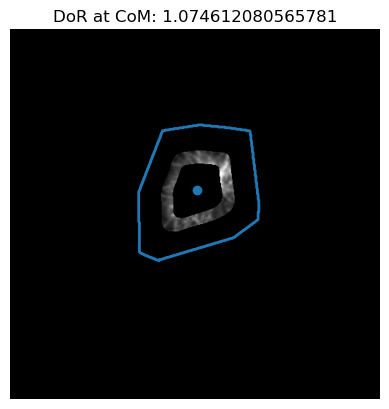

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


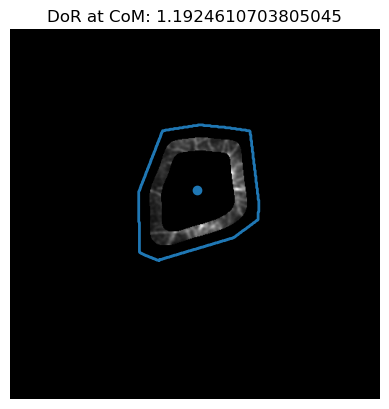

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


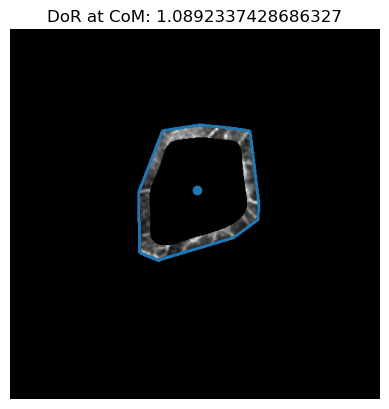

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


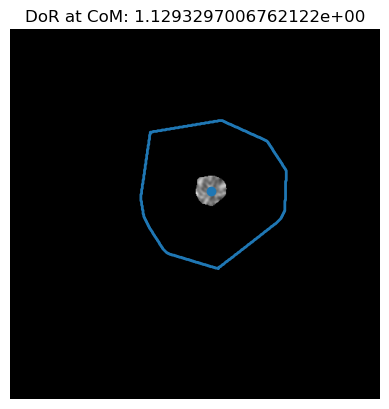

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


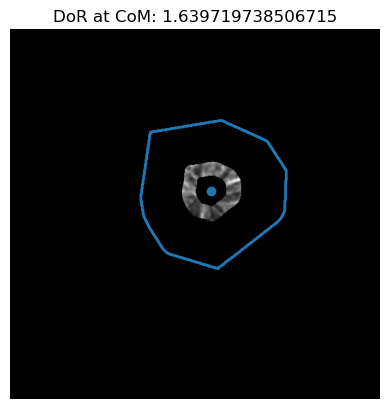

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


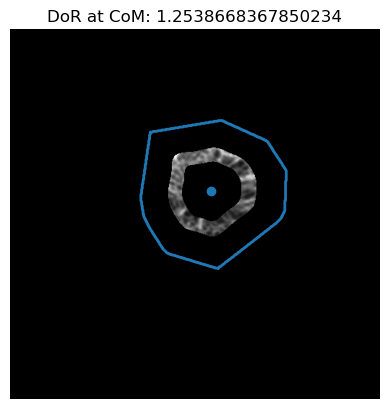

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


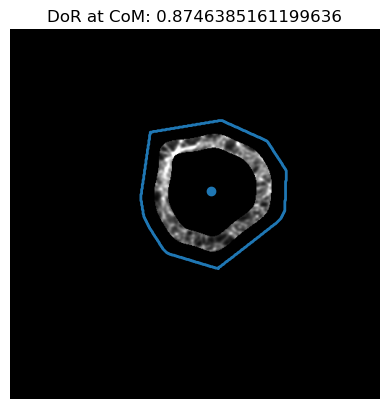

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


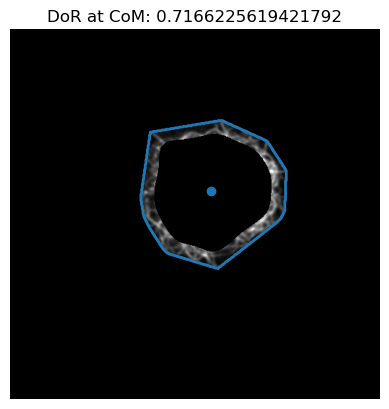

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


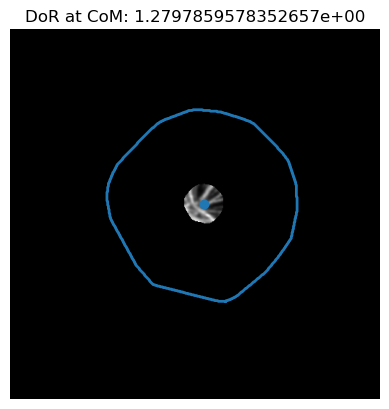

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


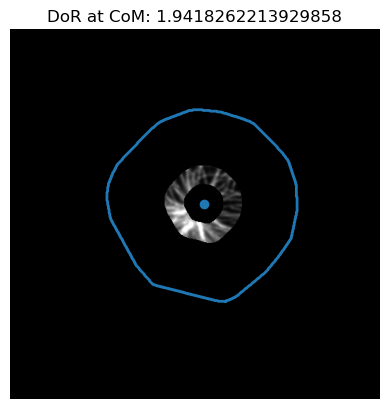

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


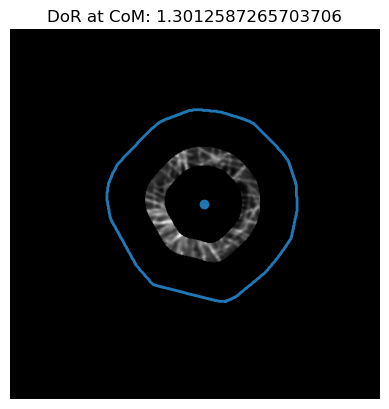

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


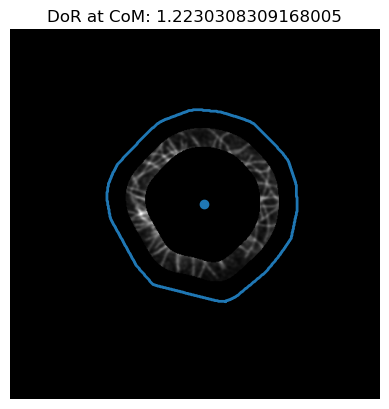

/tmp/ipykernel_467326/1758255611.py:360: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  img_mask = get_area_mask(img.shape, efd_recon_outer, efd_recon_inner, centre_of_mass).astype(np.bool)


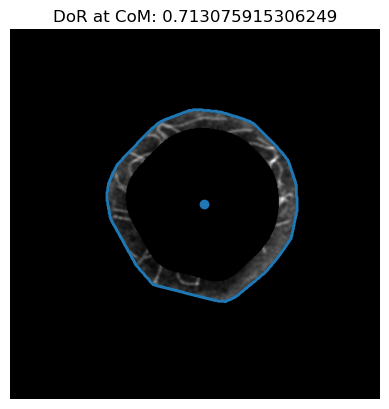

In [4]:
dot_prods_apc = find_radiality_centre('Data/MT_patient_slides/APC01_to_07/APC/*[png, tif]')

0 0.194374351123189
1 0.4556807599249022
2 0.008770014392870376
3 0.704469742116719
4 0.027545376642132458


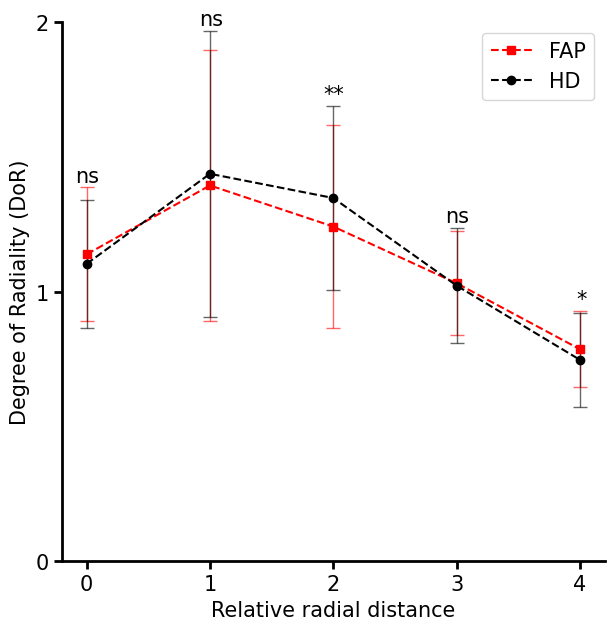

In [6]:
fig, ax = plt.subplots(1, 1, figsize =(7, 7))

y1 = np.mean(dot_prods_apc, axis=0)

e1 = np.std(dot_prods_apc, axis=0)

y2 = np.mean(dot_prods_ctrl, axis=0)

e2 = np.std(dot_prods_ctrl, axis=0)

x = np.linspace(0, dot_prods_ctrl.shape[1] - 1, dot_prods_ctrl.shape[1])
ax.errorbar(x, y1, yerr=e1, alpha=0.6, ls='none', capsize=5, elinewidth=1, markeredgewidth=1, color='red')
ax.errorbar(x, y2, yerr=e2, alpha=0.6, ls='none', capsize=5, elinewidth=1, markeredgewidth=1, color='black')

ax.plot(x, y1, 's--', color='red')
ax.plot(x, y2, 'o--', color='black')

for x_txt in range(dot_prods_ctrl.shape[1]):
    y_txt = np.max([y1[x_txt] + e1[x_txt], y2[x_txt] + e2[x_txt]]) + 0.02
    
    p_val = stats.ttest_ind(dot_prods_ctrl[:,x_txt], dot_prods_apc[:,x_txt])[1]
    if p_val > 0.05:
        txt = 'ns'
        diff = 0.09
    elif p_val < 0.01:
        txt = '**'
        diff = 0.08
    elif p_val < 0.05:
        txt = '*'
        diff = 0.029
        
    ax.text(x_txt - diff, y_txt, txt, fontsize=15)

ax.legend(['FAP', 'HD'], fontsize=15)
plt.xlabel('Relative radial distance', fontsize=15)
plt.ylabel('Degree of Radiality (DoR)', fontsize=15)

plt.yticks(fontsize=15)
plt.xticks(fontsize=15)

ax.spines[['right', 'top']].set_visible(False)
ax.spines[['bottom', 'left']].set_linewidth(2)
ax.tick_params(direction='out', length=6, width=2)
ax.set_yticks([0, 1, 2])
ax.set_xticks([0, 1, 2, 3, 4])

plt.ylim([0, 2])
plt.xlim([-0.2, 4.2])

plt.show()

/tmp/ipykernel_467326/3675813868.py:59: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[0,1].set_xticklabels(['HD', 'FAP'], rotation=45, fontsize=12)
/tmp/ipykernel_467326/3675813868.py:105: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[0,2].set_xticklabels(['HD', 'FAP'], rotation=45, fontsize=12)
/tmp/ipykernel_467326/3675813868.py:230: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[1,1].set_xticklabels(['HD', 'FAP'], rotation=45, fontsize=12)
/tmp/ipykernel_467326/3675813868.py:273: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[1,2].set_xticklabels(['HD', 'FAP'], rotation=45, fontsize=12)


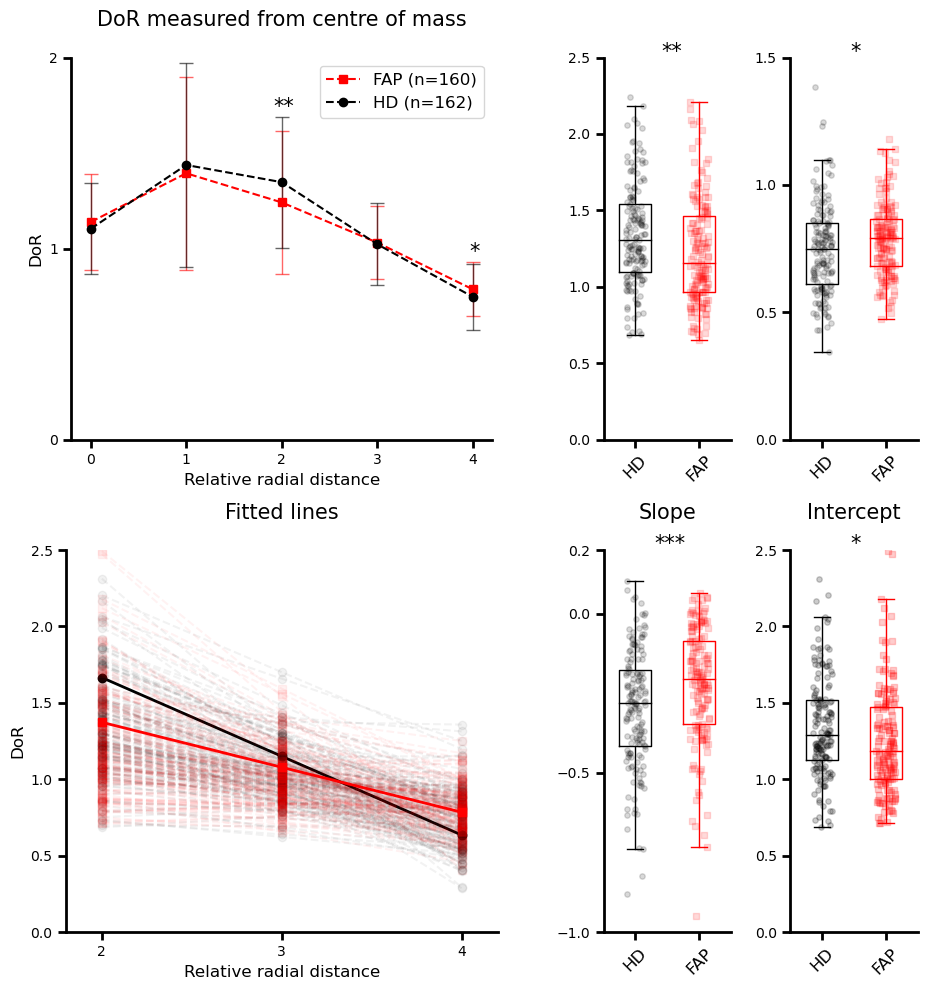

In [28]:
fig, ax = plt.subplots(2, 3, figsize =(10, 10), gridspec_kw={'width_ratios':[6, 2, 2], 'height_ratios':[1,1]})

y1 = np.mean(dot_prods_apc, axis=0)

e1 = np.std(dot_prods_apc, axis=0)

y2 = np.mean(dot_prods_ctrl, axis=0)

e2 = np.std(dot_prods_ctrl, axis=0)

x = np.linspace(0, dot_prods_ctrl.shape[1] - 1, dot_prods_ctrl.shape[1])
ax[0,0].errorbar(x, y1, yerr=e1, alpha=0.6, ls='none', capsize=5, elinewidth=1, markeredgewidth=1, color='red')
ax[0,0].errorbar(x, y2, yerr=e2, alpha=0.6, ls='none', capsize=5, elinewidth=1, markeredgewidth=1, color='black')

ax[0,0].plot(x, y1, 's--', color='red')
ax[0,0].plot(x, y2, 'o--', color='black')

for x_txt in range(dot_prods_ctrl.shape[1]):
    y_txt = np.max([y1[x_txt] + e1[x_txt], y2[x_txt] + e2[x_txt]]) + 0.02
    
    p_val = stats.ttest_ind(dot_prods_ctrl[:,x_txt], dot_prods_apc[:,x_txt])[1]
    if p_val > 0.05:
        txt = ''
        diff = 0.09
    elif p_val < 0.01:
        txt = '**'
        diff = 0.09
    elif p_val < 0.05:
        txt = '*'
        diff = 0.035
        
    ax[0,0].text(x_txt - diff, y_txt, txt, fontsize=15)

ax[0,0].legend(['FAP (n=160)', 'HD (n=162)'], fontsize=12)
ax[0,0].set_xlabel('Relative radial distance', fontsize=12)
ax[0,0].set_ylabel('DoR', fontsize=12)

ax[0,0].spines[['right', 'top']].set_visible(False)
ax[0,0].spines[['bottom', 'left']].set_linewidth(2)
ax[0,0].tick_params(direction='out', length=6, width=2)
ax[0,0].set_yticks(ticks=[0, 1, 2], fontsize=15)
ax[0,0].set_xticks(ticks=[0, 1, 2, 3, 4], fontsize=15)

# ax[0].set_ylim([0, 2])
# ax[0].set_xlim([-0.2, 4.2])

# rect1 = matplotlib.patches.Rectangle((1.8, 0), 0.4, 2, color='gray', alpha=0.1)
# rect2 = matplotlib.patches.Rectangle((3.8, 0), 0.4, 2, color='gray', alpha=0.3)

# ax[0,0].add_patch(rect1)
# ax[0,0].add_patch(rect2)

ax[0,0].set(xlim=[-0.2, 4.2], ylim=[0, 2], aspect=2)
ax[0,0].set_title('DoR measured from centre of mass\n', fontsize=15)

# Boxplot 1

data = [dot_prods_ctrl[:,2], dot_prods_apc[:,2]]
ax[0,1].set_xticklabels(['HD', 'FAP'], rotation=45, fontsize=12)
bp = ax[0,1].boxplot(data, widths=(0.1, 0.1), positions=(0.5, 0.7), showfliers=False)

bp['boxes'][0].set_color('black')
bp['boxes'][1].set_color('red')

bp['medians'][0].set_color('black')
bp['medians'][1].set_color('red')

bp['whiskers'][0].set_color('black')
bp['whiskers'][1].set_color('black')
bp['whiskers'][2].set_color('red')
bp['whiskers'][3].set_color('red')

bp['caps'][0].set_color('black')
bp['caps'][1].set_color('black')
bp['caps'][2].set_color('red')
bp['caps'][3].set_color('red')

c = 0.5
b = c + 0.03
a = c - 0.03
ax[0,1].scatter([(b - a) * np.random.random_sample(162) + a], dot_prods_ctrl[:,2], color='black', marker='o', s=15, alpha=0.15)

c = 0.7
b = c + 0.03
a = c - 0.03
ax[0,1].scatter([(b - a) * np.random.random_sample(160) + a], dot_prods_apc[:,2], color='red', marker='s', s=15, alpha=0.15)
# ax.set_aspect(1) 

ax[0,1].spines[['right', 'top']].set_visible(False)
ax[0,1].spines[['bottom', 'left']].set_linewidth(2)
ax[0,1].tick_params(direction='out', length=6, width=2)
ax[0,1].set_yticks([0, 0.5, 1, 1.5, 2, 2.5], fontsize=15)

ax[0,1].text(0.58, 2.5, '**', fontsize=15)

ax[0,1].set(xlim=[0.4,0.8], ylim=[0,2.5], aspect=4/25*3)
# ax[1].set_ylabel('DoR', fontsize=15)

# rect3 = matplotlib.patches.Rectangle((0.4, 0), 0.4, 2.5, color='gray', alpha=0.1)
# ax[0,1].add_patch(rect3)

# Boxplot 2

data = [dot_prods_ctrl[:,4], dot_prods_apc[:,4]]
ax[0,2].set_xticklabels(['HD', 'FAP'], rotation=45, fontsize=12)
bp = ax[0,2].boxplot(data, widths=(0.1, 0.1), positions=(0.5, 0.7), showfliers=False)

bp['boxes'][0].set_color('black')
bp['boxes'][1].set_color('red')

bp['medians'][0].set_color('black')
bp['medians'][1].set_color('red')

bp['whiskers'][0].set_color('black')
bp['whiskers'][1].set_color('black')
bp['whiskers'][2].set_color('red')
bp['whiskers'][3].set_color('red')

bp['caps'][0].set_color('black')
bp['caps'][1].set_color('black')
bp['caps'][2].set_color('red')
bp['caps'][3].set_color('red')

c = 0.5
b = c + 0.03
a = c - 0.03
ax[0,2].scatter([(b - a) * np.random.random_sample(162) + a], dot_prods_ctrl[:,4], color='black', marker='o', s=15, alpha=0.15)

c = 0.7
b = c + 0.03
a = c - 0.03
ax[0,2].scatter([(b - a) * np.random.random_sample(160) + a], dot_prods_apc[:,4], color='red', marker='s', s=15, alpha=0.15)
# ax.set_aspect(1) 

ax[0,2].spines[['right', 'top']].set_visible(False)
ax[0,2].spines[['bottom', 'left']].set_linewidth(2)
ax[0,2].tick_params(direction='out', length=6, width=2)
ax[0,2].set_yticks([0, 0.5, 1, 1.5], fontsize=15)

ax[0,2].text(0.59, 1.5, '*', fontsize=15)

# ax[2].set_ylabel('DoR', fontsize=15)

ax[0,2].set(xlim=[0.4,0.8], ylim=[0,1.5], aspect=4/15*3)

# rect4 = matplotlib.patches.Rectangle((0.4, 0), 0.4, 2.5, color='gray', alpha=0.3)
# ax[0,2].add_patch(rect4)

ctrl_slopes = []
ctrl_intercepts = []
ctrl_r_list = []
for i in range(dot_prods_ctrl.shape[0]):
    x = [i for i in range(3)]
    y = dot_prods_ctrl[i,2:]

    slope, intercept, r, p, std_err = stats.linregress(x, y)
    
    ctrl_slopes.append(slope)
    ctrl_intercepts.append(intercept)
    ctrl_r_list.append(r)
    
    def myfunc(x):
      return slope * x + intercept

    mymodel = list(map(myfunc, x))

#     plt.scatter(x, y)
    ax[1,0].plot(x, mymodel, 'o--', c='black', alpha=0.05)
#     plt.ylim([0.5,2.5])

slope = np.mean(slope)
intercept = np.mean(intercept)
def myfunc(x):
  return slope * x + intercept

mymodel = list(map(myfunc, x))

ax[1,0].plot(x, mymodel, 'o-', c='black', alpha=1, linewidth=2)


apc_slopes = []
apc_intercepts = []
apc_r_list = []
for i in range(dot_prods_apc.shape[0]):
    x = [i for i in range(3)]
    y = dot_prods_apc[i,2:]

    slope, intercept, r, p, std_err = stats.linregress(x, y)
    
    apc_slopes.append(slope)
    apc_intercepts.append(intercept)
    apc_r_list.append(r)
    
    apc_mean_slope = np.mean(slope)
    apc_mean_intercept = np.mean(intercept)
    
    def myfunc(x):
      return slope * x + intercept

    mymodel = list(map(myfunc, x))

    #     plt.scatter(x, y)
    ax[1,0].plot(x, mymodel, 's--', c='red', alpha=0.05)

slope = np.mean(slope)
intercept = np.mean(intercept)
def myfunc(x):
  return slope * x + intercept

mymodel = list(map(myfunc, x))

ax[1,0].plot(x, mymodel, 's-', c='red', alpha=1, linewidth=2)
#     plt.ylim([0.5,2.5])

ax[1,0].set_ylabel('DoR', fontsize=12)
ax[1,0].set_xlabel('Relative radial distance', fontsize=12)

ax[1,0].set_xticks(ticks=[0, 1, 2], labels=[2, 3, 4])
ax[1,0].set_yticks([0, 0.5, 1, 1.5, 2, 2.5], fontsize=15)

ax[1,0].spines[['right', 'top']].set_visible(False)
ax[1,0].spines[['bottom', 'left']].set_linewidth(2)
ax[1,0].tick_params(direction='out', length=6, width=2)
ax[1,0].set(xlim=[-0.2, 2.2], ylim=[0, 2.5], aspect=0.85)
ax[1,0].set_title('Fitted lines\n', fontsize=15)

# Boxplot 3

data = [ctrl_slopes, apc_slopes]
ax[1,1].set_xticklabels(['HD', 'FAP'], rotation=45, fontsize=12)
bp = ax[1,1].boxplot(data, widths=(0.1, 0.1), positions=(0.5, 0.7), showfliers=False)

bp['boxes'][0].set_color('black')
bp['boxes'][1].set_color('red')

bp['medians'][0].set_color('black')
bp['medians'][1].set_color('red')

bp['whiskers'][0].set_color('black')
bp['whiskers'][1].set_color('black')
bp['whiskers'][2].set_color('red')
bp['whiskers'][3].set_color('red')

bp['caps'][0].set_color('black')
bp['caps'][1].set_color('black')
bp['caps'][2].set_color('red')
bp['caps'][3].set_color('red')

c = 0.5
b = c + 0.03
a = c - 0.03
ax[1,1].scatter([(b - a) * np.random.random_sample(162) + a], ctrl_slopes, color='black', marker='o', s=15, alpha=0.15)

c = 0.7
b = c + 0.03
a = c - 0.03
ax[1,1].scatter([(b - a) * np.random.random_sample(160) + a], apc_slopes, color='red', marker='s', s=15, alpha=0.15)
# ax.set_aspect(1) 

ax[1,1].spines[['right', 'top']].set_visible(False)
ax[1,1].spines[['bottom', 'left']].set_linewidth(2)
ax[1,1].tick_params(direction='out', length=6, width=2)
ax[1,1].set_yticks([-1, -0.5, 0, 0.2], fontsize=15)

ax[1,1].text(0.56, 0.2, '***', fontsize=15)

ax[1,1].set(xlim=[0.4,0.8], ylim=[-1,0.2], aspect=1/3*3)
ax[1,1].set_title('Slope\n', fontsize=15)

# Boxplot 4

data = [ctrl_intercepts, apc_intercepts]
ax[1,2].set_xticklabels(['HD', 'FAP'], rotation=45, fontsize=12)
bp = ax[1,2].boxplot(data, widths=(0.1, 0.1), positions=(0.5, 0.7), showfliers=False)

bp['boxes'][0].set_color('black')
bp['boxes'][1].set_color('red')

bp['medians'][0].set_color('black')
bp['medians'][1].set_color('red')

bp['whiskers'][0].set_color('black')
bp['whiskers'][1].set_color('black')
bp['whiskers'][2].set_color('red')
bp['whiskers'][3].set_color('red')

bp['caps'][0].set_color('black')
bp['caps'][1].set_color('black')
bp['caps'][2].set_color('red')
bp['caps'][3].set_color('red')

c = 0.5
b = c + 0.03
a = c - 0.03
ax[1,2].scatter([(b - a) * np.random.random_sample(162) + a], ctrl_intercepts, color='black', marker='o', s=15, alpha=0.2)

c = 0.7
b = c + 0.03
a = c - 0.03
ax[1,2].scatter([(b - a) * np.random.random_sample(160) + a], apc_intercepts, color='red', marker='s', s=15, alpha=0.2)

# ax.set_aspect(1) 

ax[1,2].spines[['right', 'top']].set_visible(False)
ax[1,2].spines[['bottom', 'left']].set_linewidth(2)
ax[1,2].tick_params(direction='out', length=6, width=2)
ax[1,2].set_yticks([0, 0.5, 1, 1.5, 2, 2.5], fontsize=15)

# plt.plot([1, 1, 2, 2], [2.4, 2.6, 2.6, 2.55], linewidth=1, color='k')
ax[1,2].text(0.59, 2.5, '*', fontsize=15)

ax[1,2].set(xlim=[0.4,0.8], ylim=[0,2.5], aspect=4/25*3)
ax[1,2].set_title('Intercept\n', fontsize=15)


fig.subplots_adjust(top=0.6)

plt.tight_layout()
plt.savefig('dor_analysis.pdf', dpi=600)
plt.show()